<a href="https://colab.research.google.com/github/avnishkanungo/Reinforcement-Learning_DeepQLearning/blob/main/RL_DeepQLearning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import gym ## (A)
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

In [3]:
## Set the hyperparameters for training:
EPISODES = 1000 # total number of episodes
EXPLORE_EPI_END = int(0.1*EPISODES) # initial exploration when agent will explore and no training
TEST_EPI_START = int(0.7*EPISODES ) # agent will be tested from this episode
EPS_START = 1.0 # e-greedy threshold start value
EPS_END = 0.05 # e-greedy threshold end value
EPS_DECAY = 1+np.log(EPS_END)/(0.6*EPISODES) # e-greedy threshold decay
GAMMA = 0.8 # Q-learning discount factor
LR = 0.001 # NN optimizer learning rate
MINIBATCH_SIZE = 64 # Q-learning batch size
ITERATIONS = 40 # Number of iterations for training
REP_MEM_SIZE = 10000 # Replay Memory size

In [4]:
use_cuda = torch.cuda.is_available() ## (B)
FloatTensor = torch.cuda.FloatTensor if use_cuda else torch.FloatTensor
LongTensor = torch.cuda.LongTensor if use_cuda else torch.LongTensor
ByteTensor = torch.cuda.ByteTensor if use_cuda else torch.ByteTensor
Tensor = FloatTensor

In [6]:
class QNet(nn.Module): ## (C)
  """
  Input to the network is a 4-dimensional state vector and the output a
  2-dimensional vector of two possible actions: move-left or move-right
  """
  def __init__(self, state_space_dim, action_space_dim):
    nn.Module.__init__(self)
    self.l1 = nn.Linear(state_space_dim, 24)
    self.l2 = nn.Linear(24, 24)
    self.l3 = nn.Linear(24, action_space_dim)
  def forward(self, x):
    x = F.relu(self.l1(x))
    x = F.relu(self.l2(x))
    x = self.l3(x)
    return x

In [7]:
class ReplayMemory: ## (D)
  """
  This class is used to store a large number, possibly say 10000, of the
  4-tuples ’[State, Action, Next State, Reward]’ at the output, meaning even
  before the nueral-network based learning kicks in. Subsequently, batches
  are constructed from this storage for training. The dynamically updated
  as each new 4-tuple becomes available.
  """
  def __init__(self, capacity):
    self.capacity = capacity
    self.memory = []
  def push(self, s, a , r, ns):
    self.memory.append((FloatTensor([s]),
                        a, # action is already a tensor
                        FloatTensor([ns]),
                        FloatTensor([r])))
    if len(self.memory) > self.capacity:
      del self.memory[0]
  def sample(self, MINIBATCH_SIZE):
    return random.sample(self.memory, MINIBATCH_SIZE)
  def __len__(self):
    return len(self.memory)

In [16]:
class QNetAgent: ## (E)
  def __init__(self, stateDim, actionDim):
    self.sDim = stateDim
    self.aDim = actionDim
    self.model = QNet(self.sDim, self.aDim) # Instantiate the NN model, loss and optimizer for training the agent
    if use_cuda:
      self.model.cuda()
    self.optimizer = optim.Adam(self.model.parameters(), LR)
    self.lossCriterion = torch.nn.MSELoss()
    self.memory = ReplayMemory(REP_MEM_SIZE) # Instantiate the Replay Memory for storing agent’s experiences
    # Initialize internal variables
    self.steps_done = 0
    self.episode_durations = []
    self.avg_episode_duration = []
    self.epsilon = EPS_START
    self.epsilon_history = []
    self.mode = ""

  def select_action(self, state): ## (F)
    """ Select action based on epsilon-greedy approach """
    p = random.random() # generate a random number between 0 and 1
    self.steps_done += 1
    if p > self.epsilon:
    # if the agent is in ’exploitation mode’ select optimal action
    # based on the highest Q value returned by the trained NN
      with torch.no_grad():
        return self.model(FloatTensor(state)).data.max(1)[1].view(1, 1)
    else:
    # if the agent is in the ’exploration mode’ select a random action
      return LongTensor([[random.randrange(2)]])

  def run_episode(self, e, environment): ## (G)
    state = environment.reset() # reset the environment at the beginning
    done = False
    steps = 0
    # Set the epsilon value for the episode
    if e < EXPLORE_EPI_END:
      self.epsilon = EPS_START
      self.mode = "Exploring"
    elif EXPLORE_EPI_END <= e <= TEST_EPI_START:
      self.epsilon = self.epsilon*EPS_DECAY
      self.mode = "Training"
    elif e > TEST_EPI_START:
      self.epsilon = 0.0
      self.mode = "Testing"
    self.epsilon_history.append(self.epsilon)
    while True: # Iterate until episode ends (i.e. a terminal state is reached)
      environment.render()
      action = self.select_action(FloatTensor([state])) # Select action based on epsilon-greedy approach
      c_action = action.data.cpu().numpy()[0,0]
      # Get next state and reward from environment based on current action
      next_state, reward, done, _ = environment.step(c_action)
      if done: # negative reward (punishment) if agent is in a terminal state
        reward = -10 # negative reward for failing
      # push experience into replay memory
      self.memory.push(state,action, reward, next_state)
      # if initial exploration is finished train the agent
      if EXPLORE_EPI_END <= e <= TEST_EPI_START:
        self.learn()
      state = next_state
      steps += 1
      if done: # Print information after every episode
        print("{2} Mode: {4} | Episode {0} Duration {1} steps | epsilon {3}".format(e, steps, '\033[92m' if steps >= 195 else '\033[99m', self.epsilon, self.mode))
        self.episode_durations.append(steps)
        # self. plot_durations(e)
        break
    self. plot_durations(e)


  def learn(self): ## (H)
    """
    Train the neural newtwork using the randomly selected 4-tuples
    ’[State, Action, Next State, Reward]’ from the ReplayStore storage.
    """
    if len(self.memory) < MINIBATCH_SIZE:
      return
    for i in range(ITERATIONS):
      # minibatch is generated by random sampling from experience replay memory
      experiences = self.memory.sample(MINIBATCH_SIZE)
      batch_state, batch_action, batch_next_state, batch_reward = zip(*experiences)
      # extract experience information for the entire minibatch
      batch_state = torch.cat(batch_state)
      batch_action = torch.cat(batch_action)
      batch_reward = torch.cat(batch_reward)
      batch_next_state = torch.cat(batch_next_state)
      # current Q values are estimated by NN for all actions
      current_q_values = self.model(batch_state).gather(1, batch_action)
      # expected Q values are estimated from actions which gives maximum Q value
      max_next_q_values = self.model(batch_next_state).detach().max(1)[0]
      expected_q_values = batch_reward + (GAMMA * max_next_q_values)
      # loss is measured from error between current and newly expected Q values
      loss = self.lossCriterion(current_q_values, expected_q_values.unsqueeze(1))
      # backpropagation of loss for NN training
      self.optimizer.zero_grad()
      loss.backward()
      self.optimizer.step()

  def plot_durations(self,epi): # Update the plot at the end of each episode ## (I)
    fig = plt.figure()
    fig.canvas.manager.set_window_title("DQN Training Statistics")
    plt.clf()
    durations_t = torch.FloatTensor(self.episode_durations)
    plt.subplot(1,2,1)
    if epi<EXPLORE_EPI_END:
      plt.title('Agent Exploring Environment')
    elif EXPLORE_EPI_END <= e <= TEST_EPI_START:
      plt.title('Training Agent')
    else:
      plt.title('Testing Agent')
      plt.xlabel('Episode')
      plt.ylabel('Duration')
      plt.plot(self.episode_durations)
    # Plot cumulative mean
    if len(durations_t) >= EXPLORE_EPI_END:
      means = durations_t.unfold(0, EXPLORE_EPI_END, 1).mean(1).view(-1)
      means = torch.cat((torch.zeros(EXPLORE_EPI_END-1), means))
      plt.plot(means.numpy())
      plt.subplot(1,2,2)
      plt.title("Epsilon per Episode")
      plt.xlabel('Episode')
      plt.ylabel('Epsilon')
      plt.plot(self.epsilon_history)
      plt.show(block=False)
      plt.draw()
      plt.pause(0.0001)



/usr/local/lib/python3.10/dist-packages/gym/core.py:317: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/usr/local/lib/python3.10/dist-packages/gym/core.py:49: DeprecationWarning: WARN: You are calling render method, but you didn't specified the argument render_mode at environment initialization. To maintain backward compatibility, the environment will render in human mode.
If you want to render in human mode, initialize the environment in this way: gym.make('EnvName', render_mode='human') and don

 Mode: Exploring | Episode 0 Duration 13 steps | epsilon 1.0
 Mode: Exploring | Episode 1 Duration 17 steps | epsilon 1.0
 Mode: Exploring | Episode 2 Duration 22 steps | epsilon 1.0
 Mode: Exploring | Episode 3 Duration 25 steps | epsilon 1.0
 Mode: Exploring | Episode 4 Duration 45 steps | epsilon 1.0
 Mode: Exploring | Episode 5 Duration 28 steps | epsilon 1.0
 Mode: Exploring | Episode 6 Duration 18 steps | epsilon 1.0
 Mode: Exploring | Episode 7 Duration 25 steps | epsilon 1.0
 Mode: Exploring | Episode 8 Duration 16 steps | epsilon 1.0
 Mode: Exploring | Episode 9 Duration 11 steps | epsilon 1.0
 Mode: Exploring | Episode 10 Duration 41 steps | epsilon 1.0
 Mode: Exploring | Episode 11 Duration 14 steps | epsilon 1.0
 Mode: Exploring | Episode 12 Duration 46 steps | epsilon 1.0
 Mode: Exploring | Episode 13 Duration 20 steps | epsilon 1.0
 Mode: Exploring | Episode 14 Duration 25 steps | epsilon 1.0
 Mode: Exploring | Episode 15 Duration 32 steps | epsilon 1.0
 Mode: Exploring |

<ipython-input-16-e38d9ed21715>:97: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


 Mode: Exploring | Episode 21 Duration 15 steps | epsilon 1.0
 Mode: Exploring | Episode 22 Duration 32 steps | epsilon 1.0
 Mode: Exploring | Episode 23 Duration 17 steps | epsilon 1.0
 Mode: Exploring | Episode 24 Duration 20 steps | epsilon 1.0
 Mode: Exploring | Episode 25 Duration 20 steps | epsilon 1.0
 Mode: Exploring | Episode 26 Duration 11 steps | epsilon 1.0
 Mode: Exploring | Episode 27 Duration 28 steps | epsilon 1.0
 Mode: Exploring | Episode 28 Duration 41 steps | epsilon 1.0
 Mode: Exploring | Episode 29 Duration 11 steps | epsilon 1.0
 Mode: Exploring | Episode 30 Duration 34 steps | epsilon 1.0
 Mode: Exploring | Episode 31 Duration 41 steps | epsilon 1.0
 Mode: Exploring | Episode 32 Duration 14 steps | epsilon 1.0
 Mode: Exploring | Episode 33 Duration 31 steps | epsilon 1.0
 Mode: Exploring | Episode 34 Duration 42 steps | epsilon 1.0
 Mode: Exploring | Episode 35 Duration 24 steps | epsilon 1.0
 Mode: Exploring | Episode 36 Duration 9 steps | epsilon 1.0
 Mode: Ex

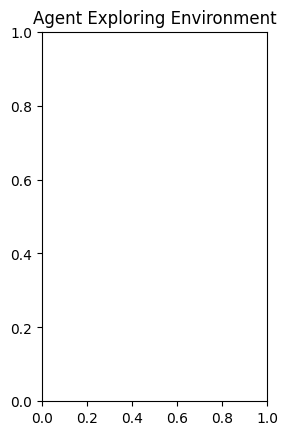

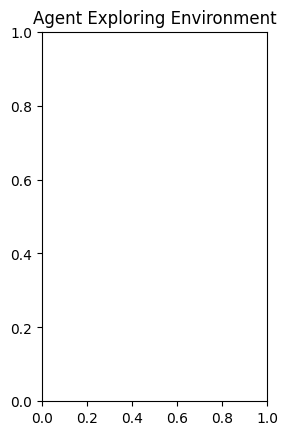

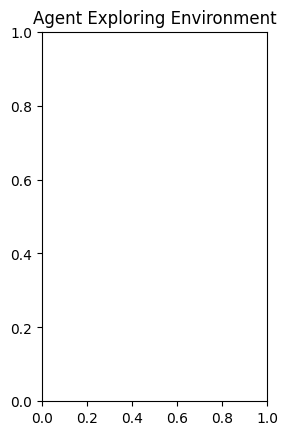

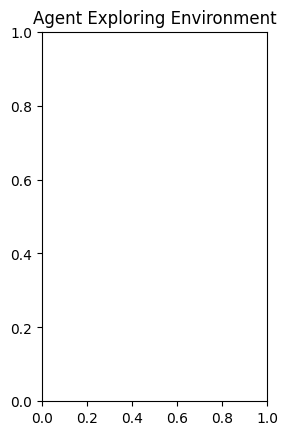

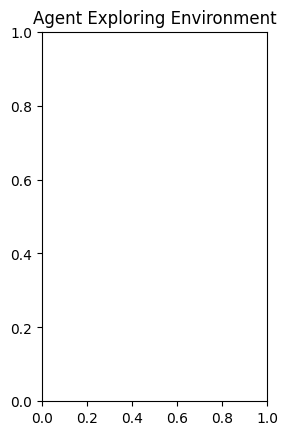

...

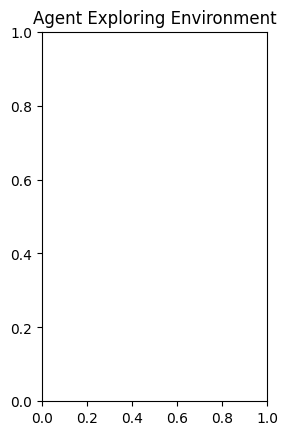

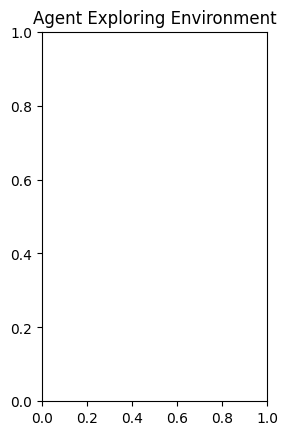

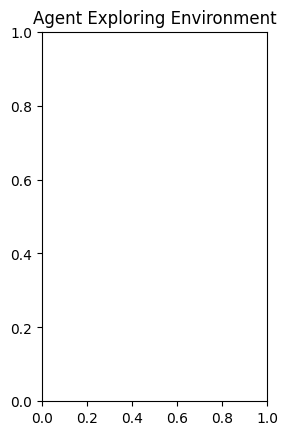

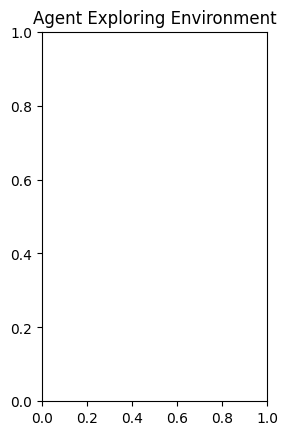

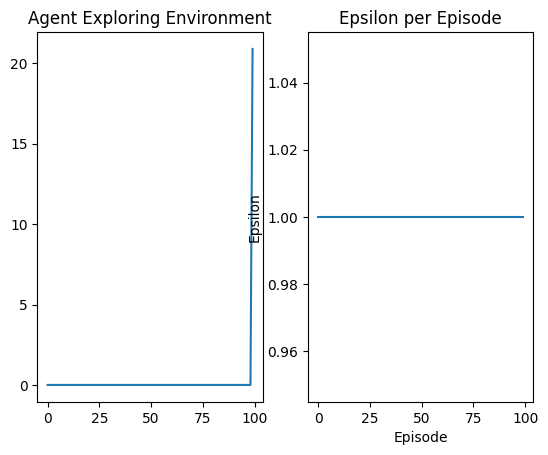

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 100 Duration 15 steps | epsilon 0.9950071128774101


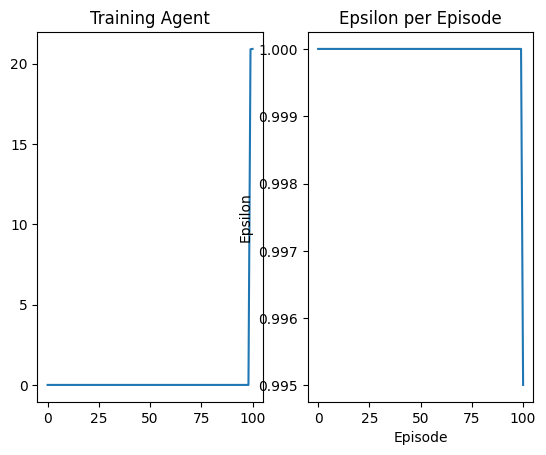

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 101 Duration 12 steps | epsilon 0.990039154676639


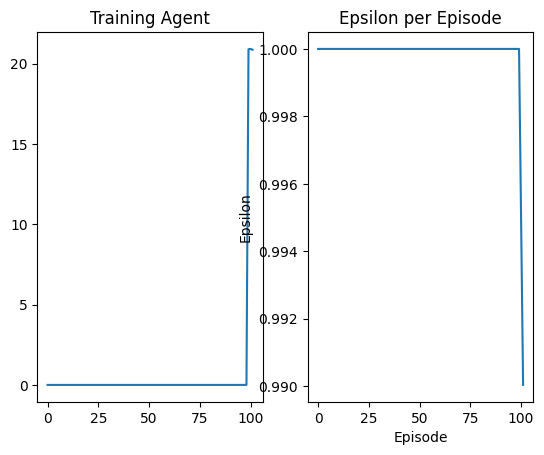

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 102 Duration 24 steps | epsilon 0.9850960009303943


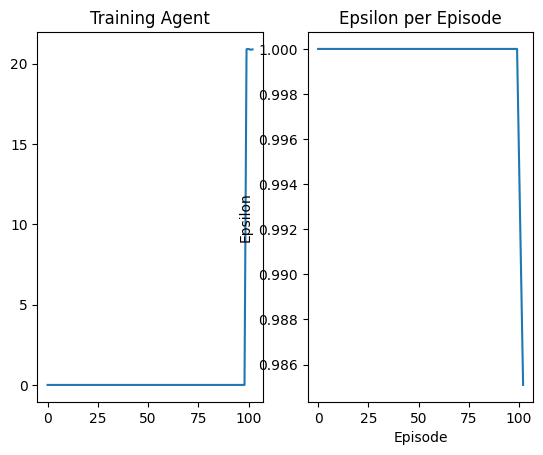

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 103 Duration 26 steps | epsilon 0.9801775277928341


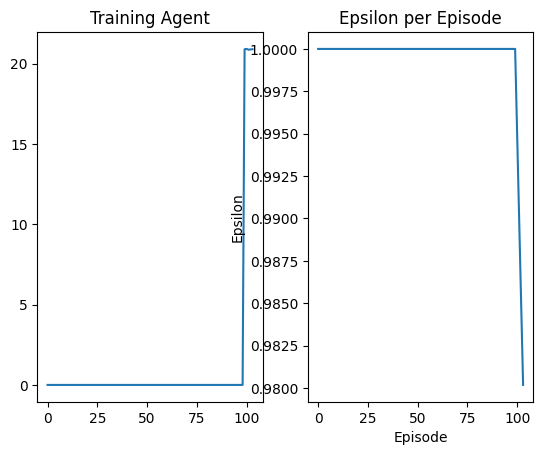

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 104 Duration 14 steps | epsilon 0.9752836120364652


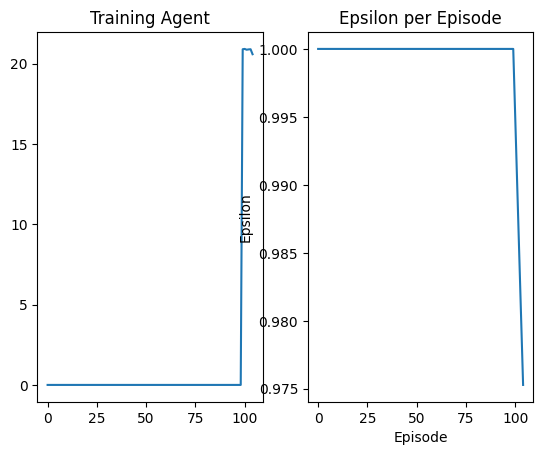

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 105 Duration 15 steps | epsilon 0.9704141310490553


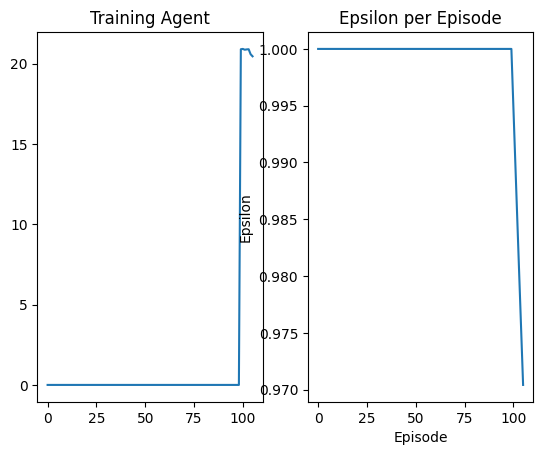

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 106 Duration 78 steps | epsilon 0.9655689628305612


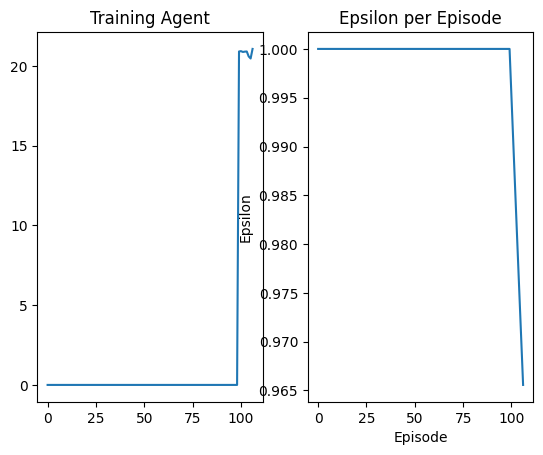

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 107 Duration 20 steps | epsilon 0.9607479859900719


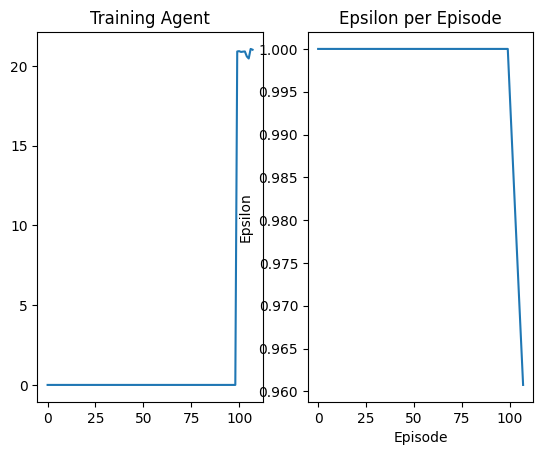

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 108 Duration 17 steps | epsilon 0.9559510797427679


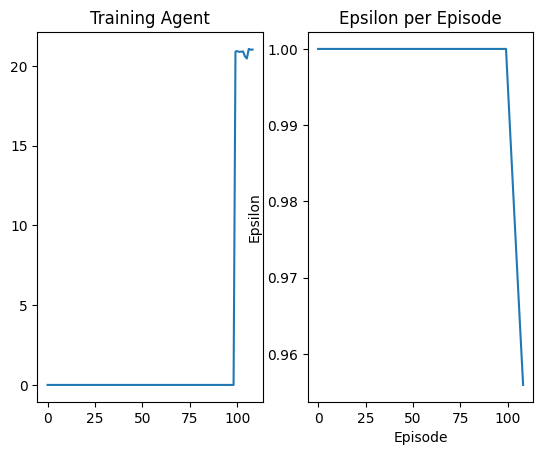

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 109 Duration 15 steps | epsilon 0.9511781239068944


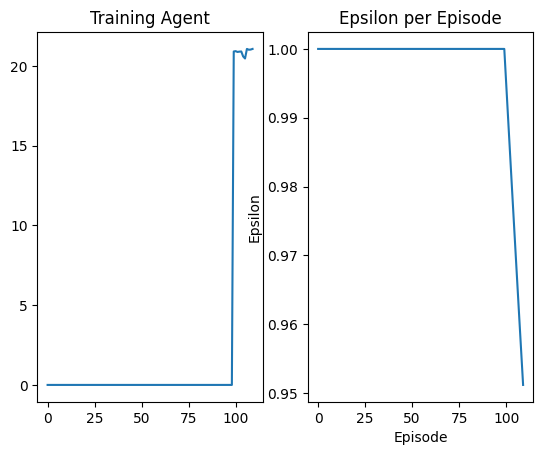

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 110 Duration 16 steps | epsilon 0.9464289989007504


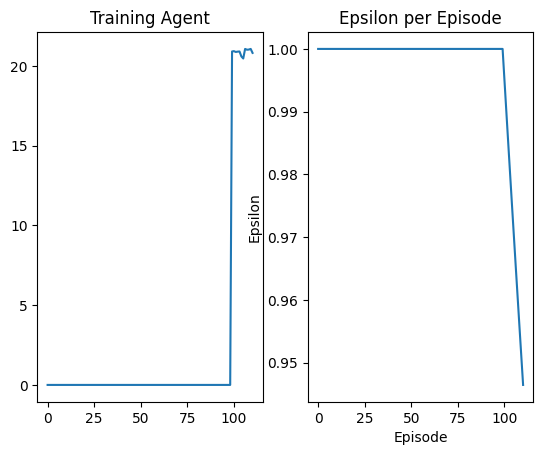

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 111 Duration 34 steps | epsilon 0.9417035857396931


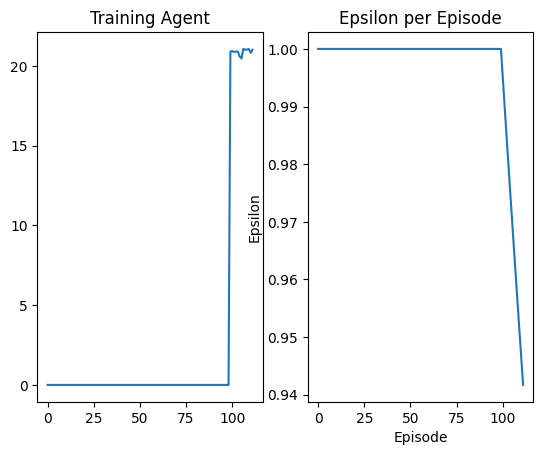

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 112 Duration 20 steps | epsilon 0.9370017660331567


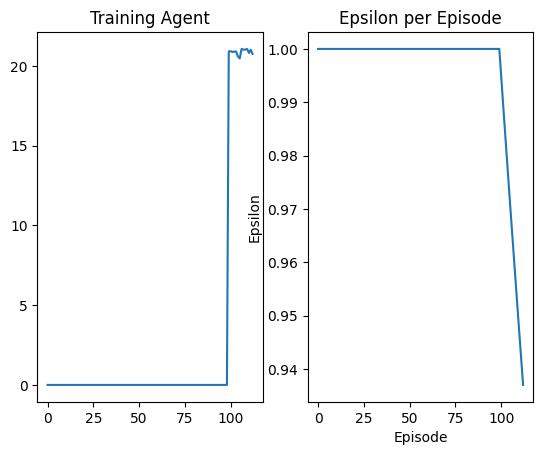

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 113 Duration 25 steps | epsilon 0.9323234219816857


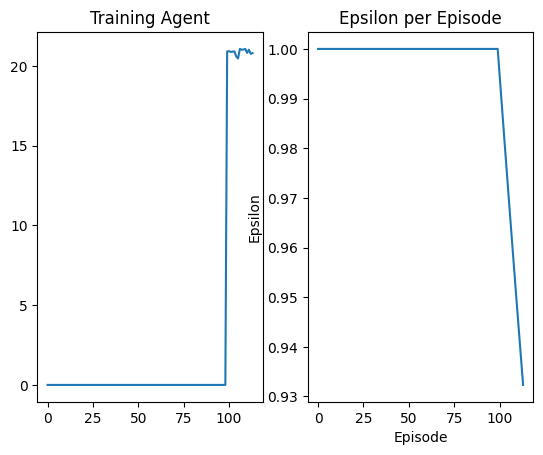

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 114 Duration 49 steps | epsilon 0.9276684363739843


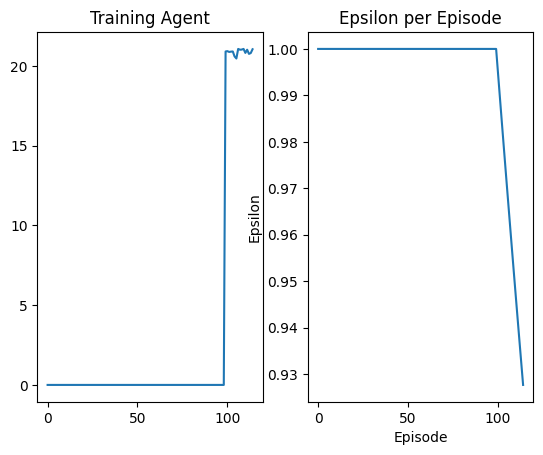

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 115 Duration 9 steps | epsilon 0.9230366925839795


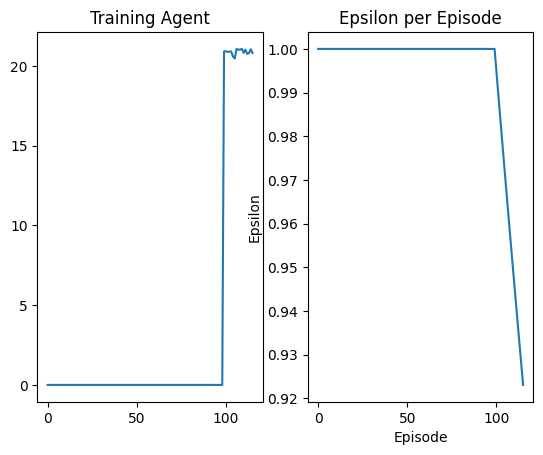

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 116 Duration 29 steps | epsilon 0.9184280745678989


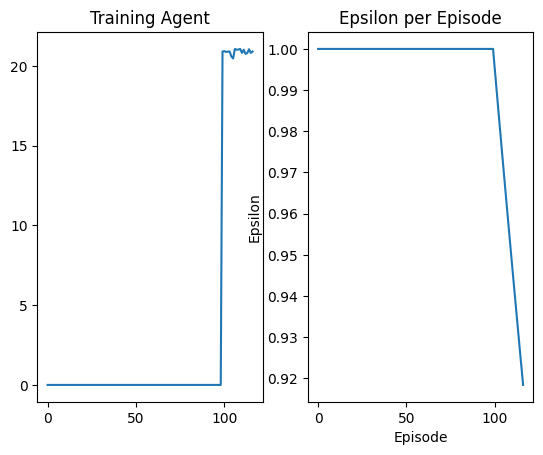

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 117 Duration 24 steps | epsilon 0.9138424668613637


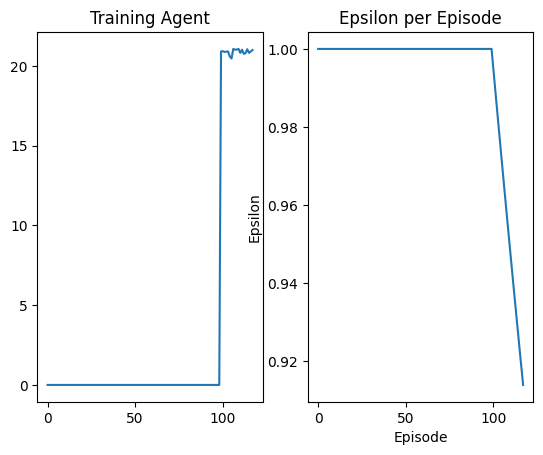

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 118 Duration 22 steps | epsilon 0.9092797545764958


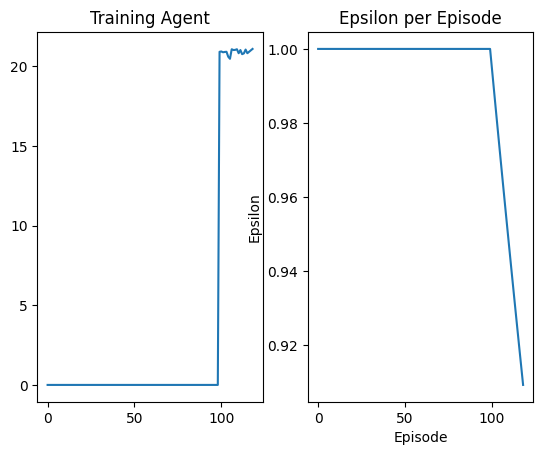

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 119 Duration 12 steps | epsilon 0.904739823399039


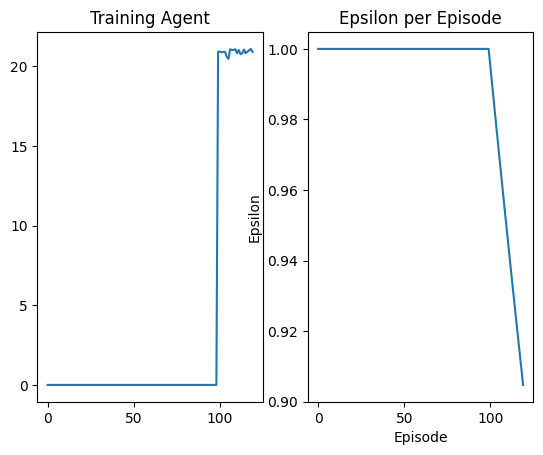

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 120 Duration 10 steps | epsilon 0.9002225595854957


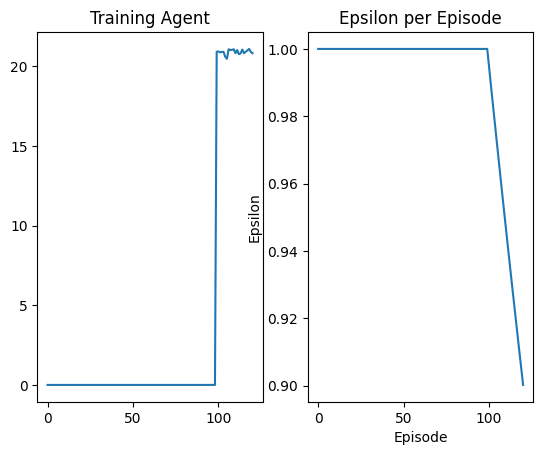

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 121 Duration 16 steps | epsilon 0.8957278499602763


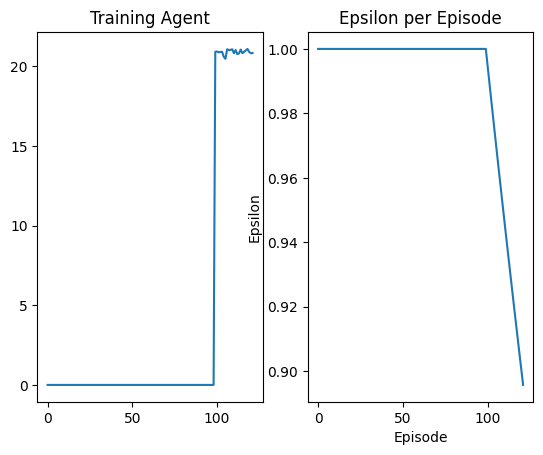

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 122 Duration 14 steps | epsilon 0.8912555819128645


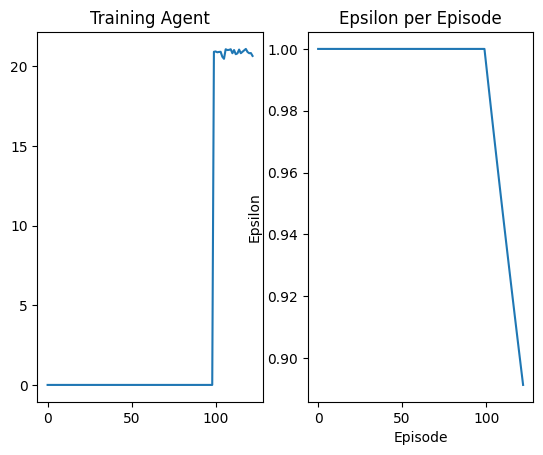

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 123 Duration 19 steps | epsilon 0.8868056433949953


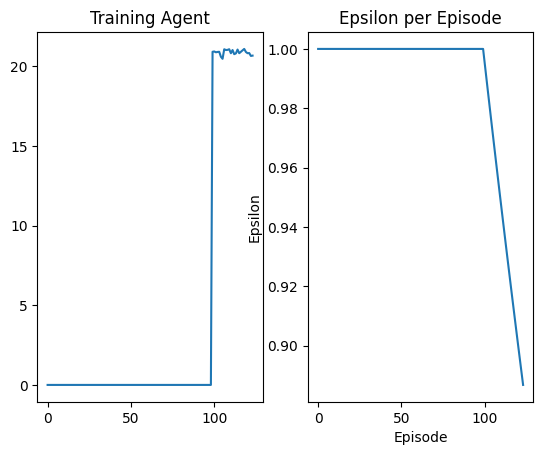

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 124 Duration 14 steps | epsilon 0.8823779229178483


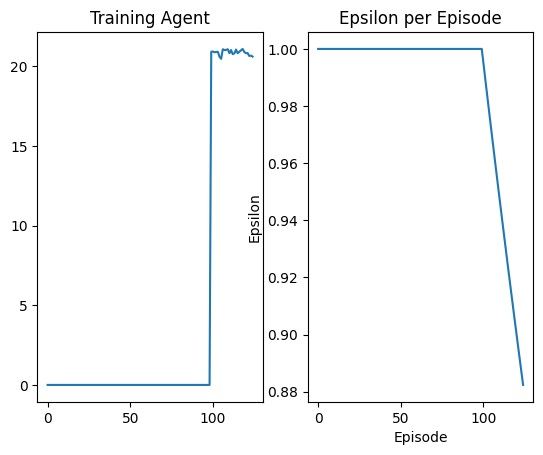

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 125 Duration 15 steps | epsilon 0.8779723095492542


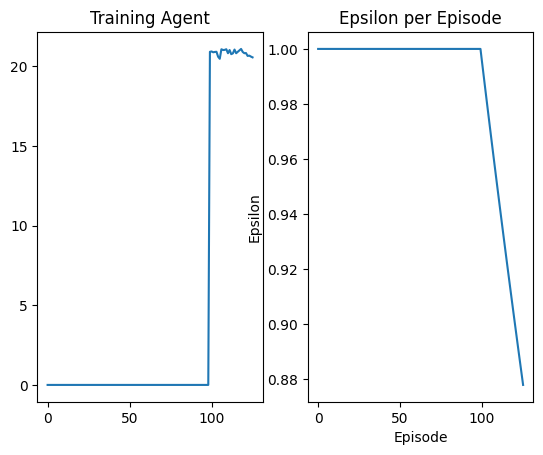

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 126 Duration 26 steps | epsilon 0.8735886929109152


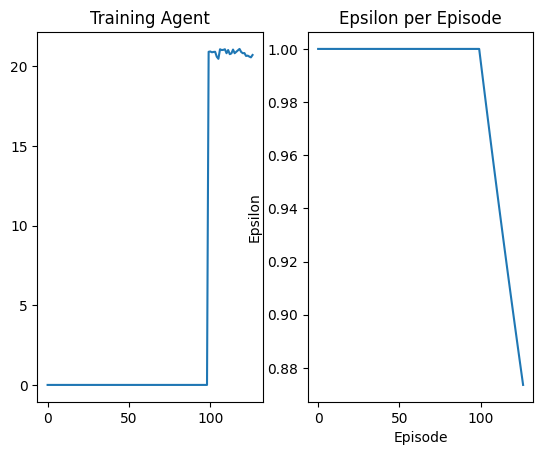

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 127 Duration 33 steps | epsilon 0.8692269631756402


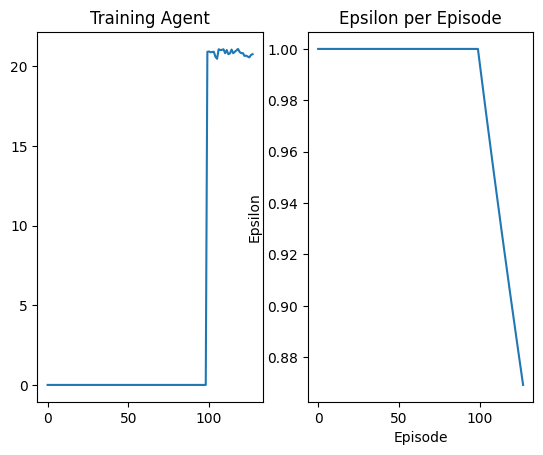

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 128 Duration 34 steps | epsilon 0.8648870110645925


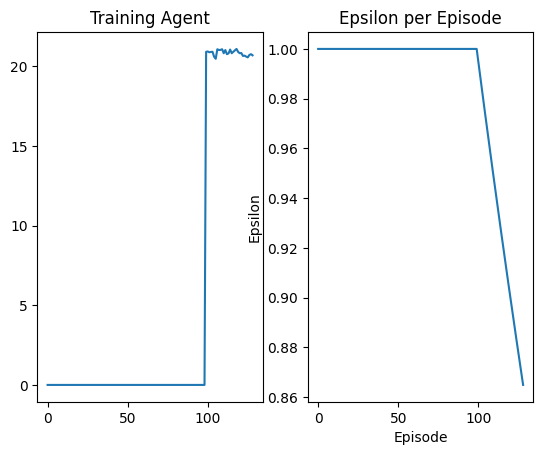

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 129 Duration 14 steps | epsilon 0.8605687278445528


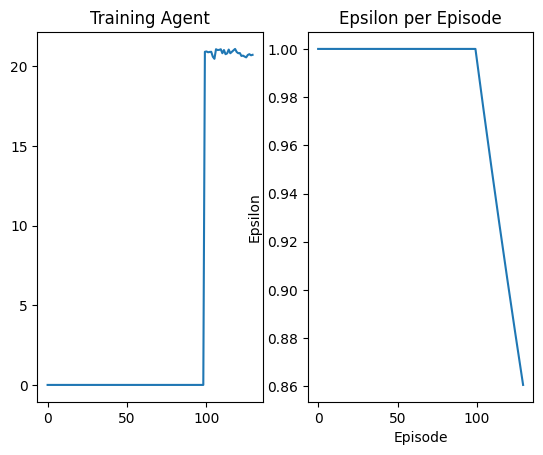

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 130 Duration 15 steps | epsilon 0.8562720053251942


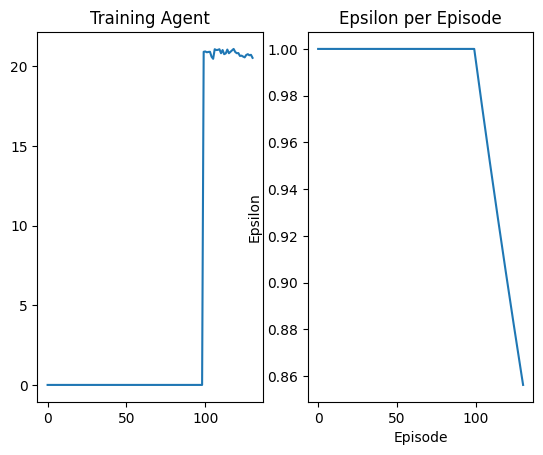

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 131 Duration 22 steps | epsilon 0.8519967358563718


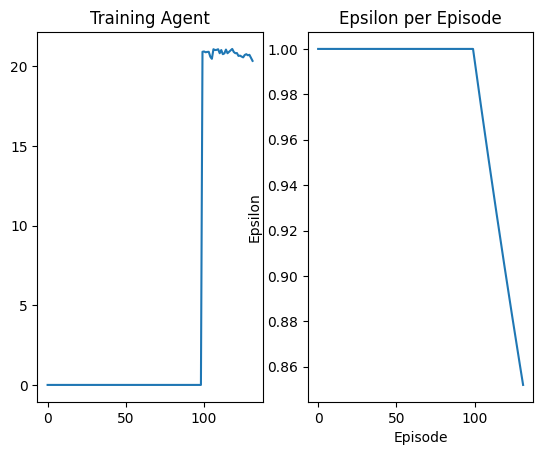

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 132 Duration 22 steps | epsilon 0.8477428123254259


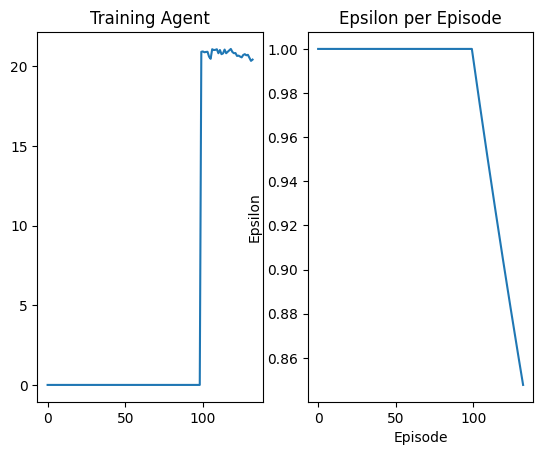

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 133 Duration 74 steps | epsilon 0.8435101281544981


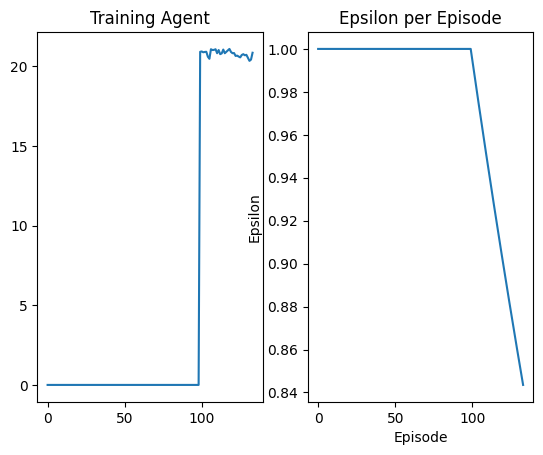

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 134 Duration 23 steps | epsilon 0.8392985772978613


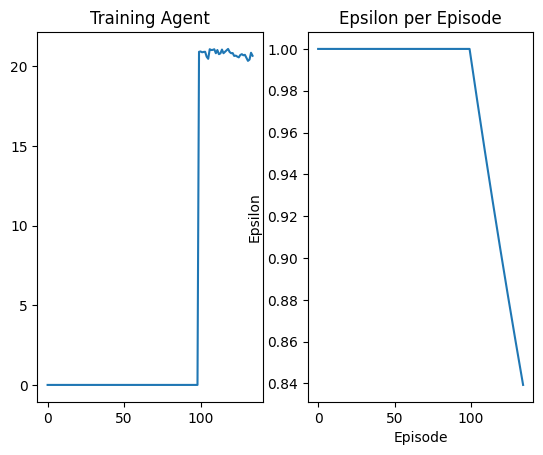

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 135 Duration 16 steps | epsilon 0.8351080542392627


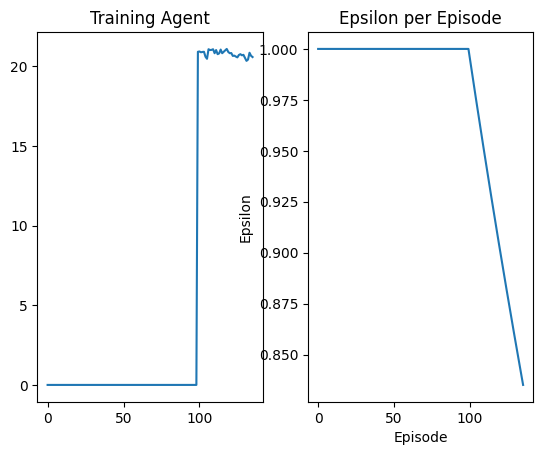

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 136 Duration 10 steps | epsilon 0.8309384539892803


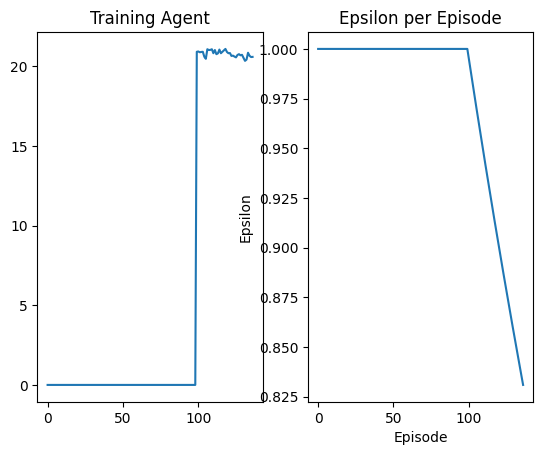

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 137 Duration 13 steps | epsilon 0.8267896720826925


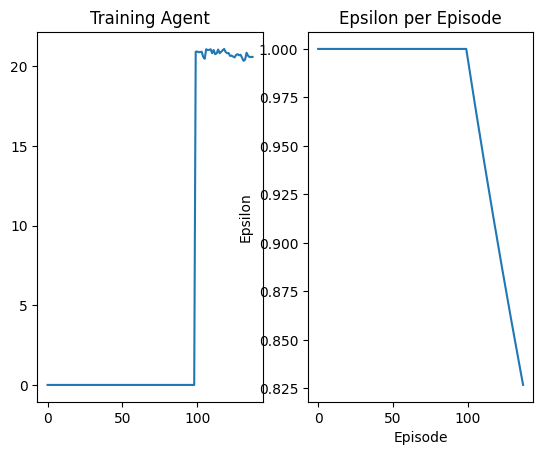

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 138 Duration 15 steps | epsilon 0.8226616045758605


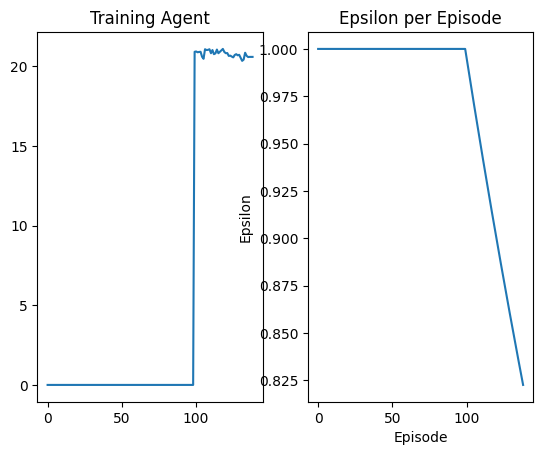

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 139 Duration 21 steps | epsilon 0.8185541480441245


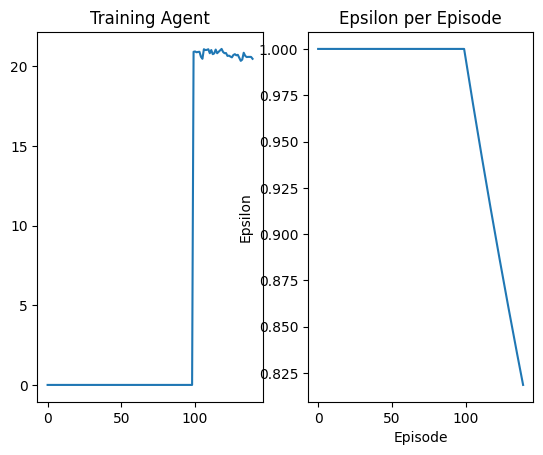

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 140 Duration 17 steps | epsilon 0.8144671995792124


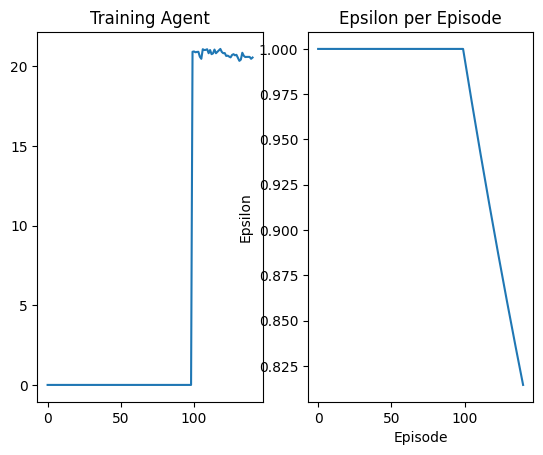

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 141 Duration 14 steps | epsilon 0.8104006567866615


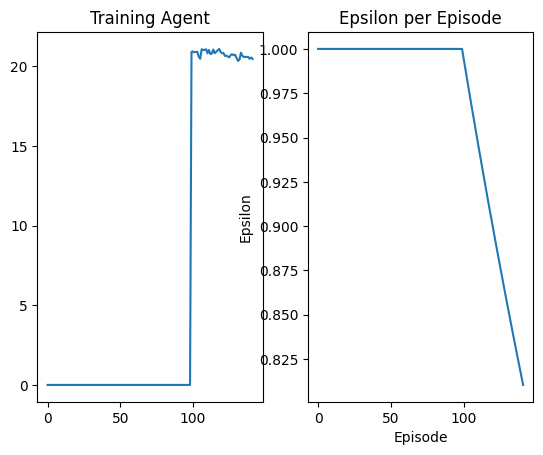

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 142 Duration 18 steps | epsilon 0.806354417783253


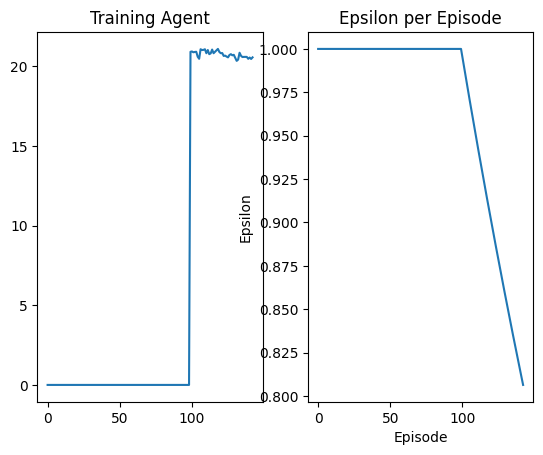

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 143 Duration 53 steps | epsilon 0.8023283811944595


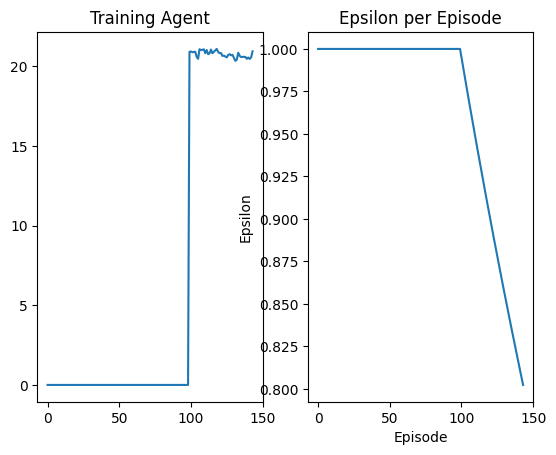

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 144 Duration 19 steps | epsilon 0.7983224461519053


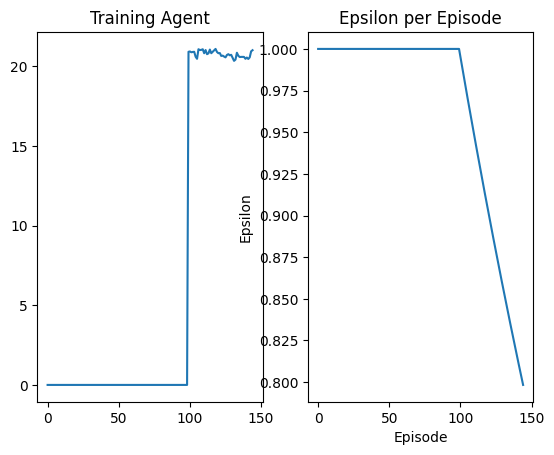

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 145 Duration 42 steps | epsilon 0.7943365122908389


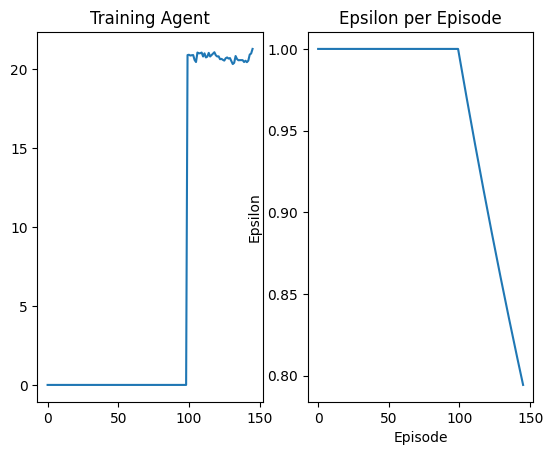

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 146 Duration 29 steps | epsilon 0.790370479747619


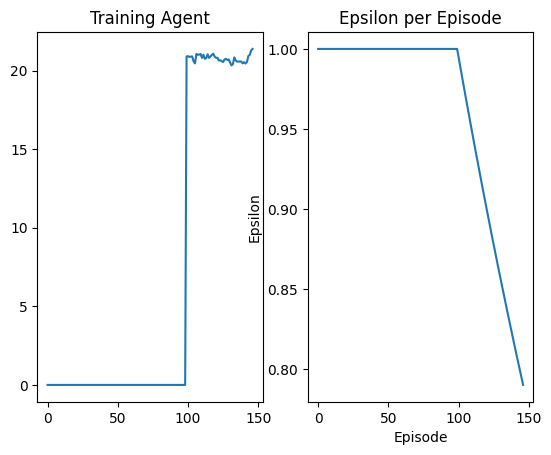

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 147 Duration 48 steps | epsilon 0.7864242491572119


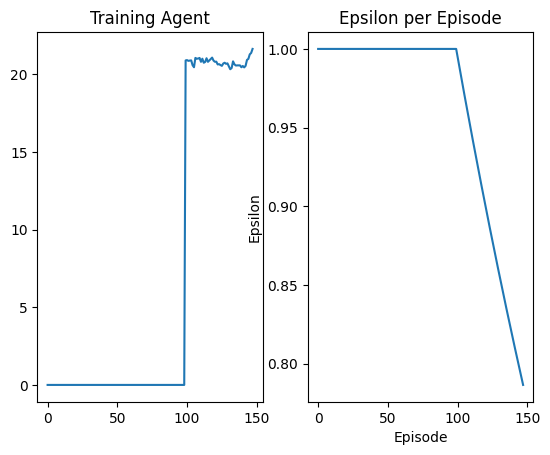

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 148 Duration 23 steps | epsilon 0.7824977216507024


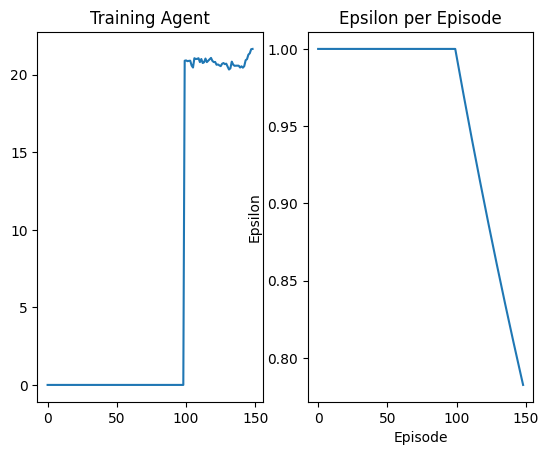

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 149 Duration 20 steps | epsilon 0.7785907988528167


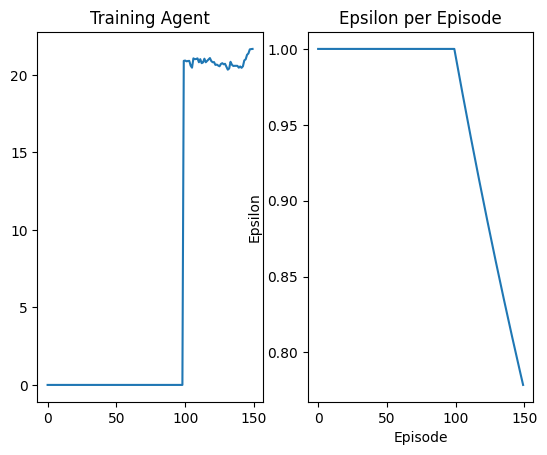

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 150 Duration 18 steps | epsilon 0.7747033828794574


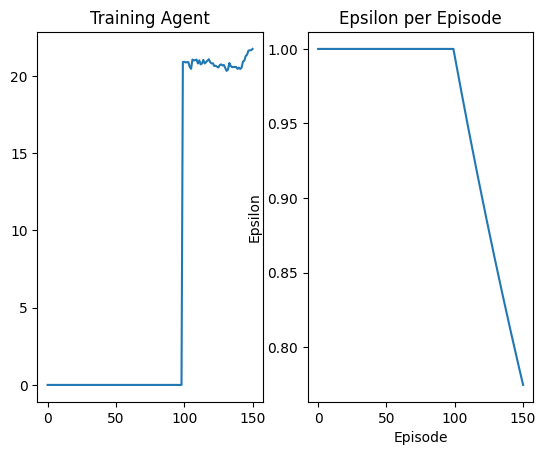

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 151 Duration 14 steps | epsilon 0.7708353763352517


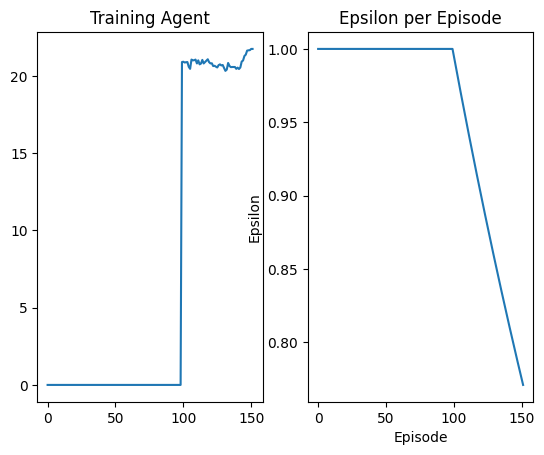

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 152 Duration 13 steps | epsilon 0.7669866823111107


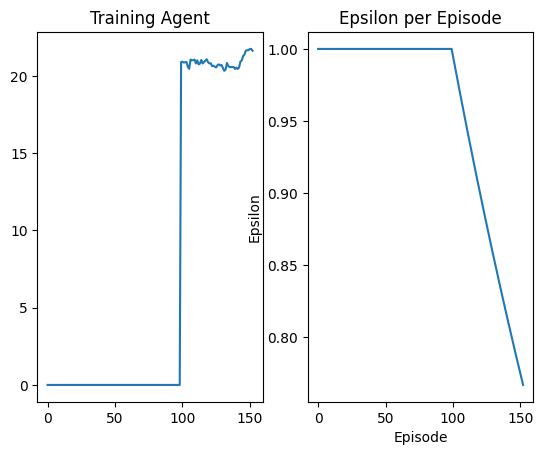

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 153 Duration 48 steps | epsilon 0.7631572043818016


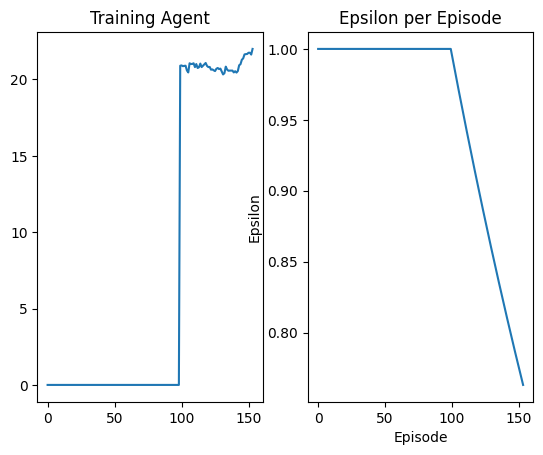

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 154 Duration 9 steps | epsilon 0.7593468466035319


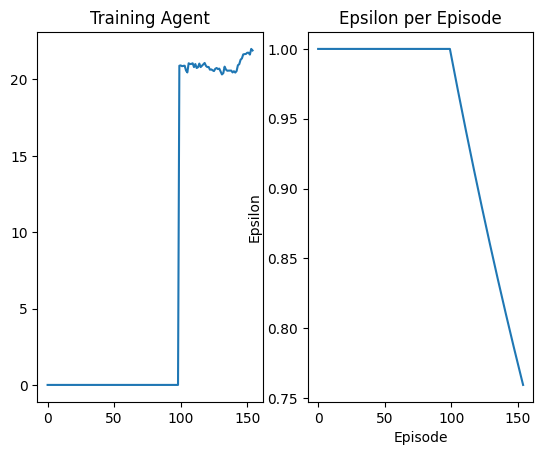

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 155 Duration 42 steps | epsilon 0.7555555135115458


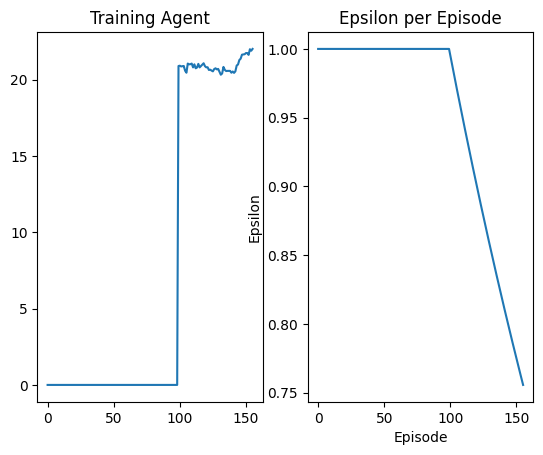

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 156 Duration 14 steps | epsilon 0.7517831101177322


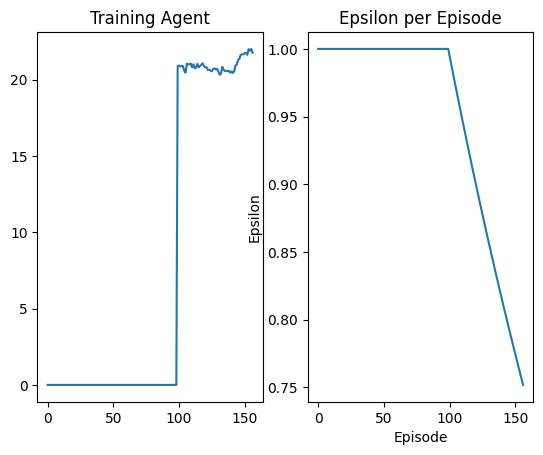

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 157 Duration 21 steps | epsilon 0.7480295419082448


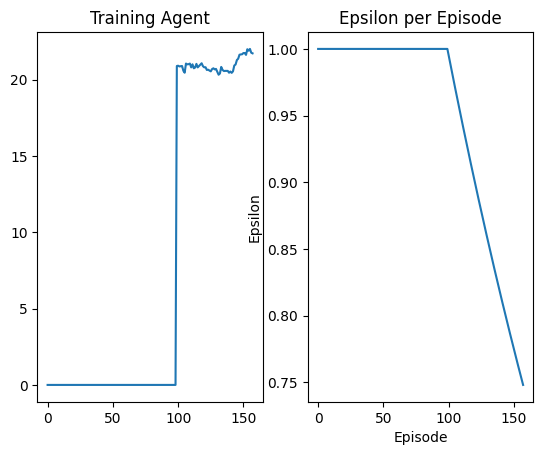

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 158 Duration 14 steps | epsilon 0.7442947148411343


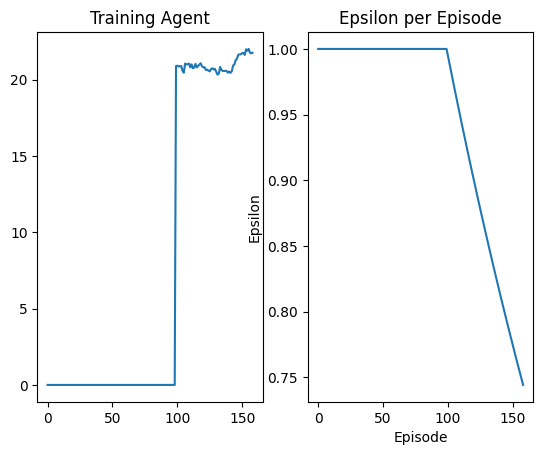

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 159 Duration 19 steps | epsilon 0.7405785353439922


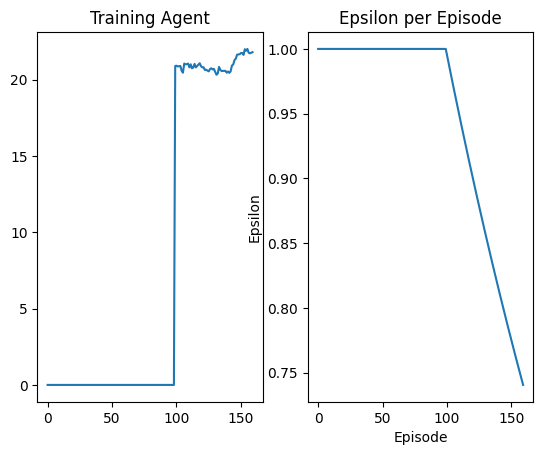

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 160 Duration 23 steps | epsilon 0.7368809103116066


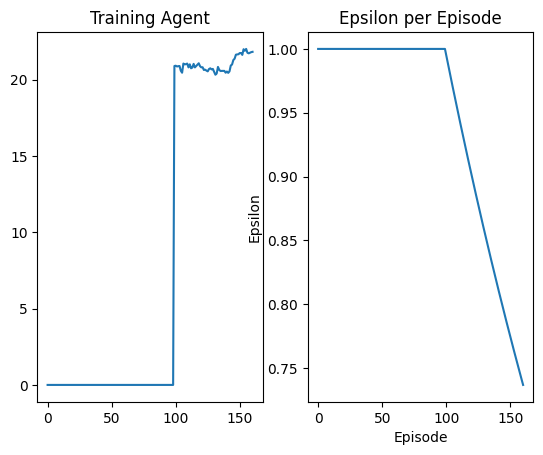

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 161 Duration 15 steps | epsilon 0.7332017471036295


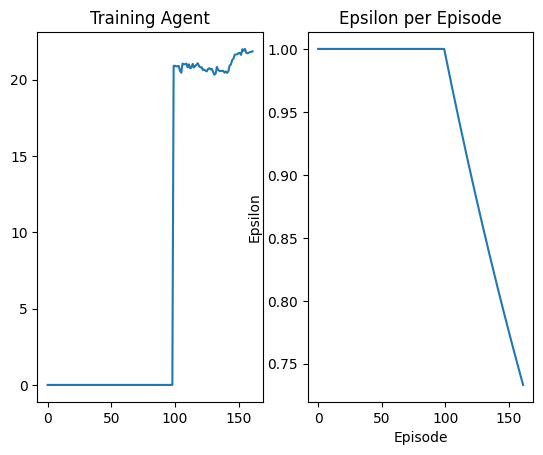

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 162 Duration 10 steps | epsilon 0.7295409535422553


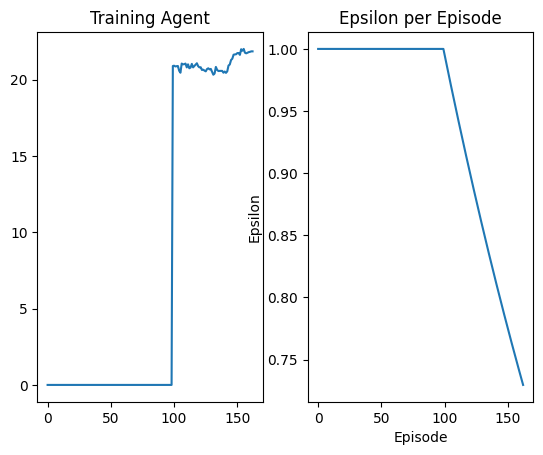

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 163 Duration 38 steps | epsilon 0.7258984379099123


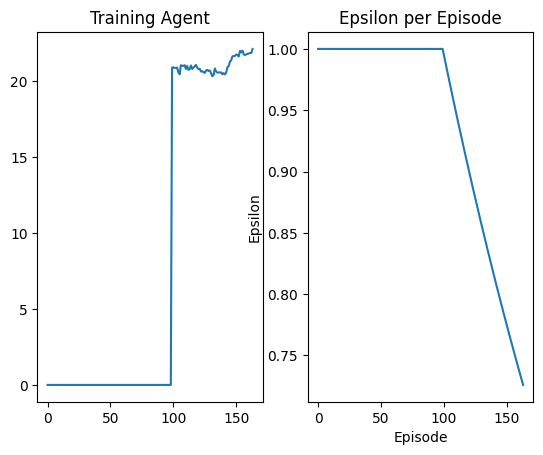

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 164 Duration 38 steps | epsilon 0.7222741089469638


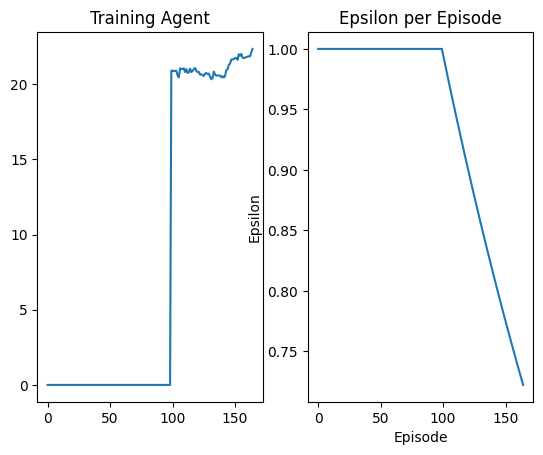

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 165 Duration 41 steps | epsilon 0.7186678758494224


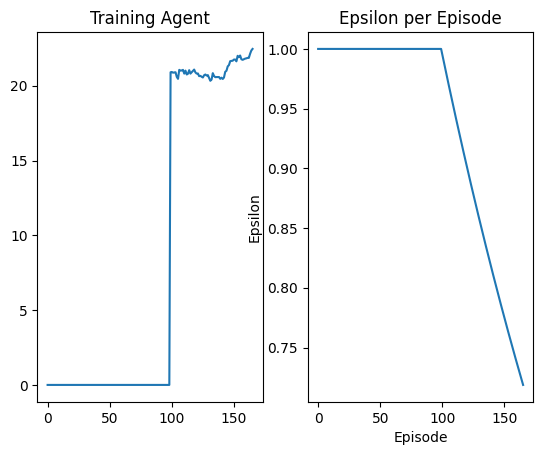

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 166 Duration 12 steps | epsilon 0.7150796482666747


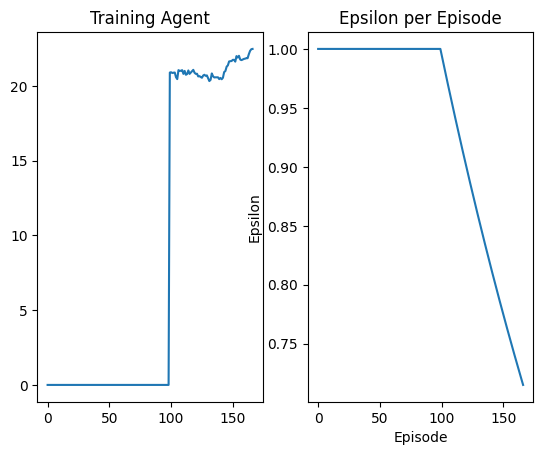

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 167 Duration 26 steps | epsilon 0.7115093362992179


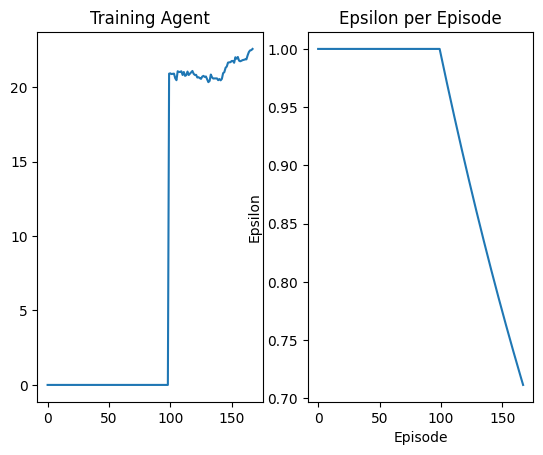

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 168 Duration 25 steps | epsilon 0.707956850496407


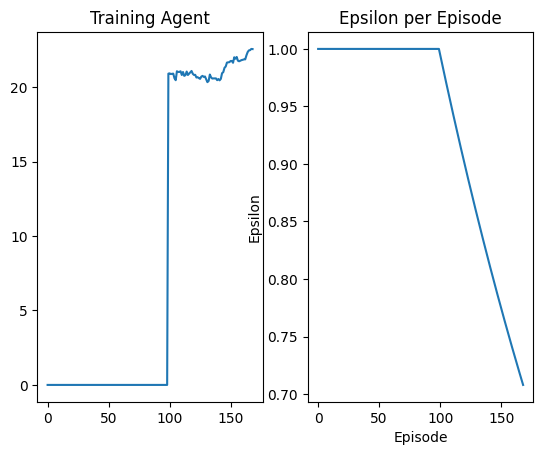

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 169 Duration 29 steps | epsilon 0.7044221018542142


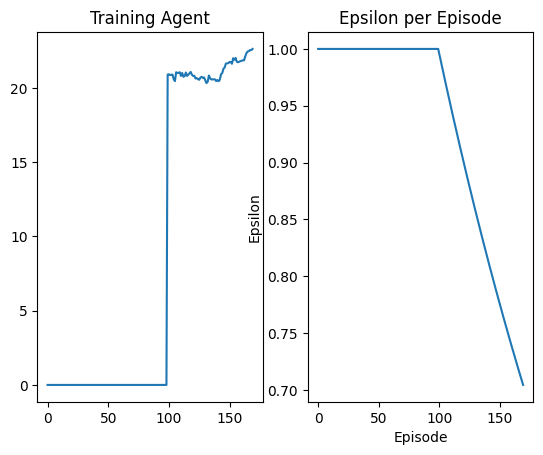

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 170 Duration 15 steps | epsilon 0.7009050018129985


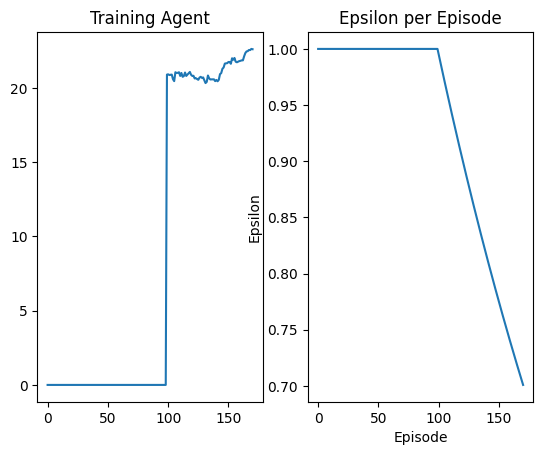

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 171 Duration 36 steps | epsilon 0.6974054622552875


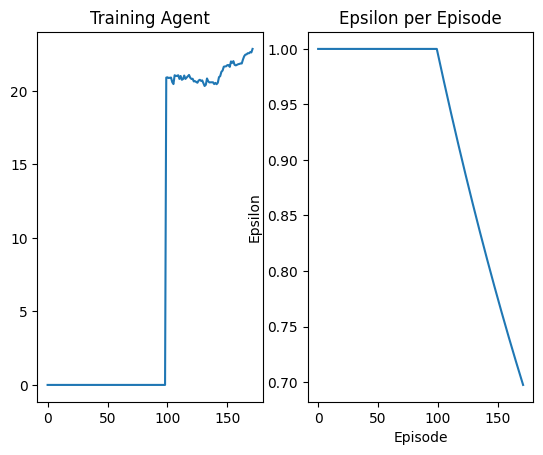

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 172 Duration 27 steps | epsilon 0.6939233955035692


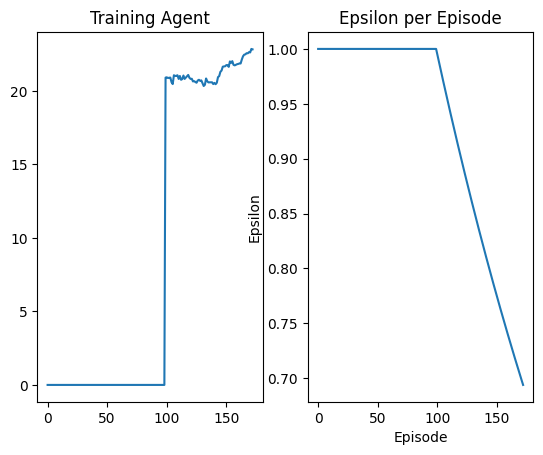

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 173 Duration 17 steps | epsilon 0.6904587143180956


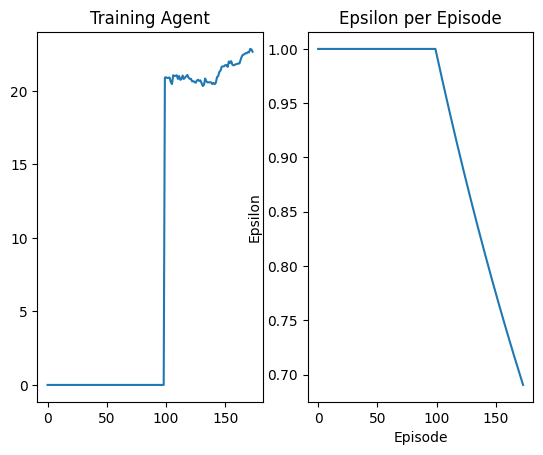

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 174 Duration 13 steps | epsilon 0.6870113318946968


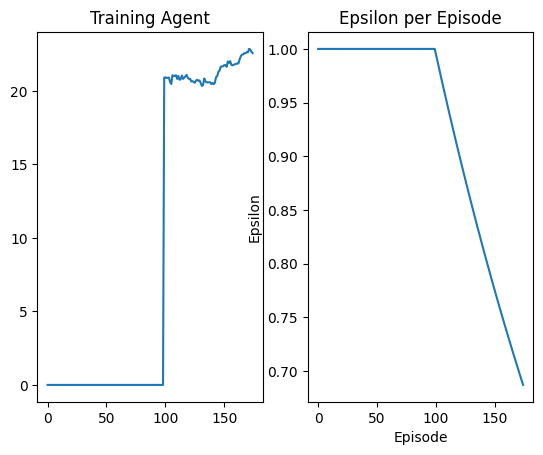

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 175 Duration 42 steps | epsilon 0.6835811618626064


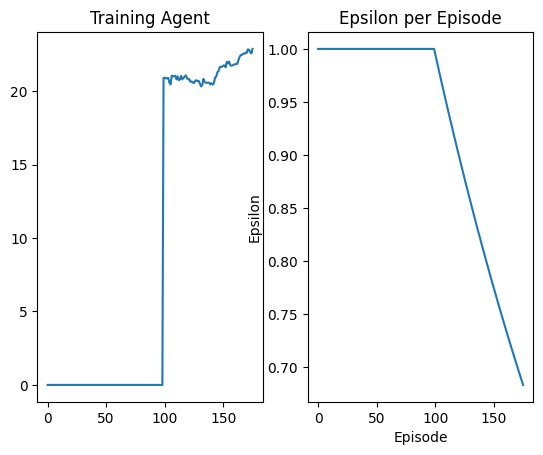

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 176 Duration 13 steps | epsilon 0.6801681182822975


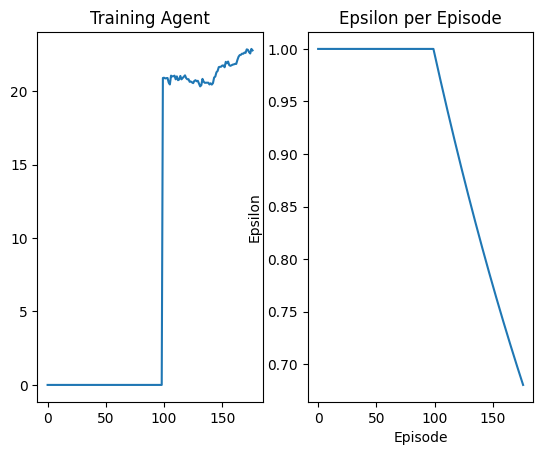

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 177 Duration 15 steps | epsilon 0.6767721156433296


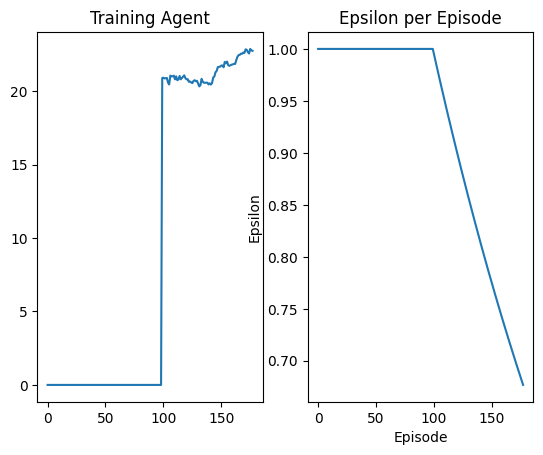

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 178 Duration 101 steps | epsilon 0.6733930688622061


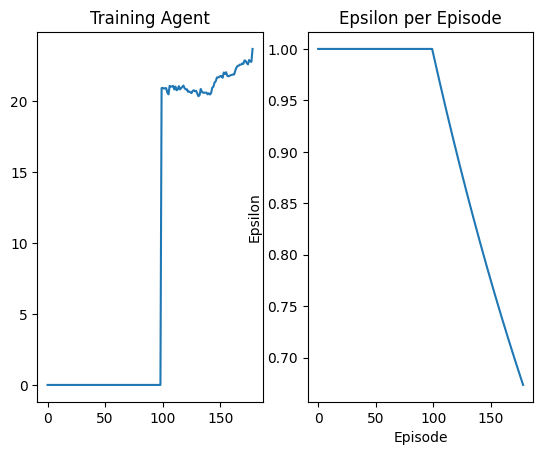

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 179 Duration 34 steps | epsilon 0.6700308932802427


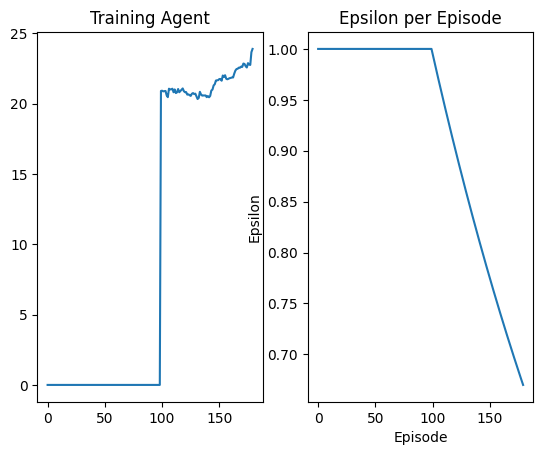

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 180 Duration 31 steps | epsilon 0.6666855046614463


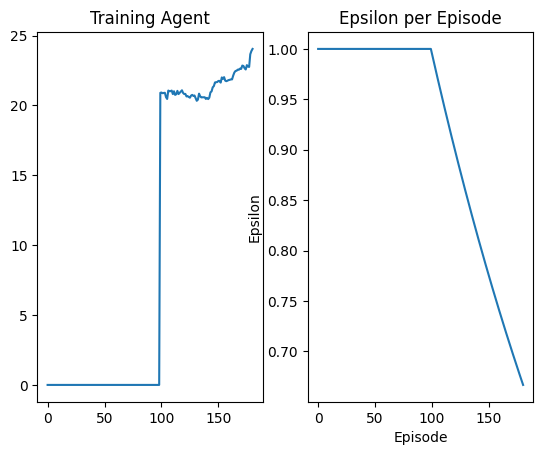

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 181 Duration 32 steps | epsilon 0.6633568191904048


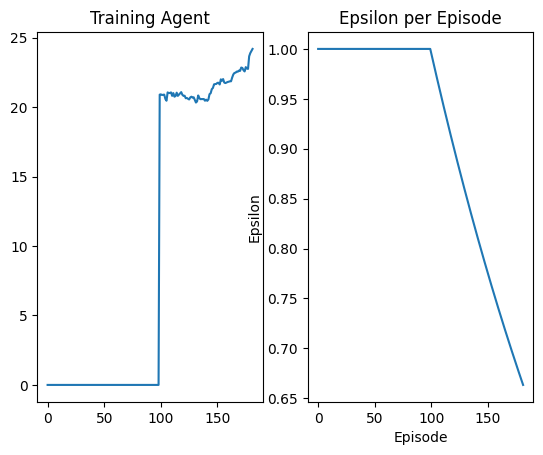

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 182 Duration 22 steps | epsilon 0.6600447534701868


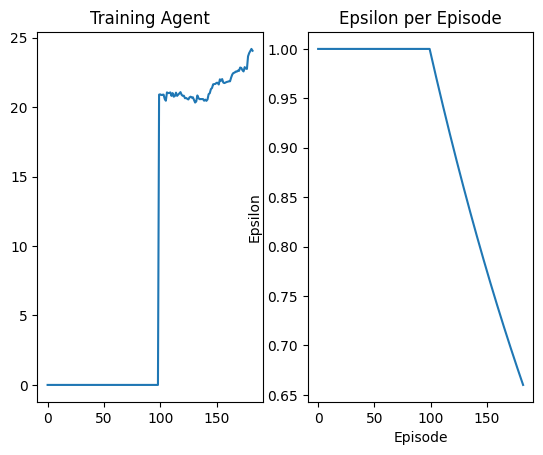

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 183 Duration 14 steps | epsilon 0.6567492245202524


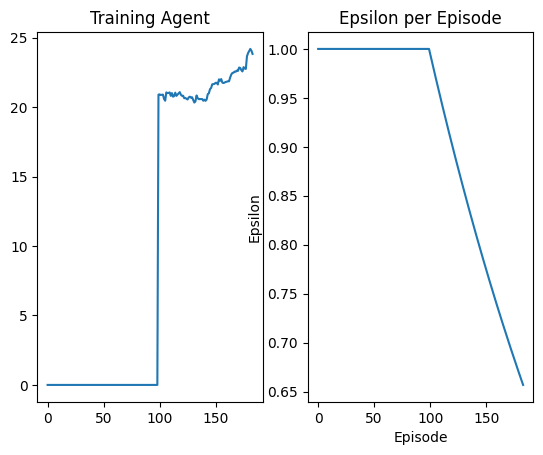

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 184 Duration 15 steps | epsilon 0.6534701497743743


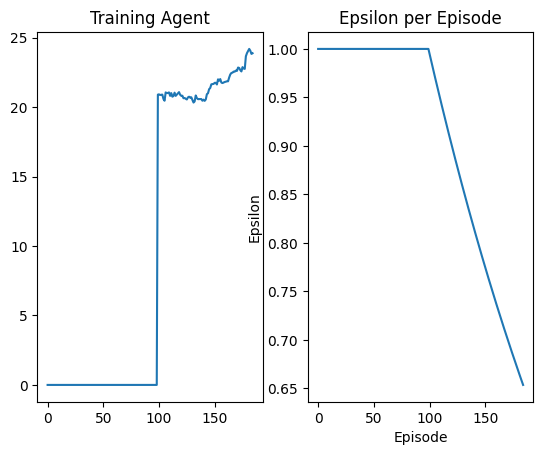

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 185 Duration 20 steps | epsilon 0.6502074470785689


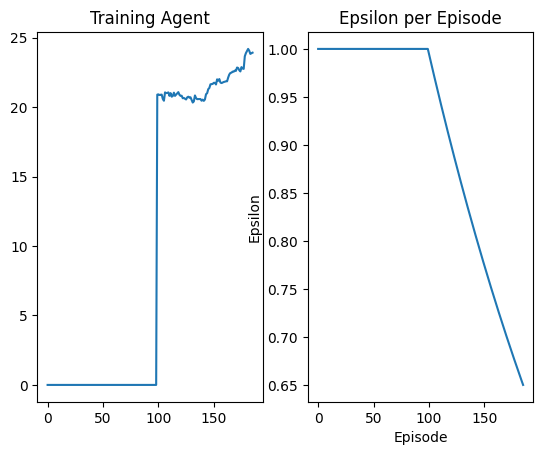

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 186 Duration 19 steps | epsilon 0.6469610346890382


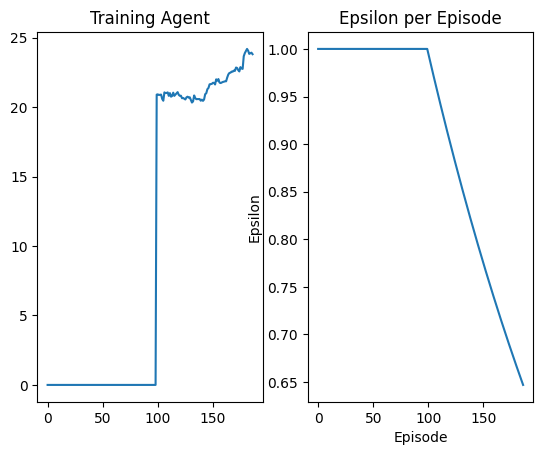

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 187 Duration 19 steps | epsilon 0.6437308312701219


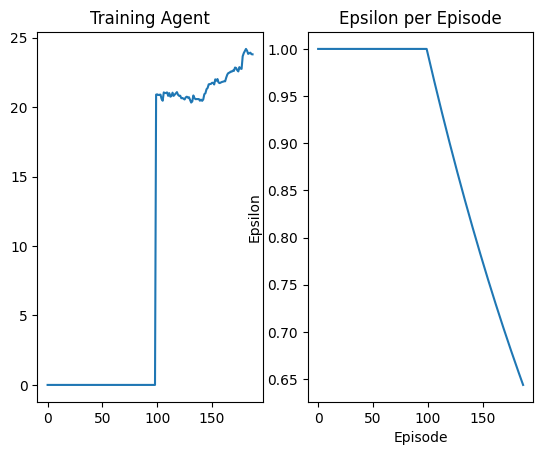

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 188 Duration 35 steps | epsilon 0.6405167558922592


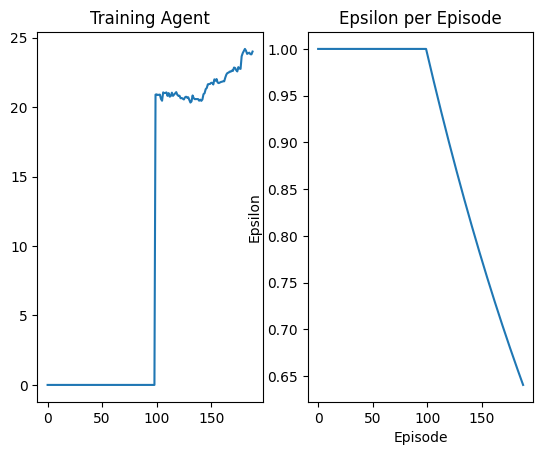

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 189 Duration 71 steps | epsilon 0.6373187280299617


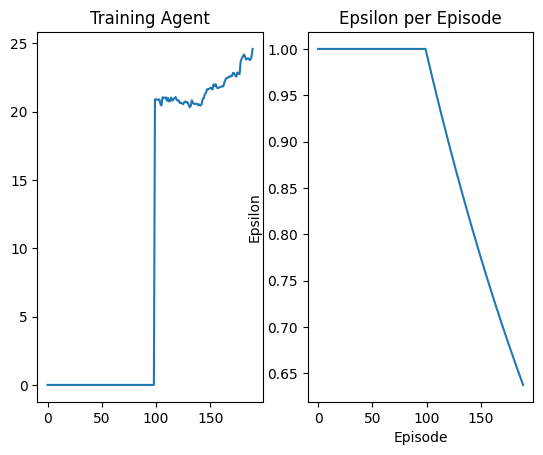

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 190 Duration 16 steps | epsilon 0.6341366675597955


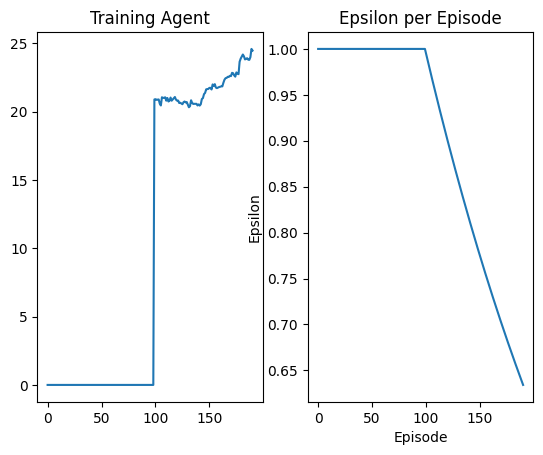

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 191 Duration 33 steps | epsilon 0.6309704947583741


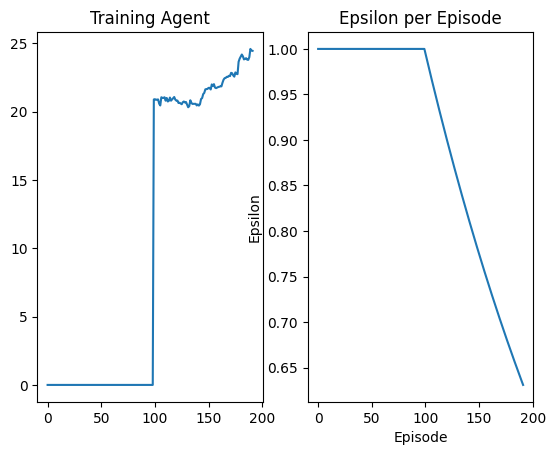

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 192 Duration 19 steps | epsilon 0.6278201303003608


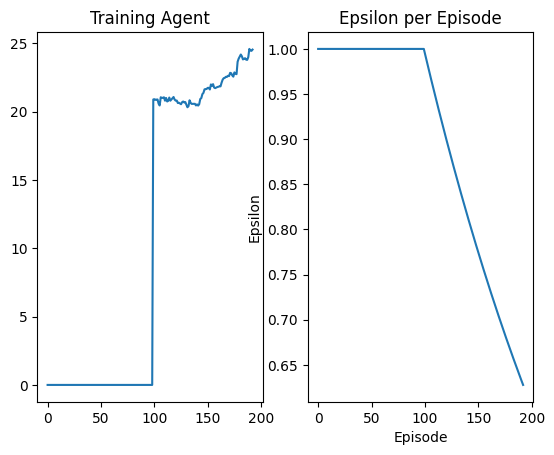

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 193 Duration 16 steps | epsilon 0.6246854952564813


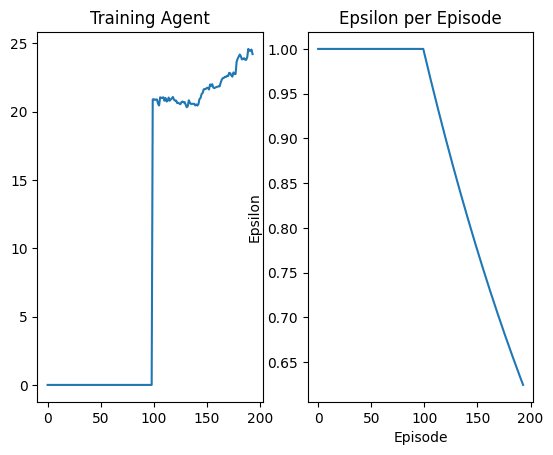

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 194 Duration 19 steps | epsilon 0.6215665110915465


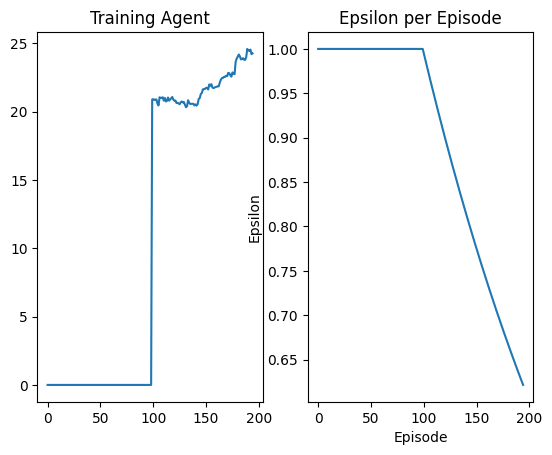

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 195 Duration 15 steps | epsilon 0.6184630996624844


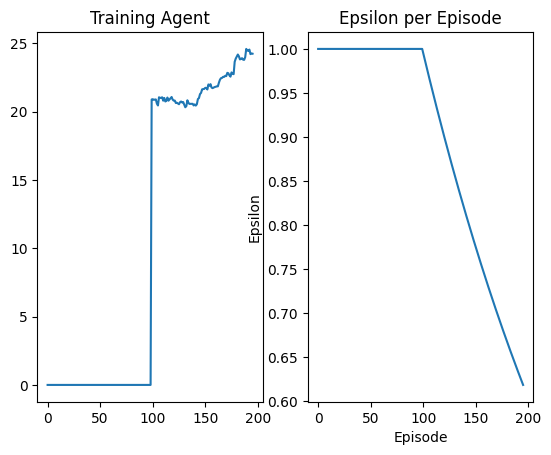

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 196 Duration 37 steps | epsilon 0.6153751832163825


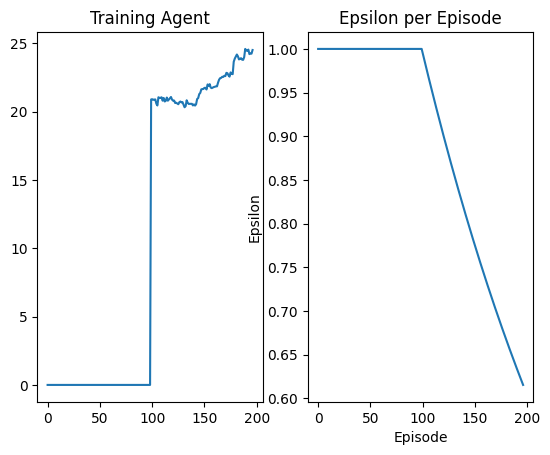

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 197 Duration 32 steps | epsilon 0.61230268438854


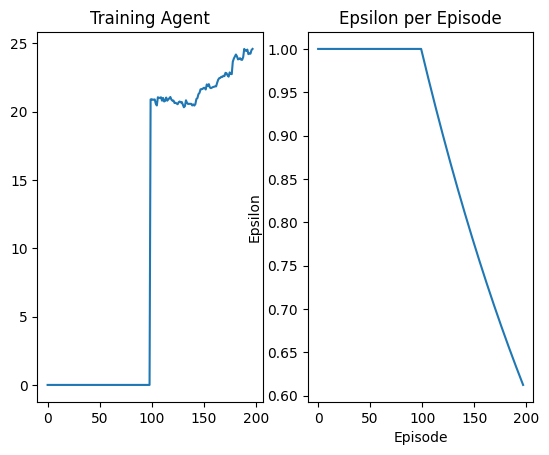

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 198 Duration 20 steps | epsilon 0.6092455262005292


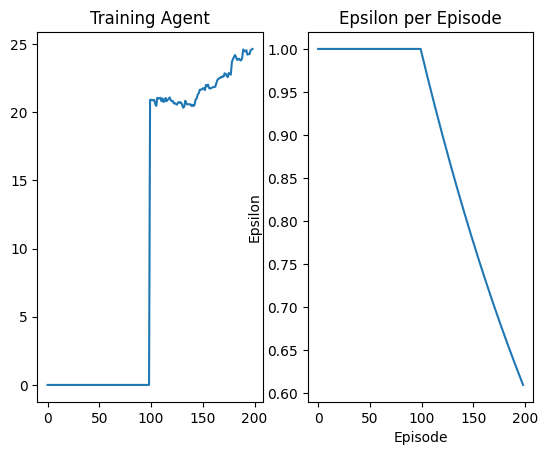

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 199 Duration 25 steps | epsilon 0.606203632058267


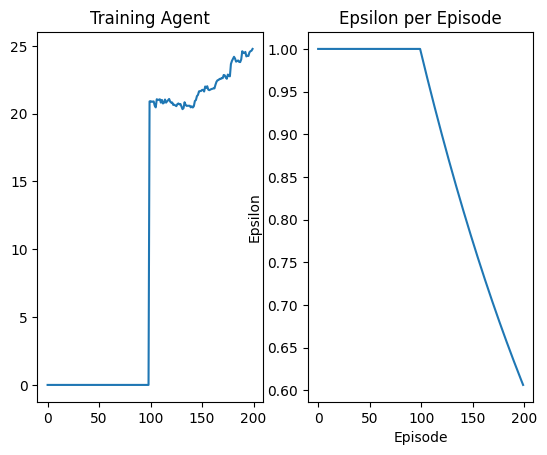

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 200 Duration 26 steps | epsilon 0.6031769257500961


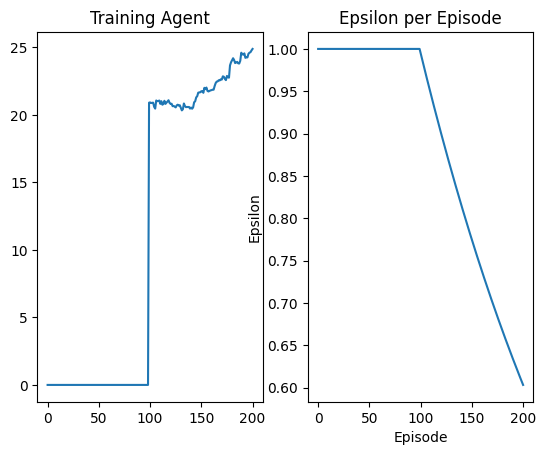

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 201 Duration 10 steps | epsilon 0.600165331444875


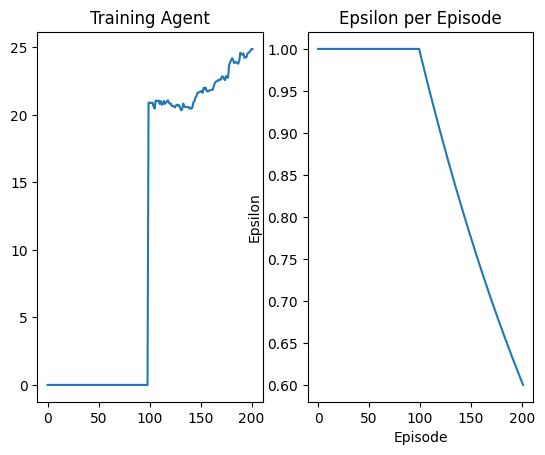

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 202 Duration 16 steps | epsilon 0.597168773690079


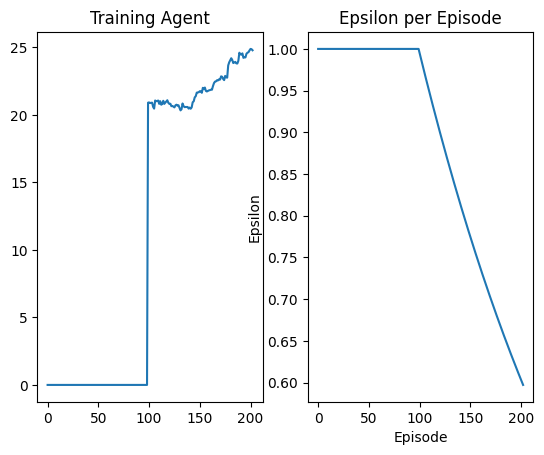

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 203 Duration 10 steps | epsilon 0.594187177409909


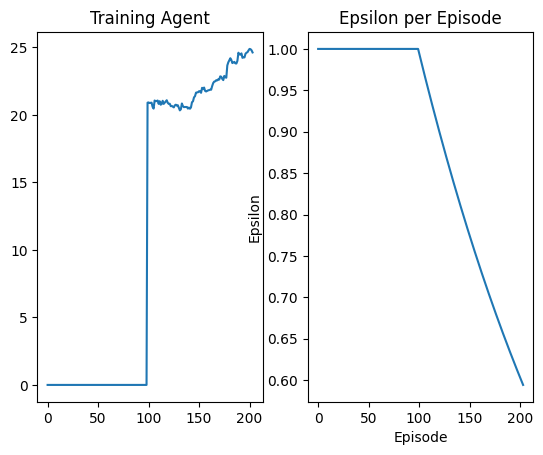

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 204 Duration 58 steps | epsilon 0.591220467903411


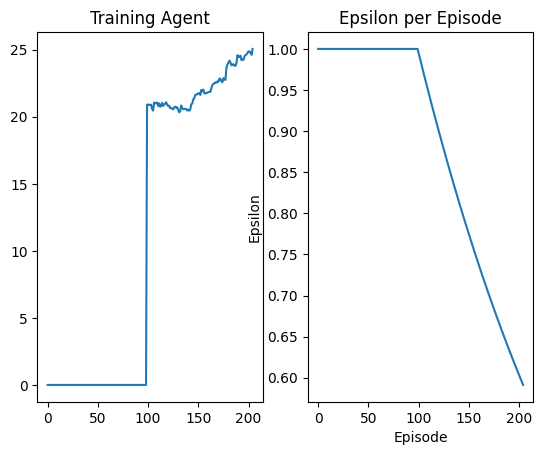

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 205 Duration 47 steps | epsilon 0.5882685708426044


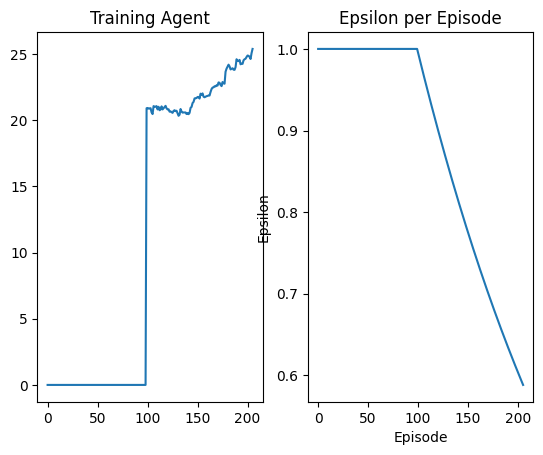

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 206 Duration 12 steps | epsilon 0.58533141227062


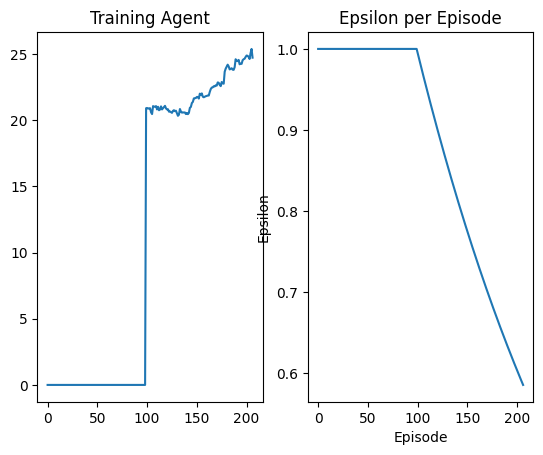

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 207 Duration 37 steps | epsilon 0.5824089185998467


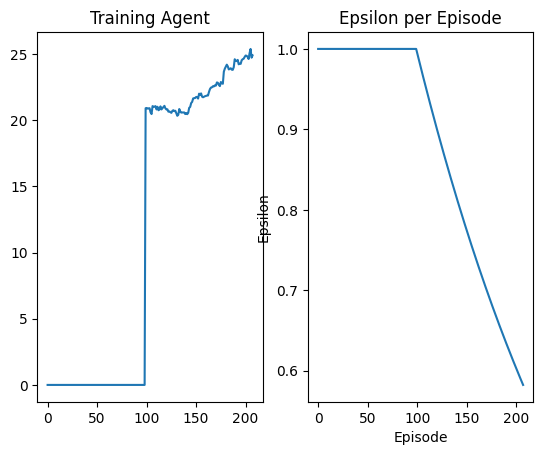

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 208 Duration 16 steps | epsilon 0.579501016610088


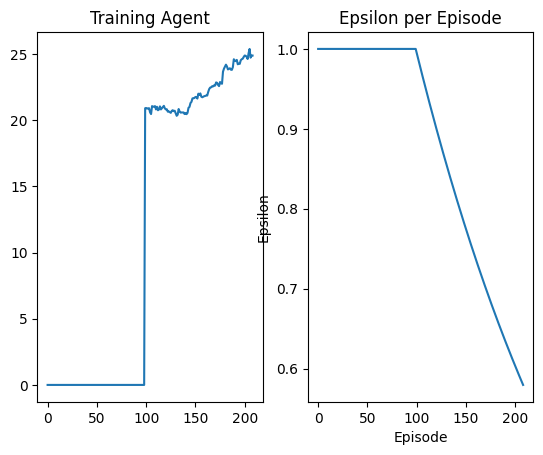

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 209 Duration 24 steps | epsilon 0.5766076334467277


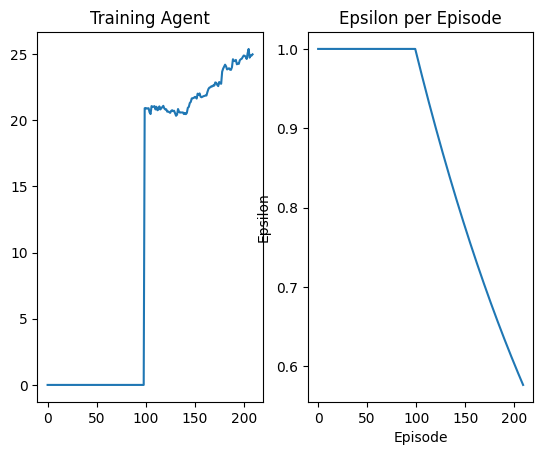

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 210 Duration 38 steps | epsilon 0.5737286966189045


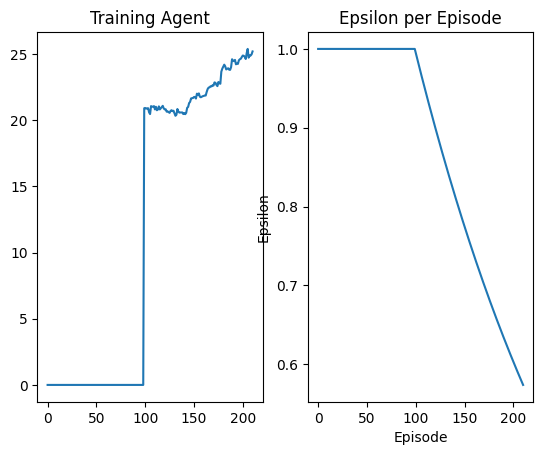

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 211 Duration 52 steps | epsilon 0.5708641339976956


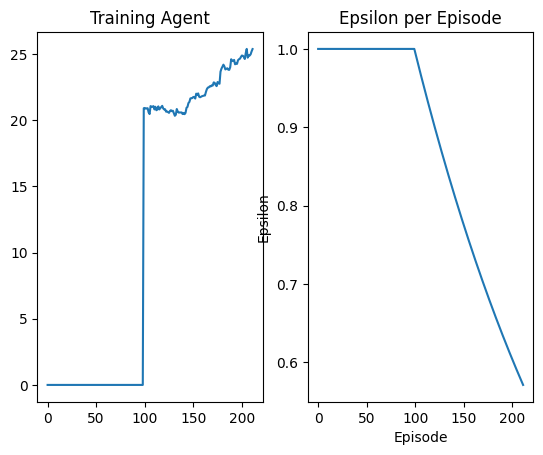

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 212 Duration 100 steps | epsilon 0.5680138738143101


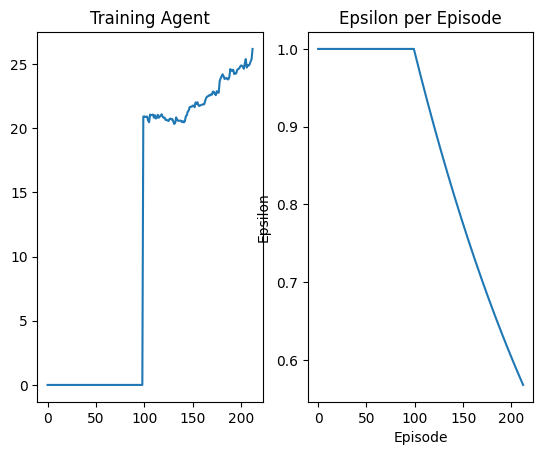

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 213 Duration 18 steps | epsilon 0.5651778446582902


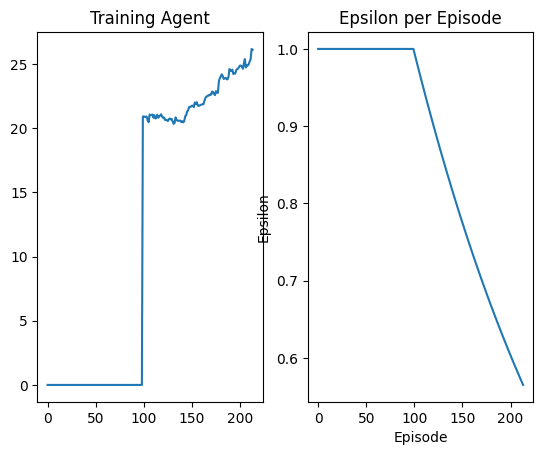

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 214 Duration 29 steps | epsilon 0.5623559754757227


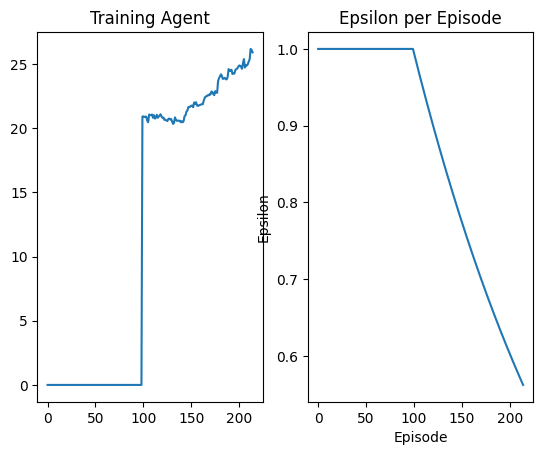

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 215 Duration 24 steps | epsilon 0.5595481955674585


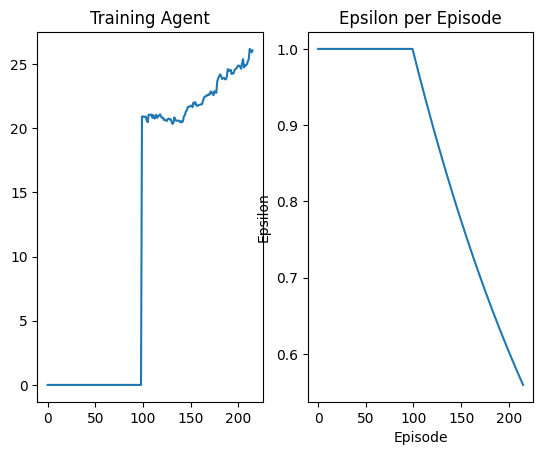

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 216 Duration 39 steps | epsilon 0.5567544345873413


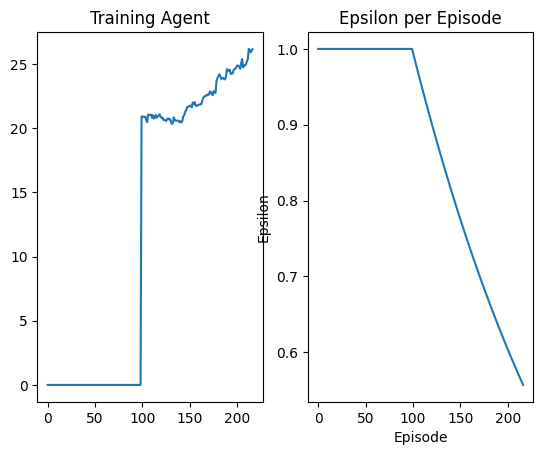

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 217 Duration 38 steps | epsilon 0.5539746225404454


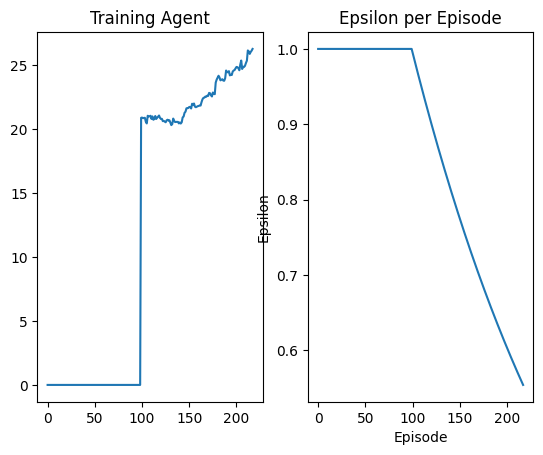

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 218 Duration 44 steps | epsilon 0.5512086897813215


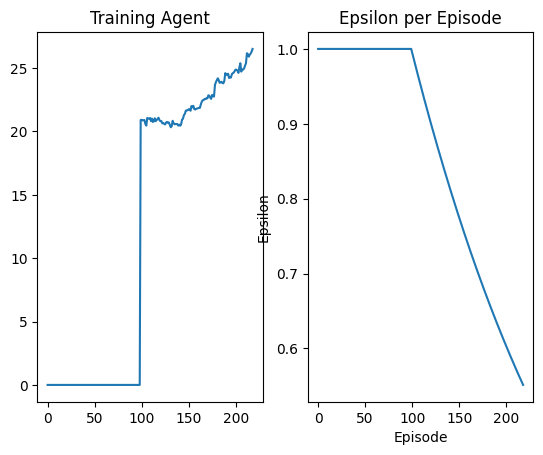

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 219 Duration 15 steps | epsilon 0.5484565670122526


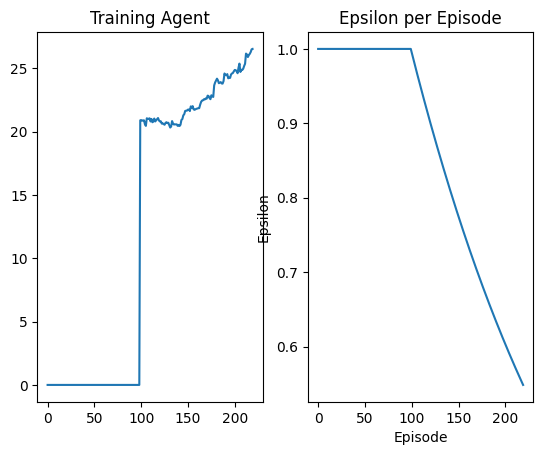

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 220 Duration 32 steps | epsilon 0.5457181852815173


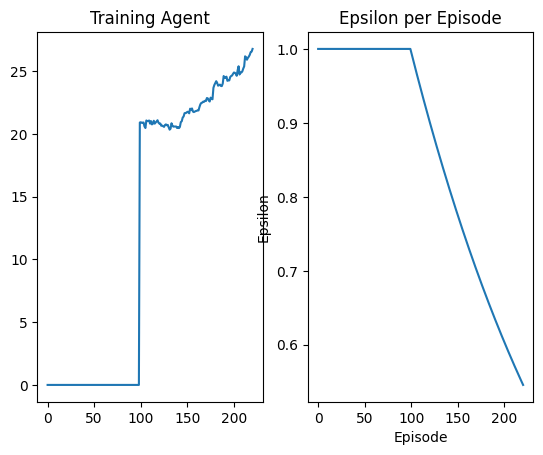

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 221 Duration 73 steps | epsilon 0.542993475981662


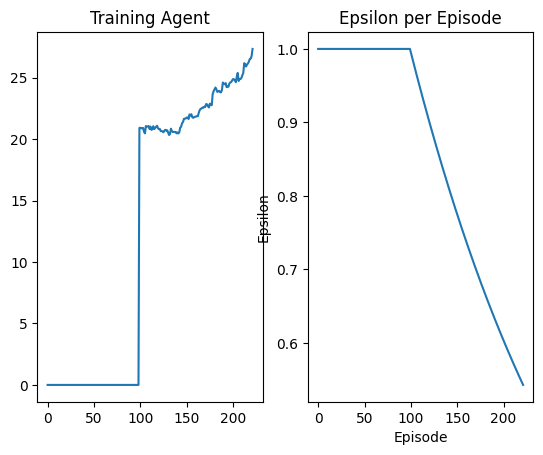

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 222 Duration 37 steps | epsilon 0.5402823708477829


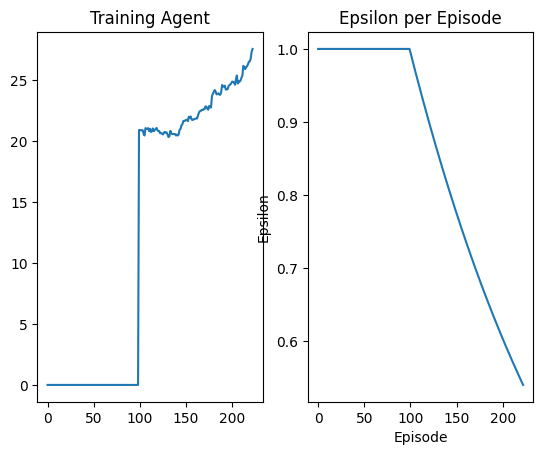

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 223 Duration 25 steps | epsilon 0.5375848019558146


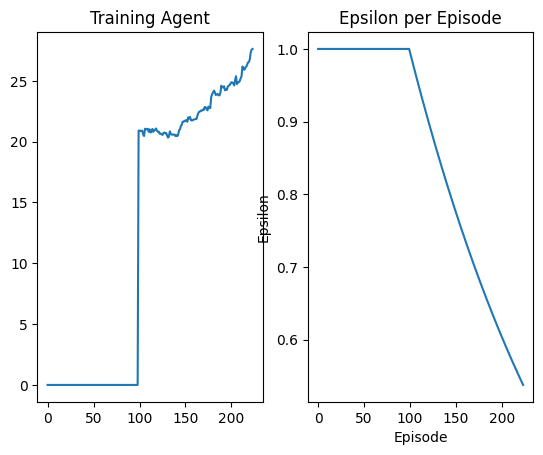

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 224 Duration 39 steps | epsilon 0.5349007017208294


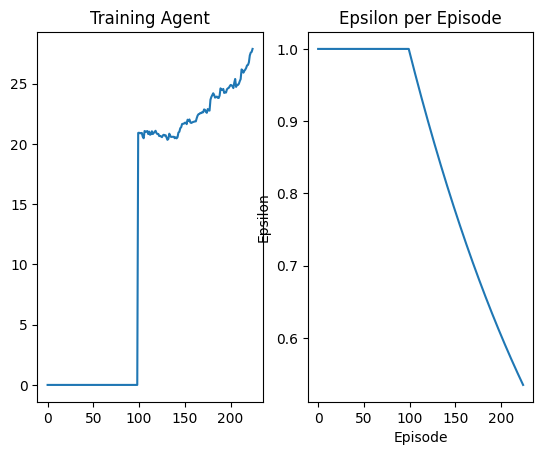

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 225 Duration 65 steps | epsilon 0.5322300028953432


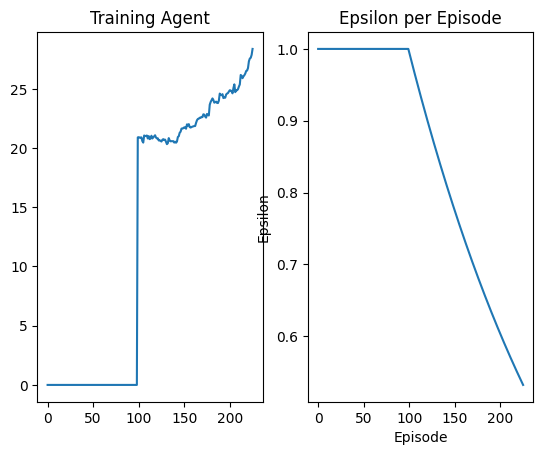

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 226 Duration 64 steps | epsilon 0.529572638567631


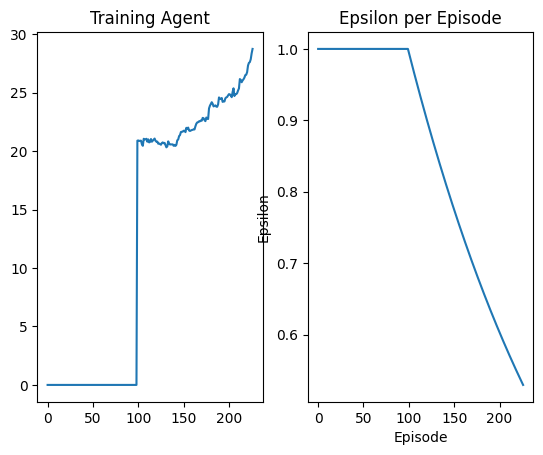

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 227 Duration 33 steps | epsilon 0.5269285421600507


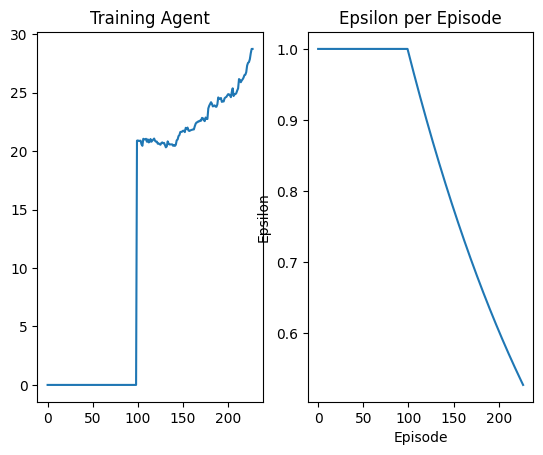

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 228 Duration 89 steps | epsilon 0.5242976474273747


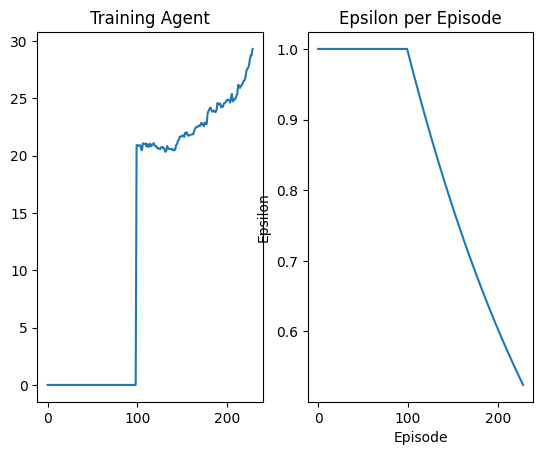

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 229 Duration 25 steps | epsilon 0.5216798884551304


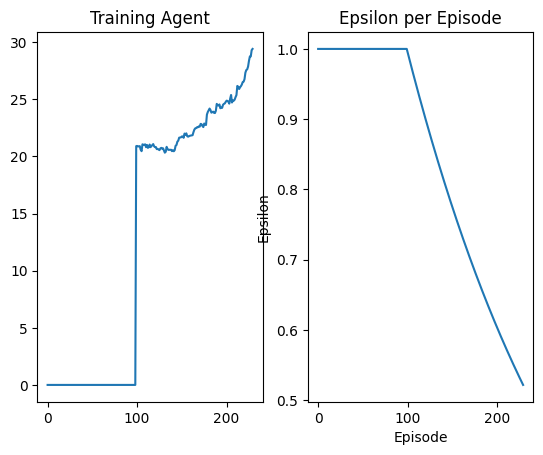

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 230 Duration 32 steps | epsilon 0.5190751996579486


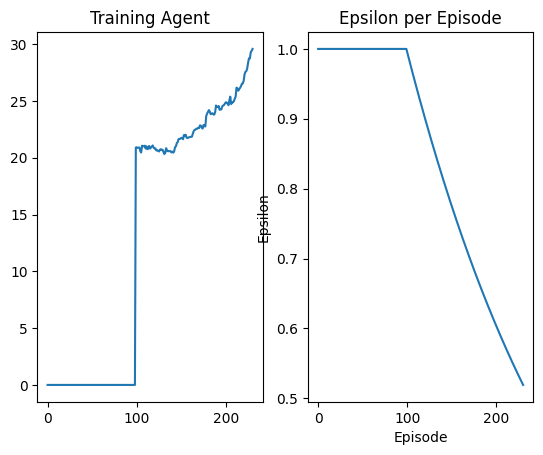

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 231 Duration 26 steps | epsilon 0.5164835157779206


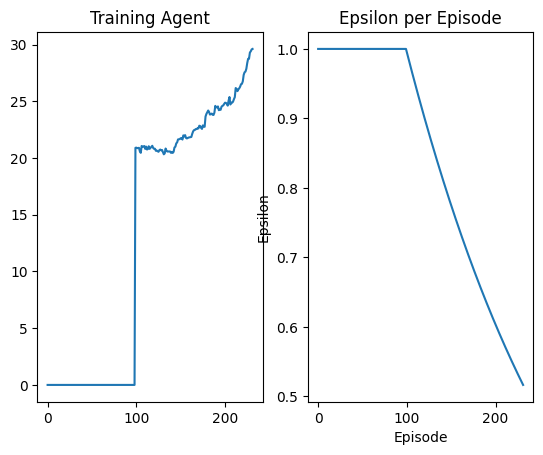

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 232 Duration 89 steps | epsilon 0.513904771882963


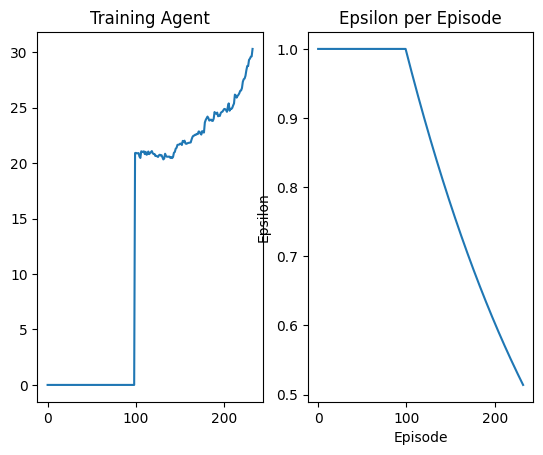

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 233 Duration 19 steps | epsilon 0.511338903365191


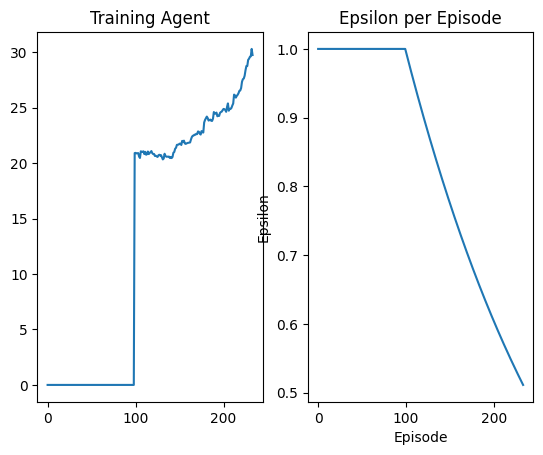

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 234 Duration 44 steps | epsilon 0.5087858459392998


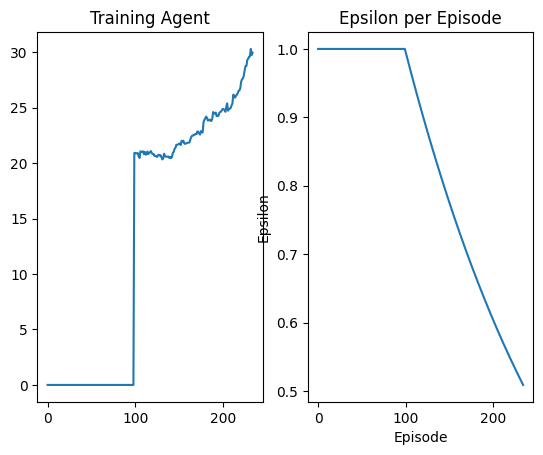

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 235 Duration 89 steps | epsilon 0.5062455356409534


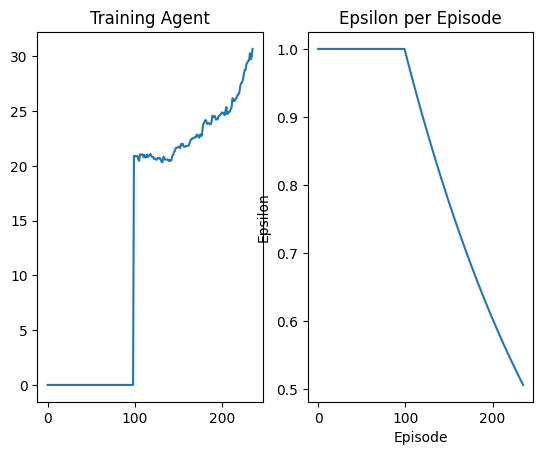

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 236 Duration 45 steps | epsilon 0.5037179088251831


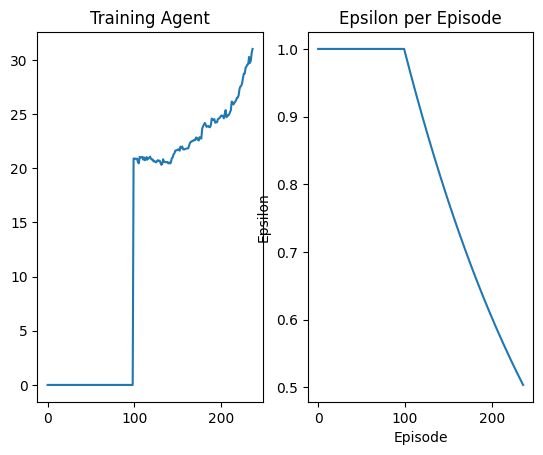

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 237 Duration 19 steps | epsilon 0.5012029021647919


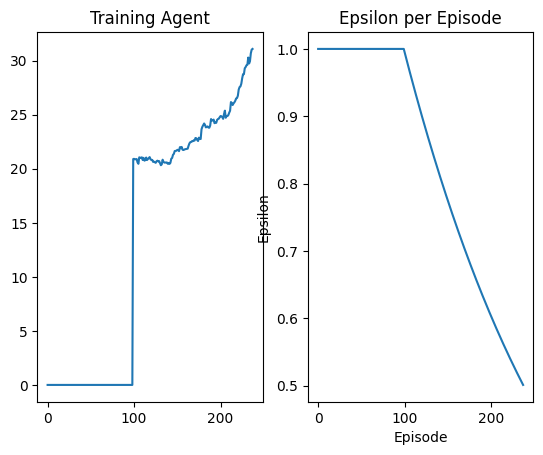

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 238 Duration 19 steps | epsilon 0.4987004526487686


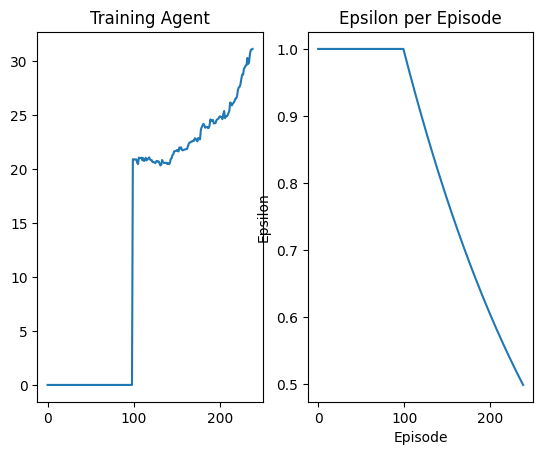

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 239 Duration 50 steps | epsilon 0.4962104975807088


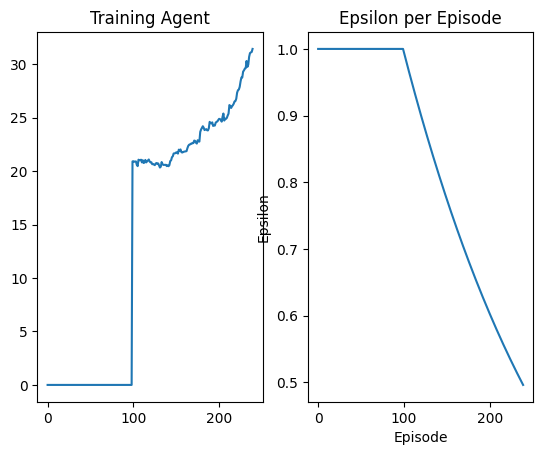

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 240 Duration 33 steps | epsilon 0.49373297457724413


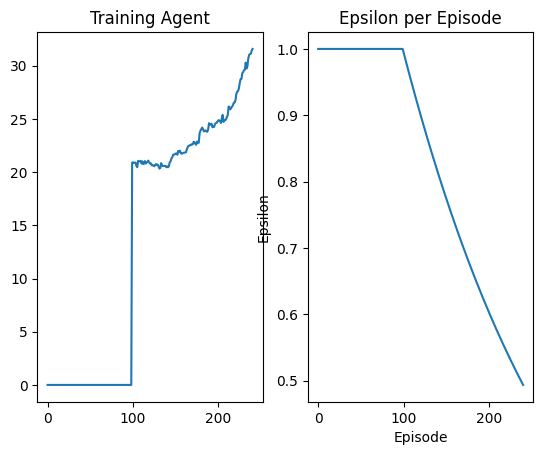

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 241 Duration 105 steps | epsilon 0.49126782156647936


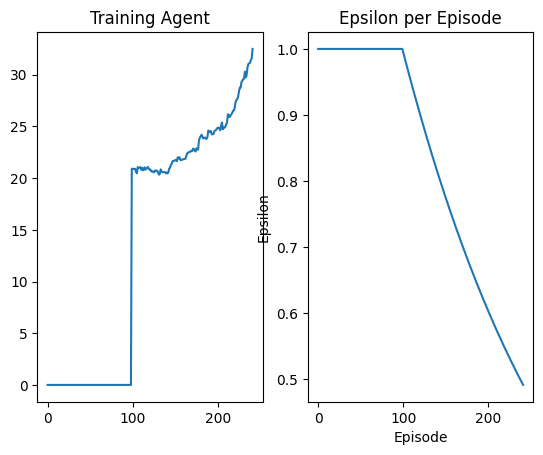

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 242 Duration 41 steps | epsilon 0.48881497678643726


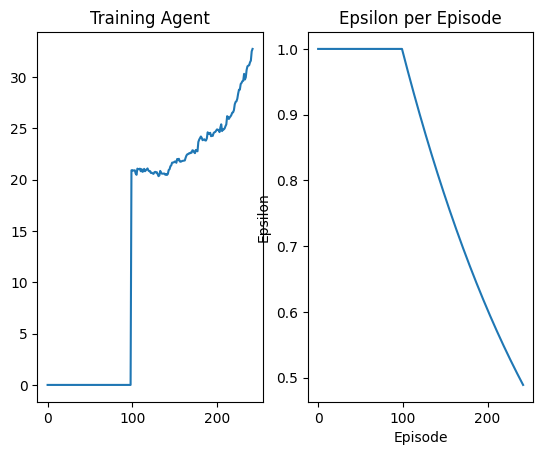

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 243 Duration 31 steps | epsilon 0.48637437878351114


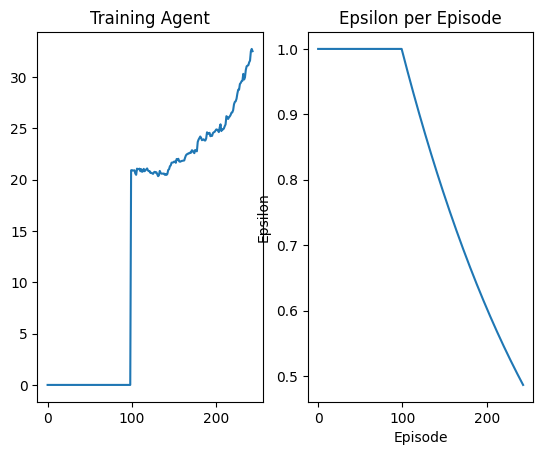

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 244 Duration 22 steps | epsilon 0.48394596641092524


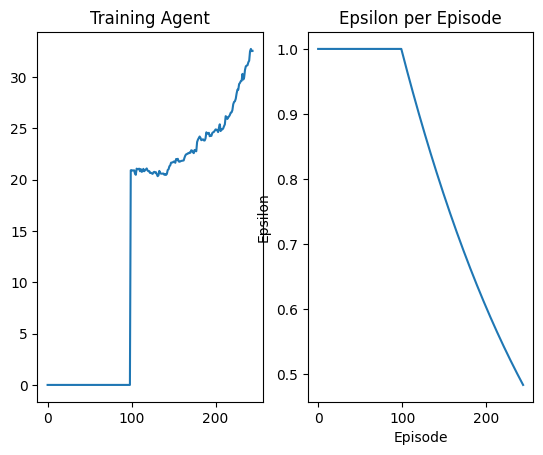

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 245 Duration 36 steps | epsilon 0.48152967882720277


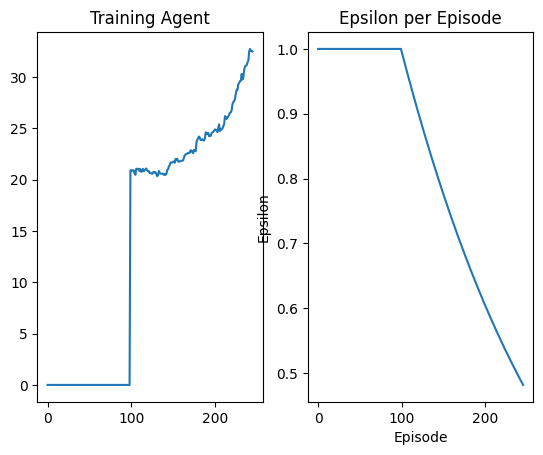

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 246 Duration 117 steps | epsilon 0.4791254554946416


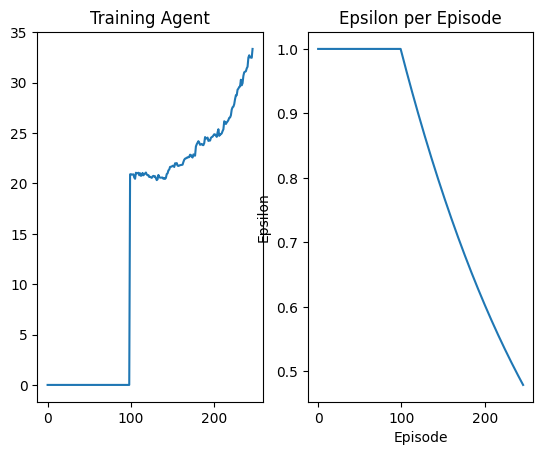

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 247 Duration 174 steps | epsilon 0.47673323617779734


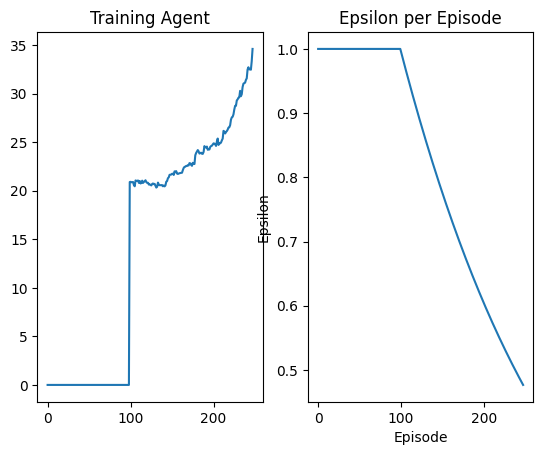

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 248 Duration 32 steps | epsilon 0.4743529609419746


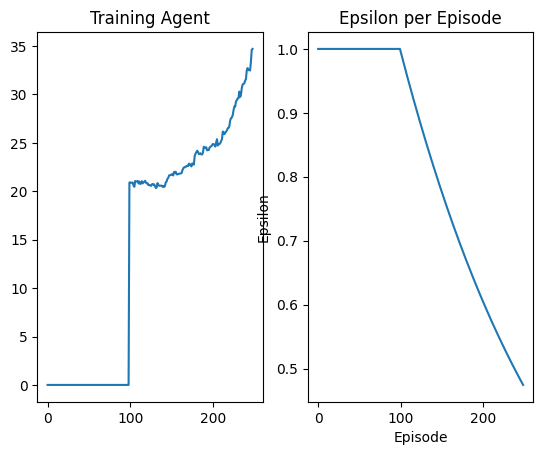

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 249 Duration 25 steps | epsilon 0.471984570151725


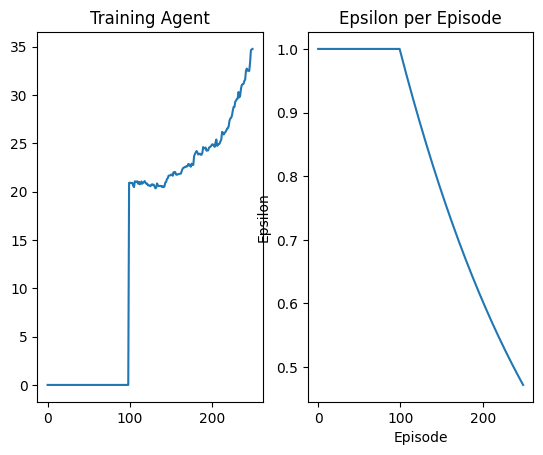

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 250 Duration 94 steps | epsilon 0.4696280044693533


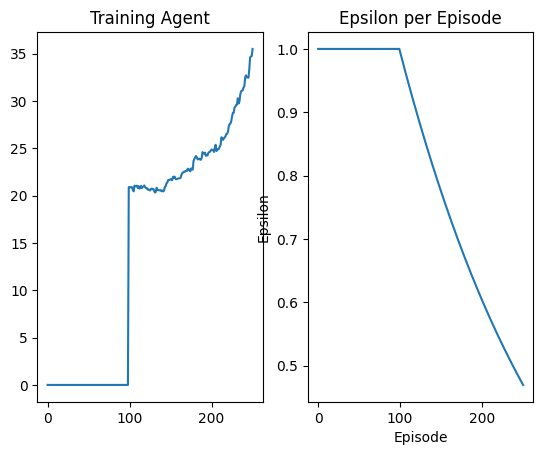

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 251 Duration 84 steps | epsilon 0.46728320485343067


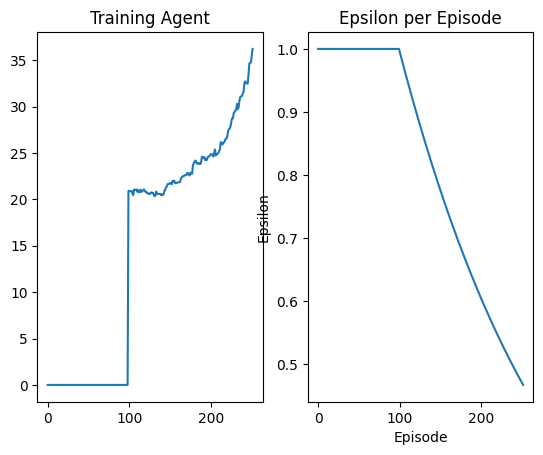

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 252 Duration 18 steps | epsilon 0.46495011255731544


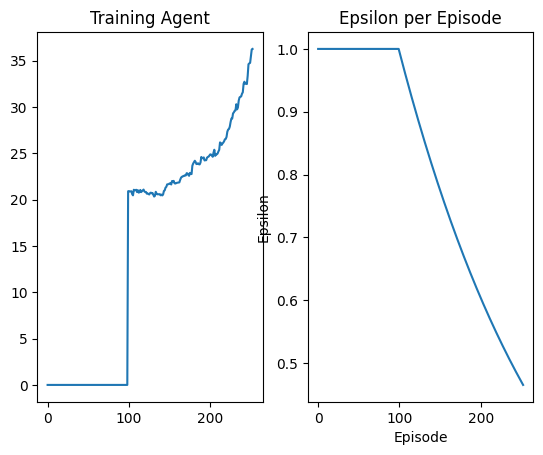

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 253 Duration 14 steps | epsilon 0.4626286691276813


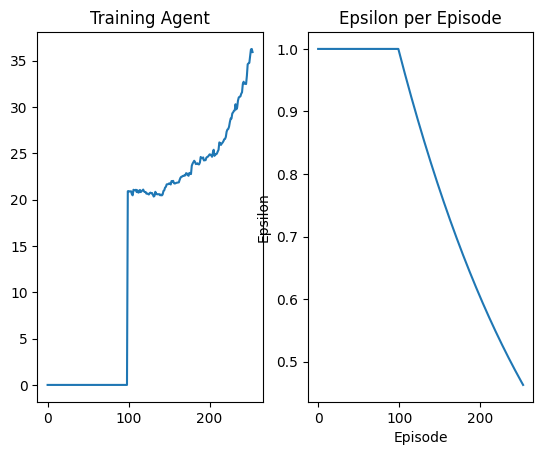

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 254 Duration 15 steps | epsilon 0.4603188164030528


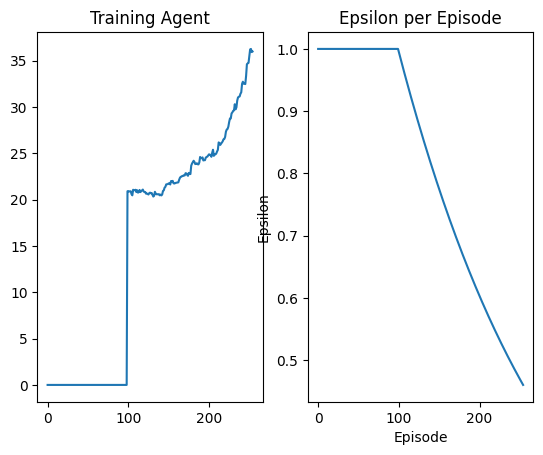

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 255 Duration 22 steps | epsilon 0.4580204965123481


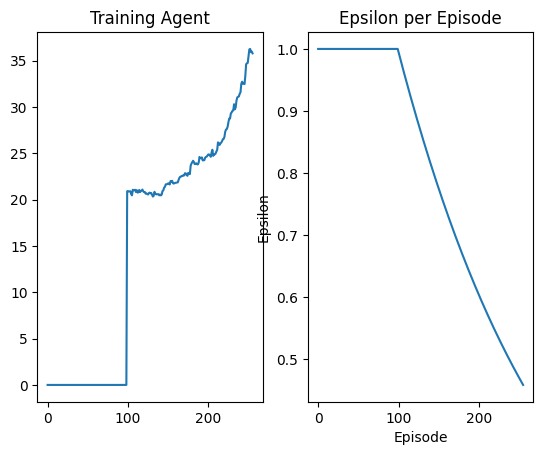

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 256 Duration 97 steps | epsilon 0.45573365187342935


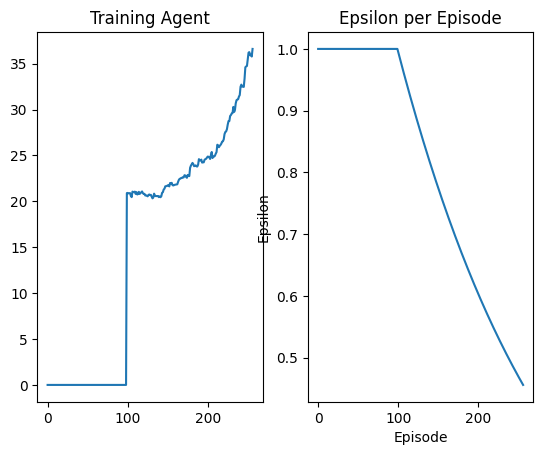

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 257 Duration 56 steps | epsilon 0.4534582251916596


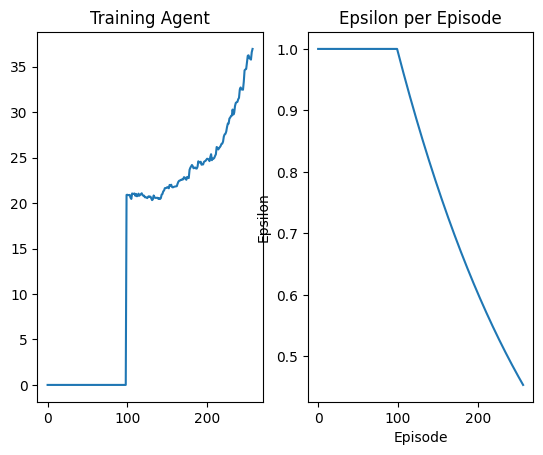

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 258 Duration 25 steps | epsilon 0.4511941594584677


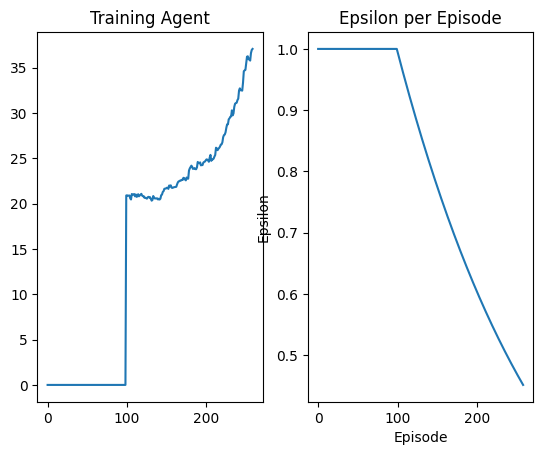

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 259 Duration 49 steps | epsilon 0.4489413979499197


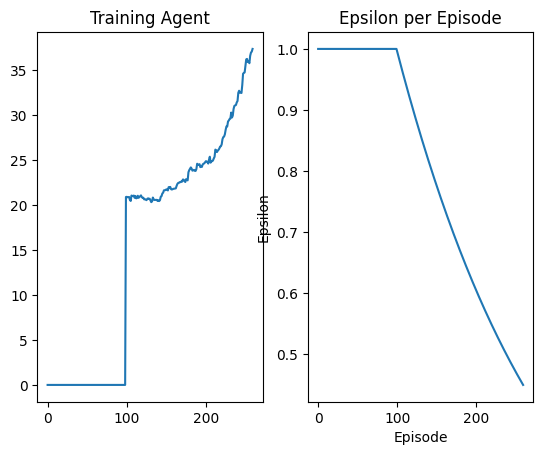

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 260 Duration 61 steps | epsilon 0.44669988422529805


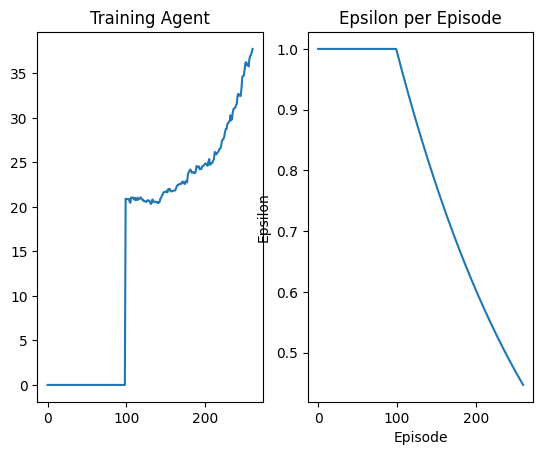

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 261 Duration 20 steps | epsilon 0.44446956212568717


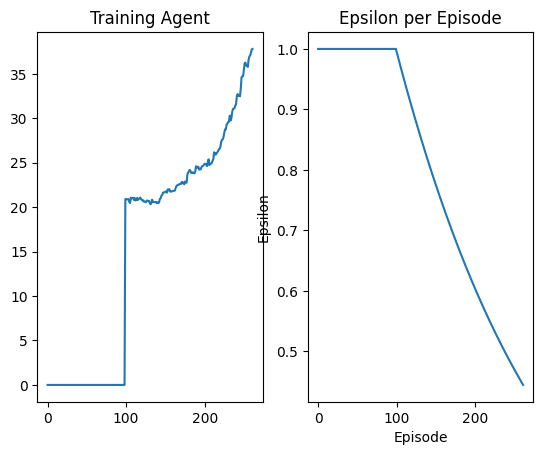

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 262 Duration 12 steps | epsilon 0.44225037577256665


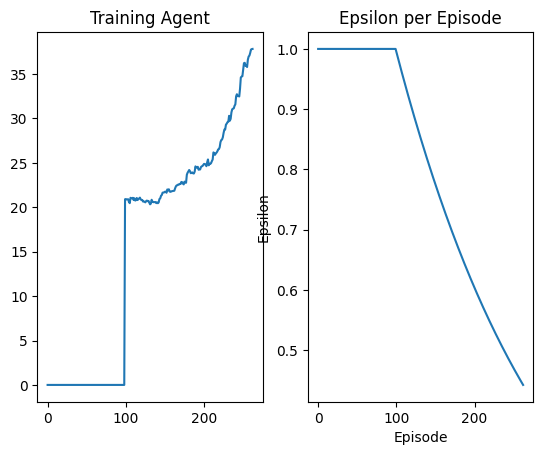

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 263 Duration 27 steps | epsilon 0.44004226956641124


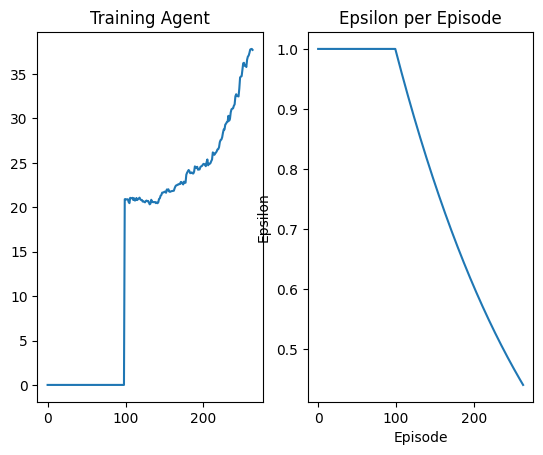

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 264 Duration 16 steps | epsilon 0.43784518818529783


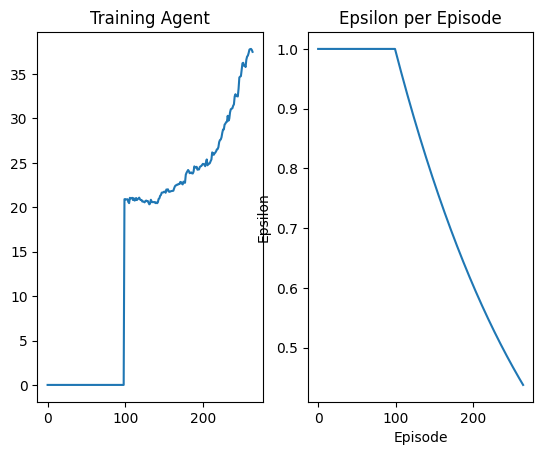

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 265 Duration 35 steps | epsilon 0.4356590765835195


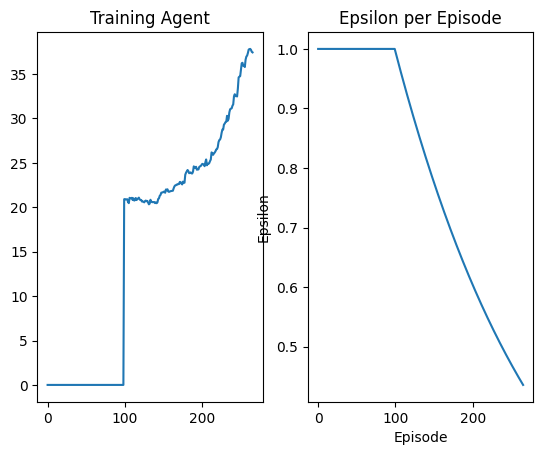

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 266 Duration 17 steps | epsilon 0.4334838799902062


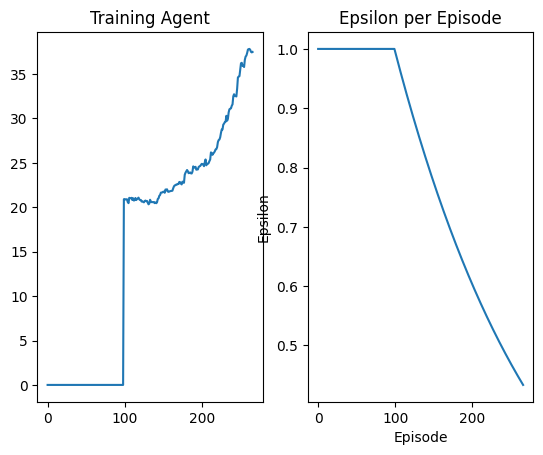

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 267 Duration 10 steps | epsilon 0.4313195439079528


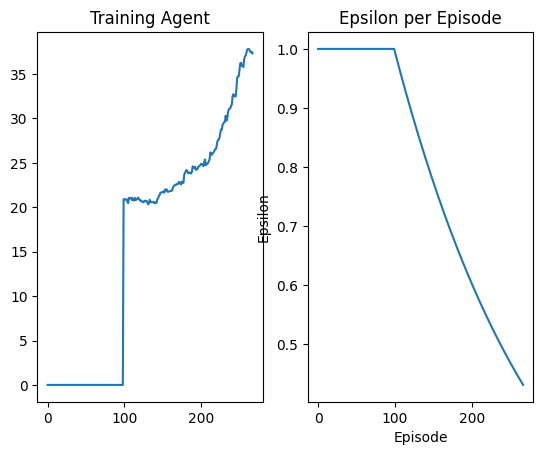

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 268 Duration 42 steps | epsilon 0.4291660141114534


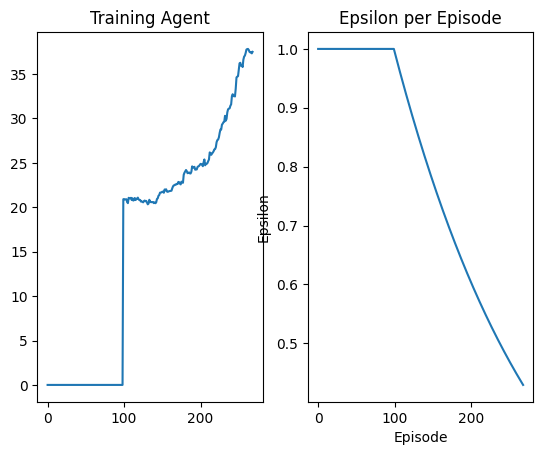

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 269 Duration 29 steps | epsilon 0.42702323664614306


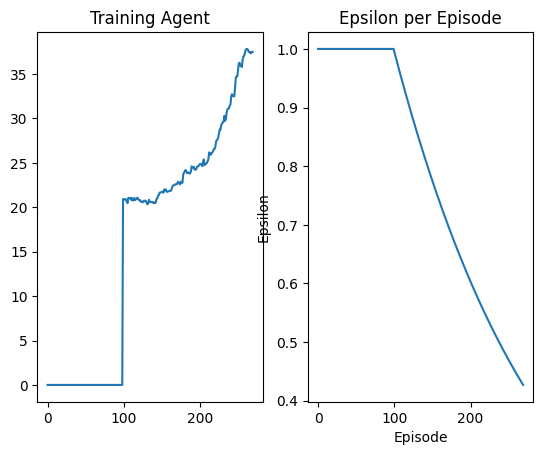

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 270 Duration 38 steps | epsilon 0.42489115782684583


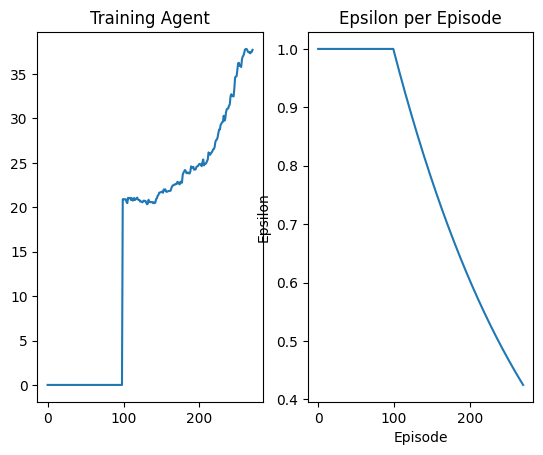

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 271 Duration 22 steps | epsilon 0.42276972423642983


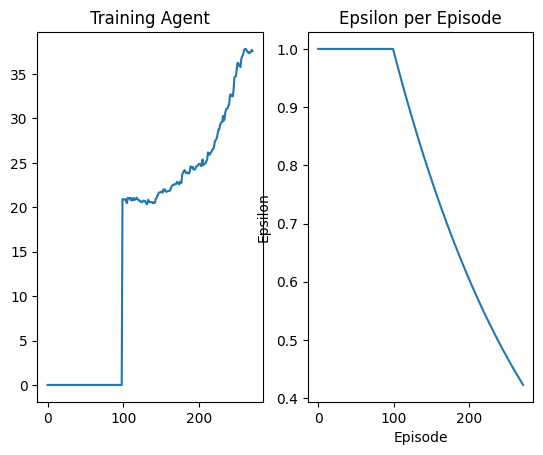

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 272 Duration 29 steps | epsilon 0.4206588827244689


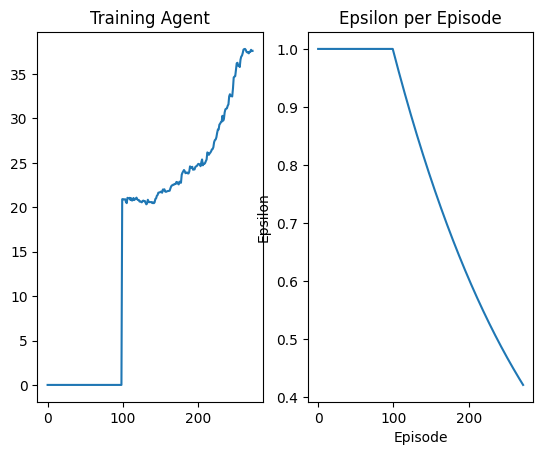

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 273 Duration 107 steps | epsilon 0.4185585804059108


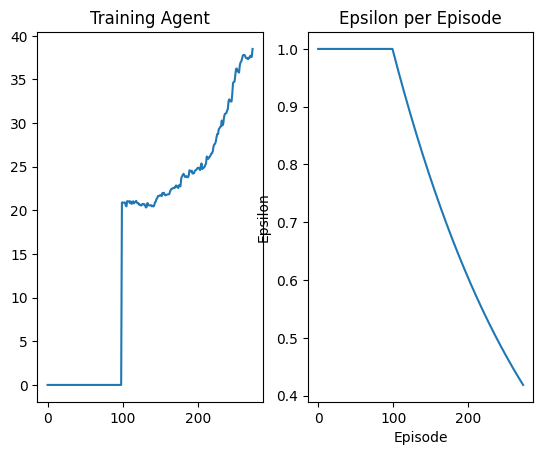

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 274 Duration 23 steps | epsilon 0.41646876465975263


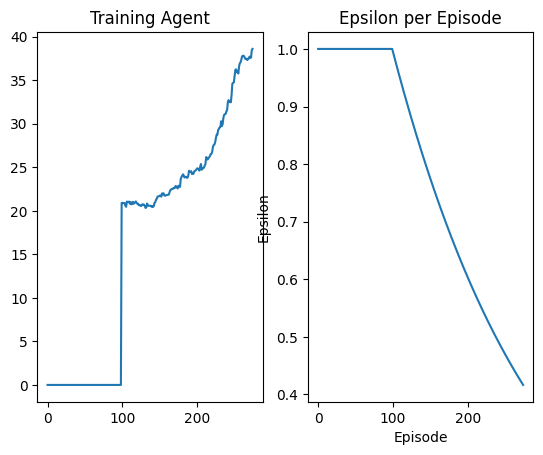

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 275 Duration 22 steps | epsilon 0.414389383127722


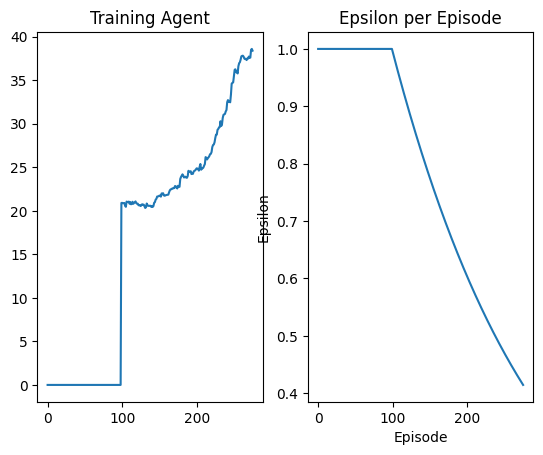

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 276 Duration 64 steps | epsilon 0.4123203837129656


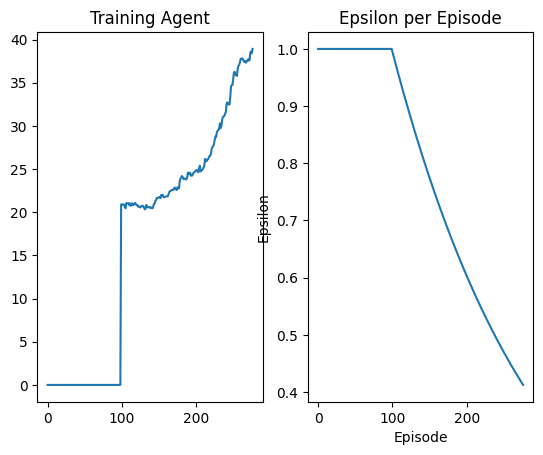

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 277 Duration 18 steps | epsilon 0.4102617145787438


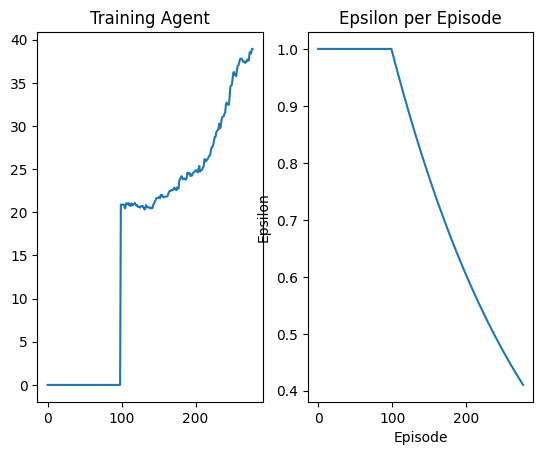

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 278 Duration 47 steps | epsilon 0.4082133241471319


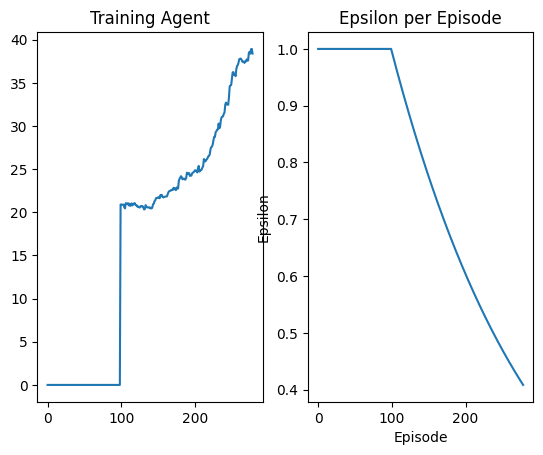

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 279 Duration 40 steps | epsilon 0.40617516109772805


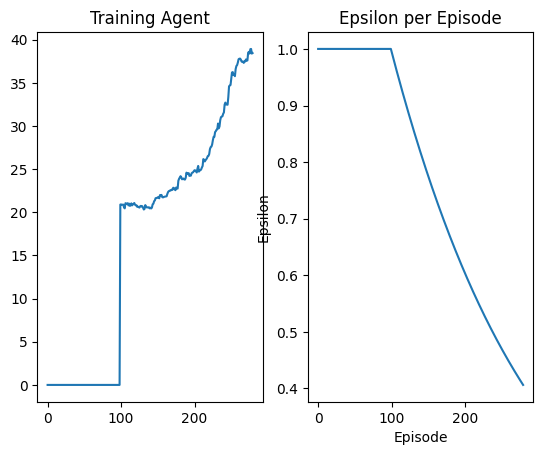

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 280 Duration 17 steps | epsilon 0.4041471743663673


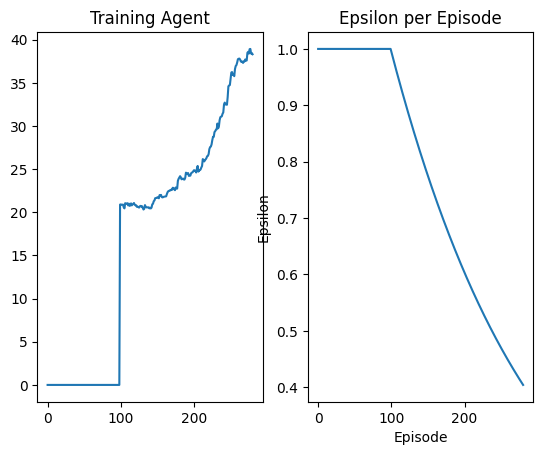

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 281 Duration 22 steps | epsilon 0.40212931314384237


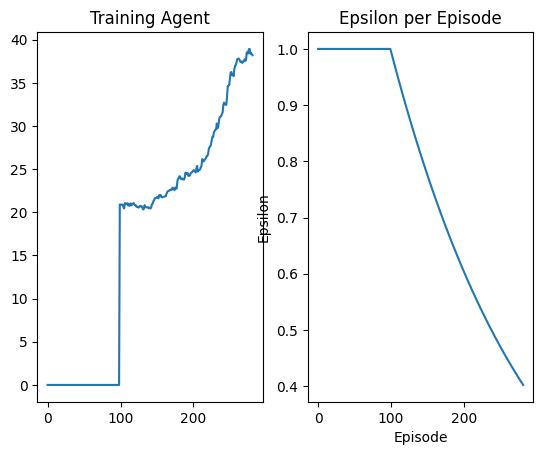

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 282 Duration 57 steps | epsilon 0.40012152687463054


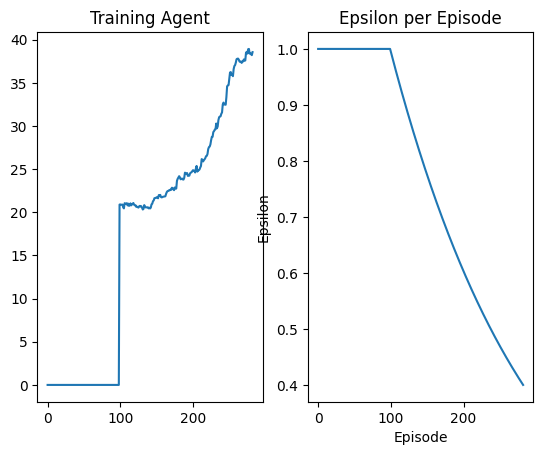

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 283 Duration 37 steps | epsilon 0.39812376525562715


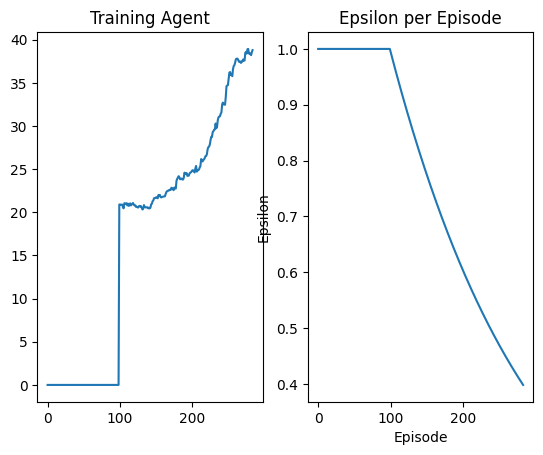

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 284 Duration 39 steps | epsilon 0.39613597823488533


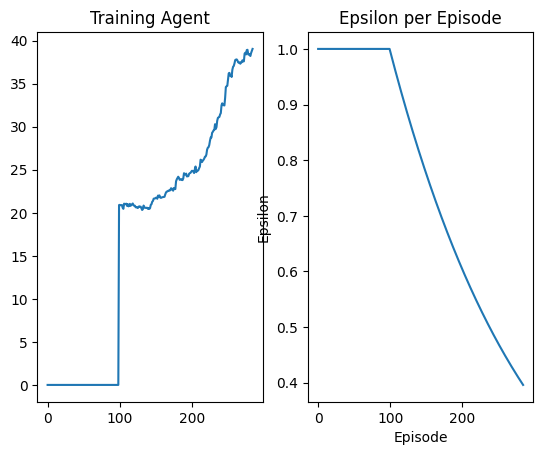

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 285 Duration 40 steps | epsilon 0.3941581160103618


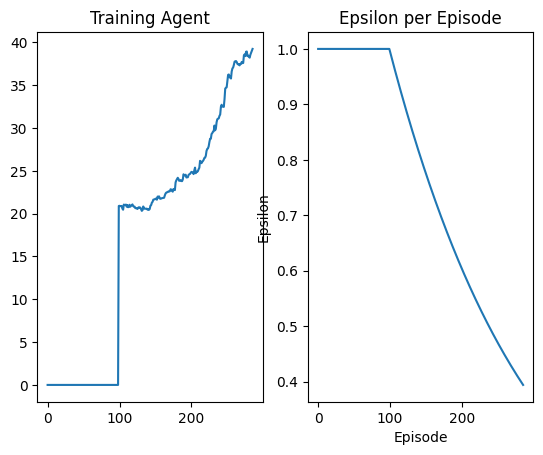

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 286 Duration 19 steps | epsilon 0.3921901290286694


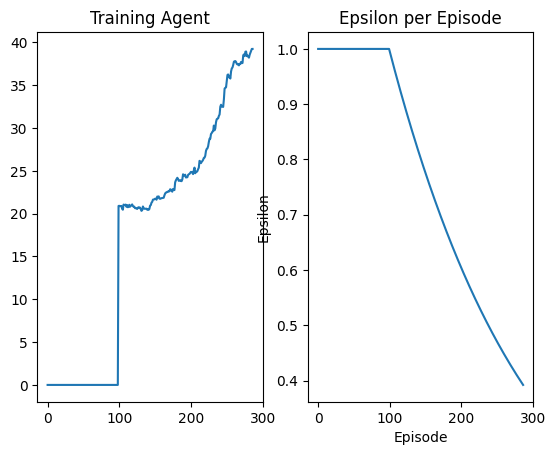

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 287 Duration 31 steps | epsilon 0.39023196798383525


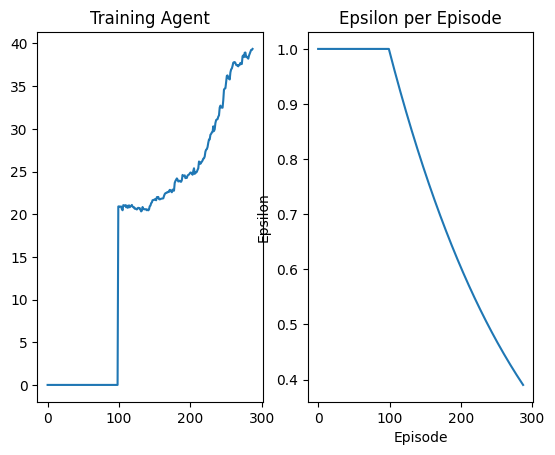

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 288 Duration 16 steps | epsilon 0.3882835838160658


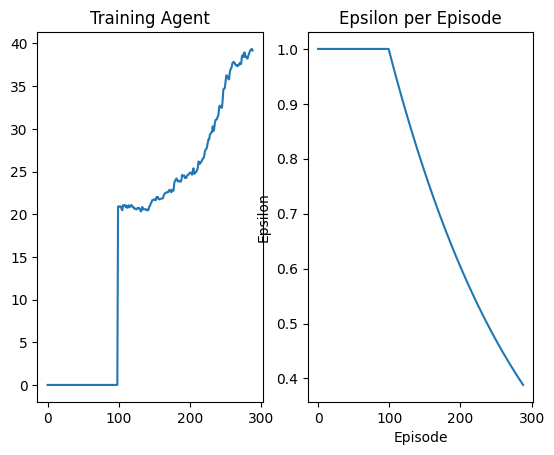

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 289 Duration 14 steps | epsilon 0.3863449277105175


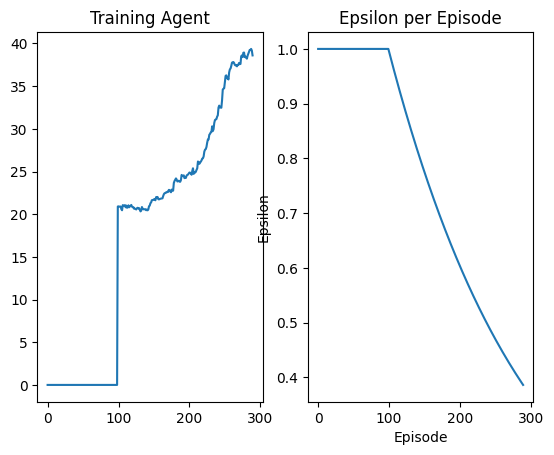

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 290 Duration 49 steps | epsilon 0.3844159510960737


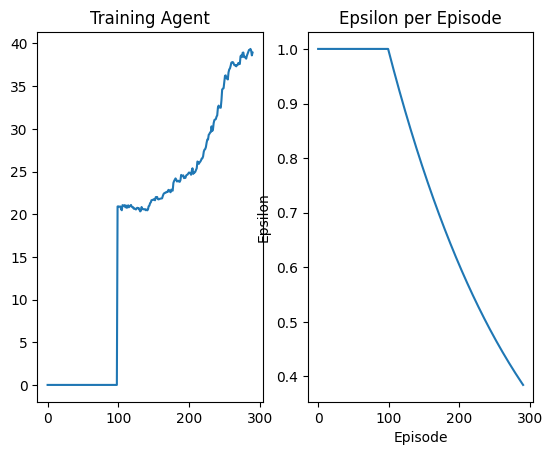

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 291 Duration 19 steps | epsilon 0.3824966056441279


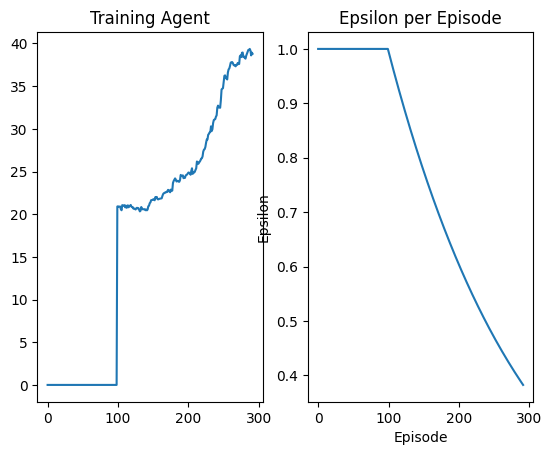

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 292 Duration 38 steps | epsilon 0.38058684326737297


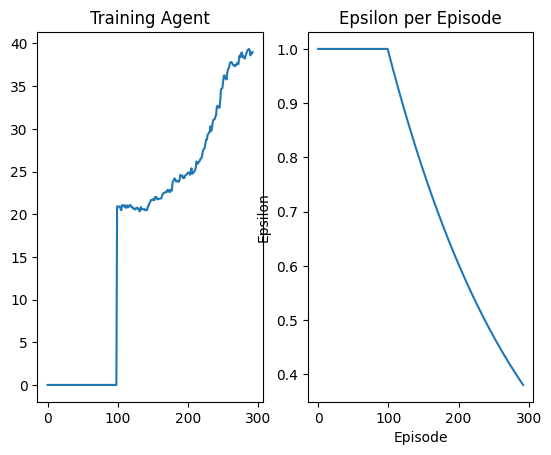

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 293 Duration 29 steps | epsilon 0.37868661611859616


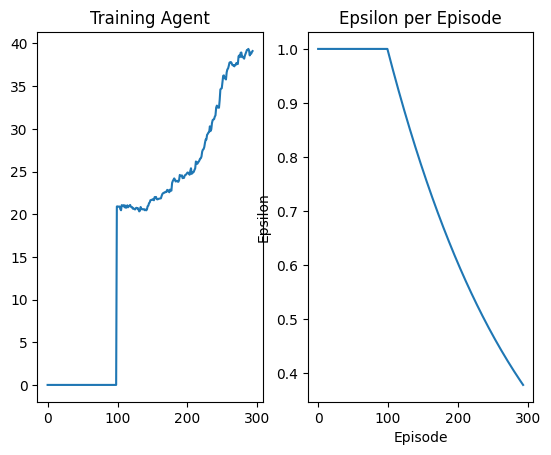

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 294 Duration 26 steps | epsilon 0.37679587658948044


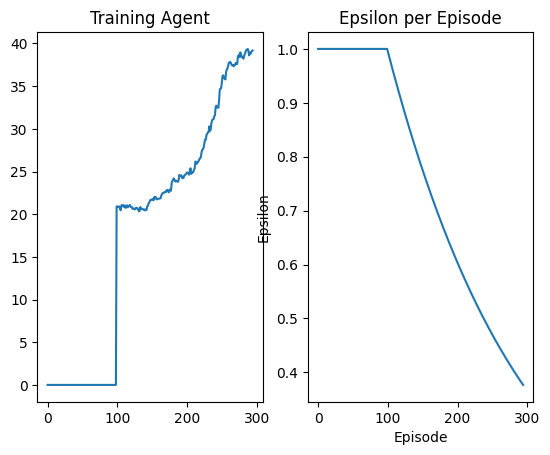

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 295 Duration 62 steps | epsilon 0.37491457730941186


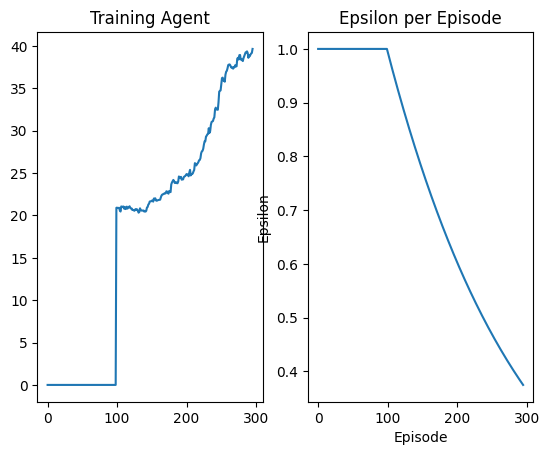

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 296 Duration 14 steps | epsilon 0.37304267114429246


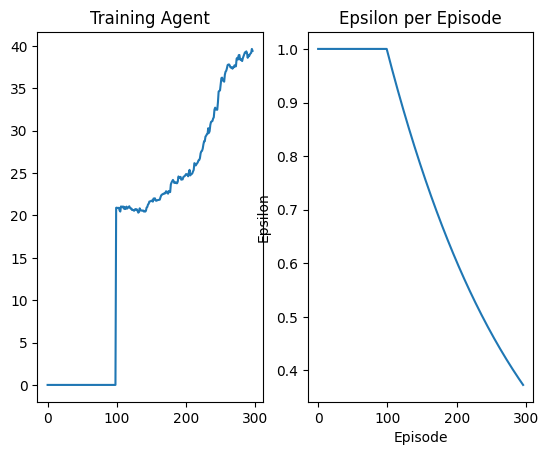

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 297 Duration 63 steps | epsilon 0.37118011119535954


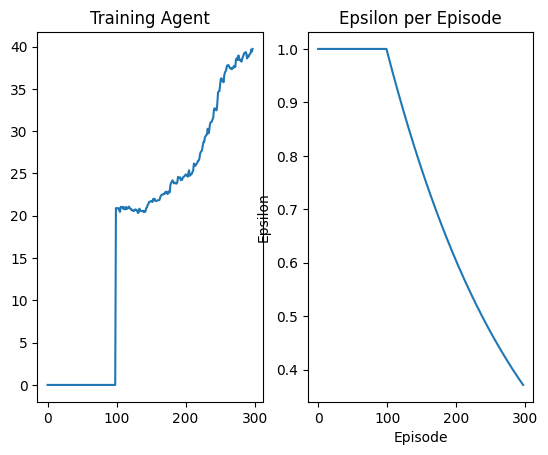

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 298 Duration 99 steps | epsilon 0.36932685079801075


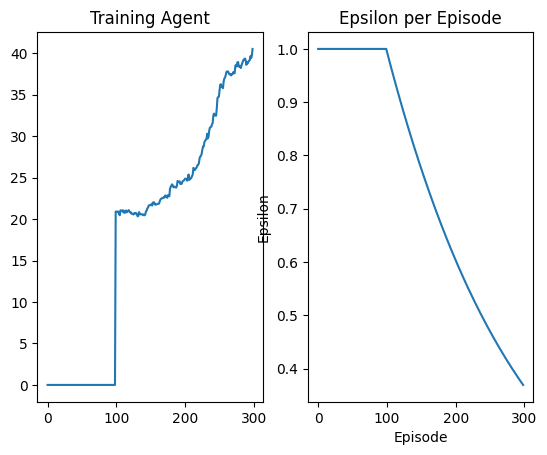

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 299 Duration 17 steps | epsilon 0.36748284352063465


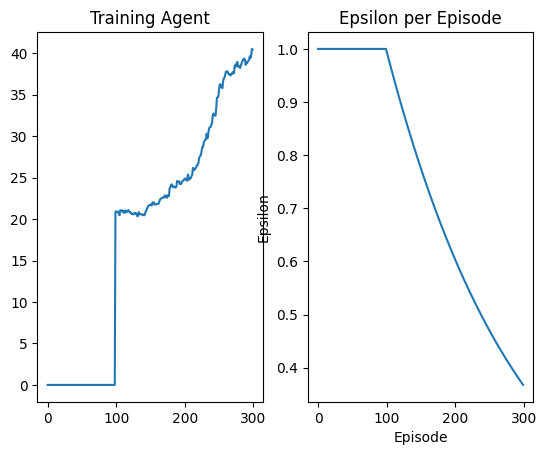

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 300 Duration 24 steps | epsilon 0.36564804316344773


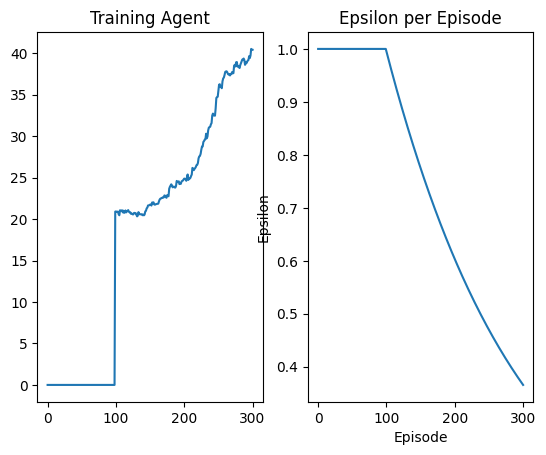

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 301 Duration 12 steps | epsilon 0.36382240375733677


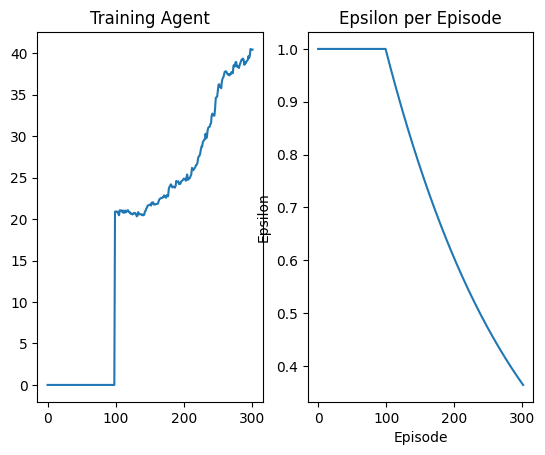

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 302 Duration 11 steps | epsilon 0.362005879562707


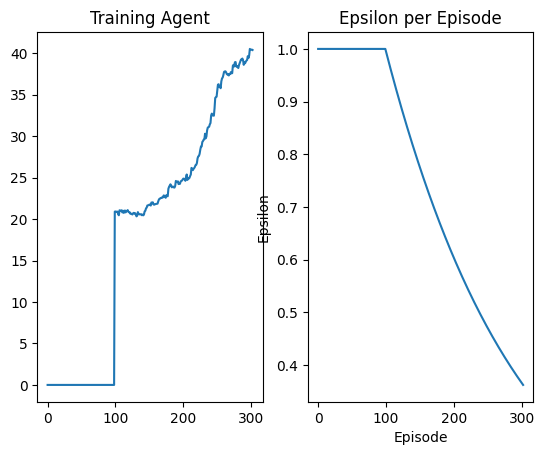

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 303 Duration 112 steps | epsilon 0.36019842506833655


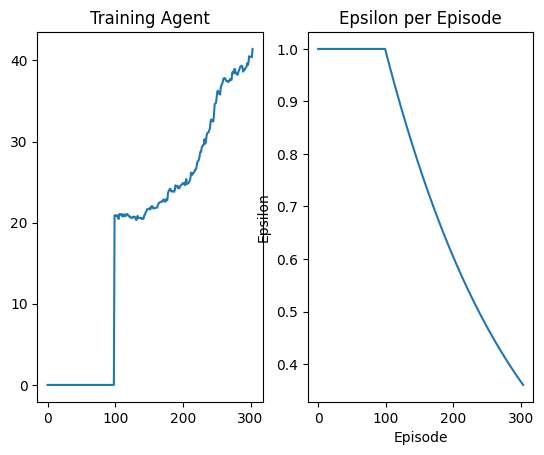

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 304 Duration 11 steps | epsilon 0.35839999499023567


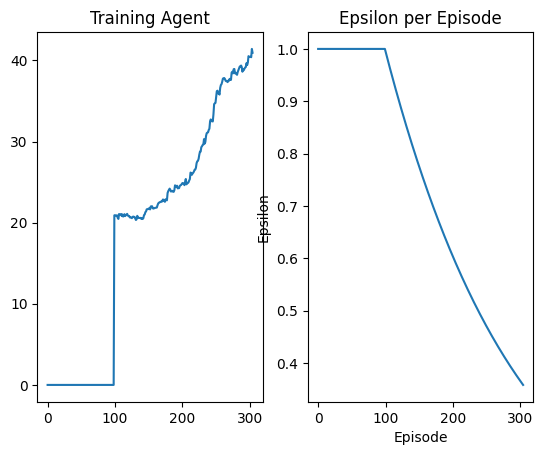

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 305 Duration 48 steps | epsilon 0.35661054427051264


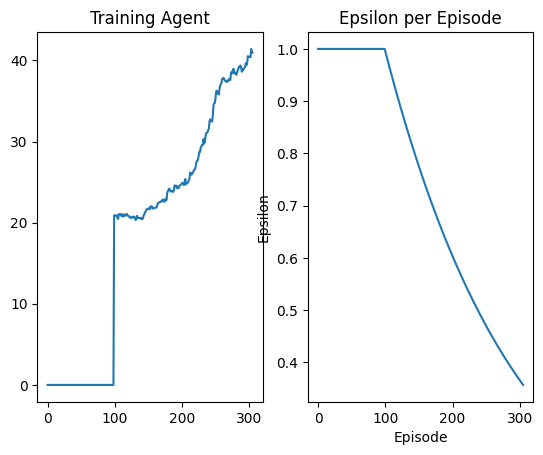

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 306 Duration 24 steps | epsilon 0.3548300280762446


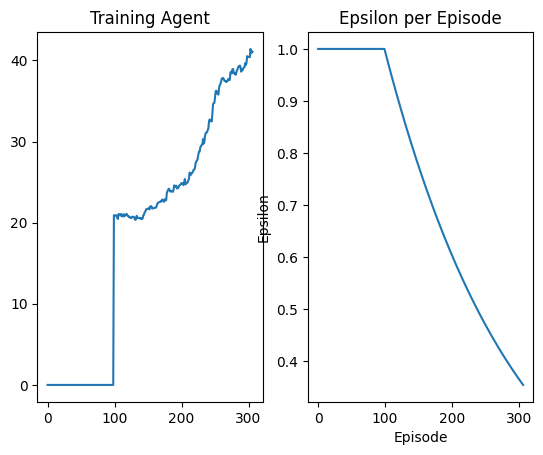

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 307 Duration 16 steps | epsilon 0.35305840179835446


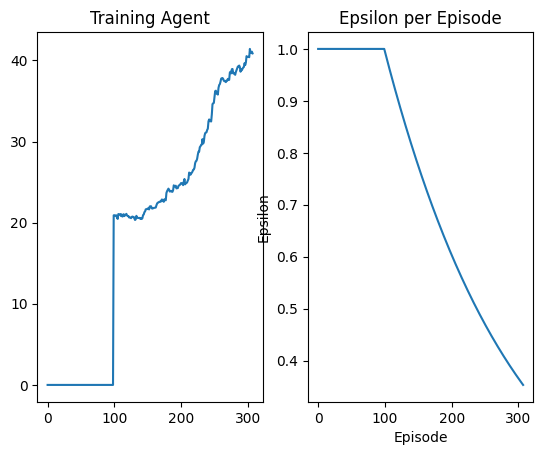

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 308 Duration 67 steps | epsilon 0.3512956210504933


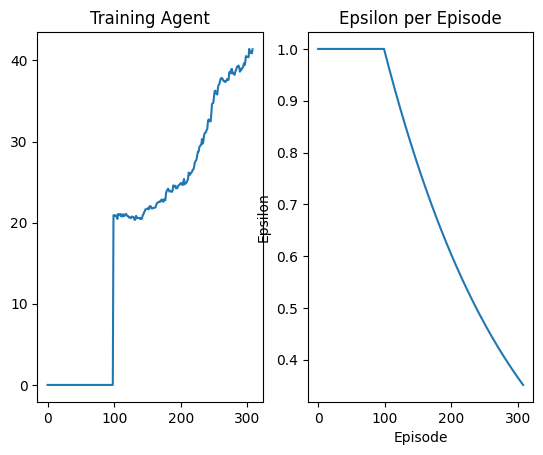

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 309 Duration 105 steps | epsilon 0.34954164166792806


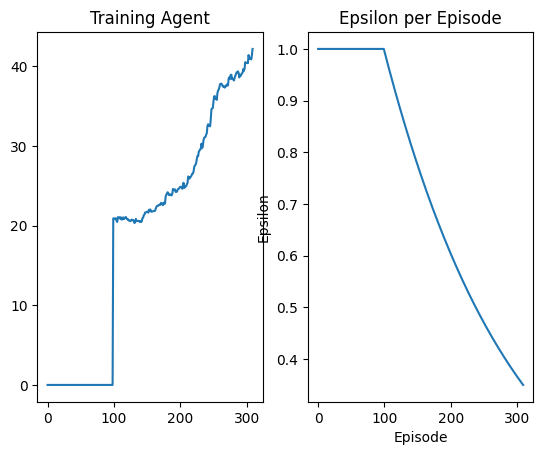

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 310 Duration 26 steps | epsilon 0.3477964197064353


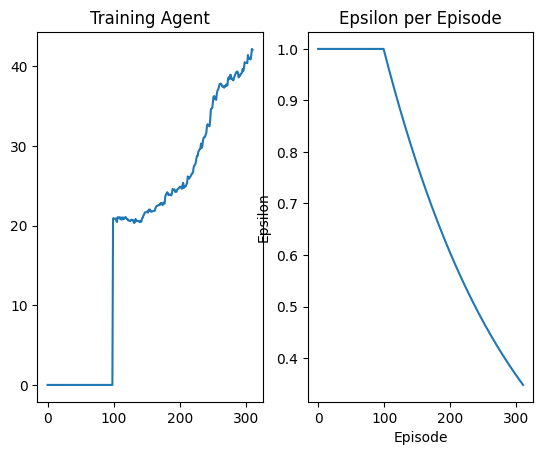

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 311 Duration 23 steps | epsilon 0.3460599114412002


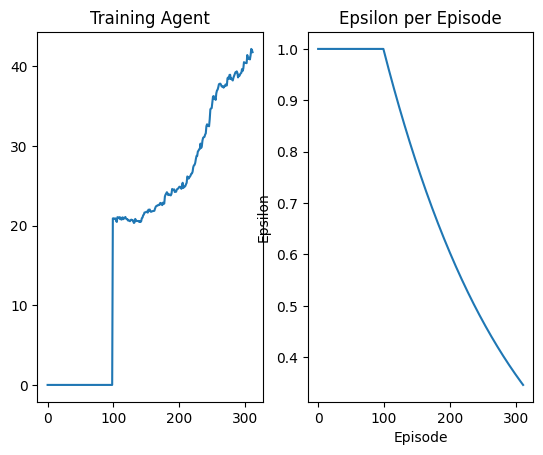

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 312 Duration 24 steps | epsilon 0.3443320733657208


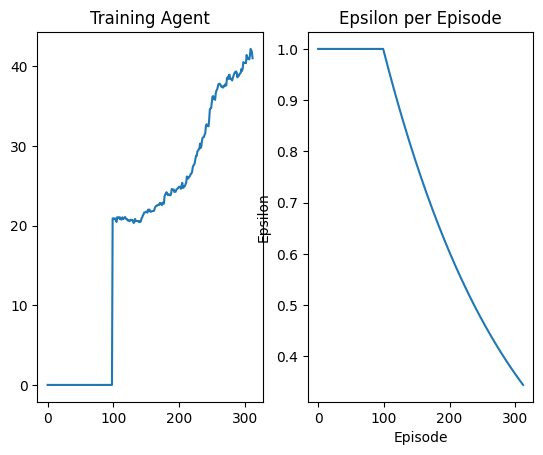

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 313 Duration 52 steps | epsilon 0.3426128621907184


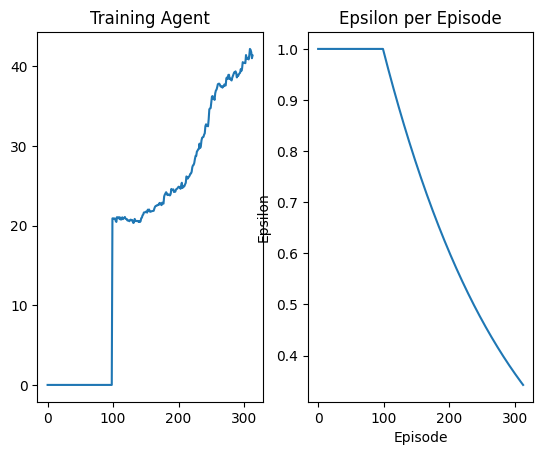

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 314 Duration 40 steps | epsilon 0.3409022348430527


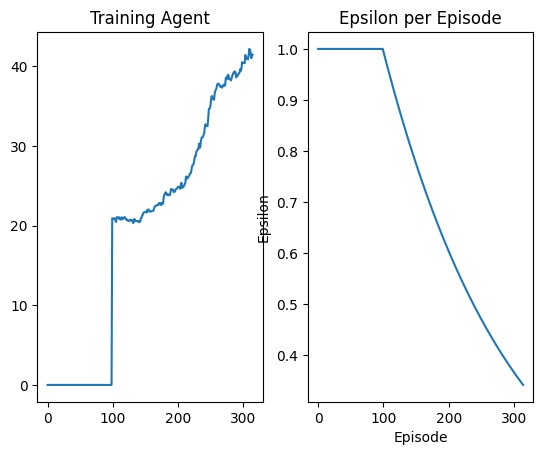

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 315 Duration 69 steps | epsilon 0.3392001484646427


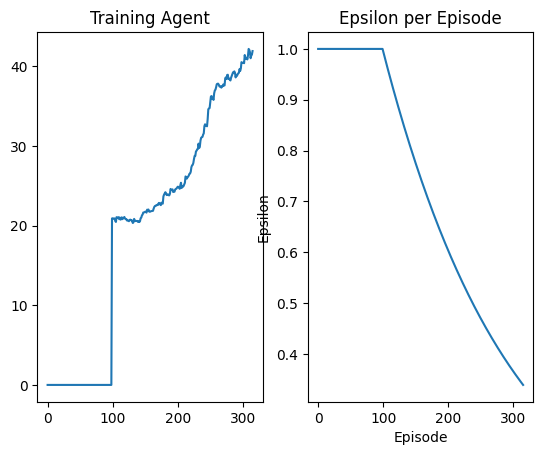

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 316 Duration 52 steps | epsilon 0.337506560411393


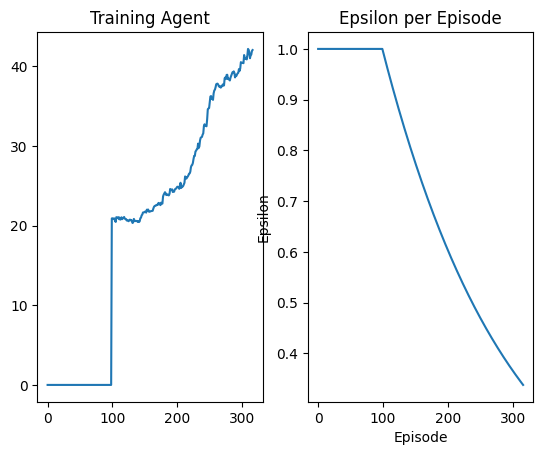

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 317 Duration 42 steps | epsilon 0.3358214282521253


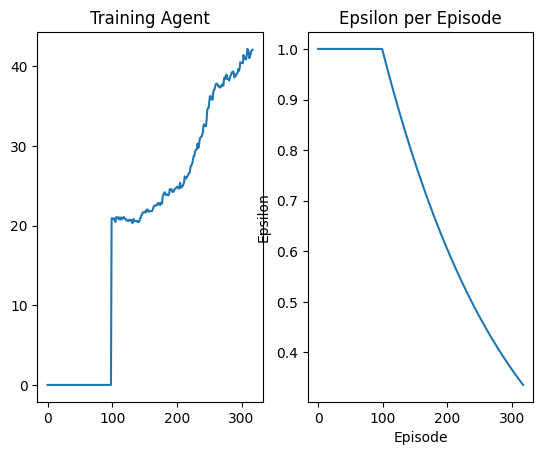

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 318 Duration 54 steps | epsilon 0.3341447097675155


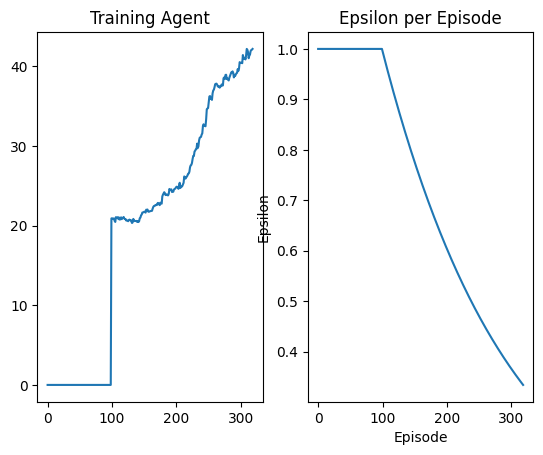

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 319 Duration 80 steps | epsilon 0.3324763629490357


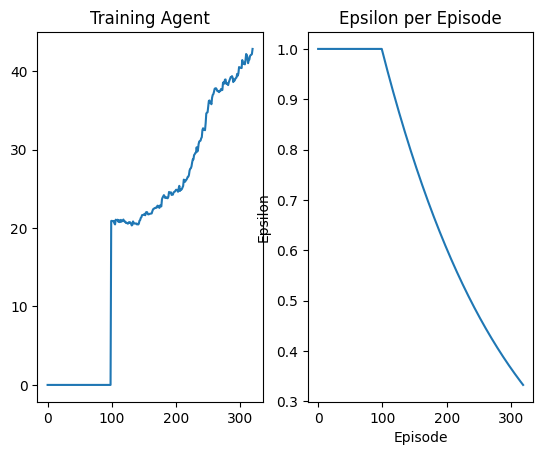

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 320 Duration 28 steps | epsilon 0.33081634599790194


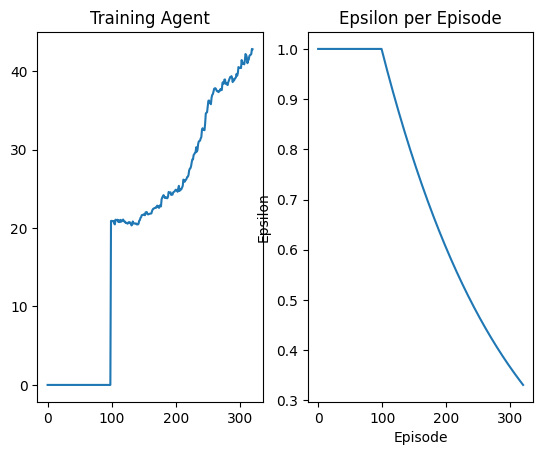

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 321 Duration 13 steps | epsilon 0.32916461732402674


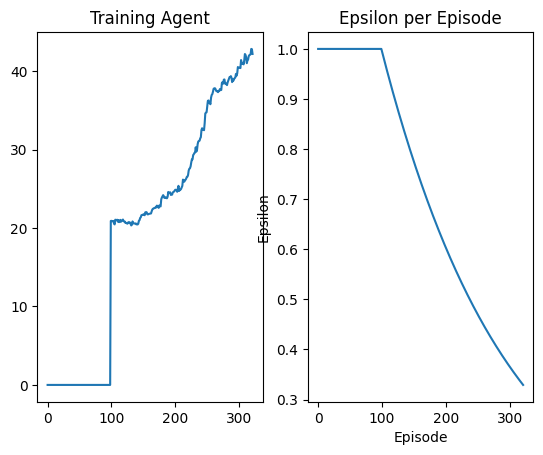

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 322 Duration 70 steps | epsilon 0.32752113554497736


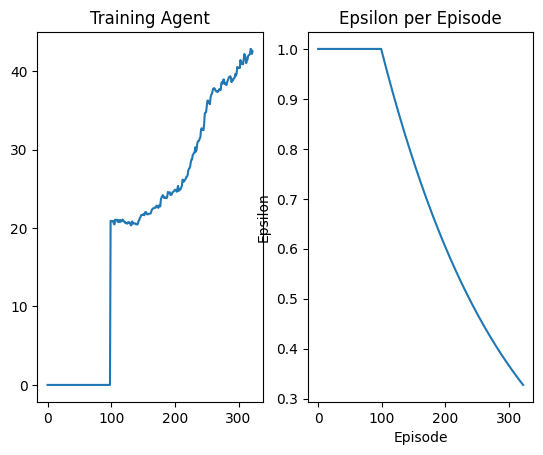

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 323 Duration 39 steps | epsilon 0.3258858594849388


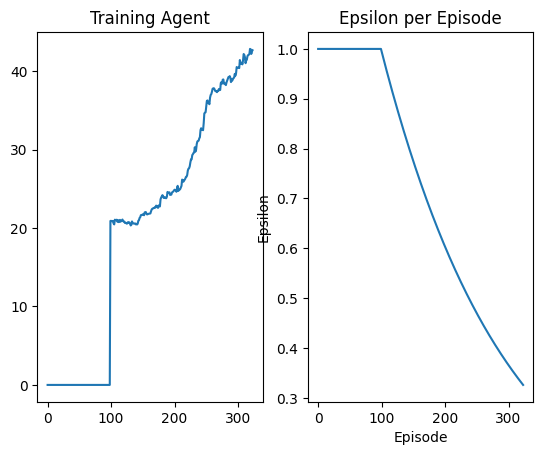

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 324 Duration 101 steps | epsilon 0.32425874817368233


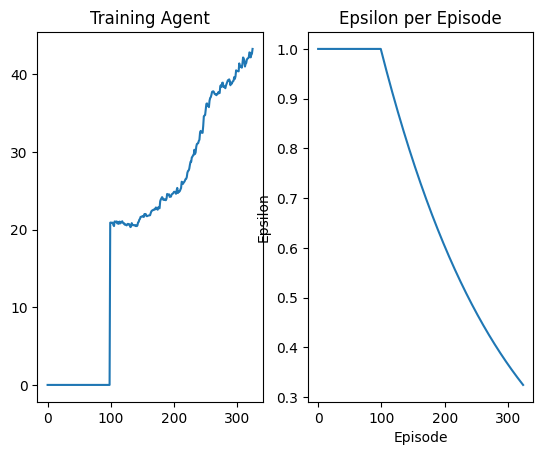

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 325 Duration 76 steps | epsilon 0.3226397608455388


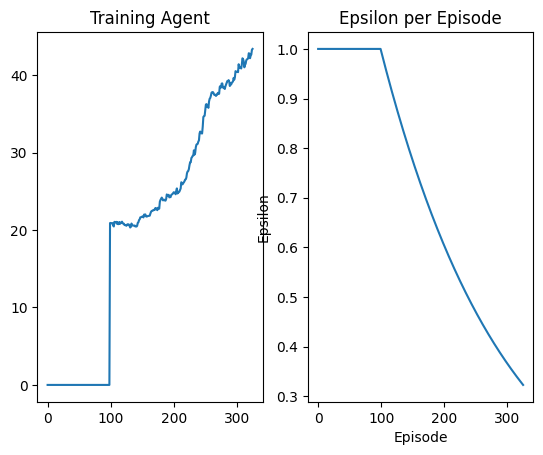

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 326 Duration 50 steps | epsilon 0.3210288569383776


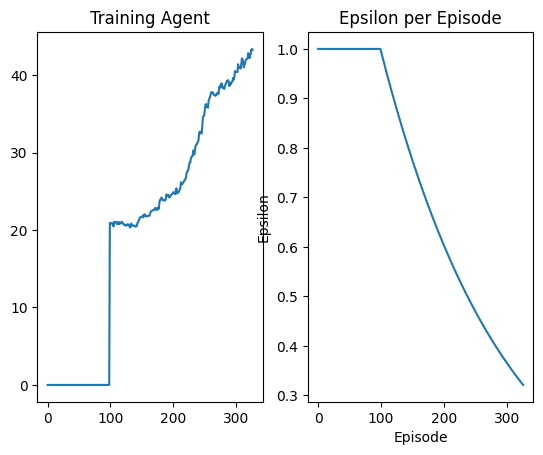

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 327 Duration 36 steps | epsilon 0.31942599609259026


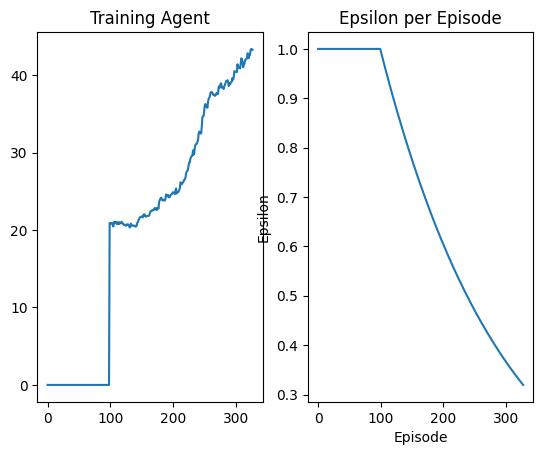

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 328 Duration 62 steps | epsilon 0.3178311381500791


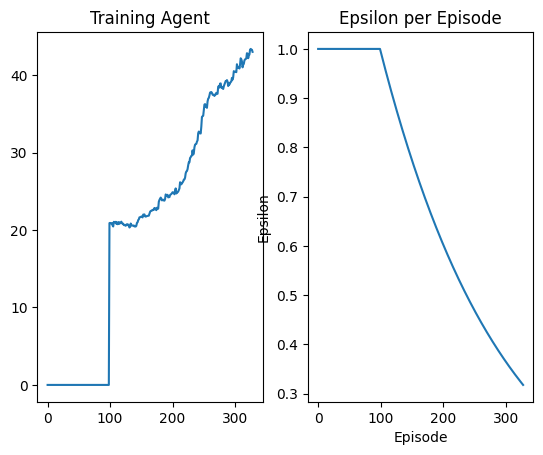

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 329 Duration 17 steps | epsilon 0.31624424315325145


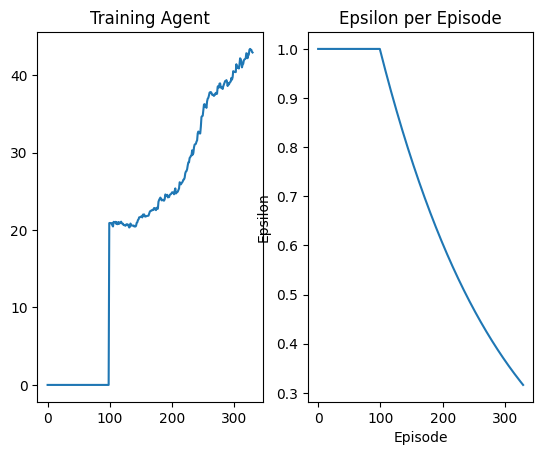

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 330 Duration 61 steps | epsilon 0.3146652713440184


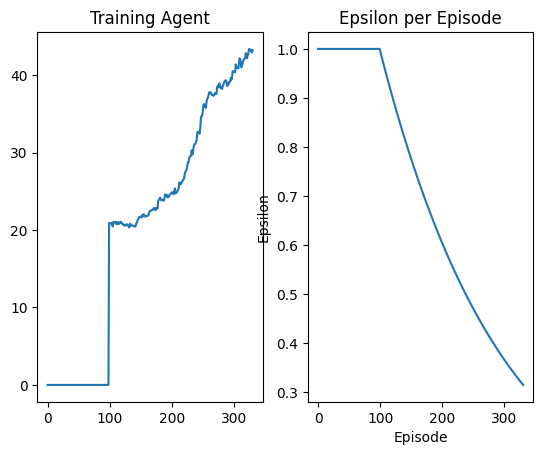

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 331 Duration 12 steps | epsilon 0.3130941831627986


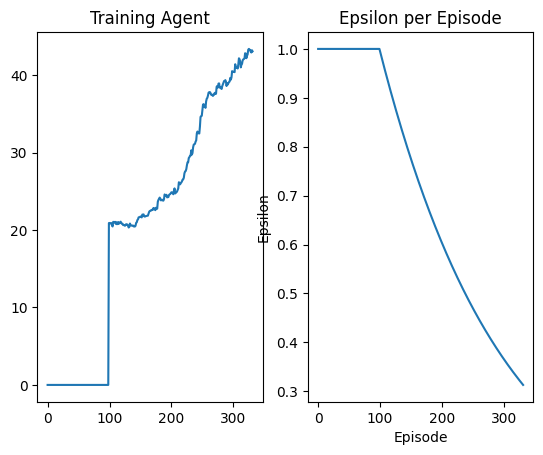

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 332 Duration 82 steps | epsilon 0.3115309392475272


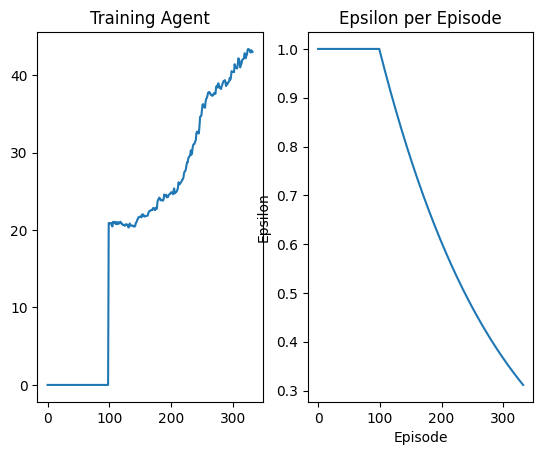

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 333 Duration 17 steps | epsilon 0.3099755004326699


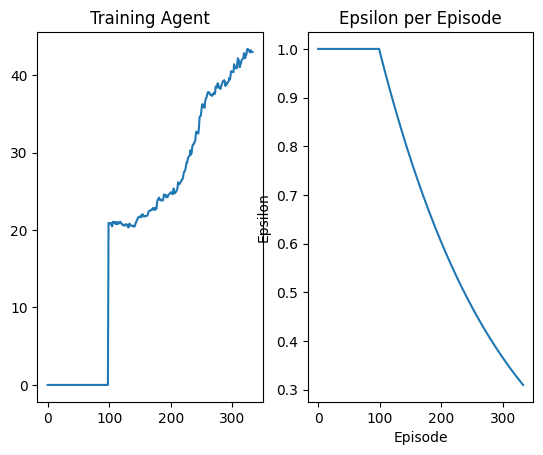

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 334 Duration 37 steps | epsilon 0.3084278277482413


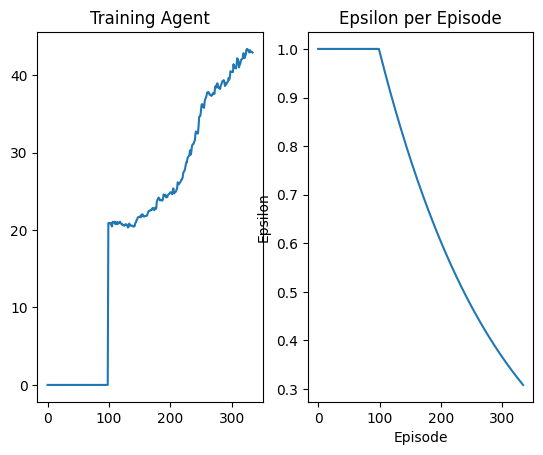

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 335 Duration 71 steps | epsilon 0.3068878824188287


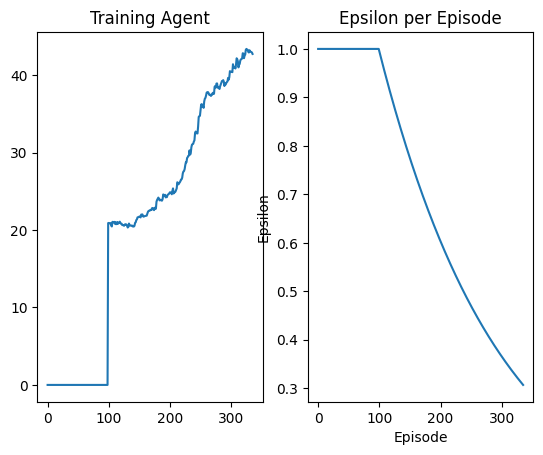

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 336 Duration 25 steps | epsilon 0.3053556258626208


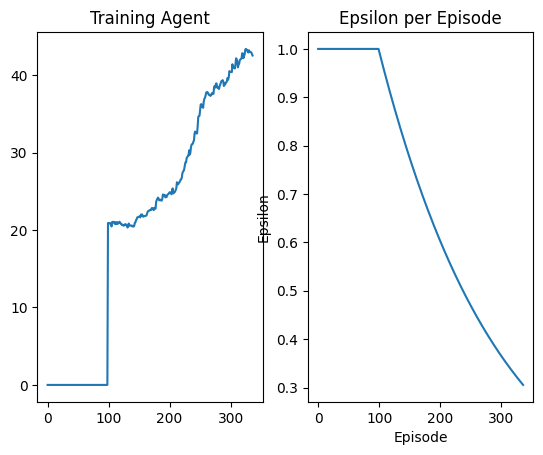

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 337 Duration 27 steps | epsilon 0.30383101969044096


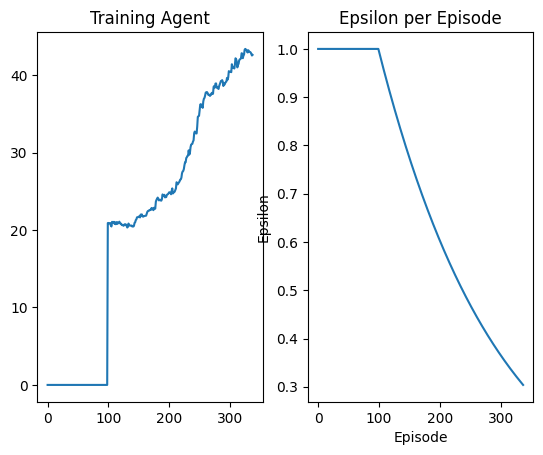

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 338 Duration 57 steps | epsilon 0.3023140257047852


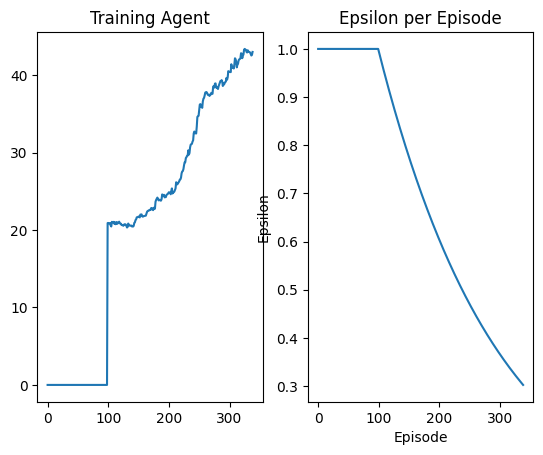

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 339 Duration 31 steps | epsilon 0.3008046058988655


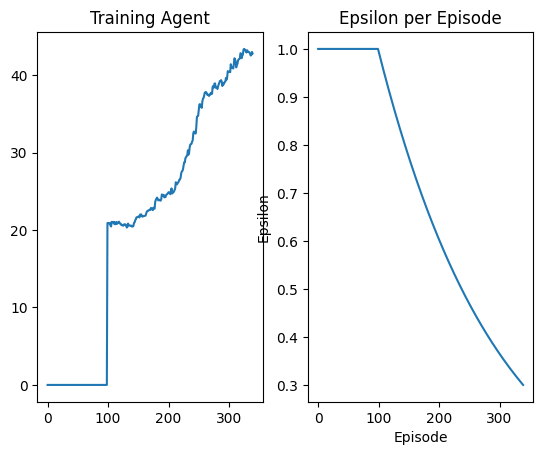

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 340 Duration 13 steps | epsilon 0.2993027224556573


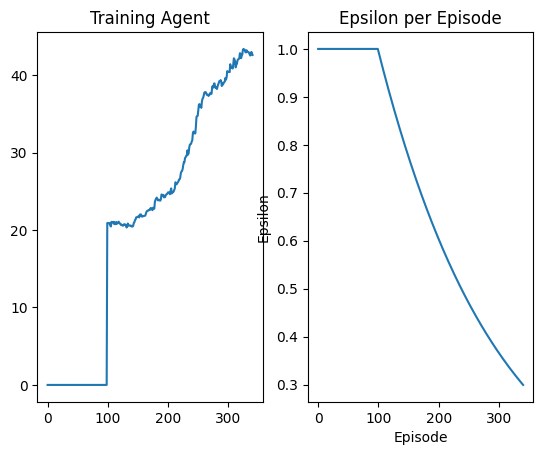

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 341 Duration 17 steps | epsilon 0.29780833774695237


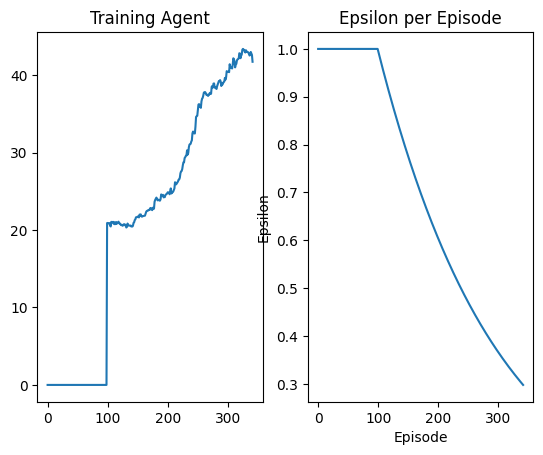

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 342 Duration 16 steps | epsilon 0.2963214143324157


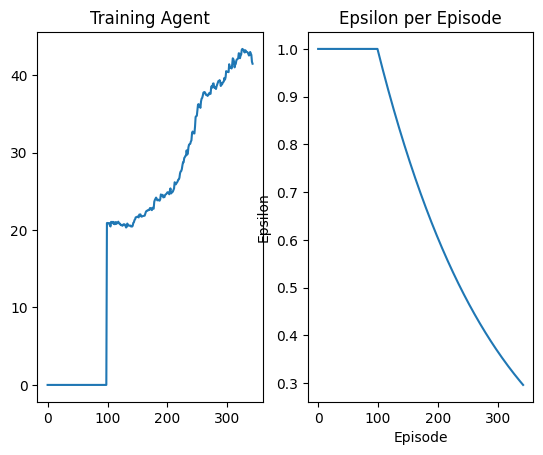

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 343 Duration 15 steps | epsilon 0.29484191495864776


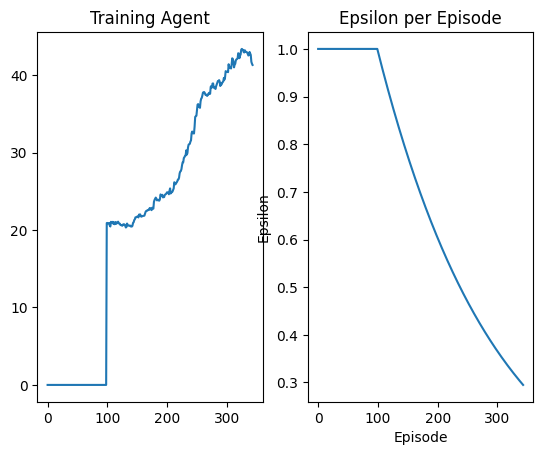

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 344 Duration 32 steps | epsilon 0.29336980255825096


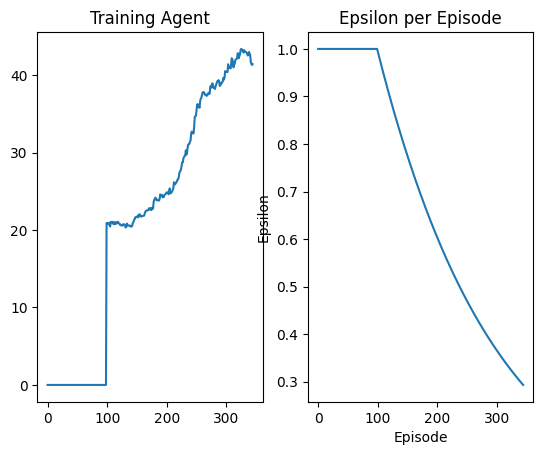

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 345 Duration 14 steps | epsilon 0.2919050402489011


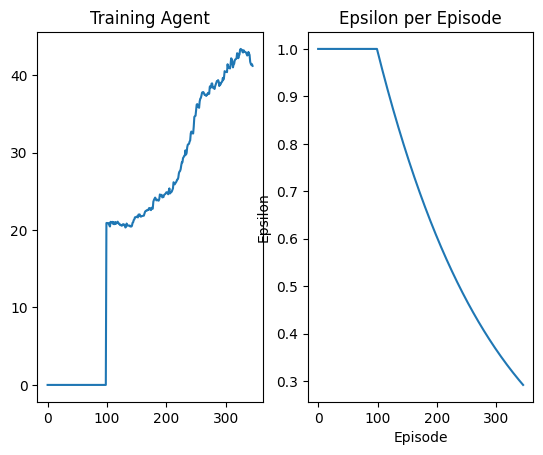

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 346 Duration 31 steps | epsilon 0.2904475913324233


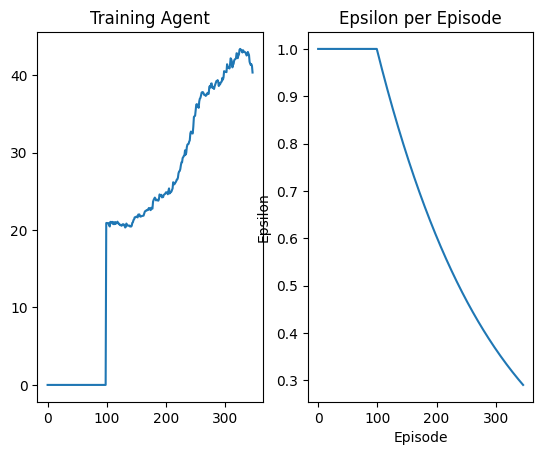

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 347 Duration 32 steps | epsilon 0.2889974192938724


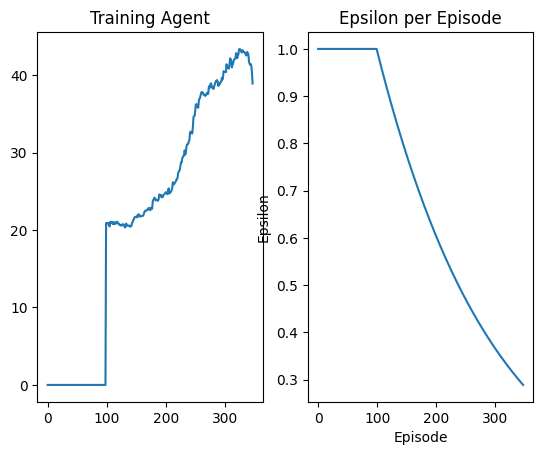

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 348 Duration 24 steps | epsilon 0.2875544878006183


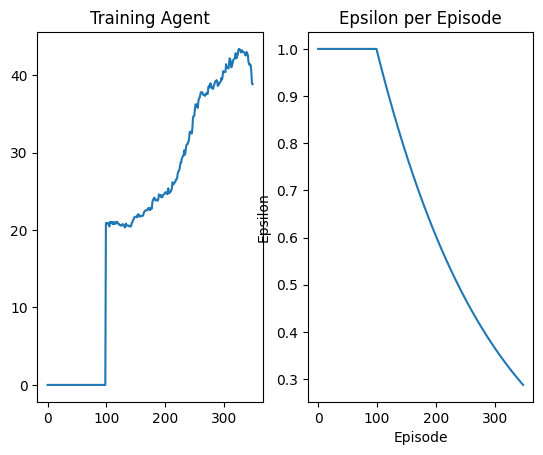

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 349 Duration 13 steps | epsilon 0.28611876070143566


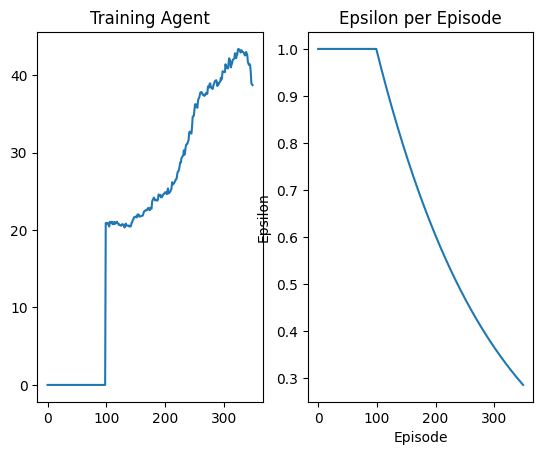

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 350 Duration 33 steps | epsilon 0.2846902020255981


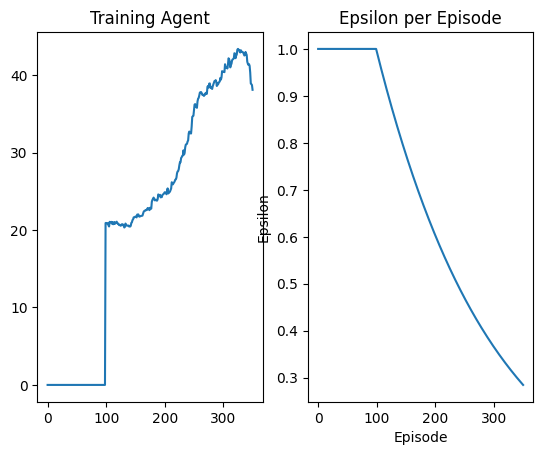

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 351 Duration 37 steps | epsilon 0.283268775981977


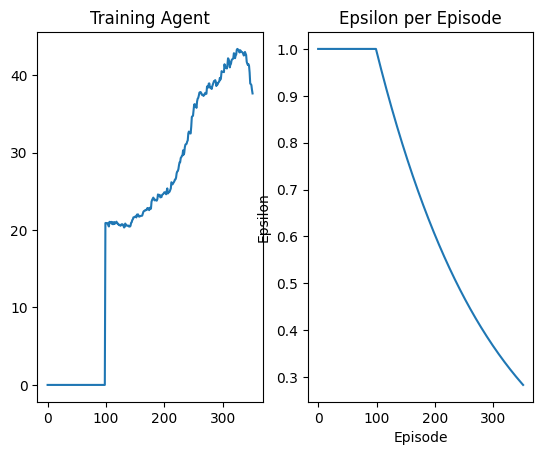

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 352 Duration 147 steps | epsilon 0.28185444695814477


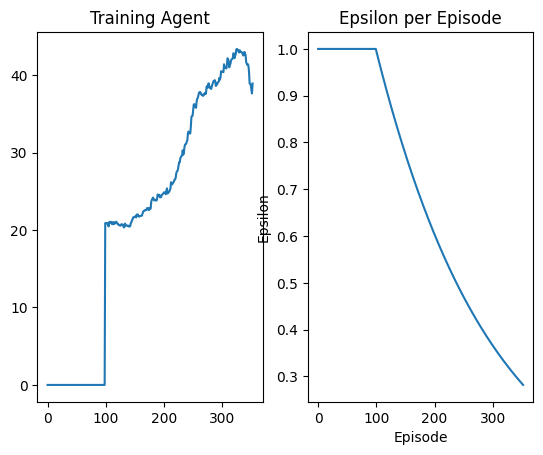

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 353 Duration 16 steps | epsilon 0.2804471795194827


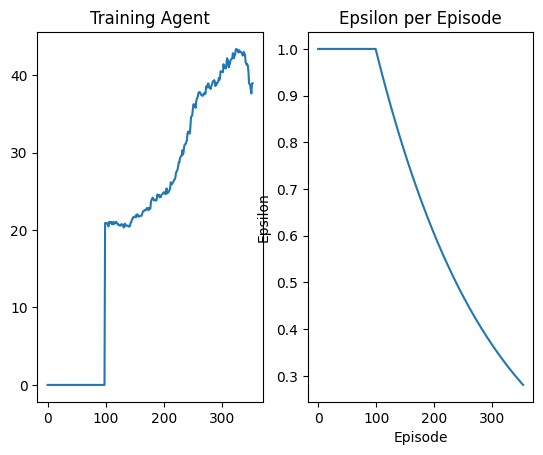

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 354 Duration 53 steps | epsilon 0.27904693840829325


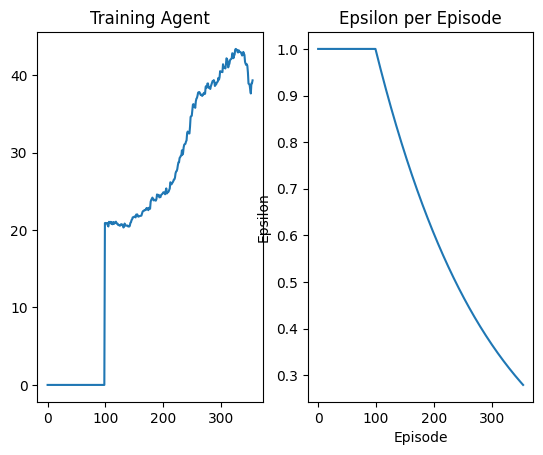

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 355 Duration 34 steps | epsilon 0.27765368854291633


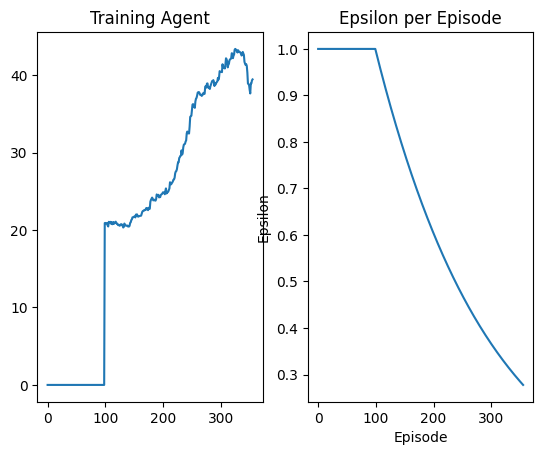

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 356 Duration 33 steps | epsilon 0.2762673950168508


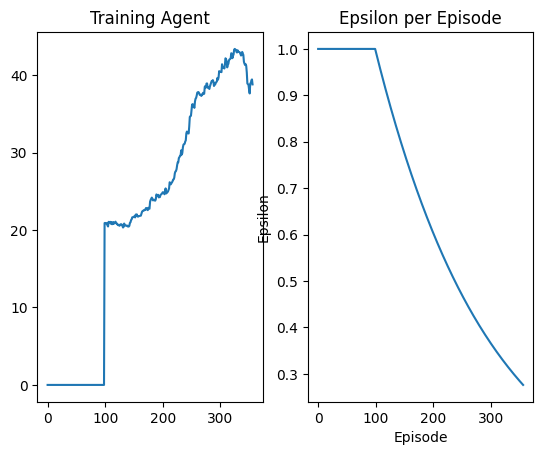

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 357 Duration 21 steps | epsilon 0.27488802309787974


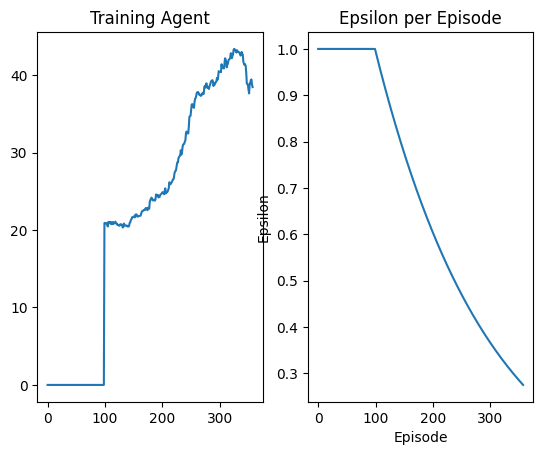

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 358 Duration 16 steps | epsilon 0.27351553822720015


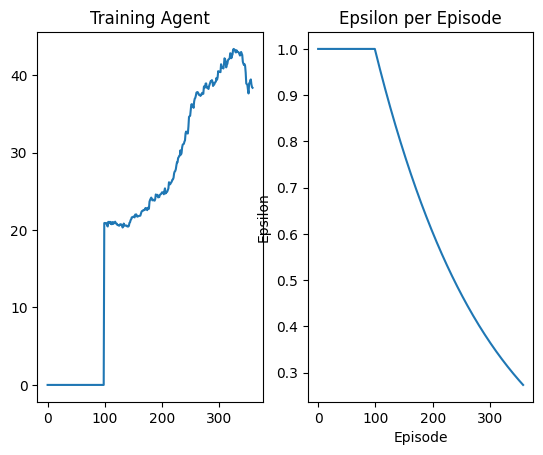

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 359 Duration 18 steps | epsilon 0.2721499060185573


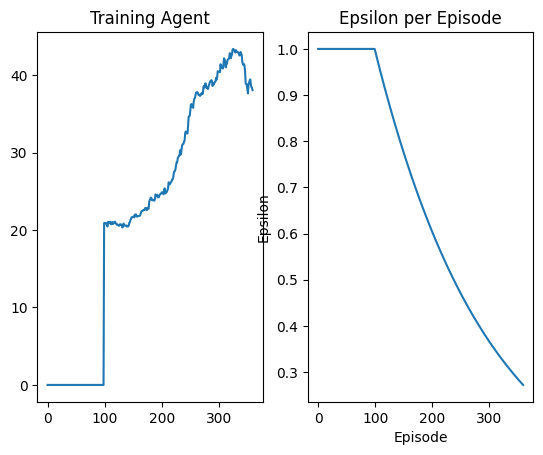

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 360 Duration 43 steps | epsilon 0.2707910922573832


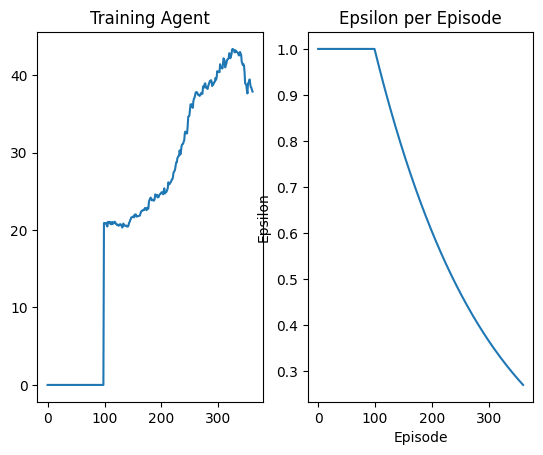

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 361 Duration 34 steps | epsilon 0.26943906289993924


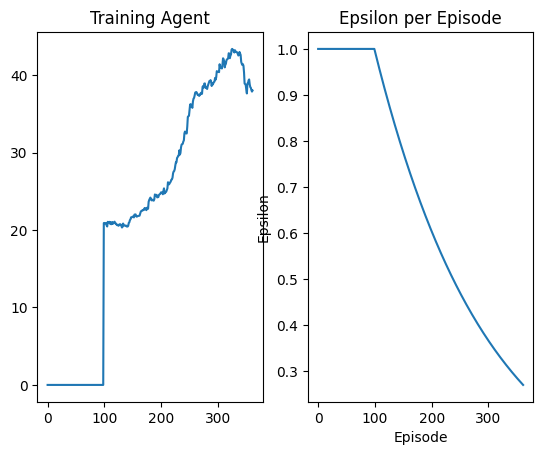

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 362 Duration 21 steps | epsilon 0.2680937840724634


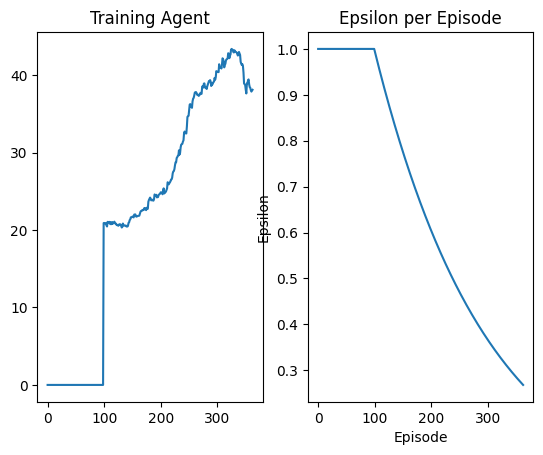

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 363 Duration 32 steps | epsilon 0.2667552220703216


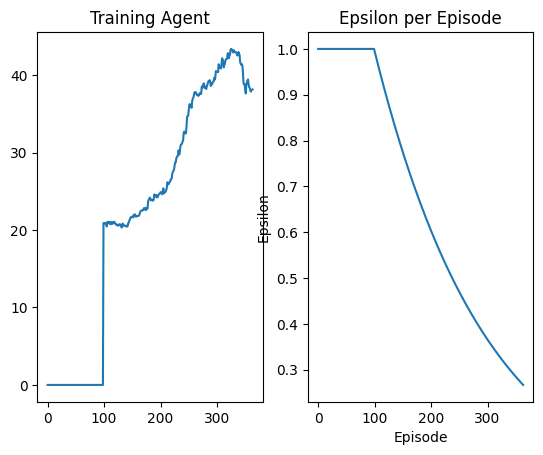

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 364 Duration 79 steps | epsilon 0.26542334335716306


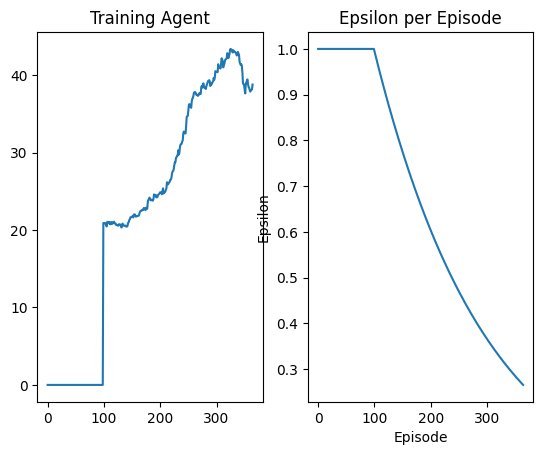

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 365 Duration 12 steps | epsilon 0.26409811456408033


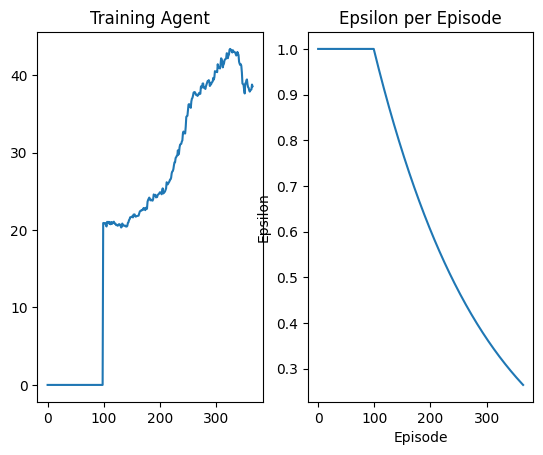

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 366 Duration 41 steps | epsilon 0.2627795024887731


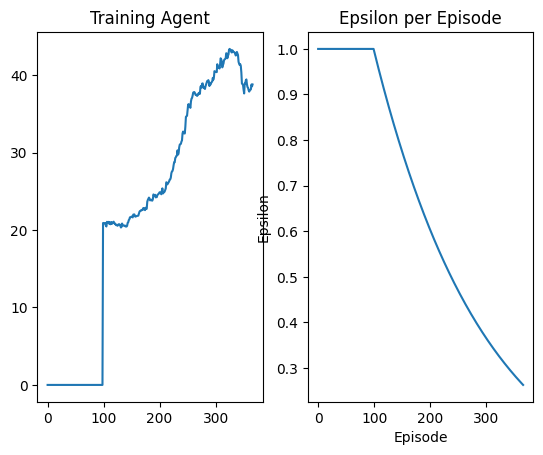

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 367 Duration 46 steps | epsilon 0.26146747409471627


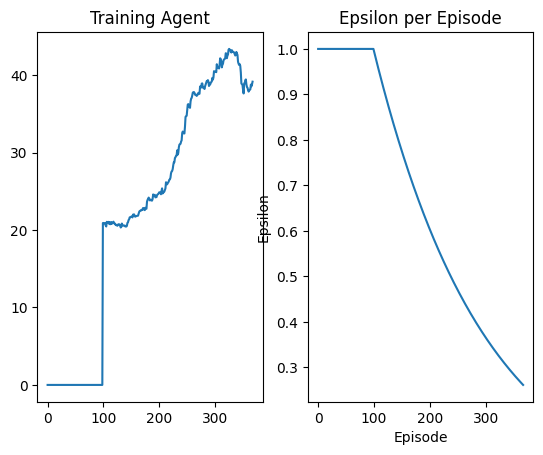

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 368 Duration 15 steps | epsilon 0.2601619965103326


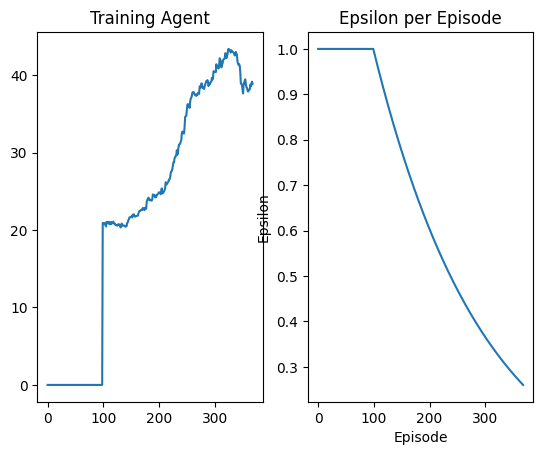

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 369 Duration 53 steps | epsilon 0.2588630370281689


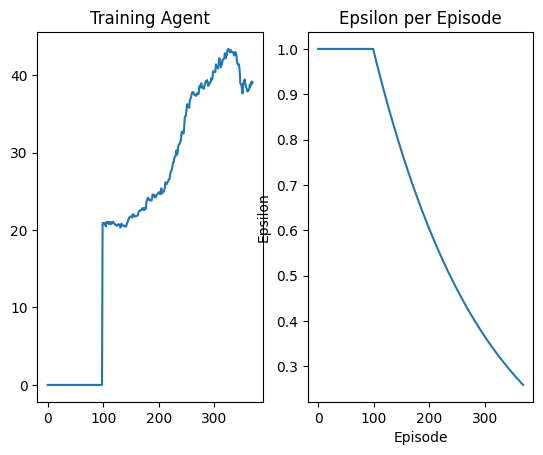

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 370 Duration 15 steps | epsilon 0.2575705631040764


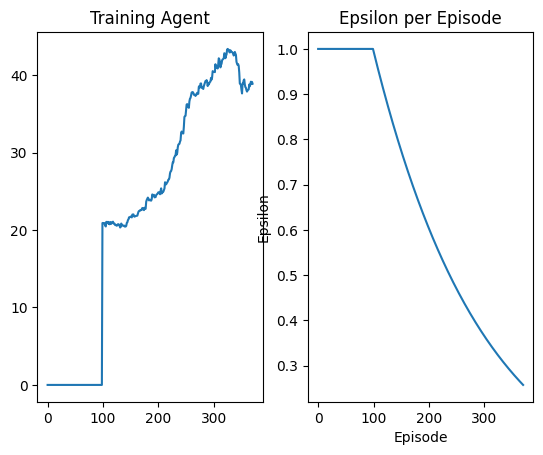

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 371 Duration 46 steps | epsilon 0.2562845423563958


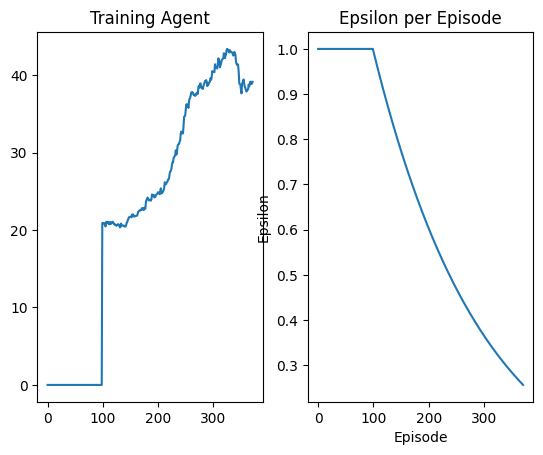

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 372 Duration 17 steps | epsilon 0.2550049425651457


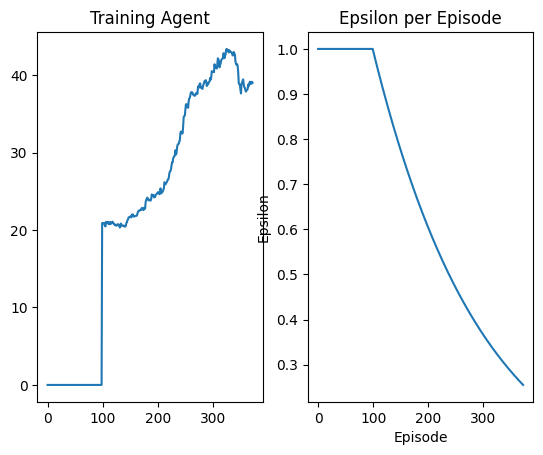

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 373 Duration 26 steps | epsilon 0.25373173167121543


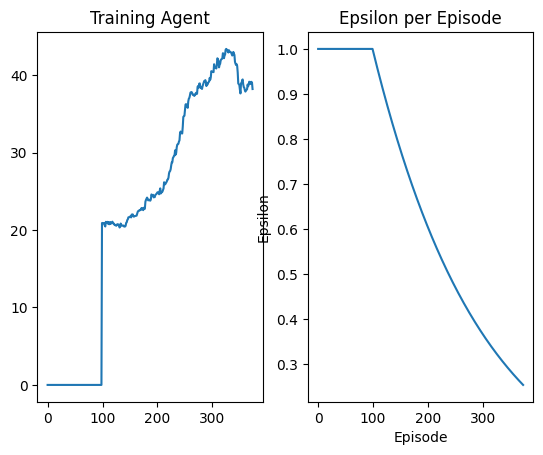

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 374 Duration 110 steps | epsilon 0.25246487777556176


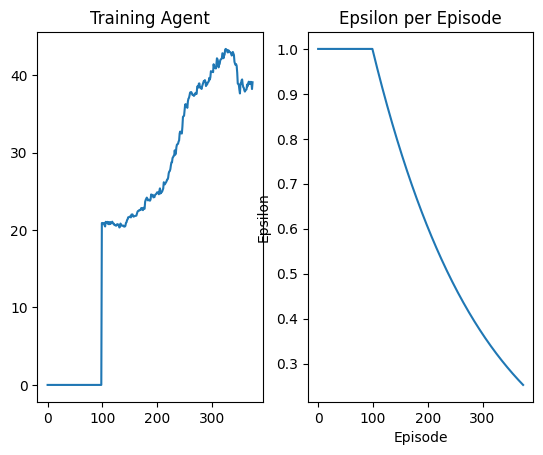

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 375 Duration 53 steps | epsilon 0.2512043491384099


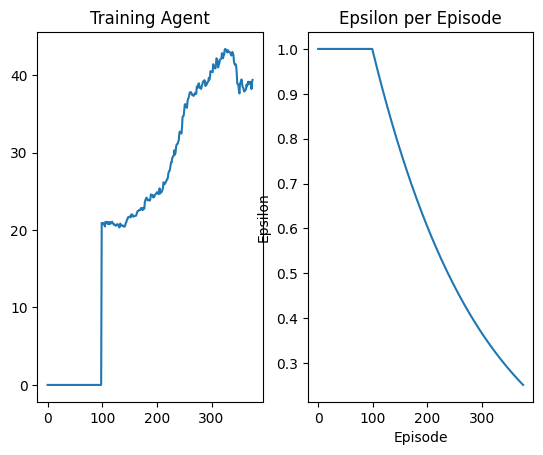

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 376 Duration 78 steps | epsilon 0.24995011417845814


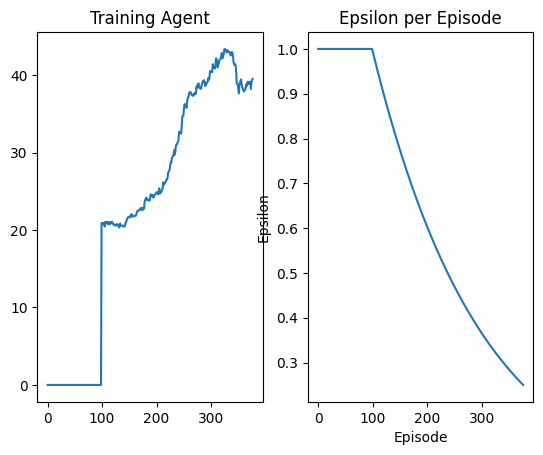

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 377 Duration 15 steps | epsilon 0.24870214147208664


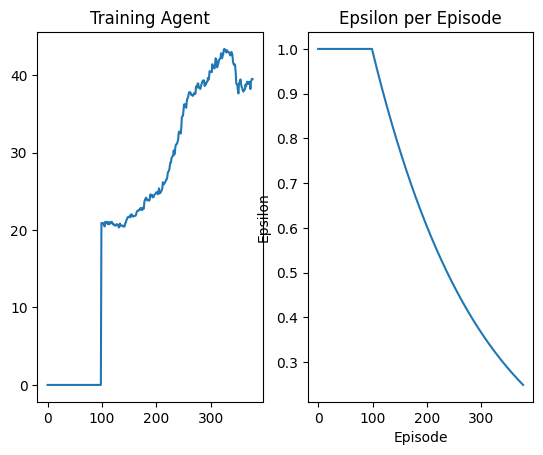

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 378 Duration 39 steps | epsilon 0.24746039975257011


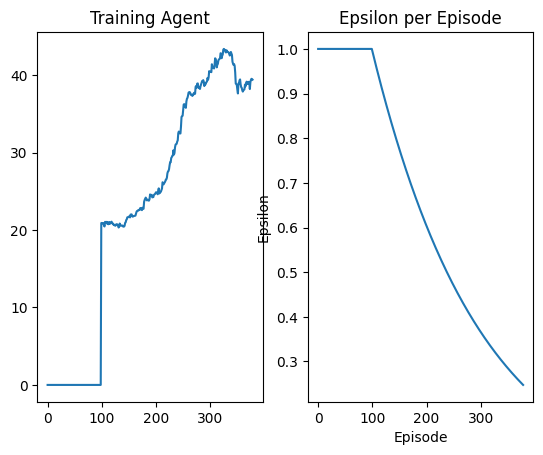

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 379 Duration 61 steps | epsilon 0.24622485790929455


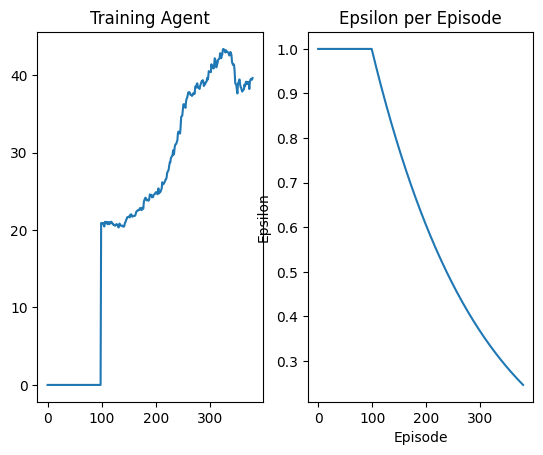

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 380 Duration 62 steps | epsilon 0.24499548498697768


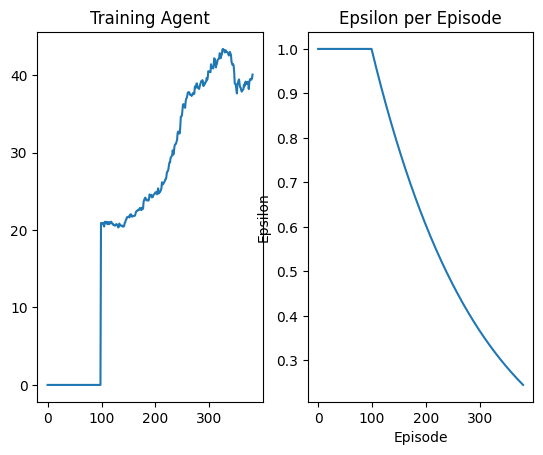

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 381 Duration 70 steps | epsilon 0.2437722501848935


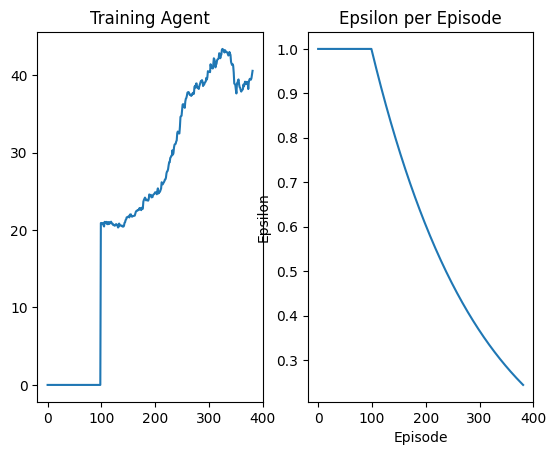

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 382 Duration 40 steps | epsilon 0.2425551228561006


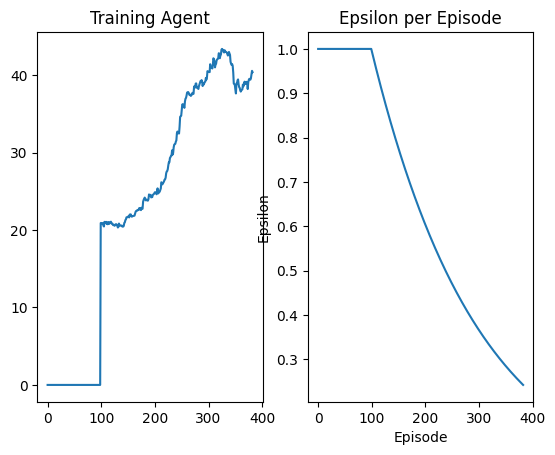

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 383 Duration 55 steps | epsilon 0.24134407250667414


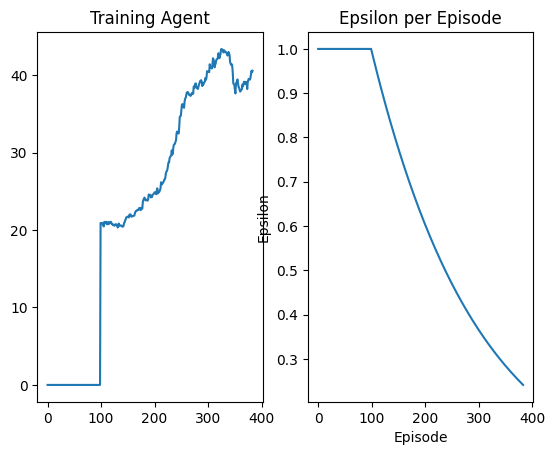

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 384 Duration 53 steps | epsilon 0.24013906879494215


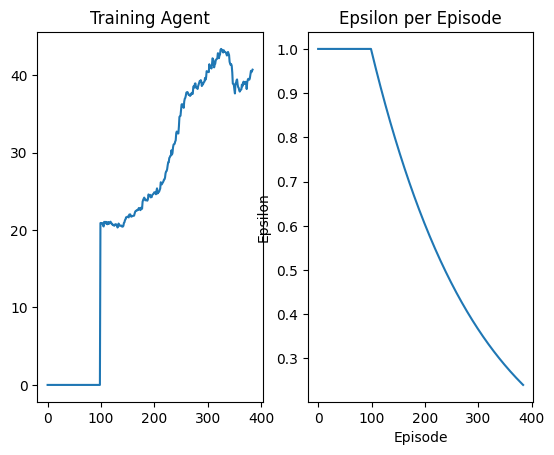

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 385 Duration 32 steps | epsilon 0.23894008153072516


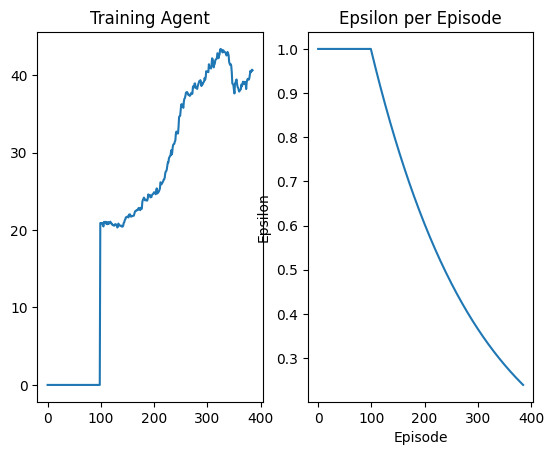

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 386 Duration 97 steps | epsilon 0.2377470806745798


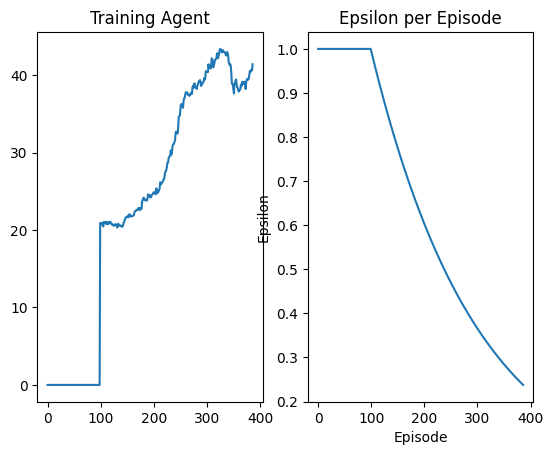

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 387 Duration 11 steps | epsilon 0.23656003633704634


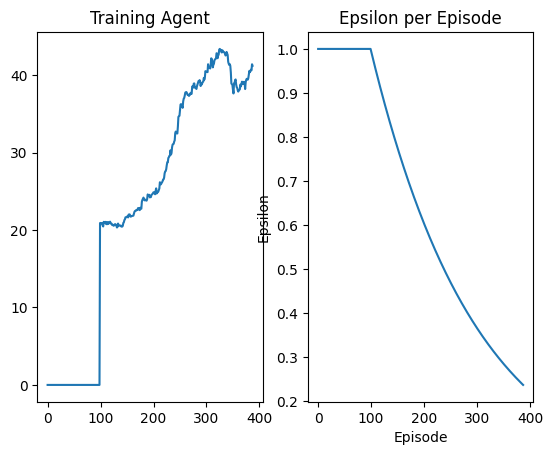

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 388 Duration 29 steps | epsilon 0.23537891877789968


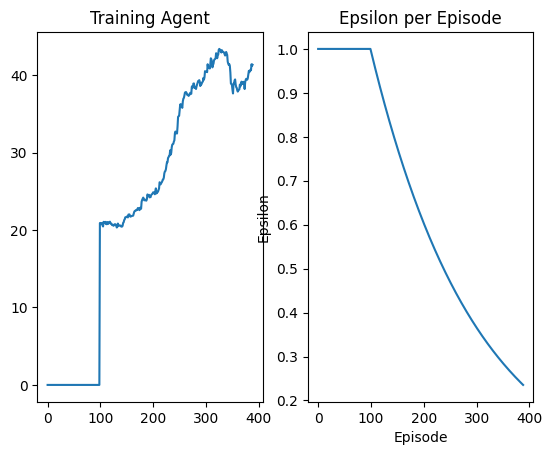

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 389 Duration 19 steps | epsilon 0.23420369840540436


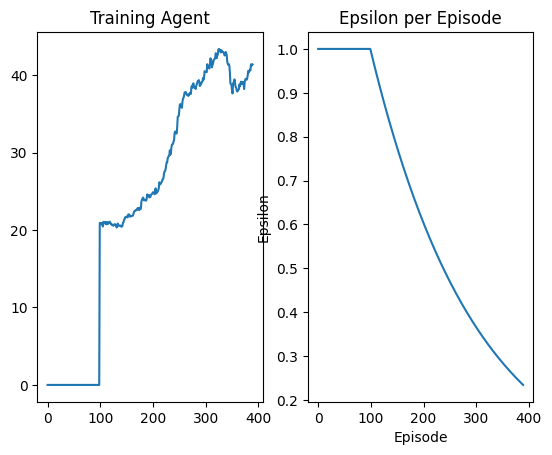

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 390 Duration 72 steps | epsilon 0.23303434577557308


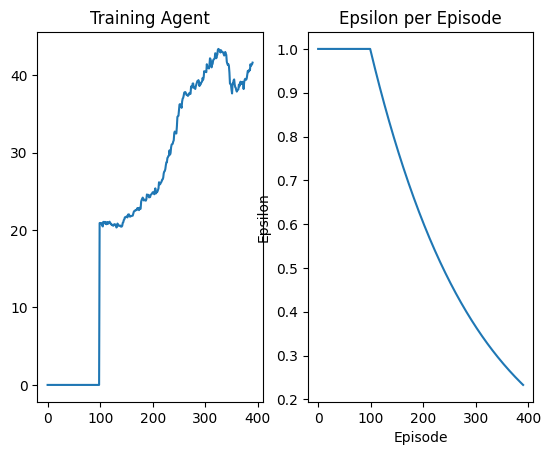

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 391 Duration 37 steps | epsilon 0.23187083159142904


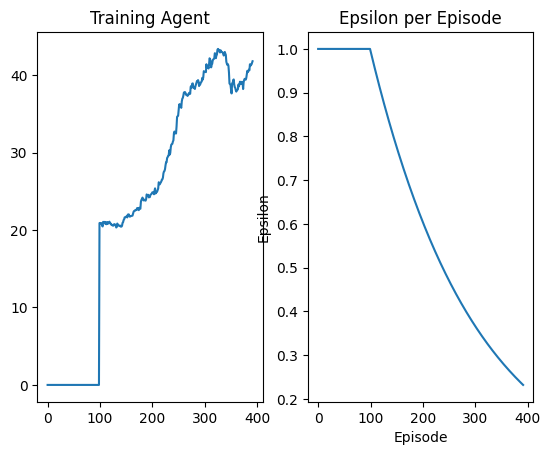

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 392 Duration 41 steps | epsilon 0.23071312670227198


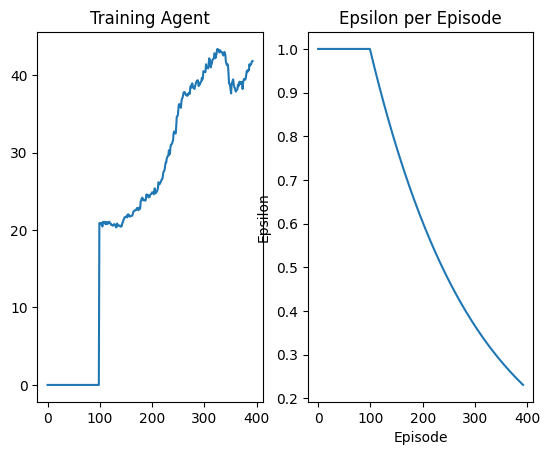

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 393 Duration 31 steps | epsilon 0.22956120210294775


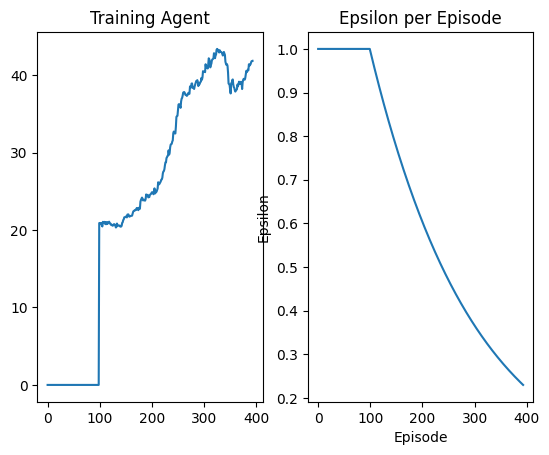

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 394 Duration 32 steps | epsilon 0.22841502893312168


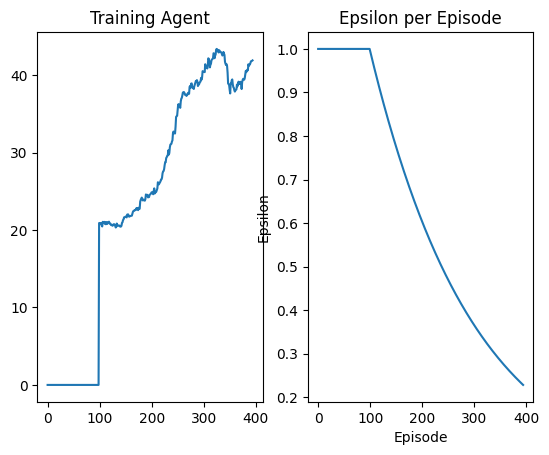

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 395 Duration 11 steps | epsilon 0.2272745784765555


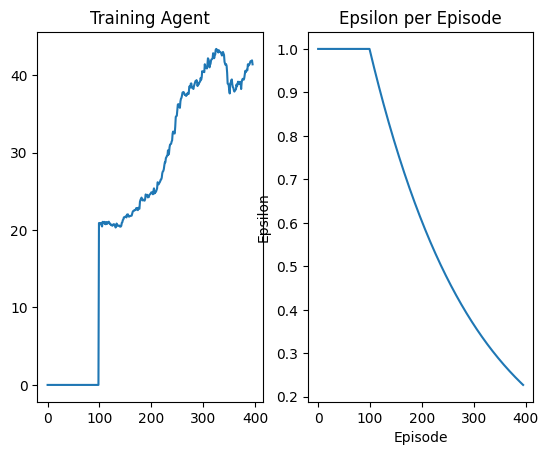

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 396 Duration 48 steps | epsilon 0.22613982216038783


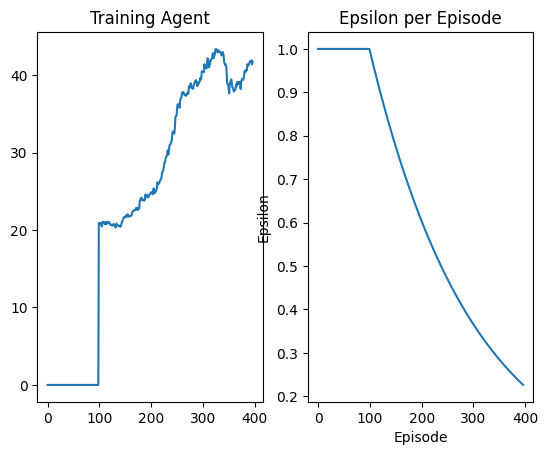

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 397 Duration 22 steps | epsilon 0.22501073155441845


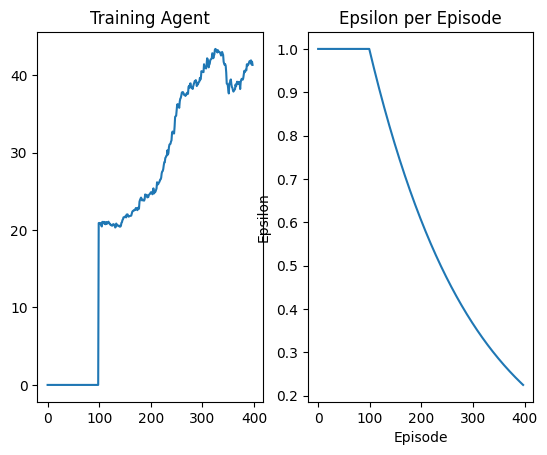

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 398 Duration 44 steps | epsilon 0.22388727837039585


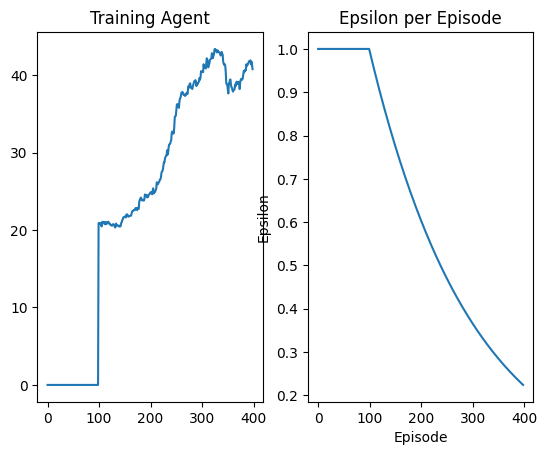

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 399 Duration 31 steps | epsilon 0.2227694344613086


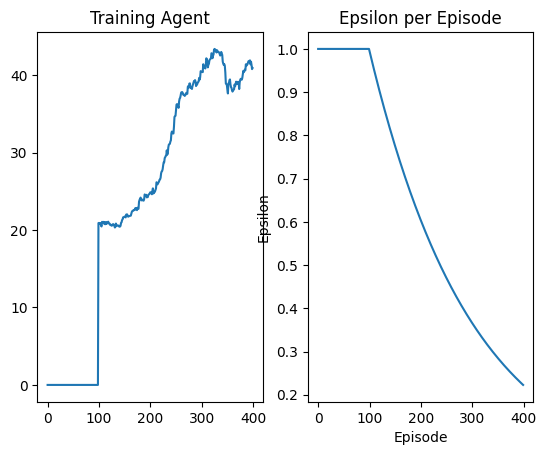

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 400 Duration 86 steps | epsilon 0.2216571718206801


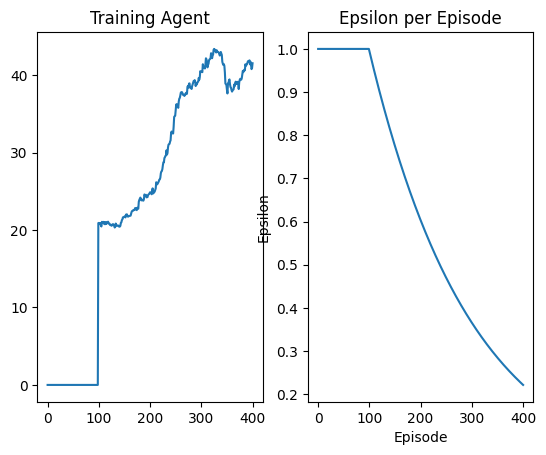

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 401 Duration 79 steps | epsilon 0.22055046258186692


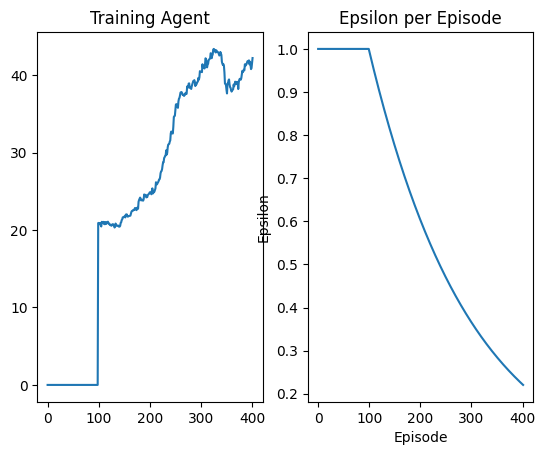

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 402 Duration 36 steps | epsilon 0.21944927901736067


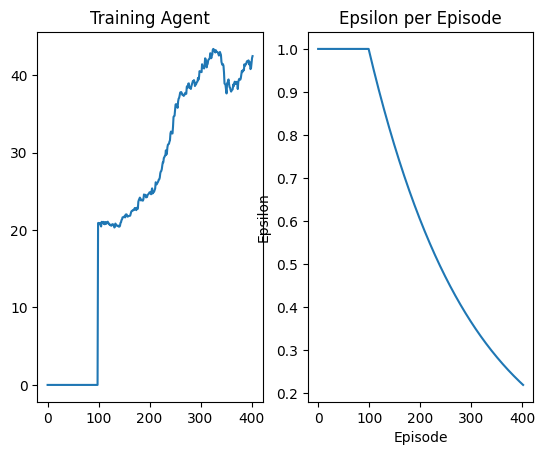

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 403 Duration 46 steps | epsilon 0.21835359353809325


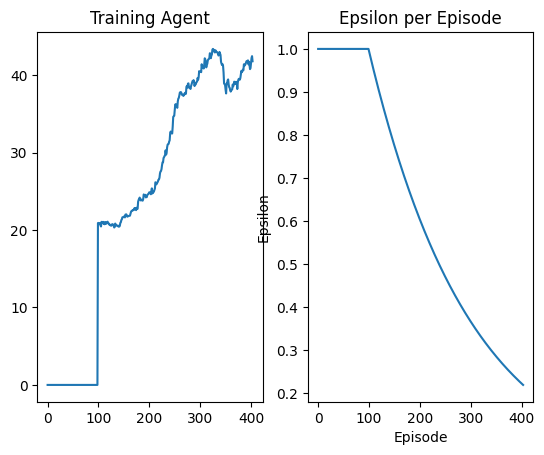

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 404 Duration 78 steps | epsilon 0.21726337869274567


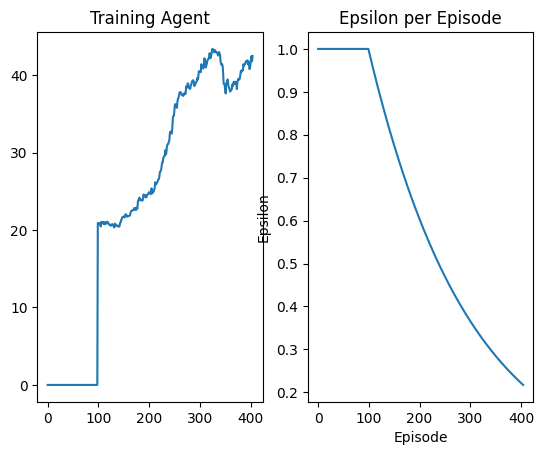

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 405 Duration 15 steps | epsilon 0.21617860716706028


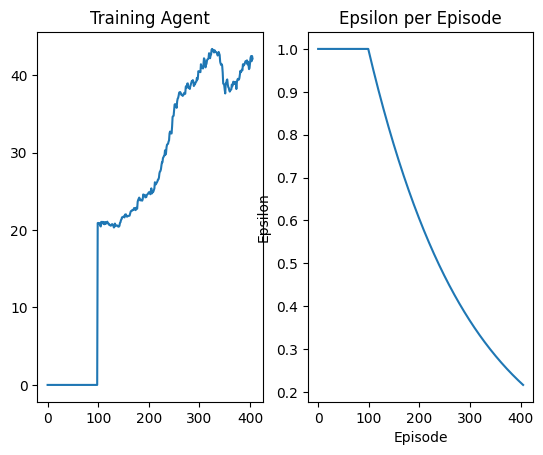

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 406 Duration 132 steps | epsilon 0.21509925178315642


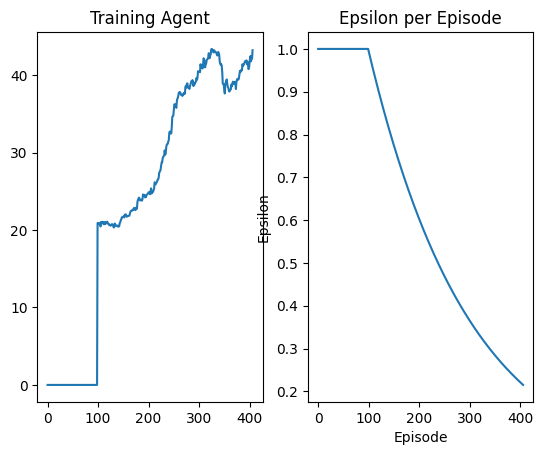

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 407 Duration 62 steps | epsilon 0.21402528549884955


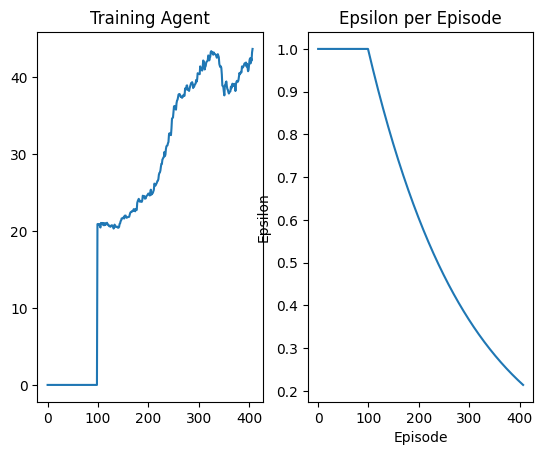

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 408 Duration 53 steps | epsilon 0.2129566814069737


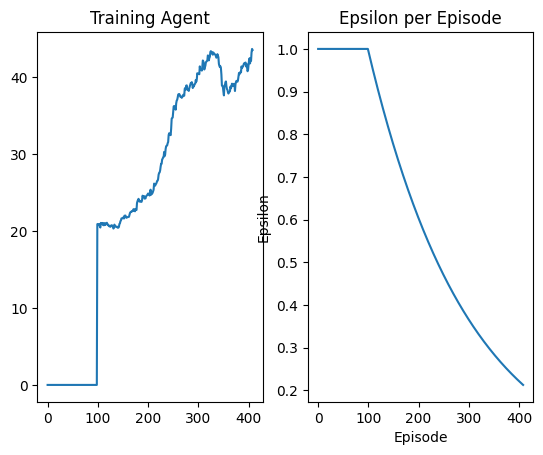

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 409 Duration 15 steps | epsilon 0.21189341273470735


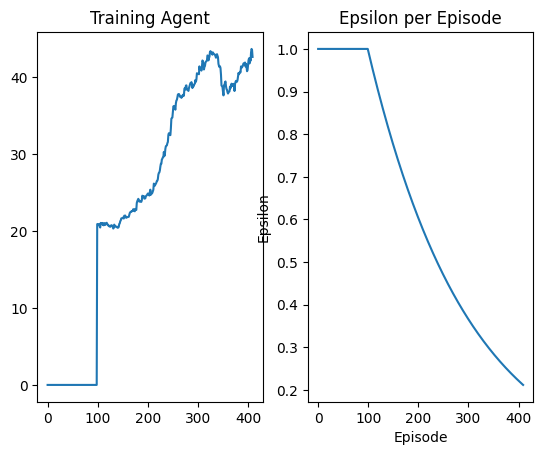

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 410 Duration 12 steps | epsilon 0.2108354528429026


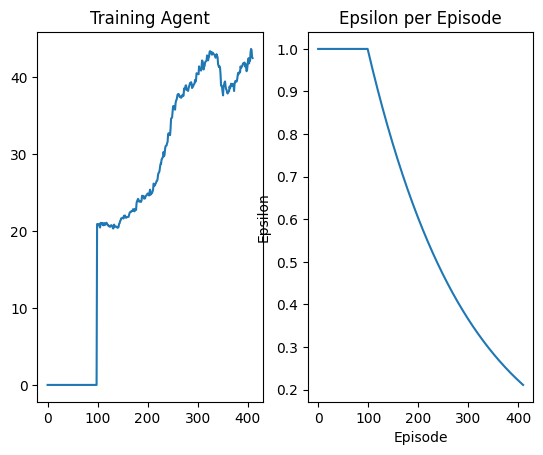

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 411 Duration 55 steps | epsilon 0.20978277522541783


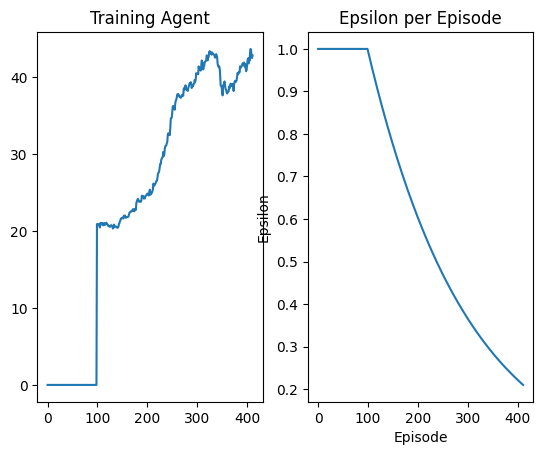

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 412 Duration 31 steps | epsilon 0.20873535350845365


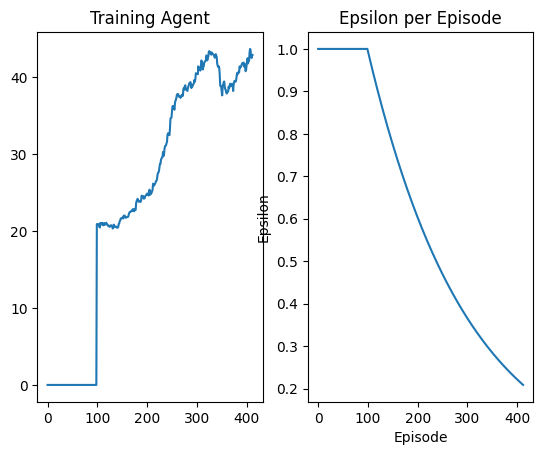

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 413 Duration 53 steps | epsilon 0.20769316144989203


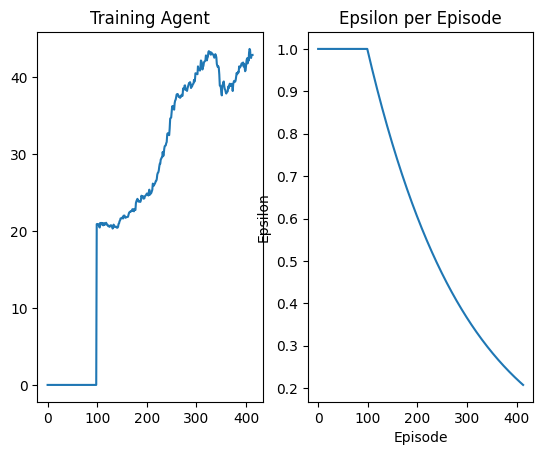

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 414 Duration 59 steps | epsilon 0.20665617293863886


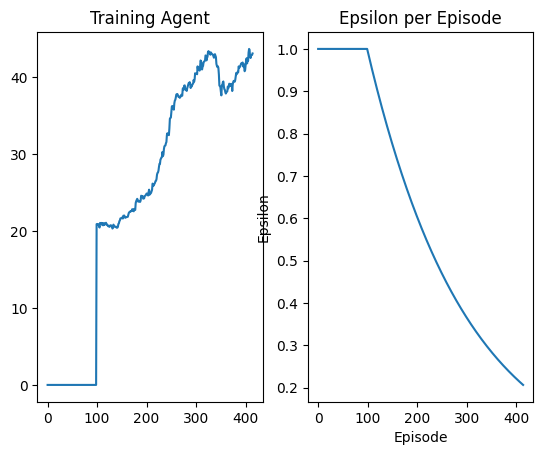

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 415 Duration 37 steps | epsilon 0.2056243619939698


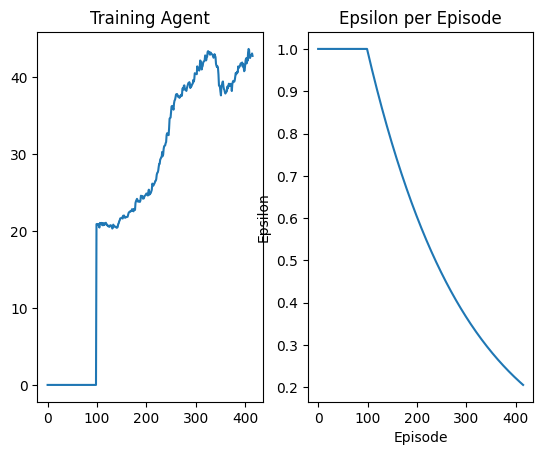

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 416 Duration 20 steps | epsilon 0.20459770276487935


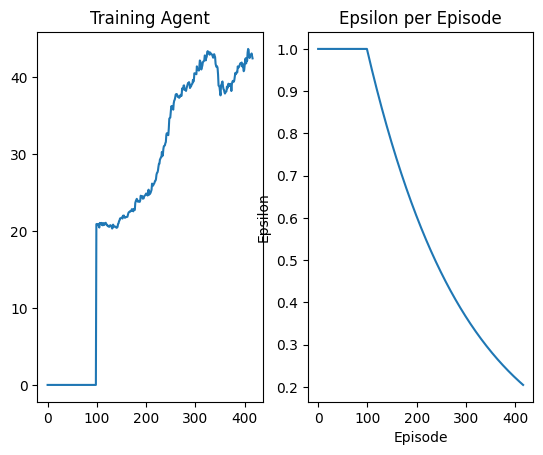

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 417 Duration 34 steps | epsilon 0.2035761695294331


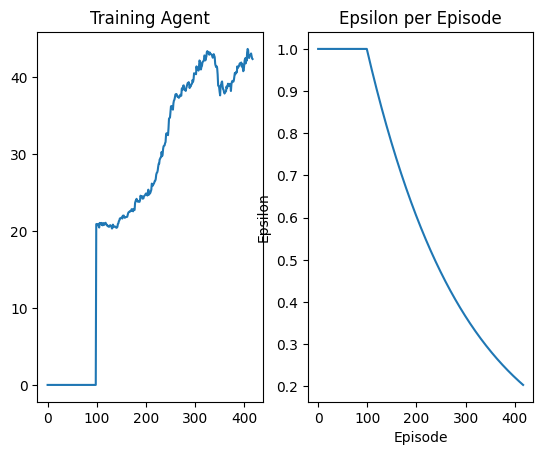

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 418 Duration 35 steps | epsilon 0.20255973669412342


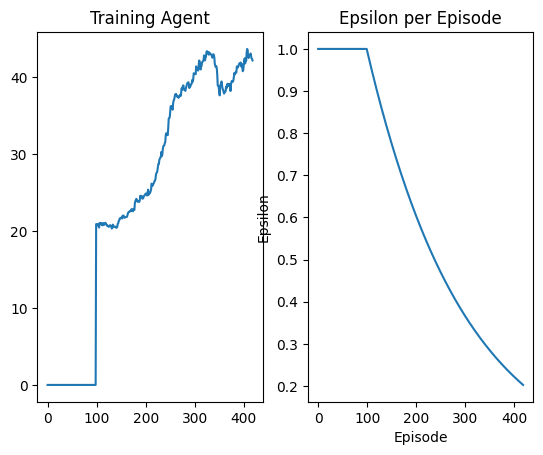

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 419 Duration 89 steps | epsilon 0.20154837879322812


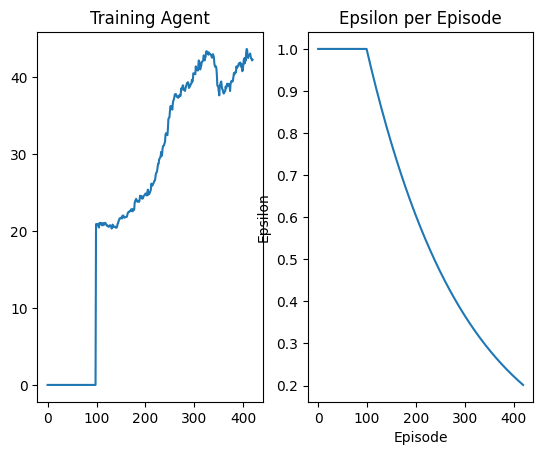

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 420 Duration 22 steps | epsilon 0.20054207048817255


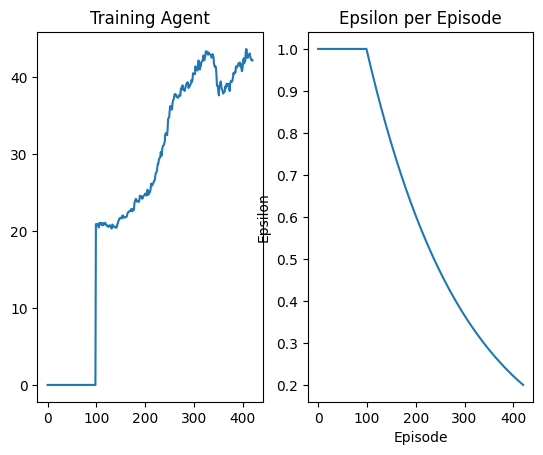

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 421 Duration 43 steps | epsilon 0.1995407865668946


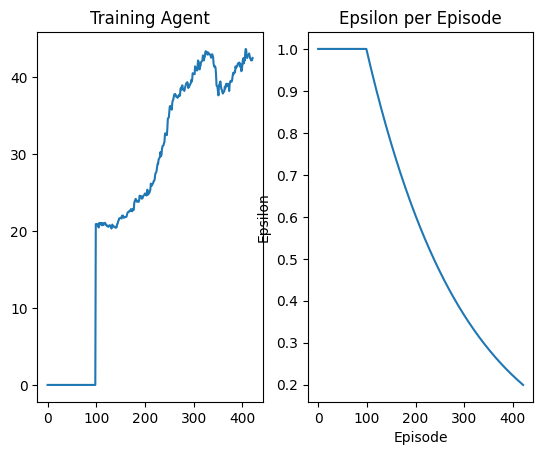

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 422 Duration 33 steps | epsilon 0.1985445019432133


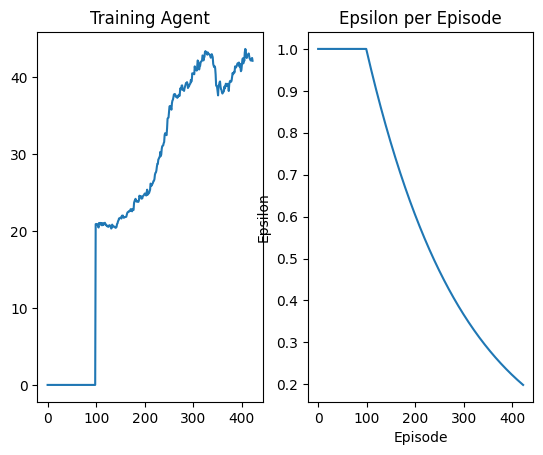

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 423 Duration 18 steps | epsilon 0.1975531916562


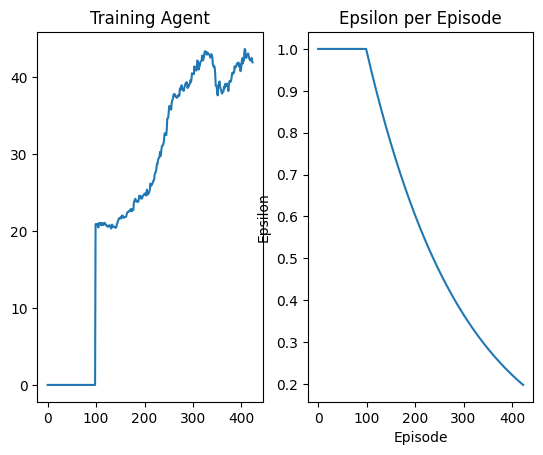

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 424 Duration 125 steps | epsilon 0.1965668308695532


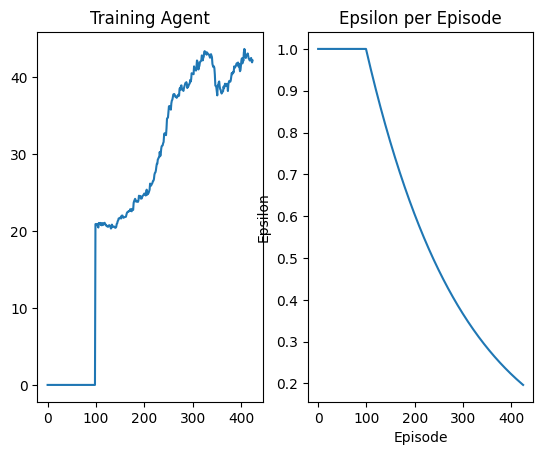

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 425 Duration 26 steps | epsilon 0.1955853948709763


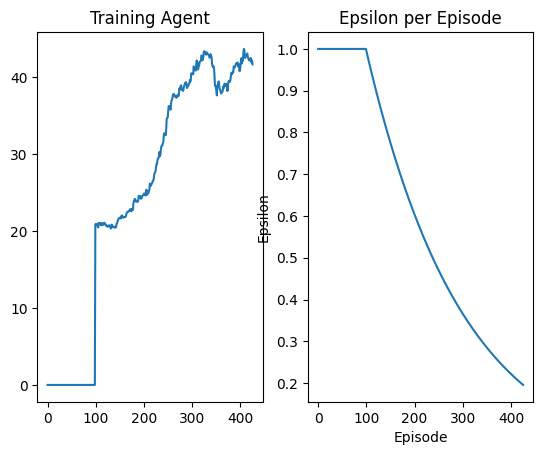

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 426 Duration 18 steps | epsilon 0.1946088590715583


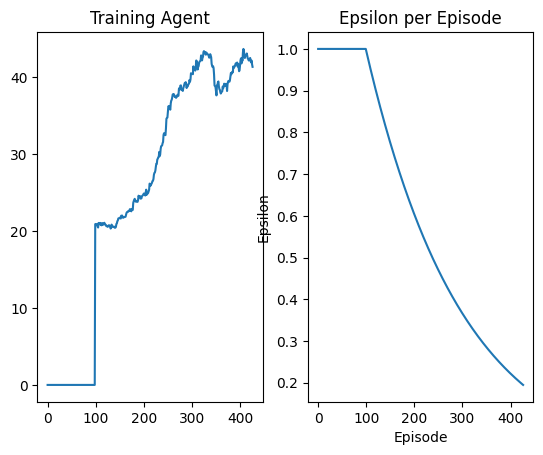

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 427 Duration 19 steps | epsilon 0.193637199005158


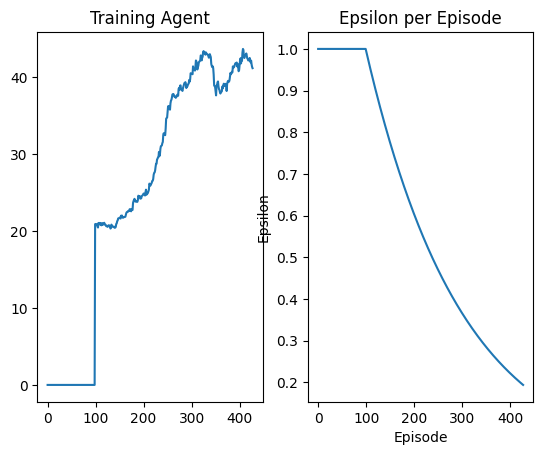

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 428 Duration 26 steps | epsilon 0.19267039032779076


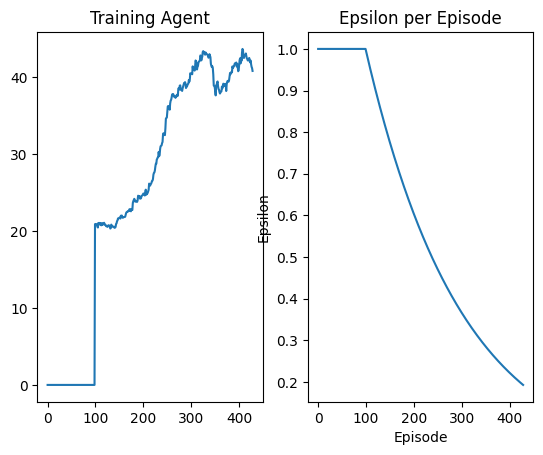

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 429 Duration 90 steps | epsilon 0.19170840881701876


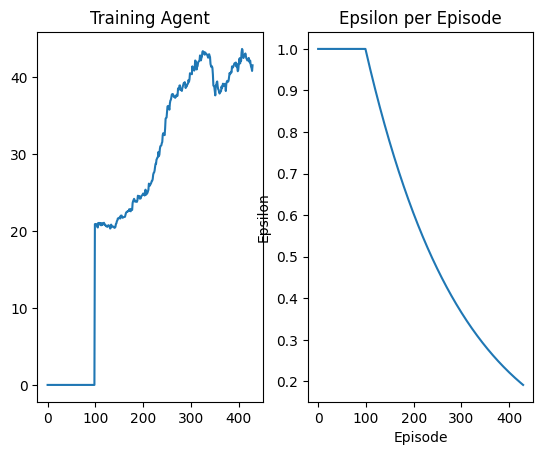

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 430 Duration 58 steps | epsilon 0.19075123037134406


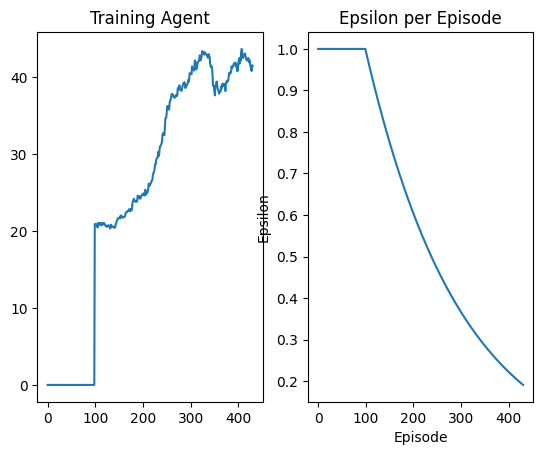

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 431 Duration 64 steps | epsilon 0.1897988310096048


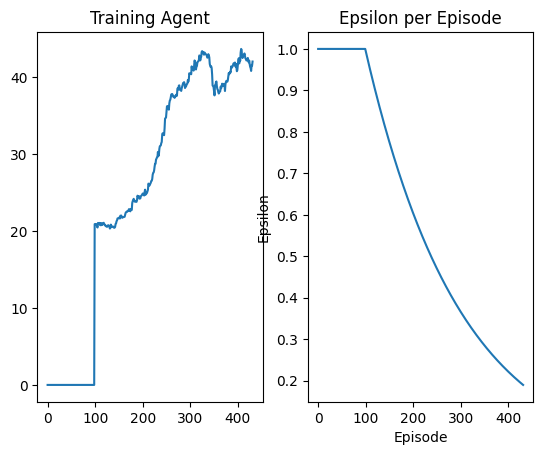

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 432 Duration 19 steps | epsilon 0.1888511868703743


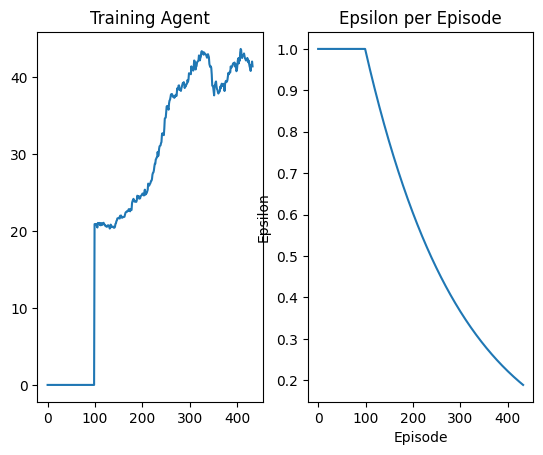

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 433 Duration 79 steps | epsilon 0.18790827421136339


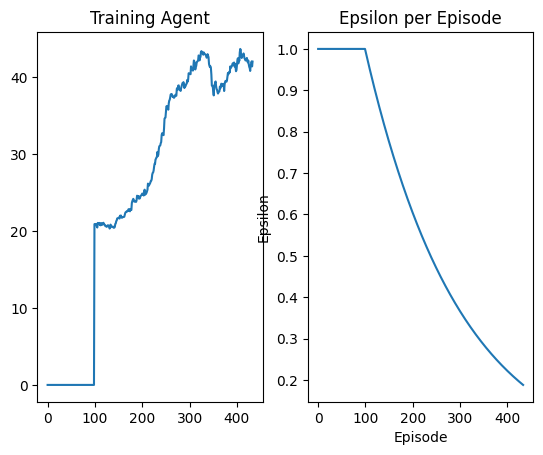

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 434 Duration 19 steps | epsilon 0.18697006940882538


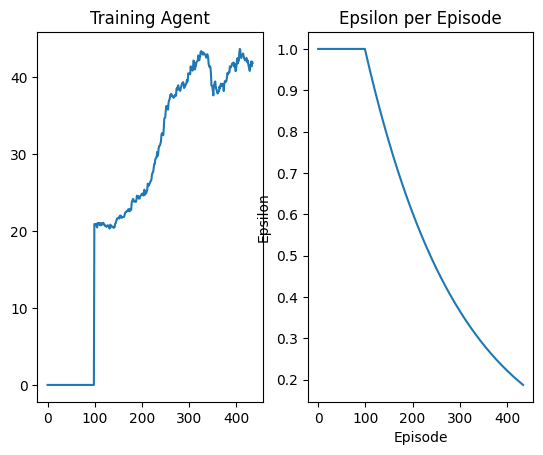

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 435 Duration 21 steps | epsilon 0.1860365489569643


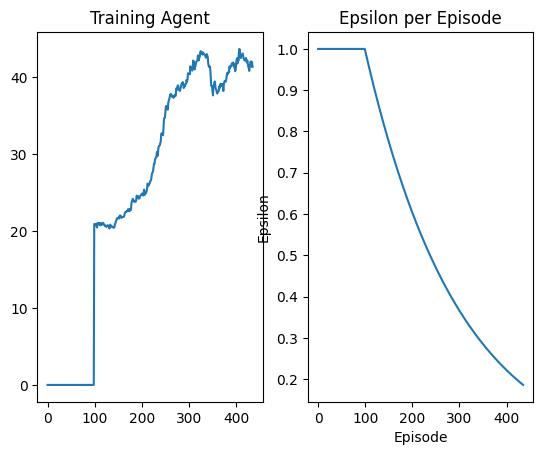

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 436 Duration 21 steps | epsilon 0.18510768946734601


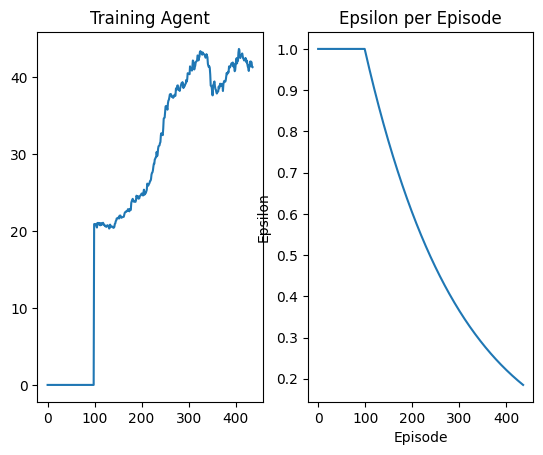

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 437 Duration 14 steps | epsilon 0.18418346766831212


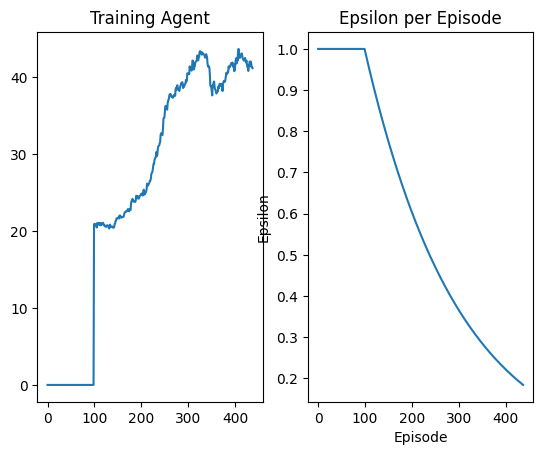

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 438 Duration 17 steps | epsilon 0.18326386040439704


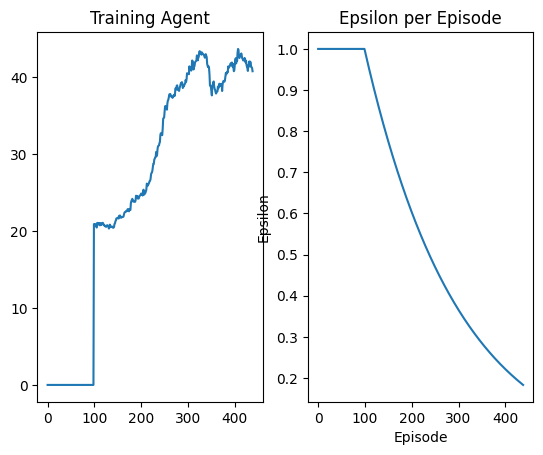

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 439 Duration 12 steps | epsilon 0.1823488446357478


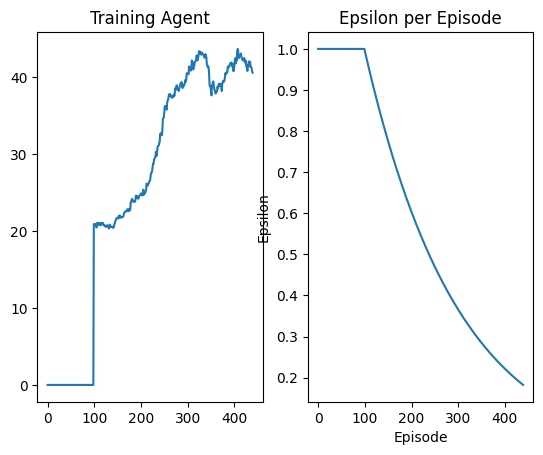

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 440 Duration 77 steps | epsilon 0.1814383974375468


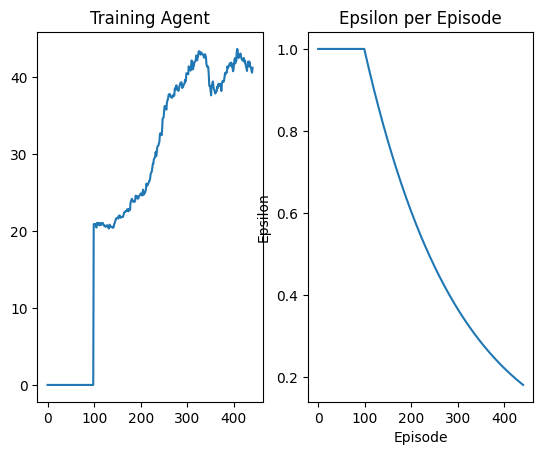

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 441 Duration 18 steps | epsilon 0.18053249599943752


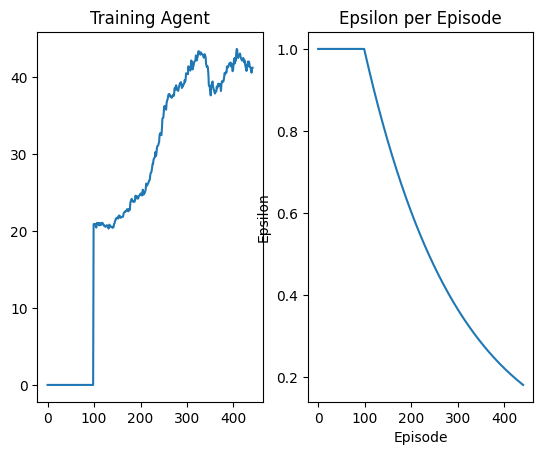

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 442 Duration 26 steps | epsilon 0.1796311176249529


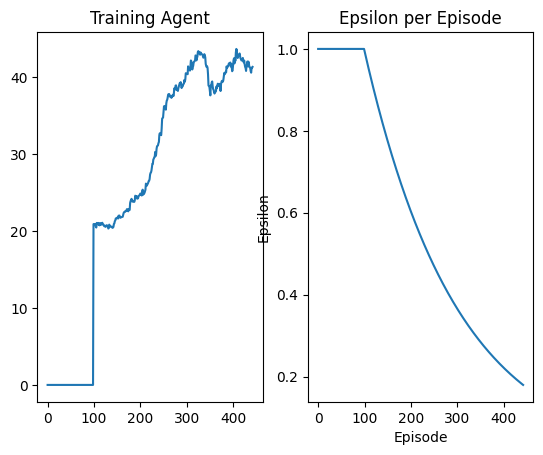

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 443 Duration 119 steps | epsilon 0.17873423973094685


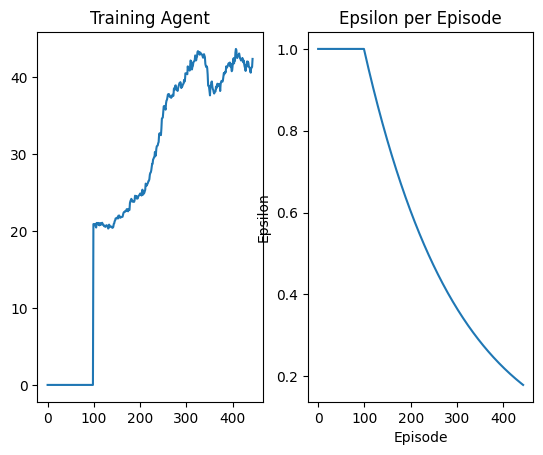

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 444 Duration 25 steps | epsilon 0.1778418398470283


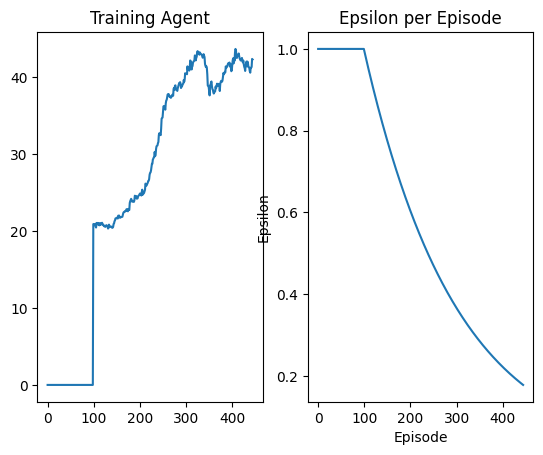

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 445 Duration 83 steps | epsilon 0.17695389561499839


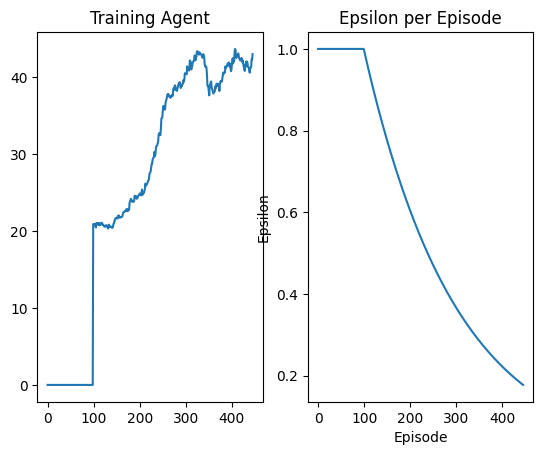

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 446 Duration 89 steps | epsilon 0.17607038478829012


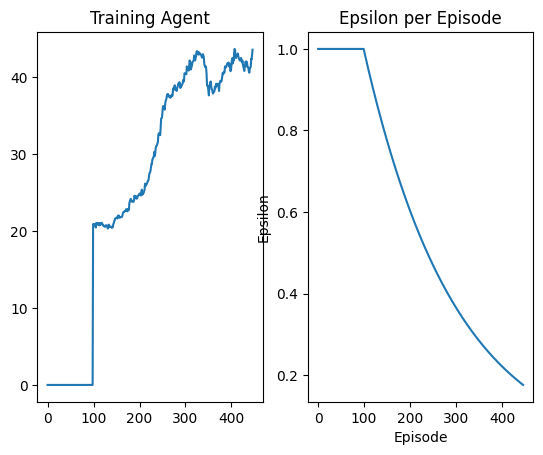

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 447 Duration 17 steps | epsilon 0.17519128523141123


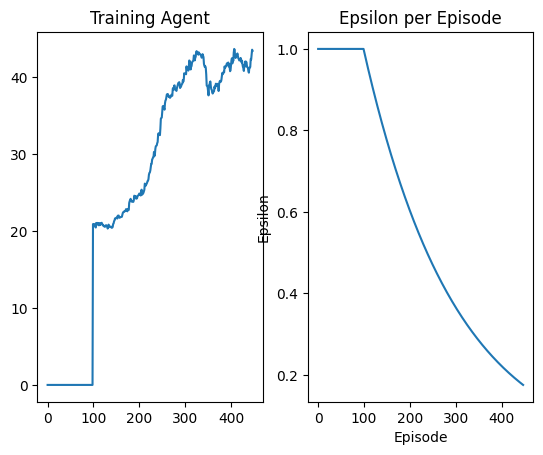

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 448 Duration 37 steps | epsilon 0.17431657491938934


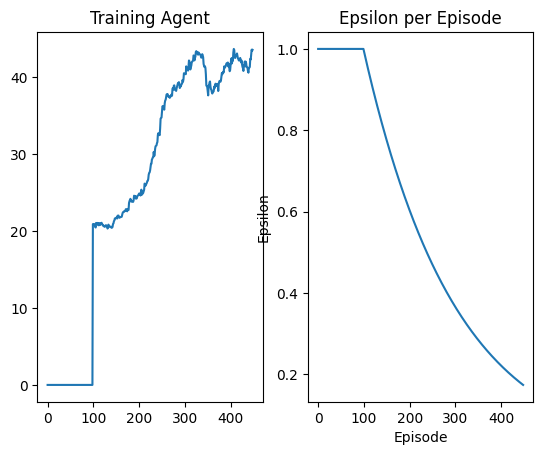

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 449 Duration 45 steps | epsilon 0.17344623193722034


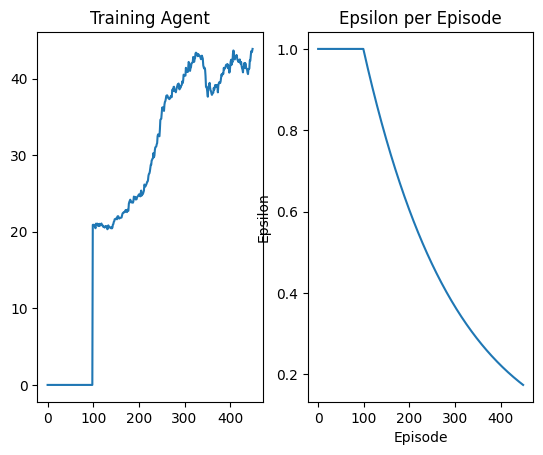

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 450 Duration 13 steps | epsilon 0.17258023447931925


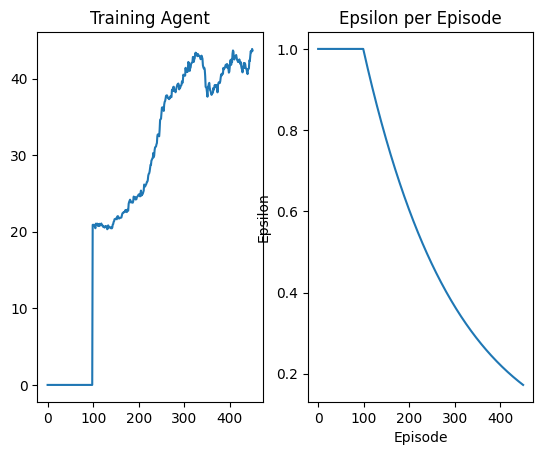

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 451 Duration 11 steps | epsilon 0.1717185608489739


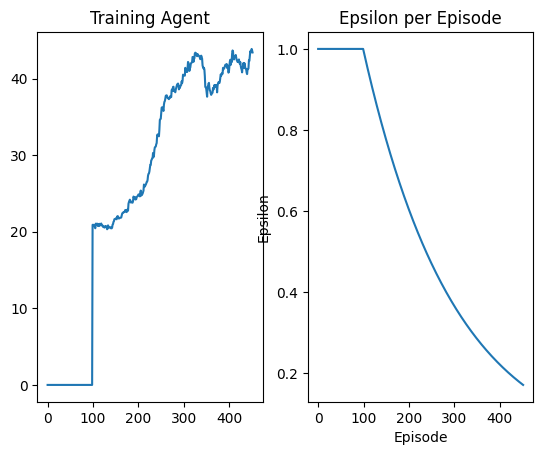

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 452 Duration 82 steps | epsilon 0.1708611894578014


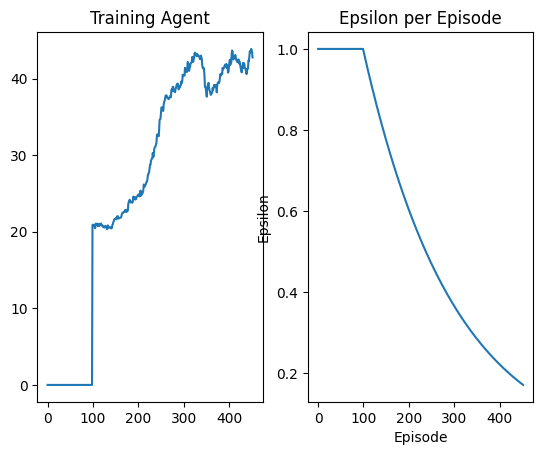

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 453 Duration 158 steps | epsilon 0.17000809882520715


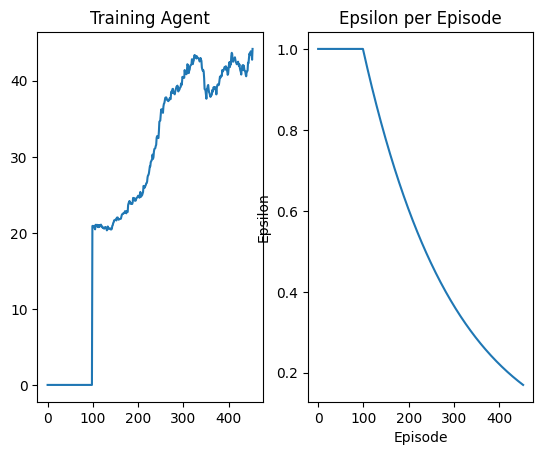

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 454 Duration 74 steps | epsilon 0.16915926757784677


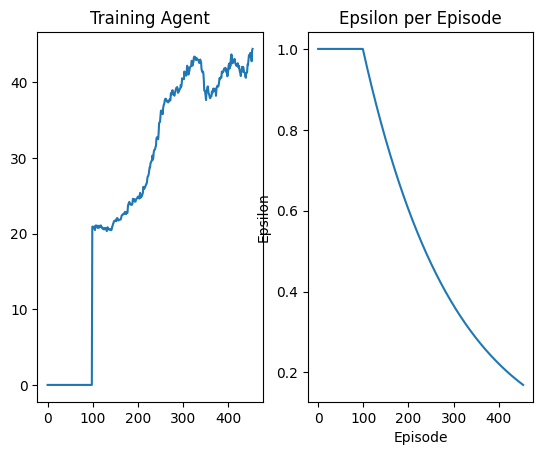

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 455 Duration 45 steps | epsilon 0.1683146744490906


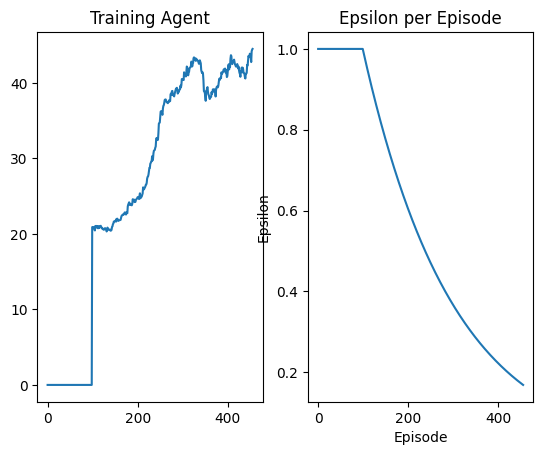

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 456 Duration 66 steps | epsilon 0.1674742982784908


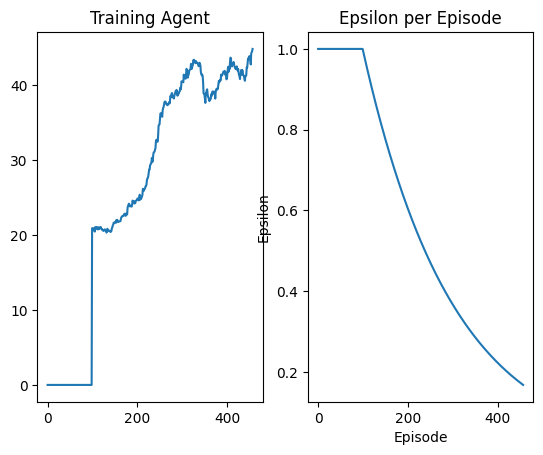

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 457 Duration 50 steps | epsilon 0.16663811801125133


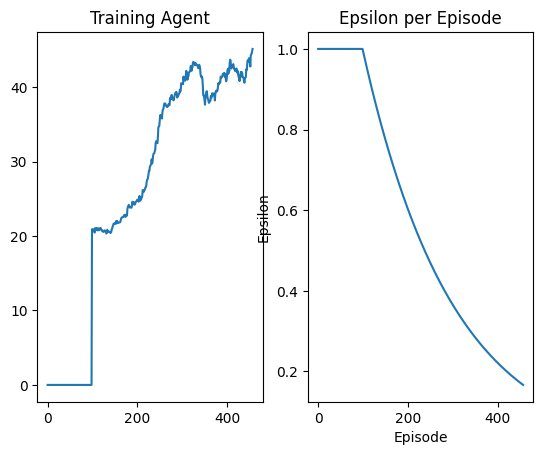

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 458 Duration 70 steps | epsilon 0.16580611269770035


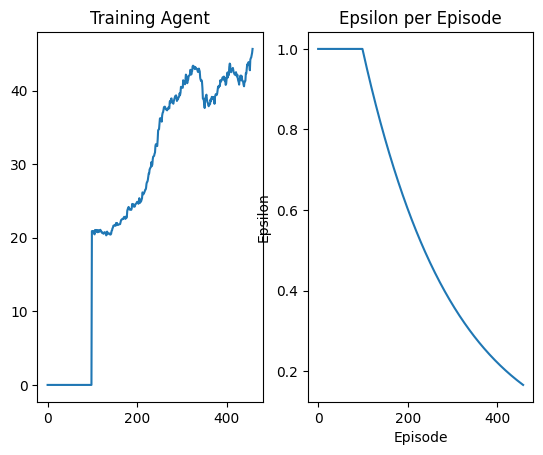

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 459 Duration 139 steps | epsilon 0.16497826149276532


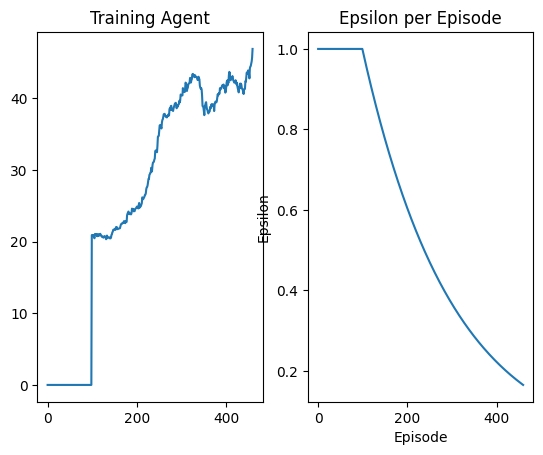

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 460 Duration 124 steps | epsilon 0.16415454365545082


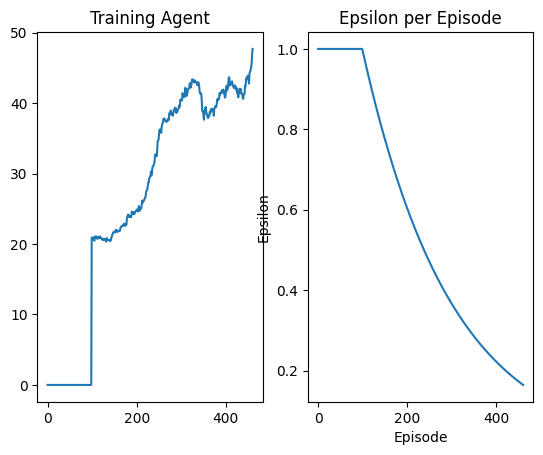

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 461 Duration 39 steps | epsilon 0.1633349385483189


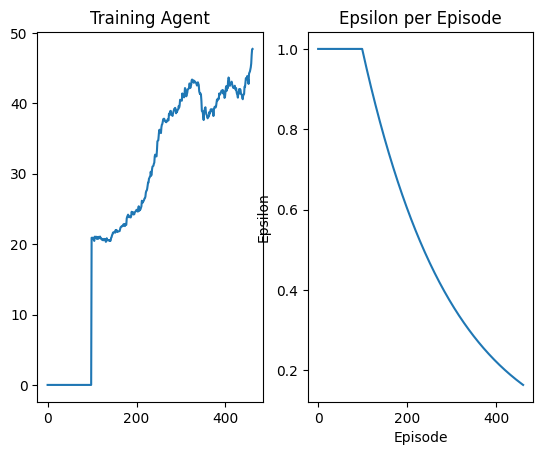

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 462 Duration 15 steps | epsilon 0.16251942563697197


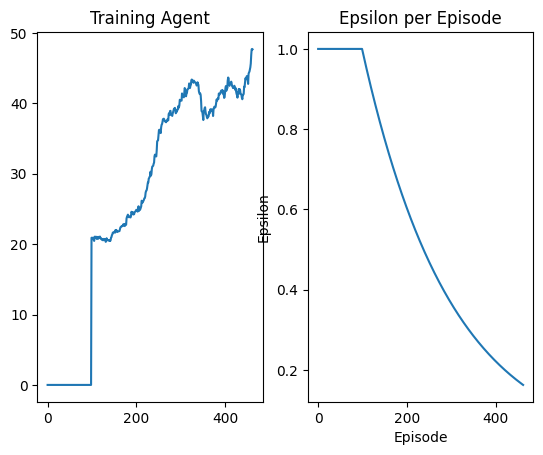

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 463 Duration 34 steps | epsilon 0.1617079844895384


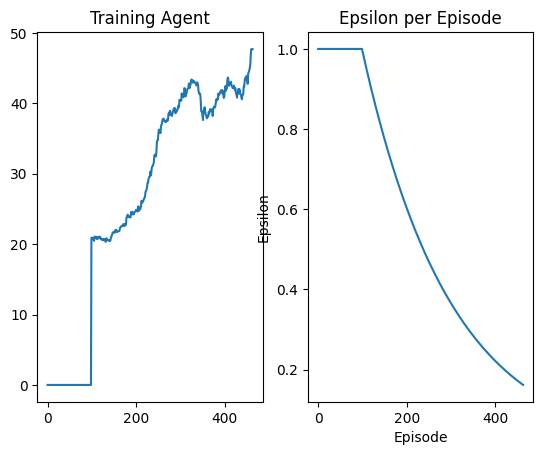

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 464 Duration 71 steps | epsilon 0.16090059477616062


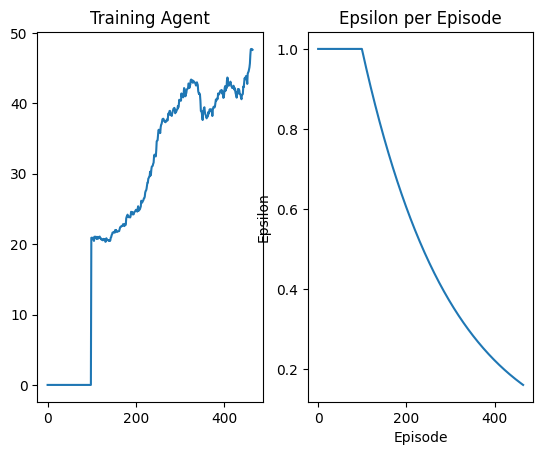

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 465 Duration 39 steps | epsilon 0.16009723626848565


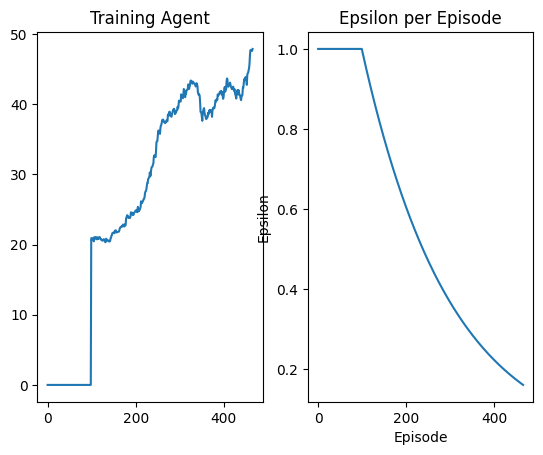

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 466 Duration 72 steps | epsilon 0.1592978888391585


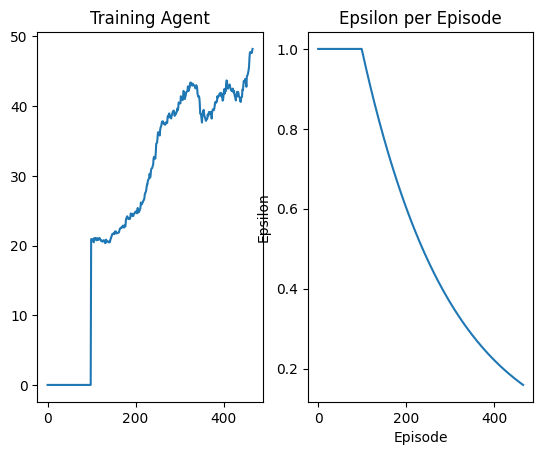

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 467 Duration 103 steps | epsilon 0.15850253246131768


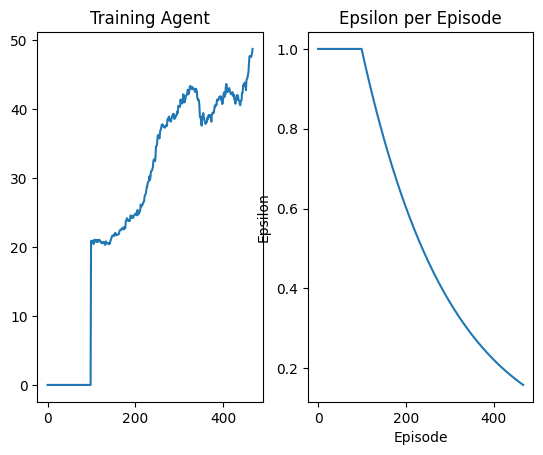

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 468 Duration 154 steps | epsilon 0.15771114720809368


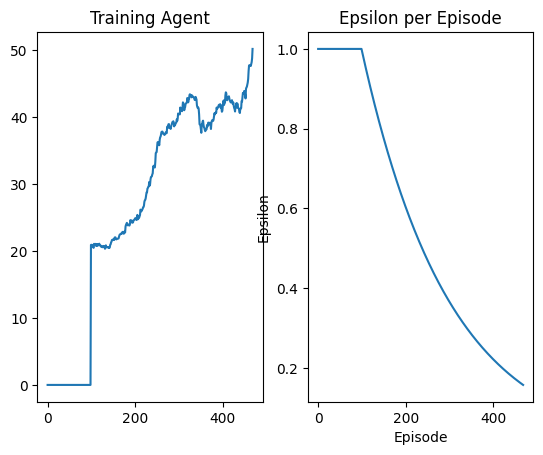

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 469 Duration 114 steps | epsilon 0.1569237132521095


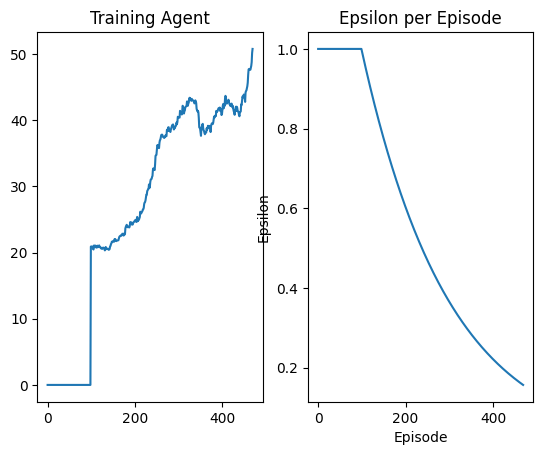

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 470 Duration 99 steps | epsilon 0.15614021086498403


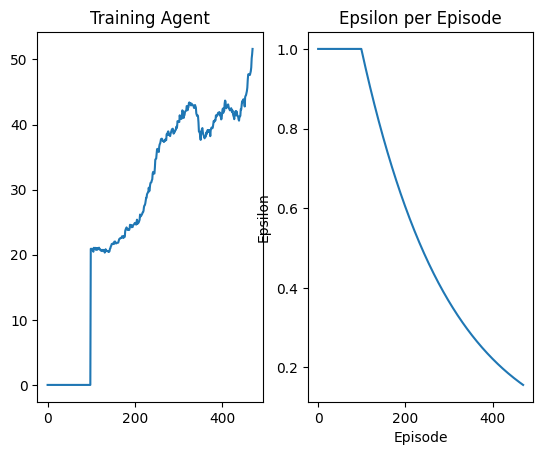

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 471 Duration 109 steps | epsilon 0.15536062041683776


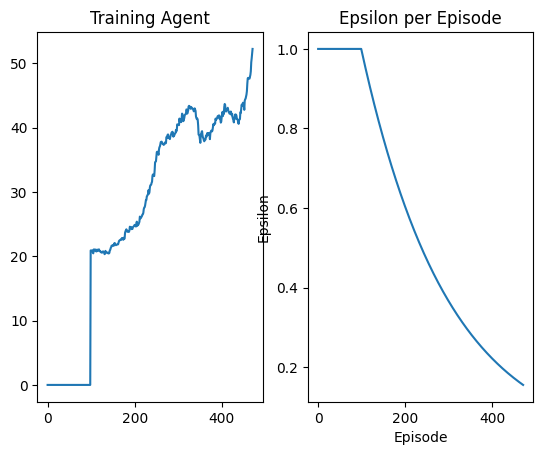

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 472 Duration 70 steps | epsilon 0.15458492237580096


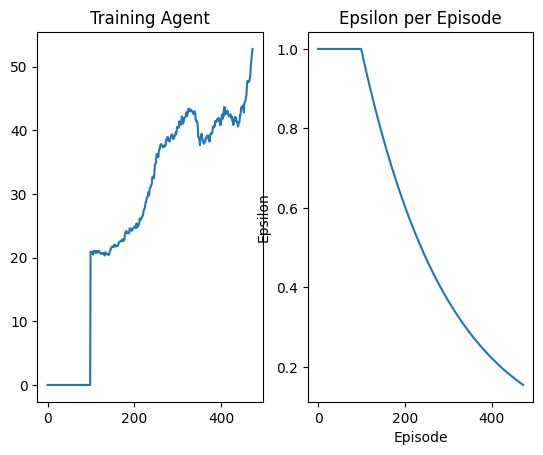

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 473 Duration 67 steps | epsilon 0.15381309730752427


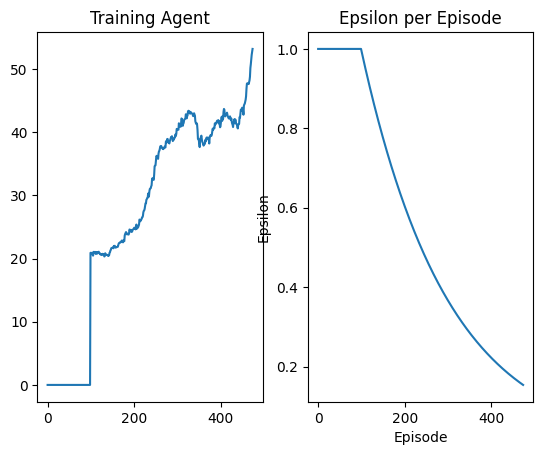

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 474 Duration 57 steps | epsilon 0.15304512587469185


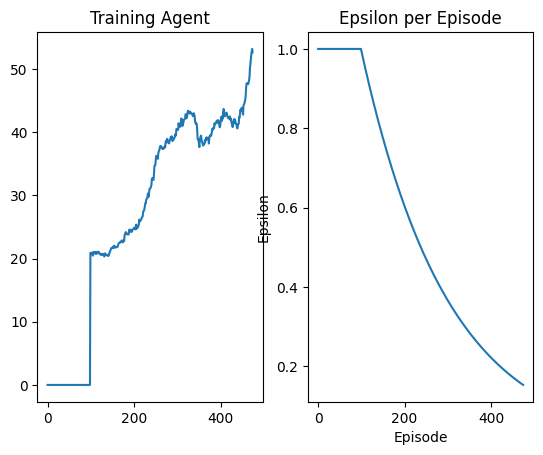

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 475 Duration 55 steps | epsilon 0.15228098883653696


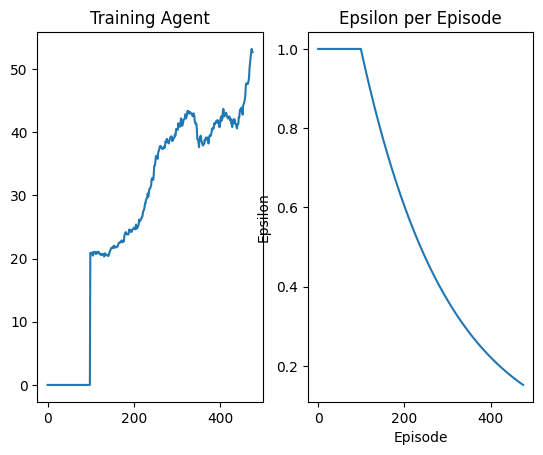

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 476 Duration 27 steps | epsilon 0.15152066704835976


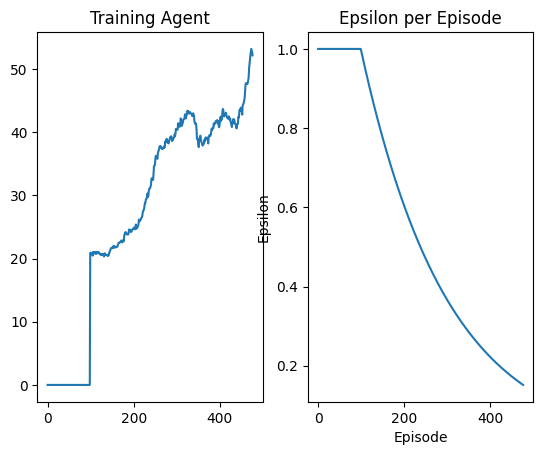

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 477 Duration 214 steps | epsilon 0.15076414146104777


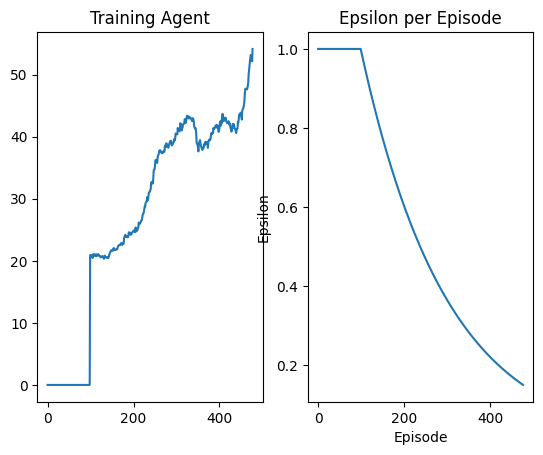

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 478 Duration 121 steps | epsilon 0.15001139312059858


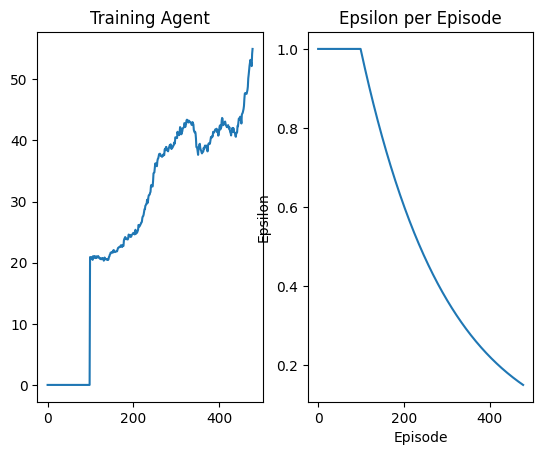

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 479 Duration 83 steps | epsilon 0.14926240316764497


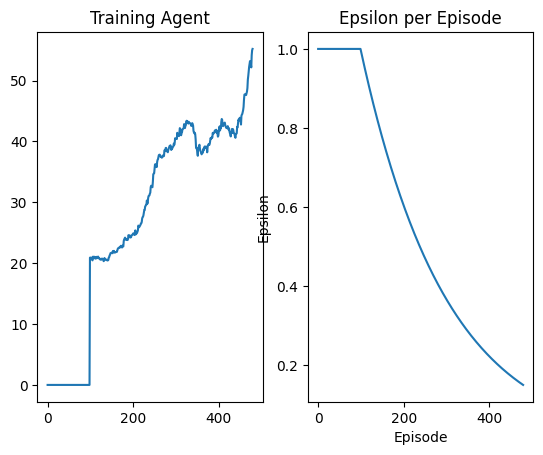

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 480 Duration 33 steps | epsilon 0.1485171528369824


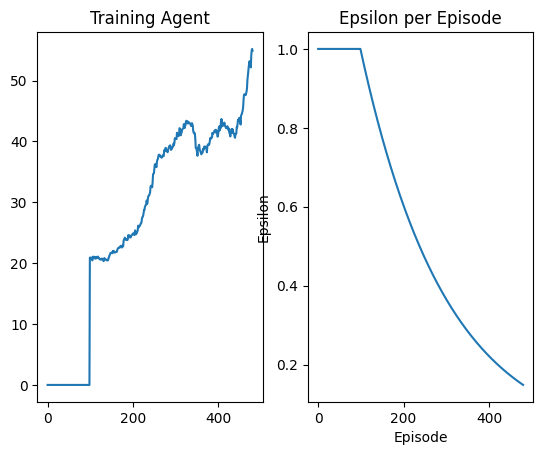

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 481 Duration 113 steps | epsilon 0.1477756234570989


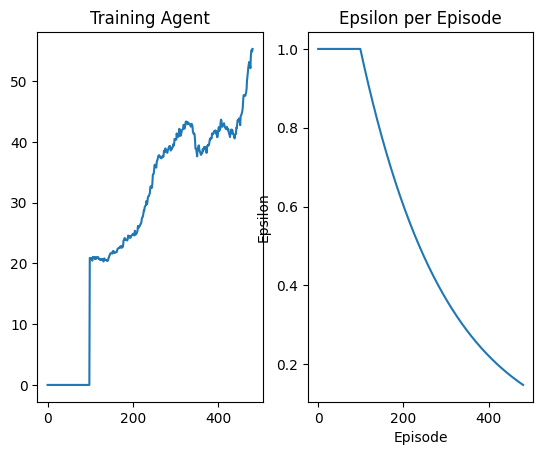

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 482 Duration 20 steps | epsilon 0.14703779644970727


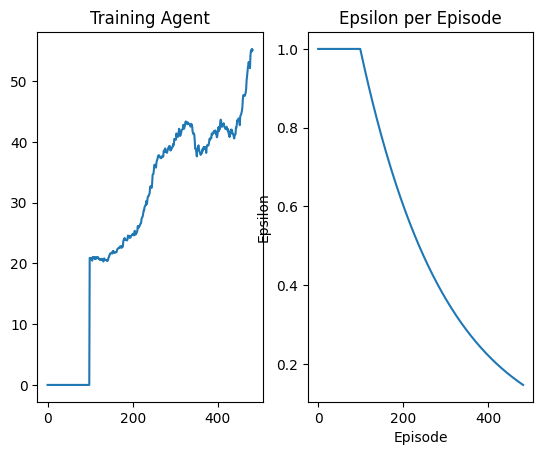

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 483 Duration 134 steps | epsilon 0.14630365332927953


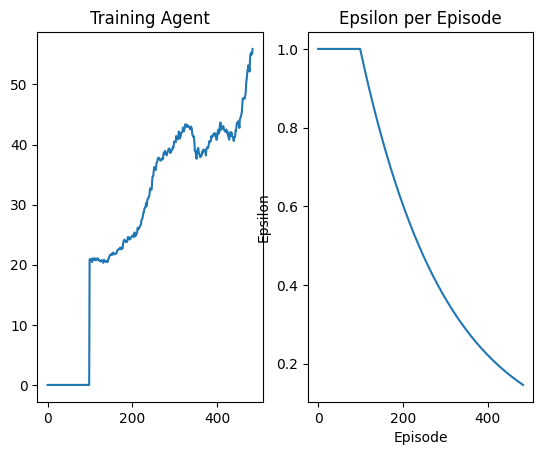

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 484 Duration 58 steps | epsilon 0.1455731757025839


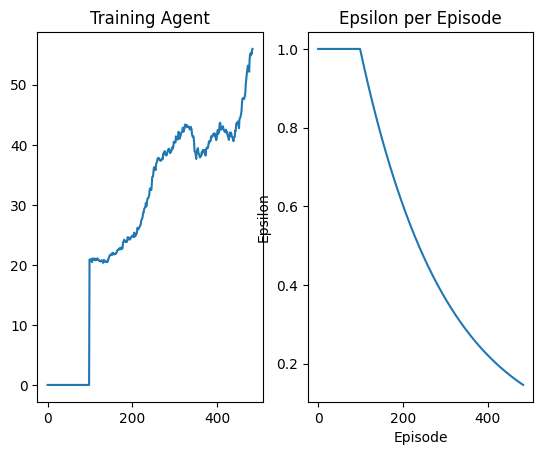

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 485 Duration 20 steps | epsilon 0.14484634526822396


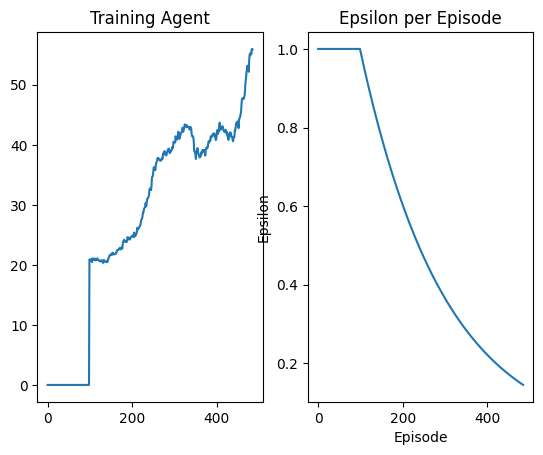

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 486 Duration 41 steps | epsilon 0.14412314381618002


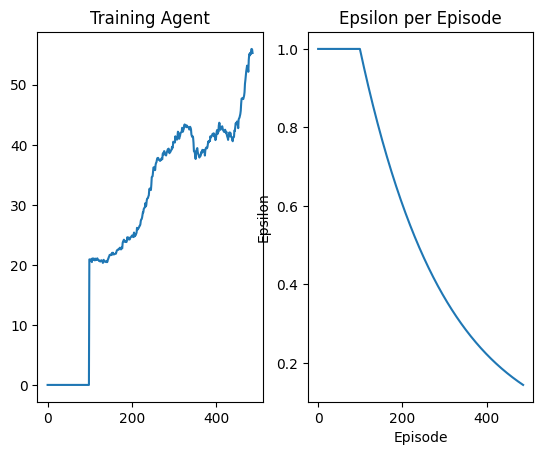

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 487 Duration 33 steps | epsilon 0.14340355322735304


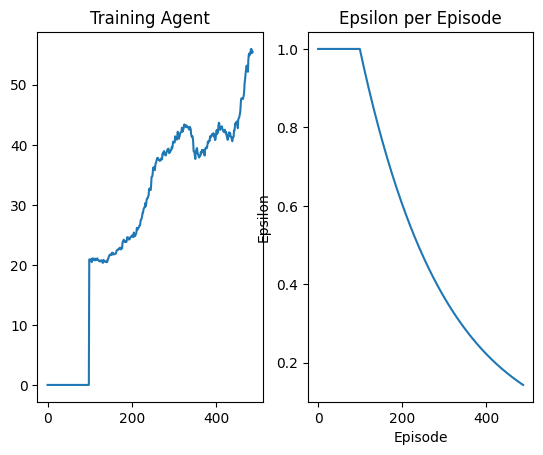

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 488 Duration 81 steps | epsilon 0.14268755547311054


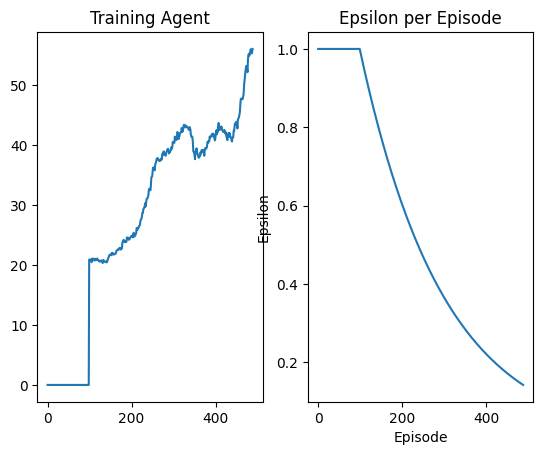

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 489 Duration 189 steps | epsilon 0.14197513261483502


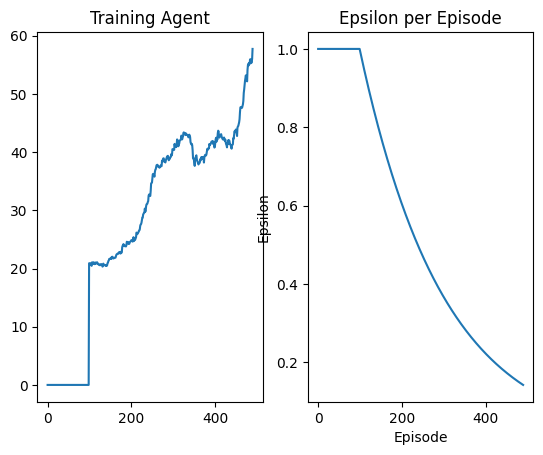

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 490 Duration 42 steps | epsilon 0.1412662668034744


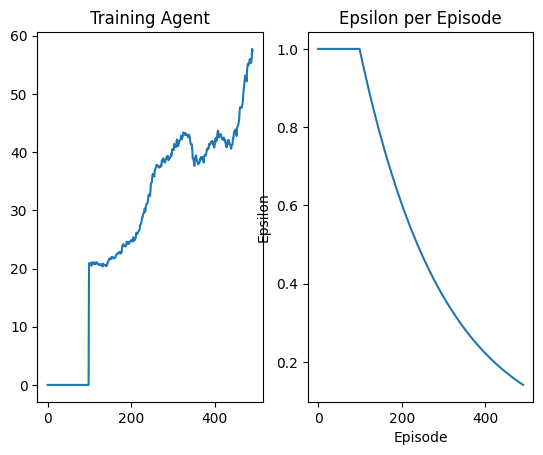

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 491 Duration 65 steps | epsilon 0.14056094027909496


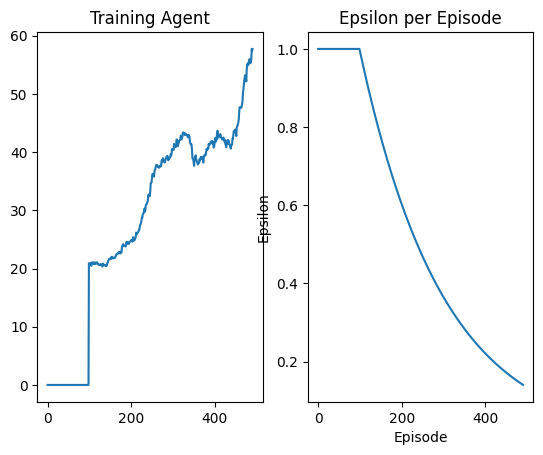

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 492 Duration 53 steps | epsilon 0.13985913537043634


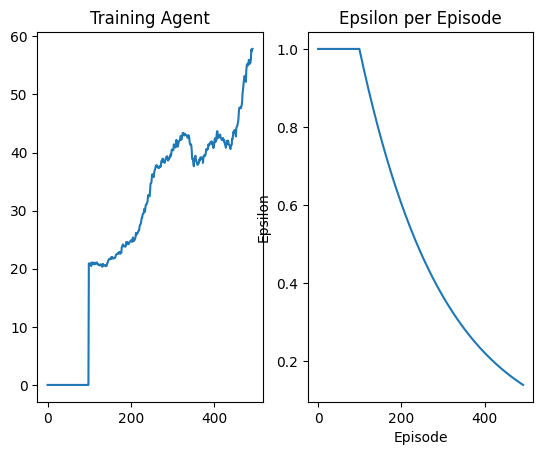

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 493 Duration 101 steps | epsilon 0.13916083449446873


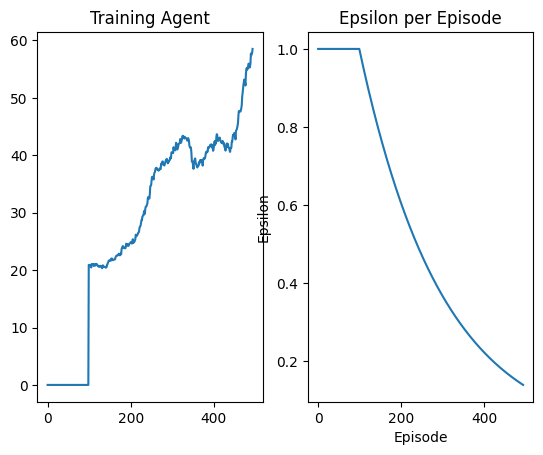

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 494 Duration 28 steps | epsilon 0.1384660201559524


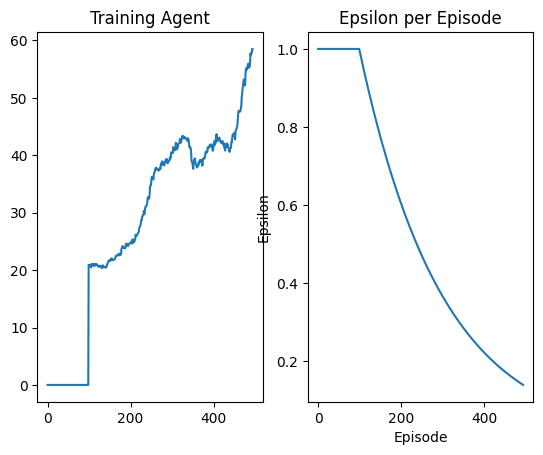

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 495 Duration 30 steps | epsilon 0.1377746749469995


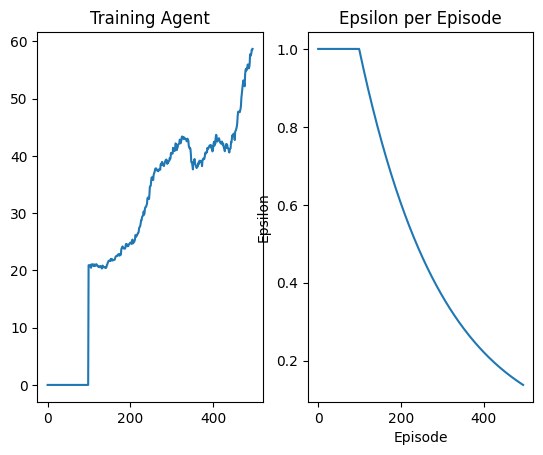

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 496 Duration 21 steps | epsilon 0.13708678154663761


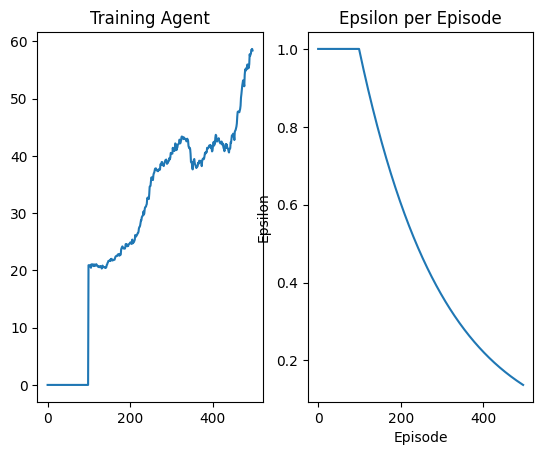

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 497 Duration 146 steps | epsilon 0.1364023227203761


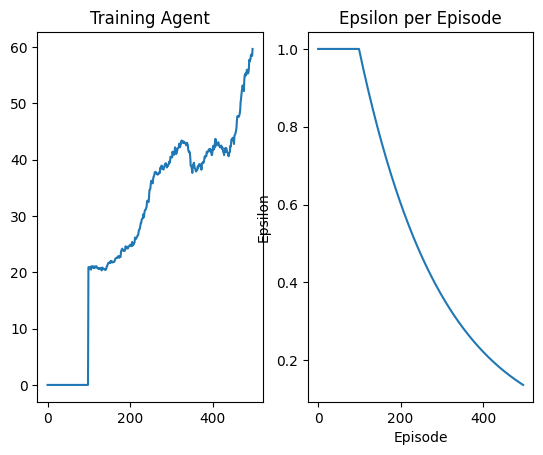

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 498 Duration 49 steps | epsilon 0.13572128131977418


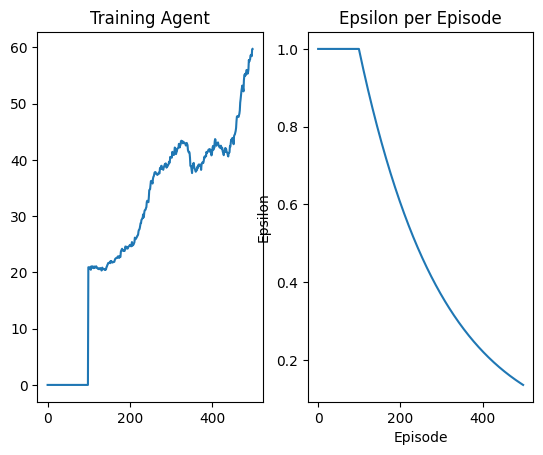

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 499 Duration 132 steps | epsilon 0.13504364028201127


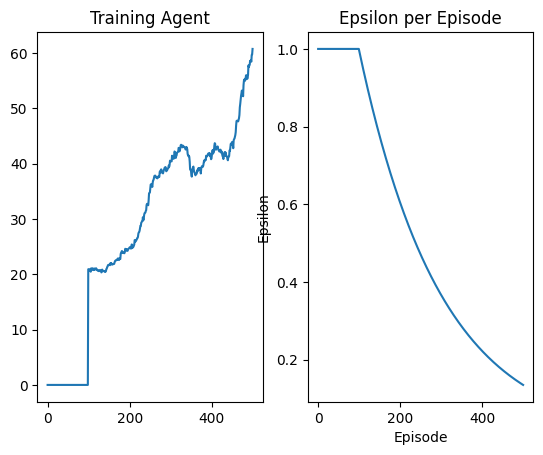

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 500 Duration 107 steps | epsilon 0.13436938262945955


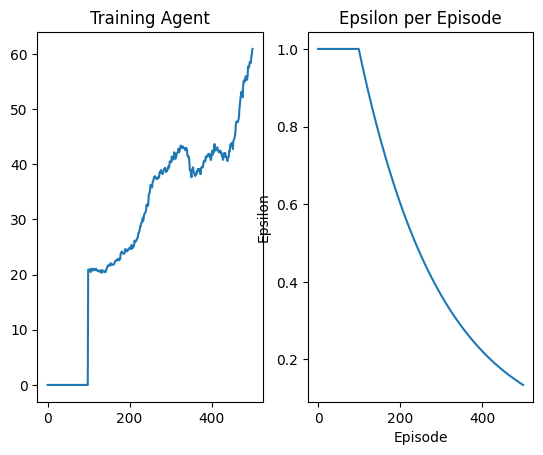

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 501 Duration 78 steps | epsilon 0.13369849146925855


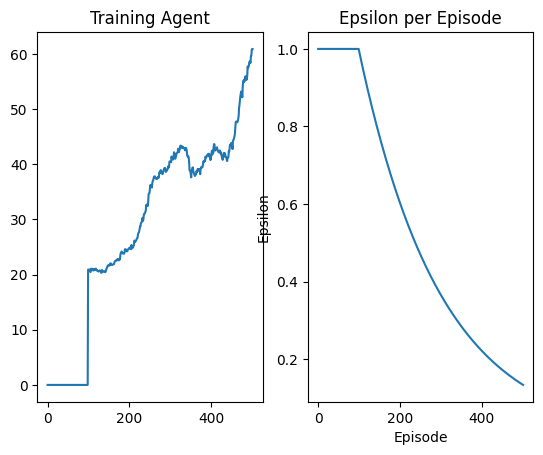

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 502 Duration 103 steps | epsilon 0.133030949992892


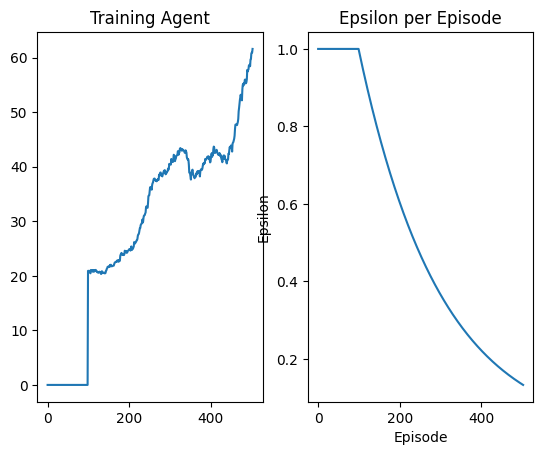

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 503 Duration 36 steps | epsilon 0.13236674147576658


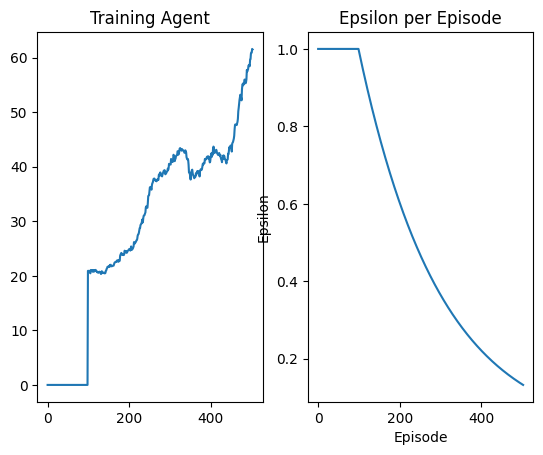

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 504 Duration 93 steps | epsilon 0.13170584927679302


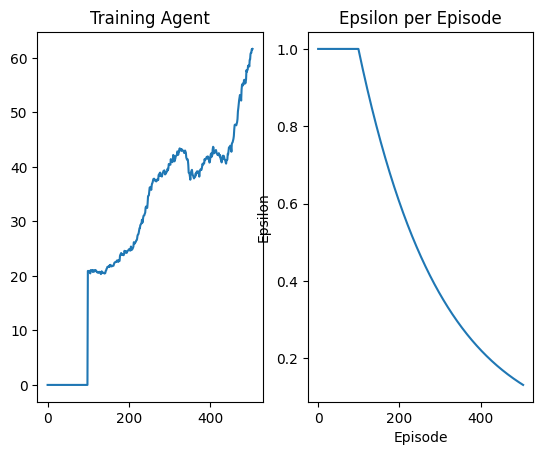

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 505 Duration 22 steps | epsilon 0.13104825683796914


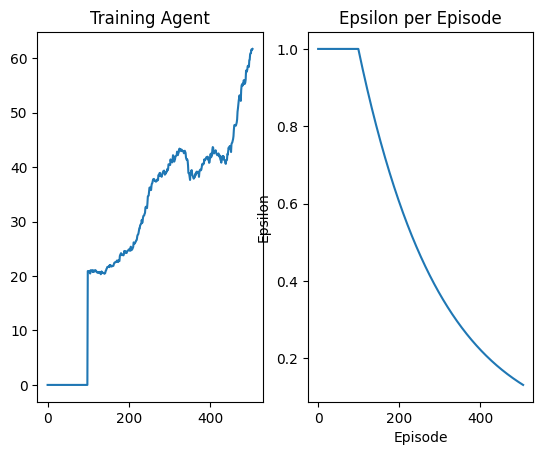

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 506 Duration 90 steps | epsilon 0.13039394768396498


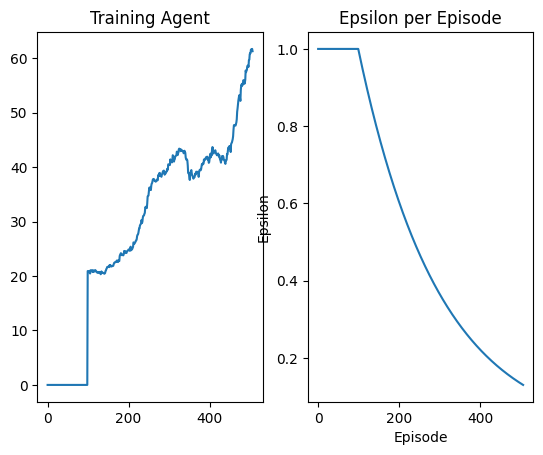

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 507 Duration 34 steps | epsilon 0.12974290542171005


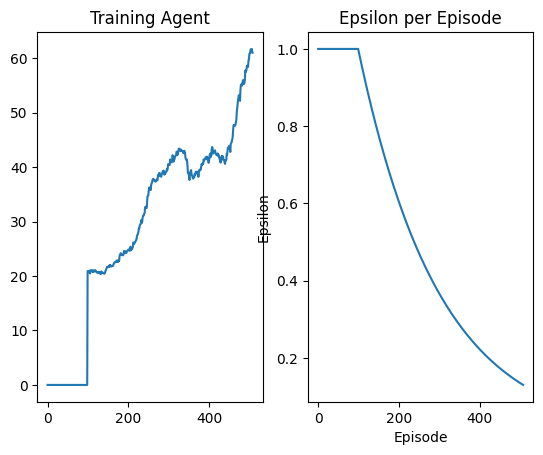

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 508 Duration 23 steps | epsilon 0.1290951137399826


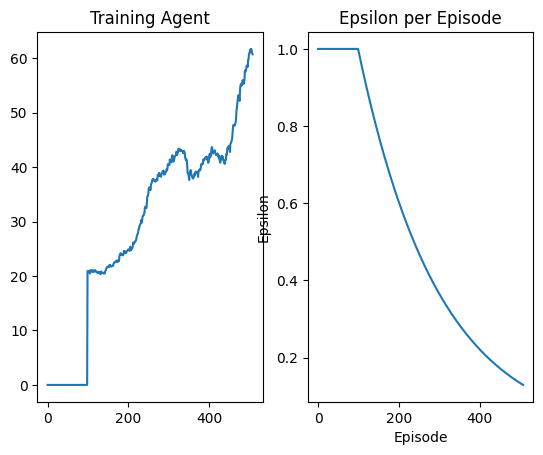

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 509 Duration 113 steps | epsilon 0.12845055640900094


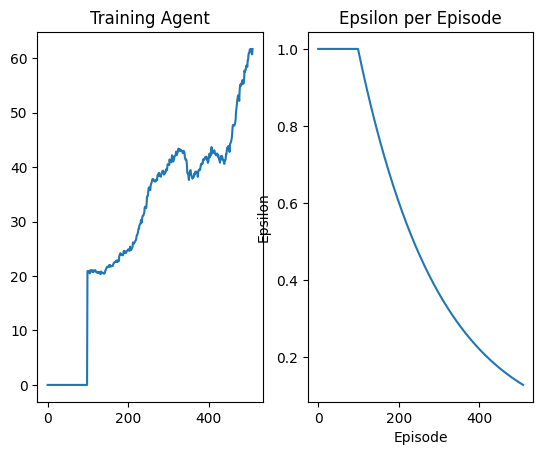

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 510 Duration 16 steps | epsilon 0.12780921728001693


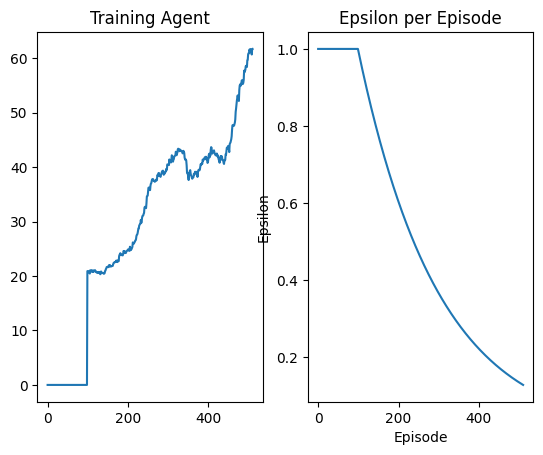

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 511 Duration 27 steps | epsilon 0.12717108028491123


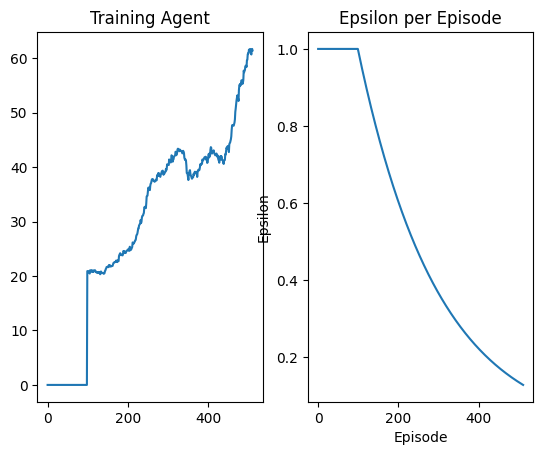

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 512 Duration 36 steps | epsilon 0.12653612943579085


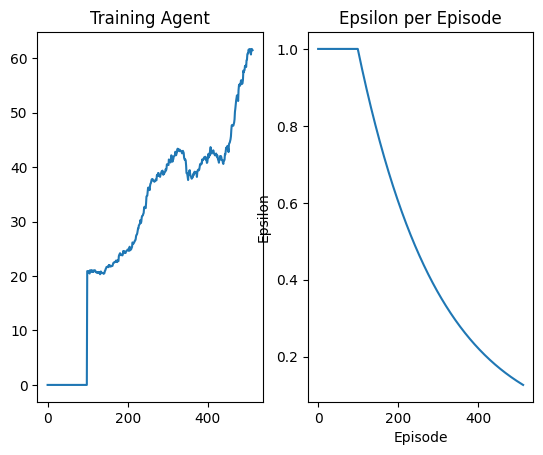

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 513 Duration 21 steps | epsilon 0.1259043488245885


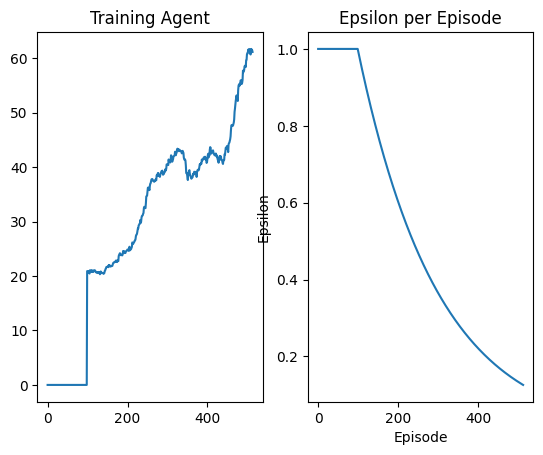

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 514 Duration 69 steps | epsilon 0.12527572262266415


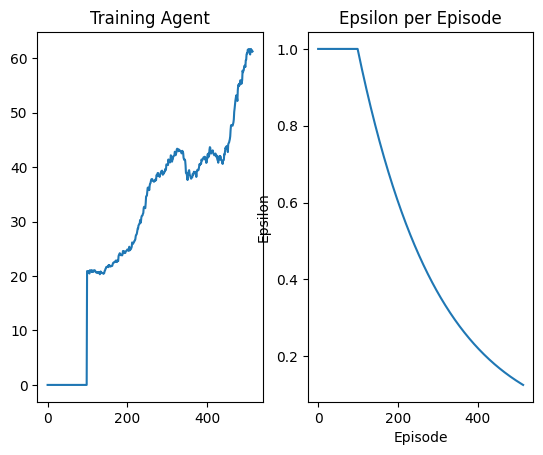

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 515 Duration 39 steps | epsilon 0.1246502350804083


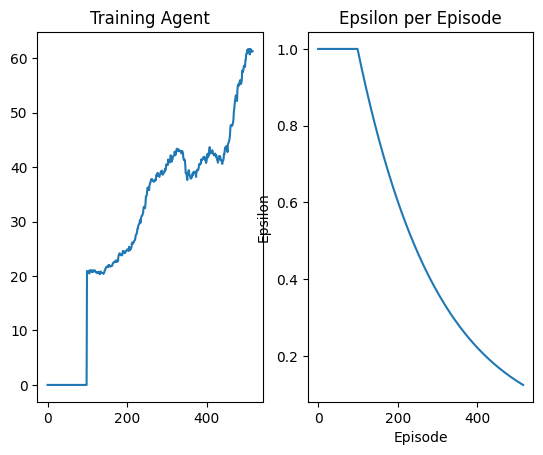

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 516 Duration 21 steps | epsilon 0.12402787052684752


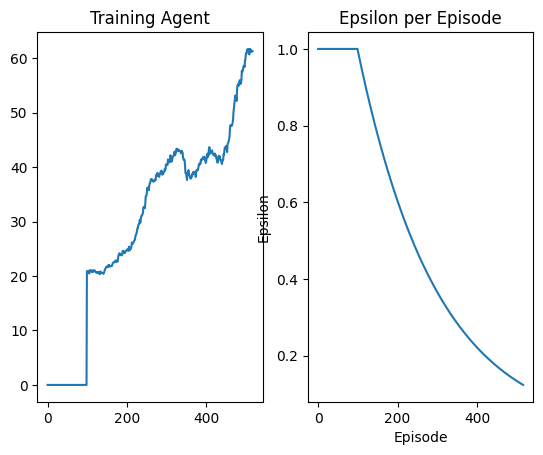

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 517 Duration 92 steps | epsilon 0.12340861336925177


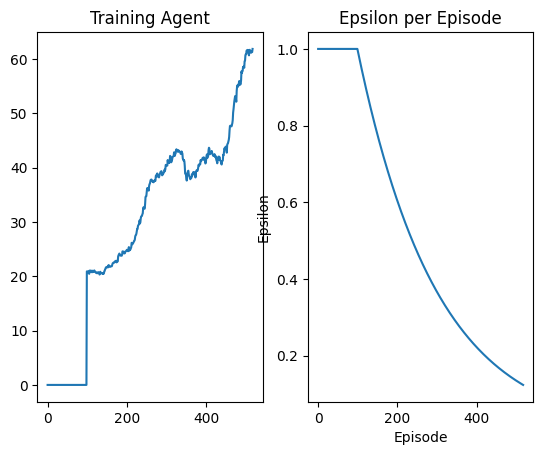

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 518 Duration 29 steps | epsilon 0.12279244809274376


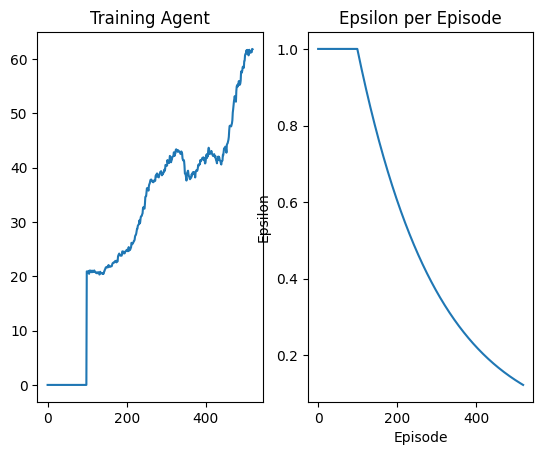

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 519 Duration 72 steps | epsilon 0.1221793592599102


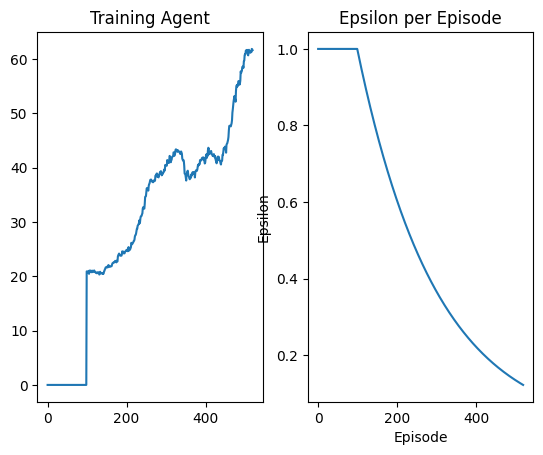

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 520 Duration 62 steps | epsilon 0.12156933151041512


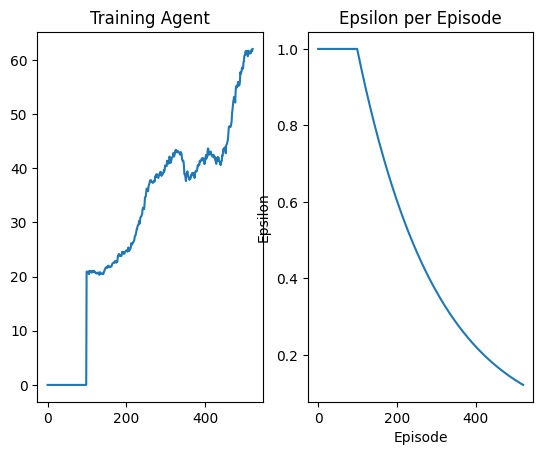

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 521 Duration 141 steps | epsilon 0.1209623495606149


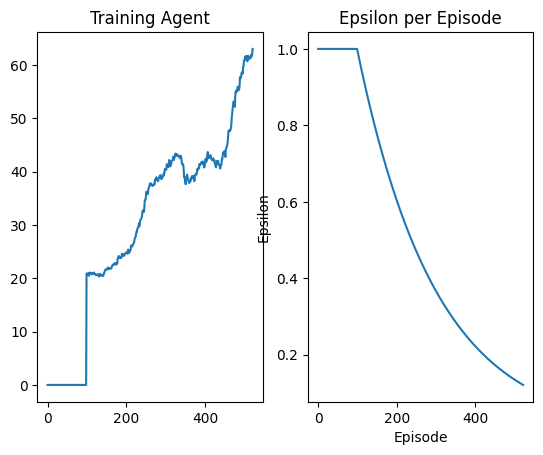

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 522 Duration 97 steps | epsilon 0.12035839820317548


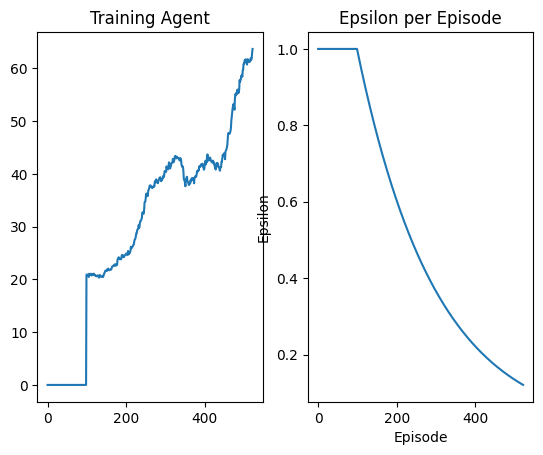

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 523 Duration 14 steps | epsilon 0.11975746230669129


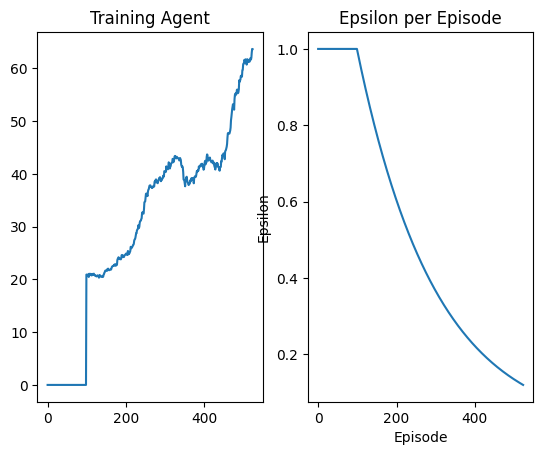

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 524 Duration 161 steps | epsilon 0.11915952681530616


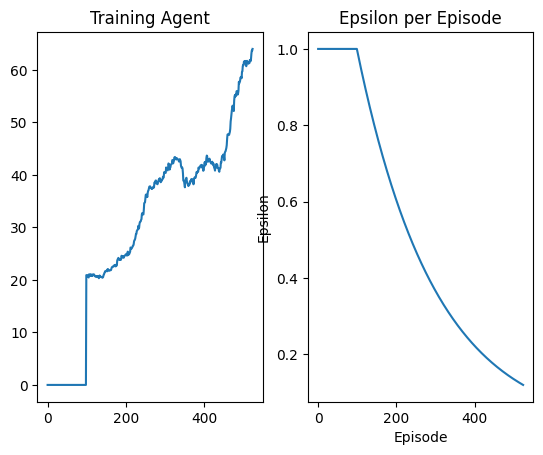

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 525 Duration 15 steps | epsilon 0.1185645767483361


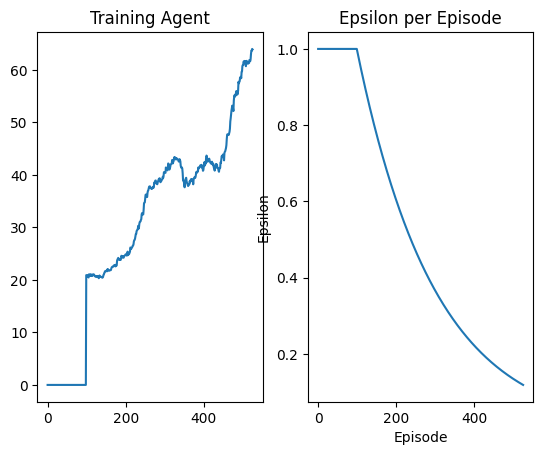

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 526 Duration 74 steps | epsilon 0.11797259719989402


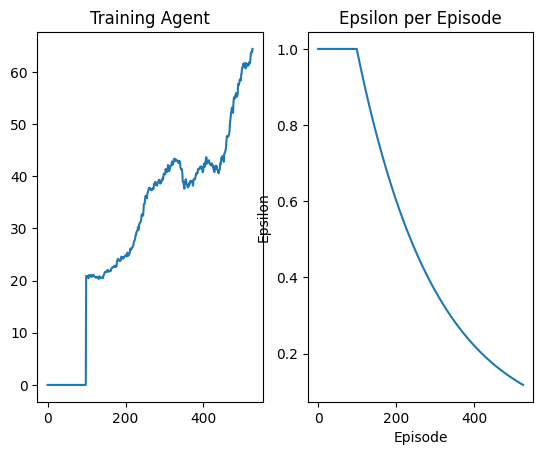

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 527 Duration 52 steps | epsilon 0.11738357333851618


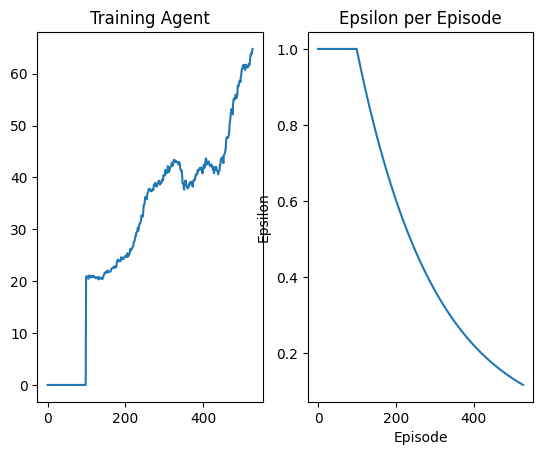

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 528 Duration 68 steps | epsilon 0.11679749040679072


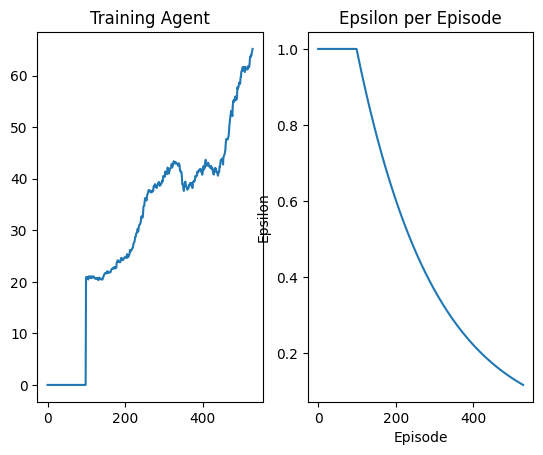

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 529 Duration 36 steps | epsilon 0.11621433372098783


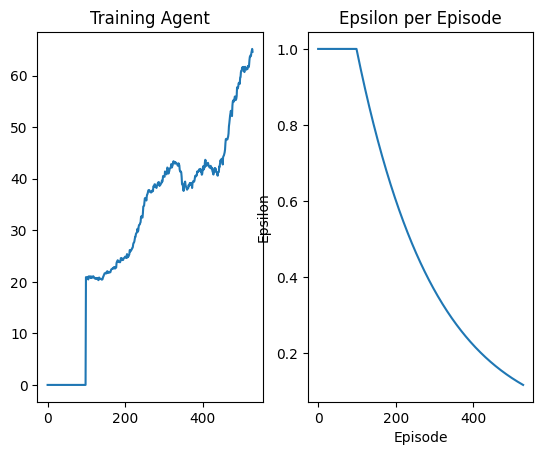

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 530 Duration 89 steps | epsilon 0.11563408867069194


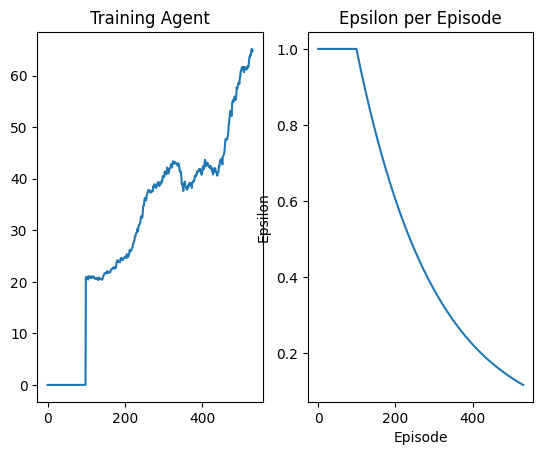

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 531 Duration 29 steps | epsilon 0.11505674071843562


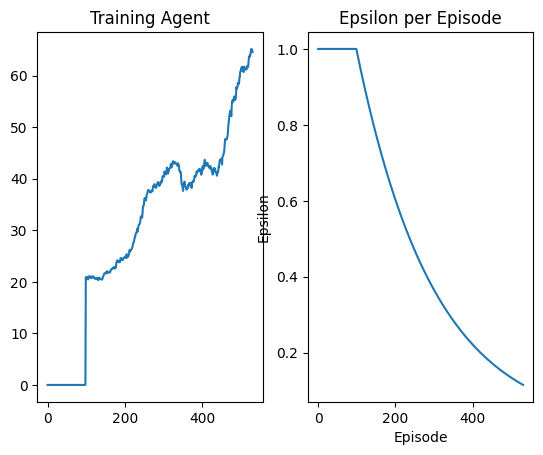

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 532 Duration 31 steps | epsilon 0.11448227539933538


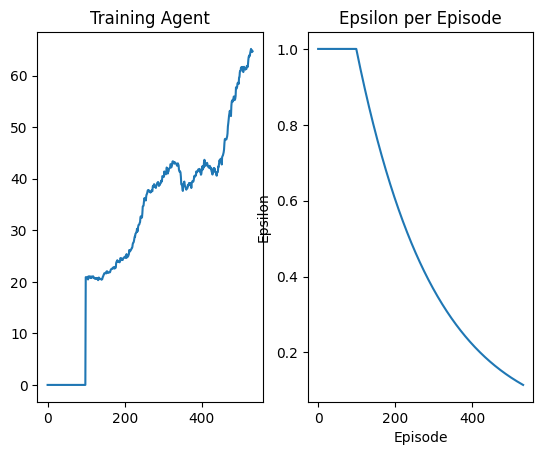

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 533 Duration 119 steps | epsilon 0.11391067832072924


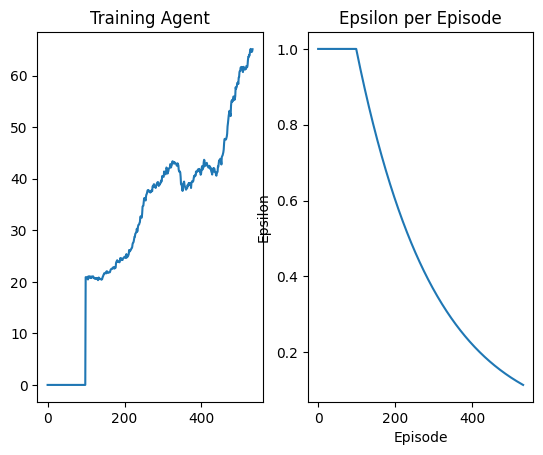

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 534 Duration 154 steps | epsilon 0.11334193516181618


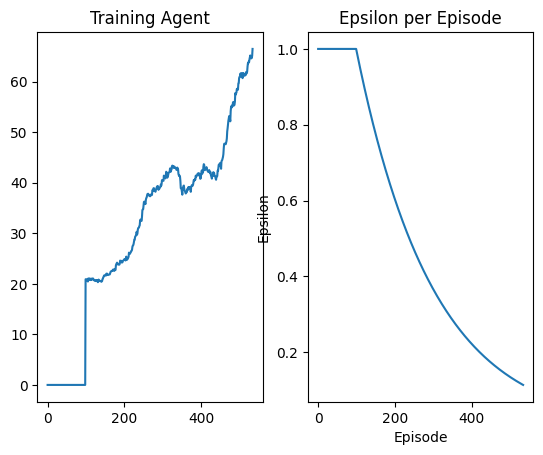

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 535 Duration 103 steps | epsilon 0.11277603167329732


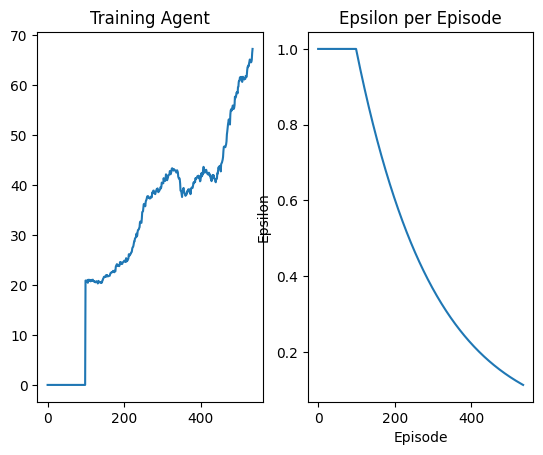

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 536 Duration 93 steps | epsilon 0.11221295367701892


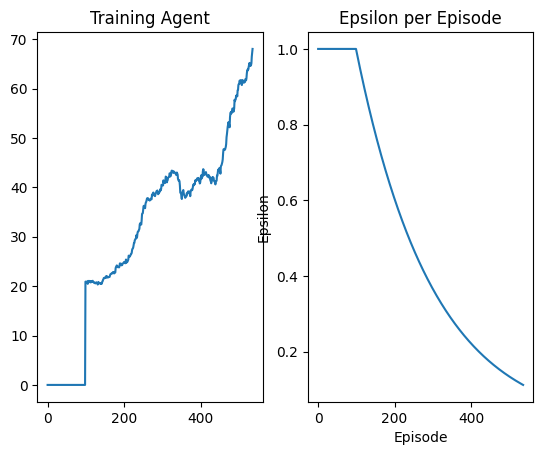

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 537 Duration 131 steps | epsilon 0.11165268706561715


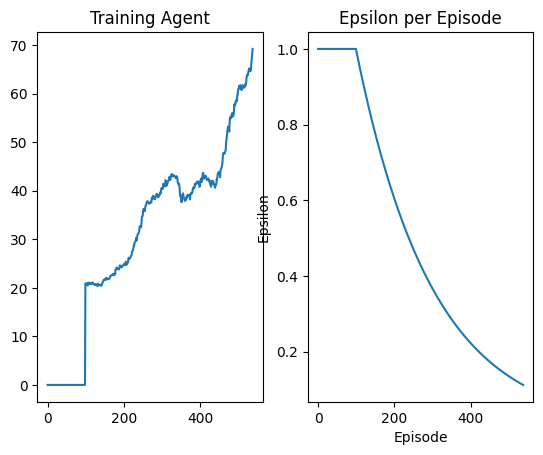

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 538 Duration 105 steps | epsilon 0.11109521780216466


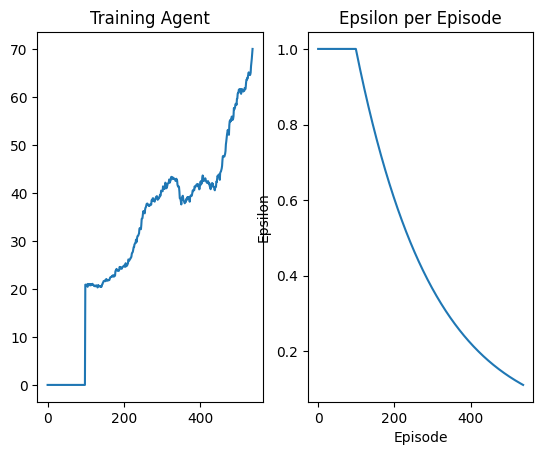

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 539 Duration 165 steps | epsilon 0.11054053191981891


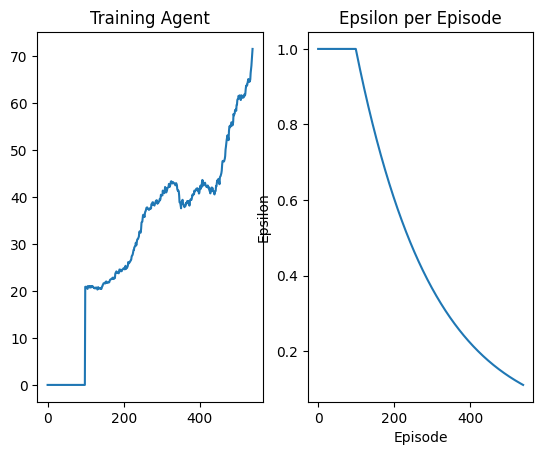

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 540 Duration 111 steps | epsilon 0.10998861552147221


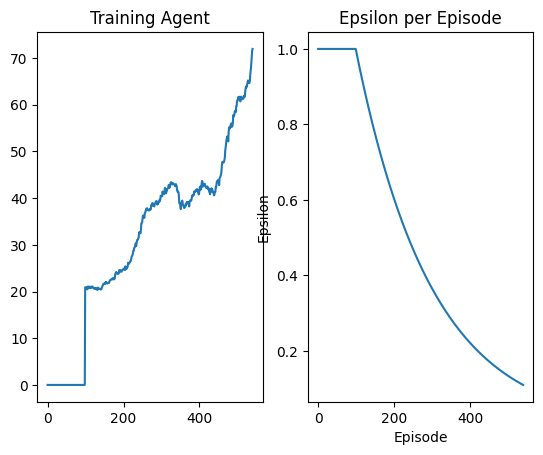

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 541 Duration 153 steps | epsilon 0.10943945477940356


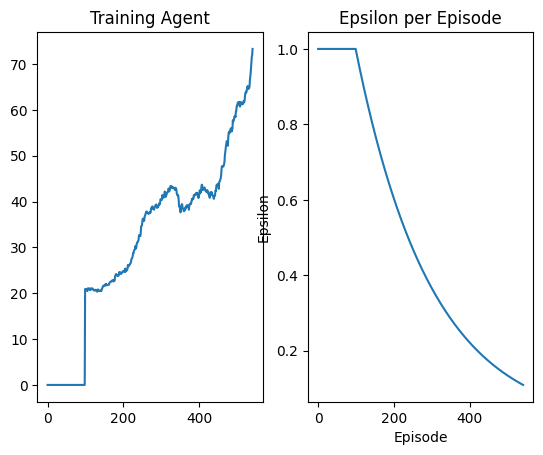

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 542 Duration 27 steps | epsilon 0.10889303593493221


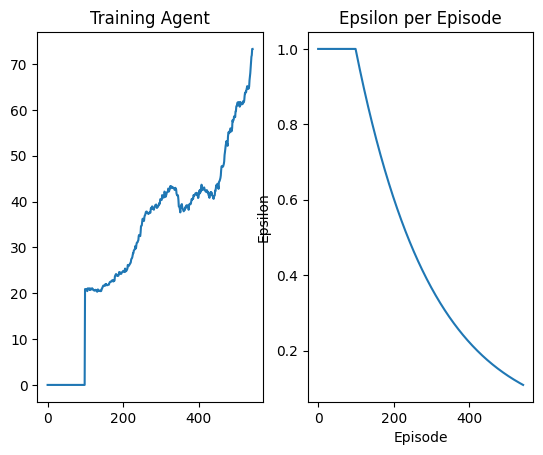

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 543 Duration 97 steps | epsilon 0.10834934529807297


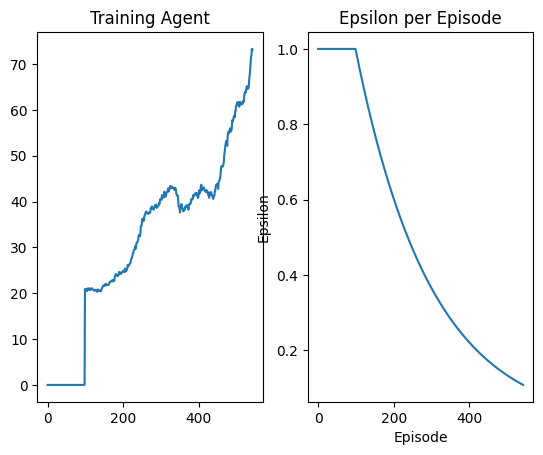

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 544 Duration 58 steps | epsilon 0.10780836924719317


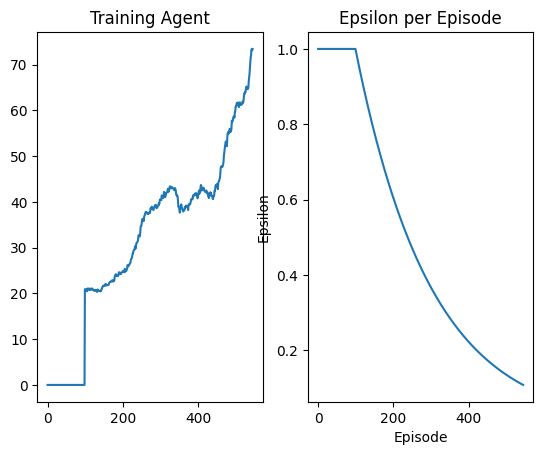

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 545 Duration 162 steps | epsilon 0.10727009422867144


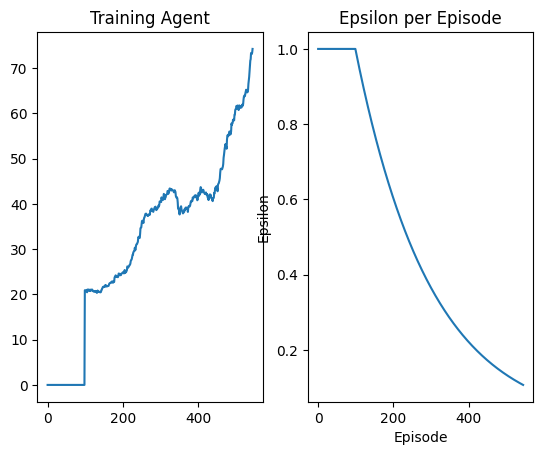

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 546 Duration 275 steps | epsilon 0.1067345067565581


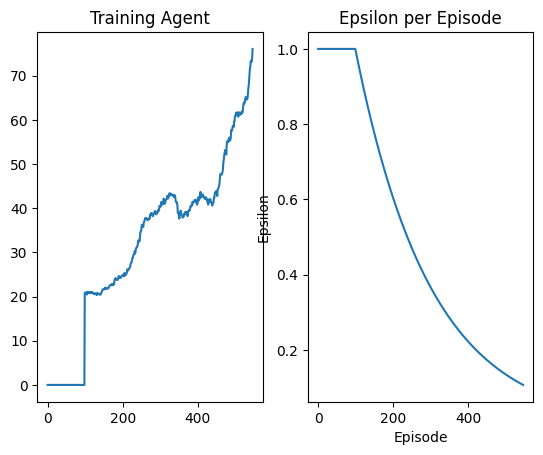

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 547 Duration 70 steps | epsilon 0.1062015934122373


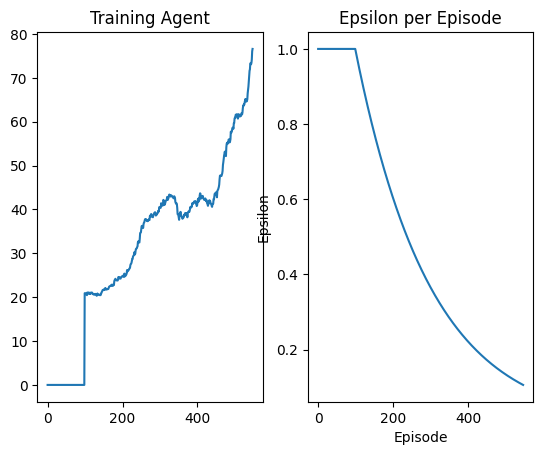

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 548 Duration 106 steps | epsilon 0.1056713408440908


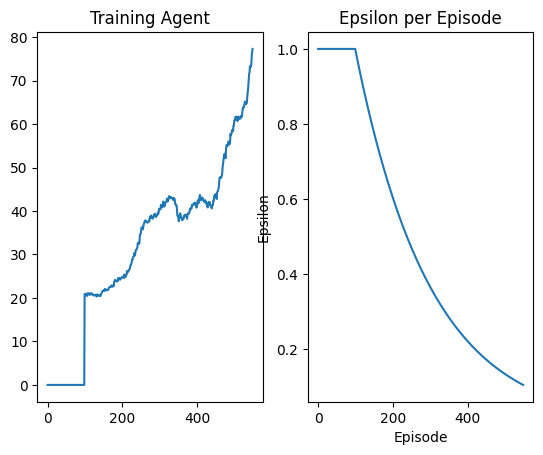

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 549 Duration 21 steps | epsilon 0.10514373576716353


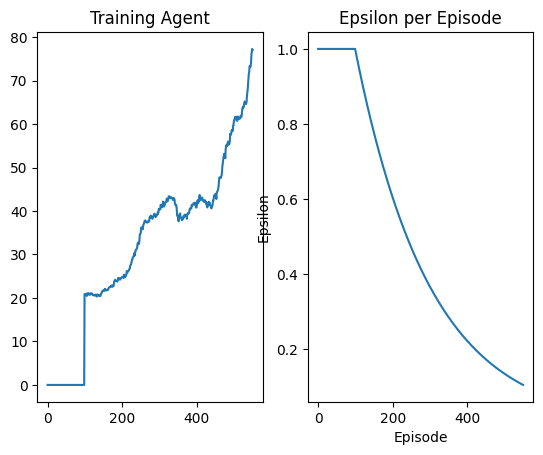

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 550 Duration 114 steps | epsilon 0.10461876496283067


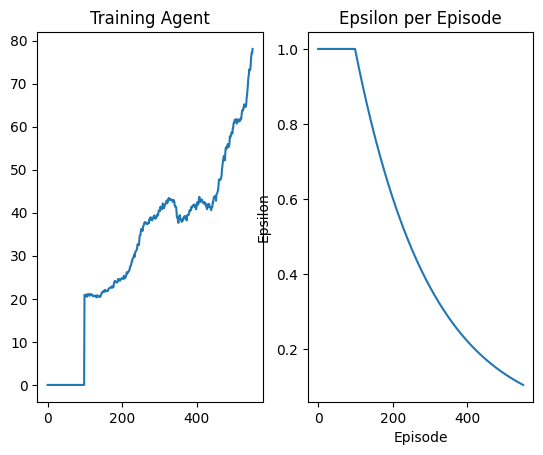

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 551 Duration 68 steps | epsilon 0.10409641527846648


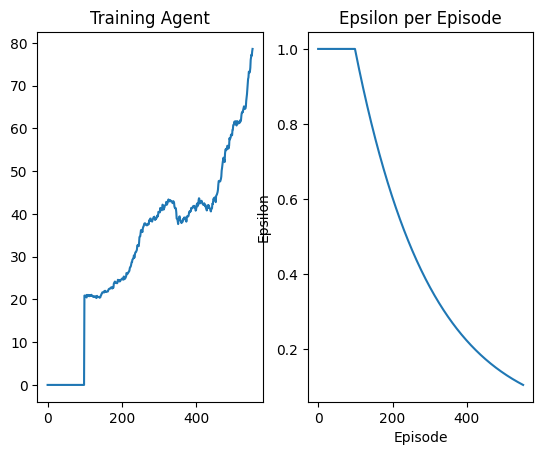

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 552 Duration 58 steps | epsilon 0.10357667362711485


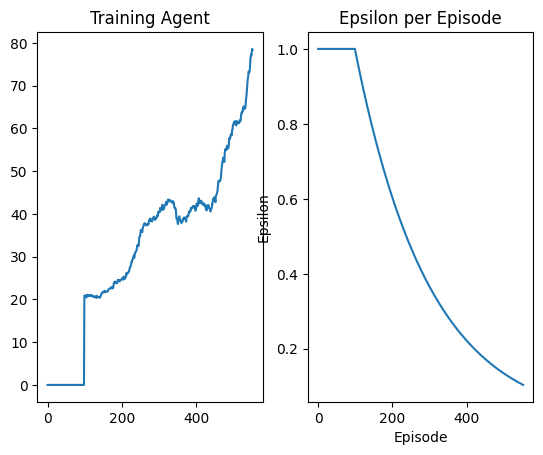

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 553 Duration 146 steps | epsilon 0.10305952698716134


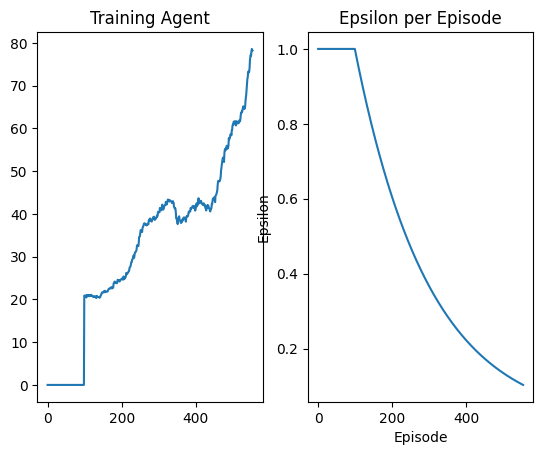

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 554 Duration 260 steps | epsilon 0.10254496240200693


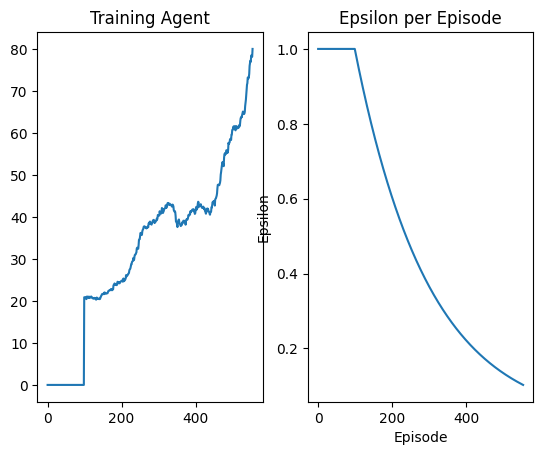

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 555 Duration 312 steps | epsilon 0.10203296697974348


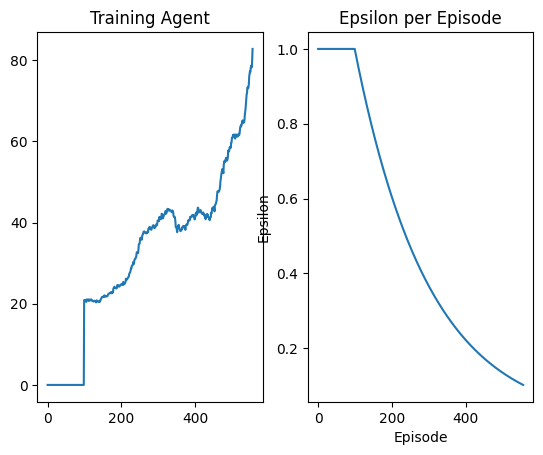

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 556 Duration 11 steps | epsilon 0.10152352789283067


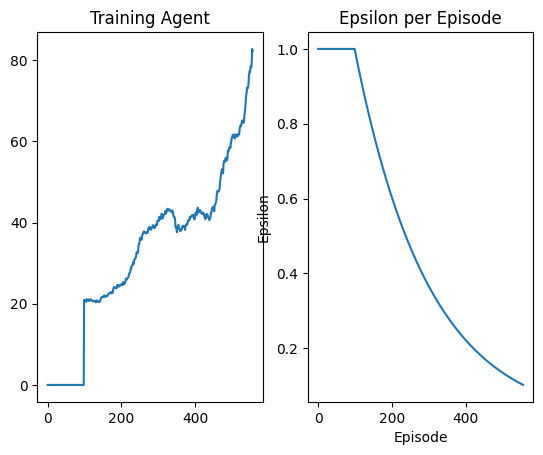

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 557 Duration 85 steps | epsilon 0.10101663237777465


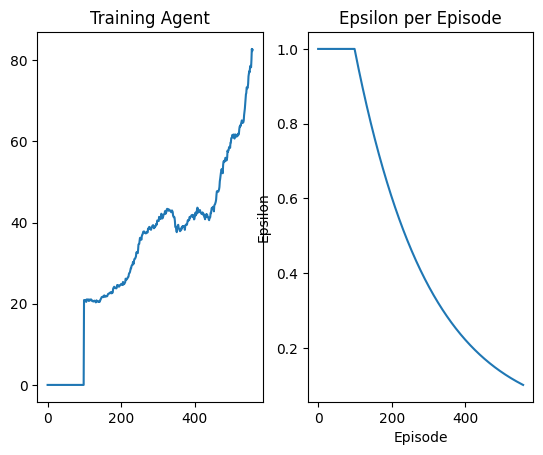

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 558 Duration 65 steps | epsilon 0.10051226773480826


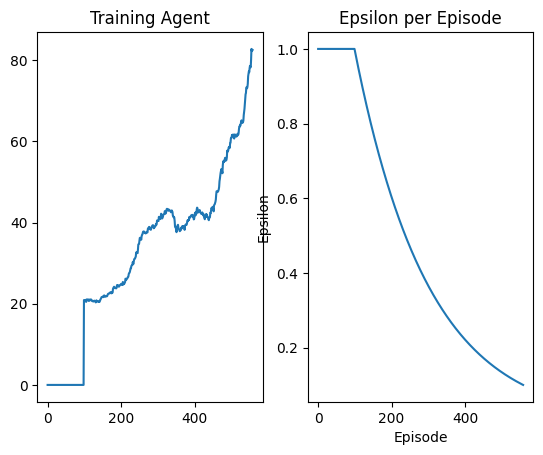

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 559 Duration 218 steps | epsilon 0.10001042132757282


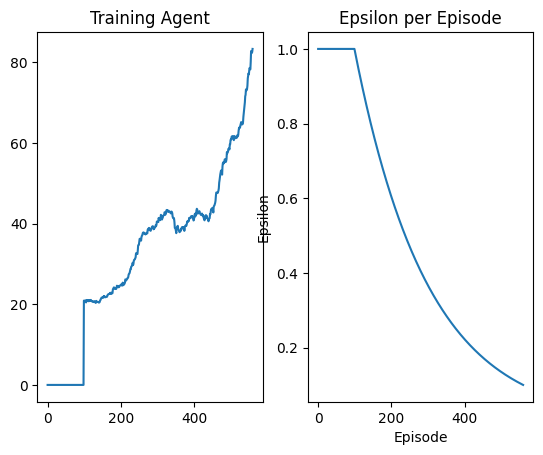

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 560 Duration 22 steps | epsilon 0.09951108058280159


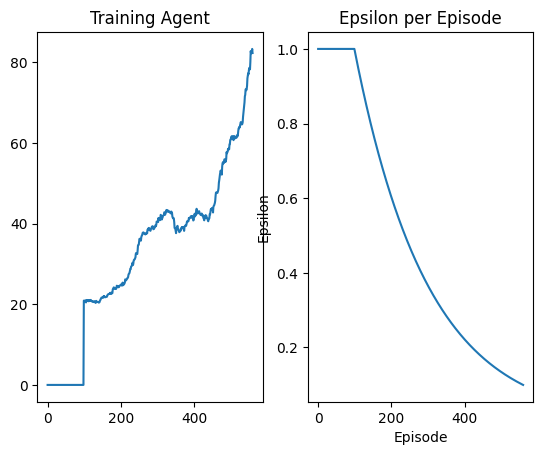

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 561 Duration 111 steps | epsilon 0.09901423299000471


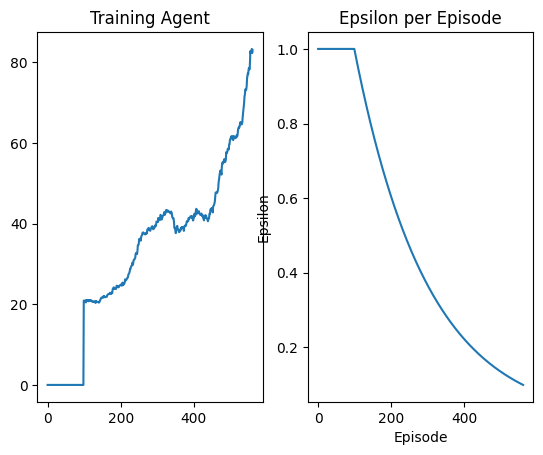

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 562 Duration 32 steps | epsilon 0.09851986610115579


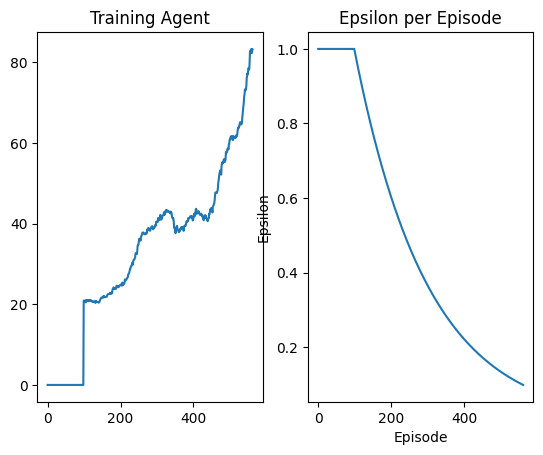

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 563 Duration 44 steps | epsilon 0.09802796753038004


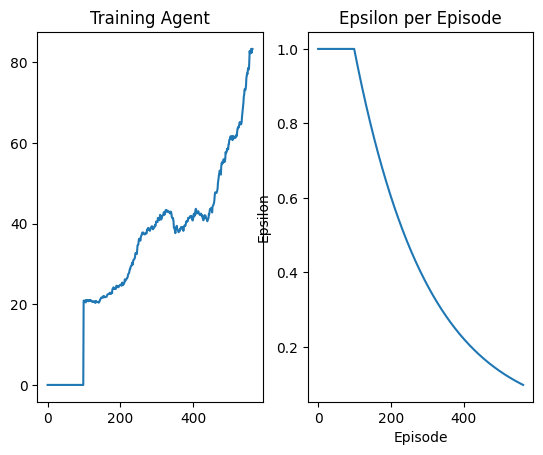

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 564 Duration 43 steps | epsilon 0.09753852495364394


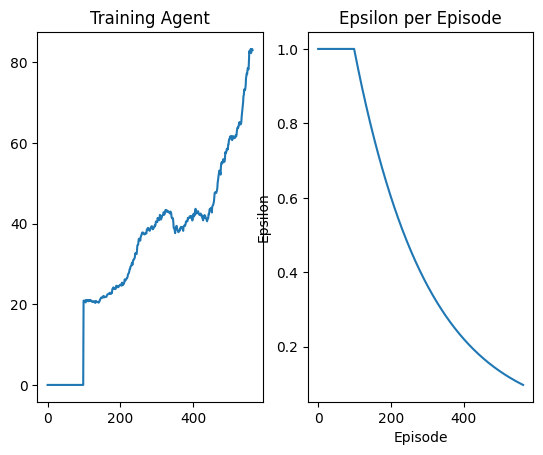

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 565 Duration 208 steps | epsilon 0.09705152610844647


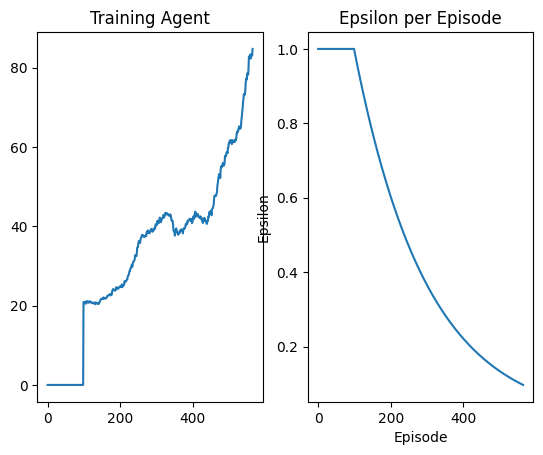

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 566 Duration 124 steps | epsilon 0.0965669587935119


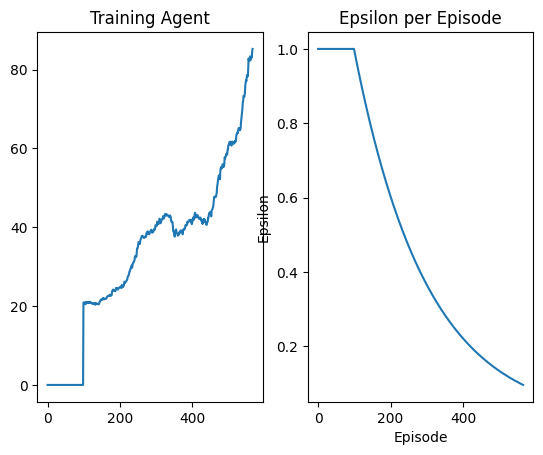

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 567 Duration 60 steps | epsilon 0.09608481086848411


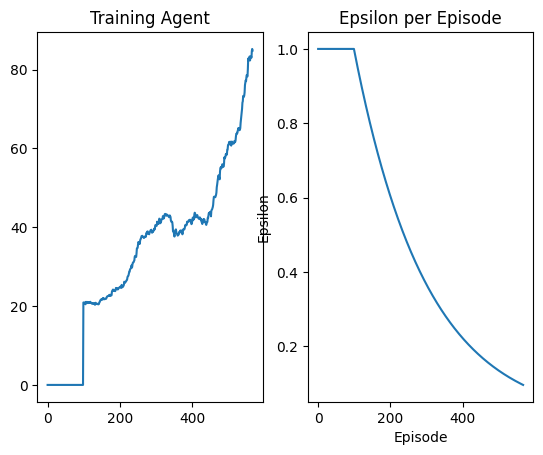

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 568 Duration 103 steps | epsilon 0.09560507025362236


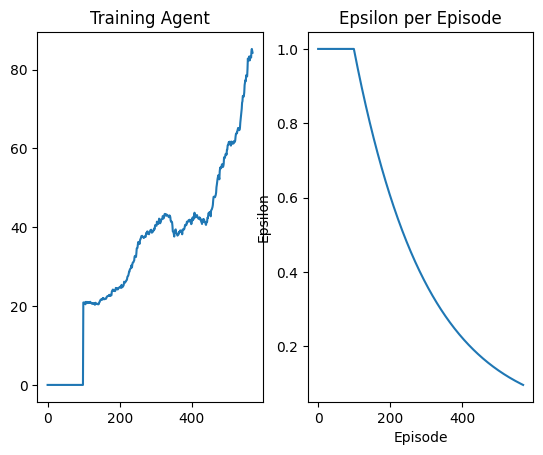

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 569 Duration 74 steps | epsilon 0.09512772492949874


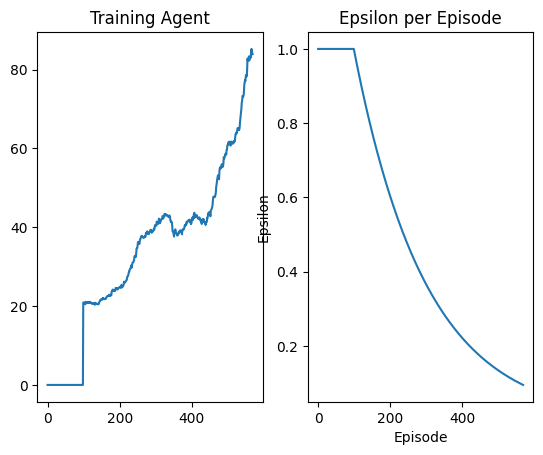

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 570 Duration 166 steps | epsilon 0.09465276293669697


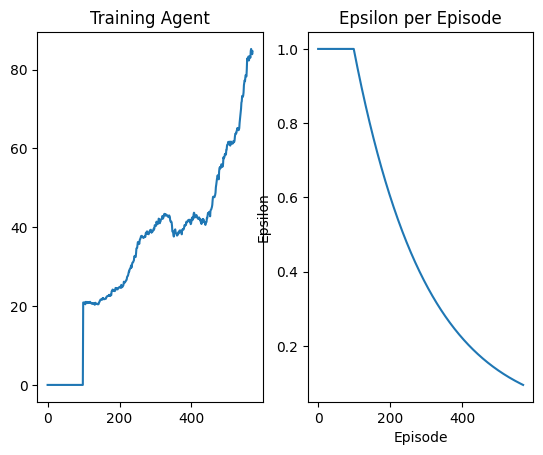

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 571 Duration 118 steps | epsilon 0.09418017237551278


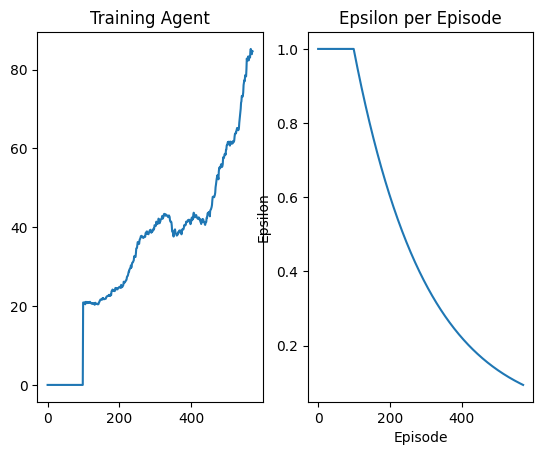

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 572 Duration 14 steps | epsilon 0.09370994140565578


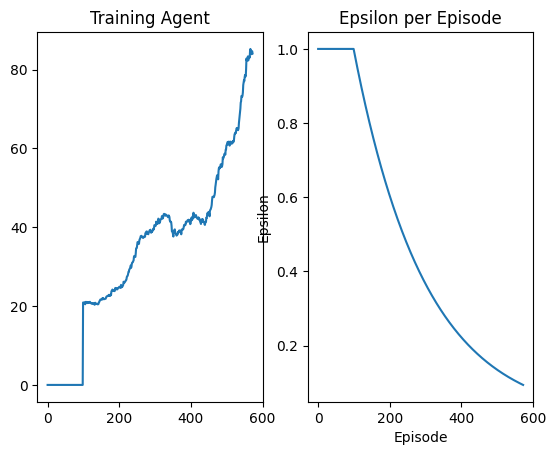

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 573 Duration 103 steps | epsilon 0.09324205824595282


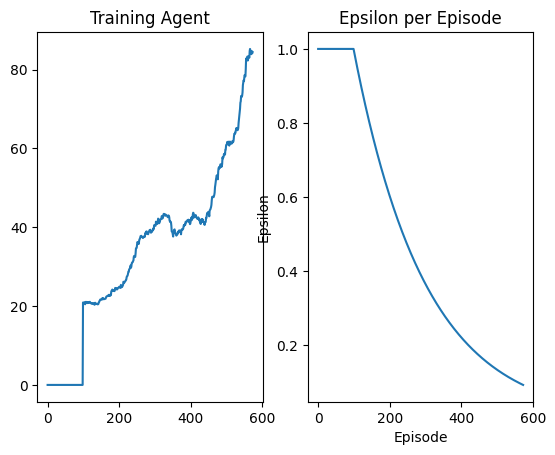

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 574 Duration 74 steps | epsilon 0.09277651117405282


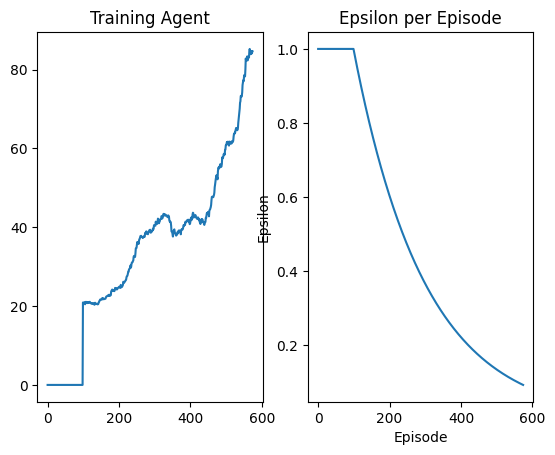

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 575 Duration 174 steps | epsilon 0.09231328852613307


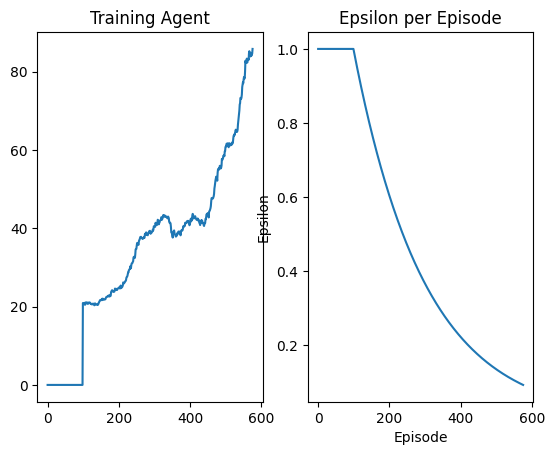

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 576 Duration 163 steps | epsilon 0.09185237869660702


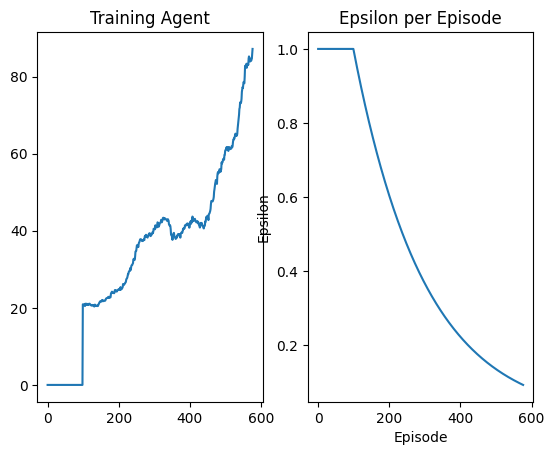

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 577 Duration 143 steps | epsilon 0.09139377013783348


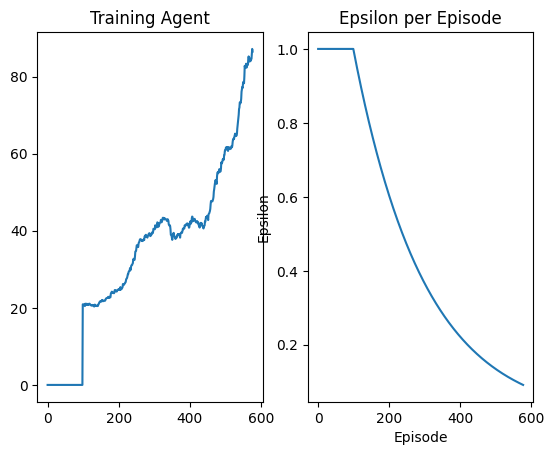

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 578 Duration 303 steps | epsilon 0.09093745135982735


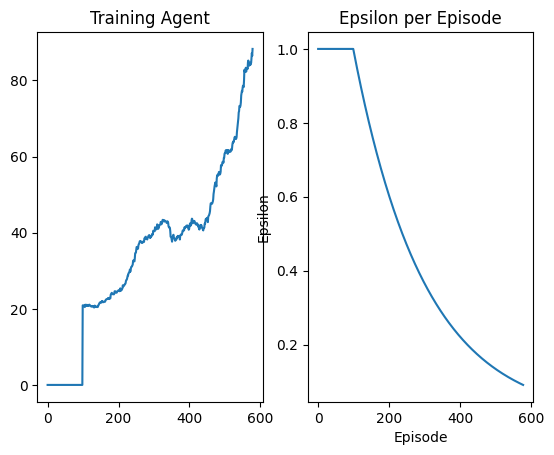

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 579 Duration 500 steps | epsilon 0.09048341092997172


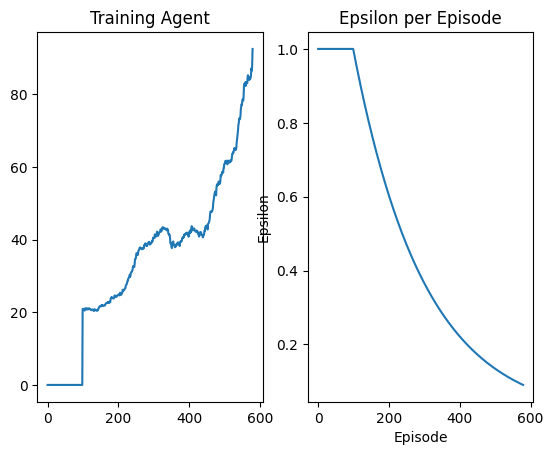

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 580 Duration 240 steps | epsilon 0.09003163747273145


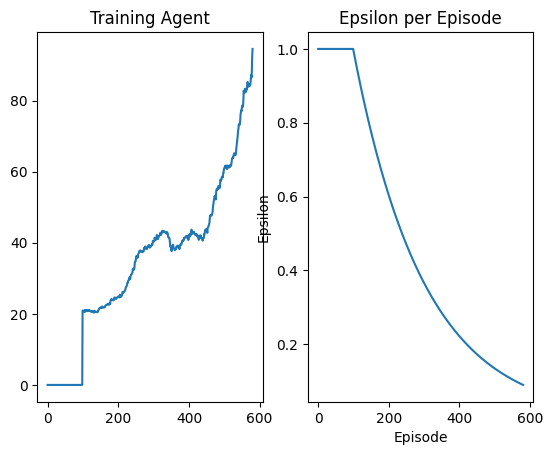

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 581 Duration 96 steps | epsilon 0.08958211966936816


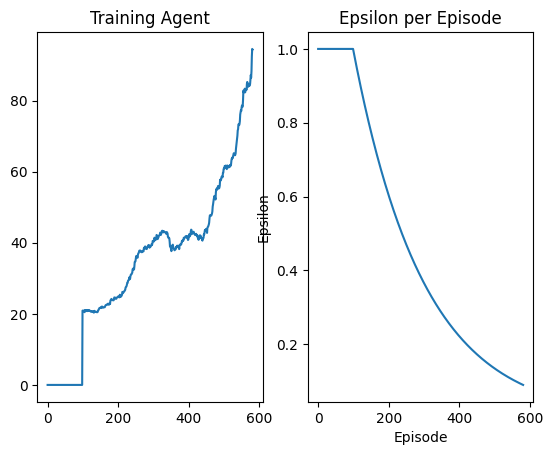

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 582 Duration 12 steps | epsilon 0.08913484625765666


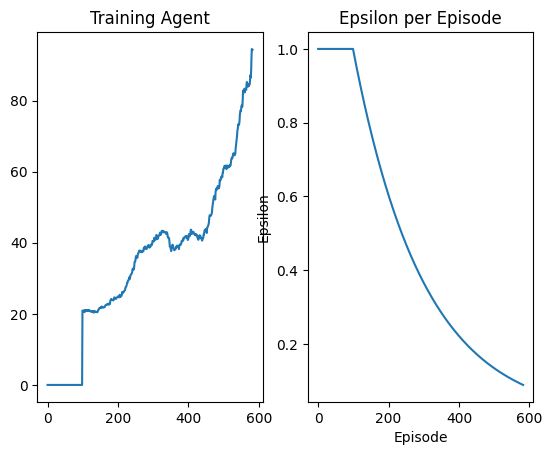

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 583 Duration 33 steps | epsilon 0.08868980603160277


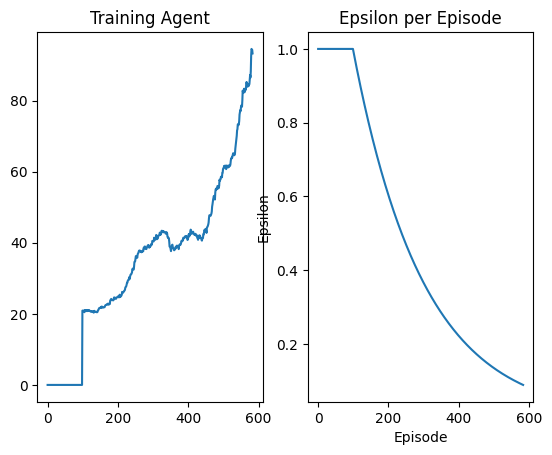

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 584 Duration 66 steps | epsilon 0.08824698784116258


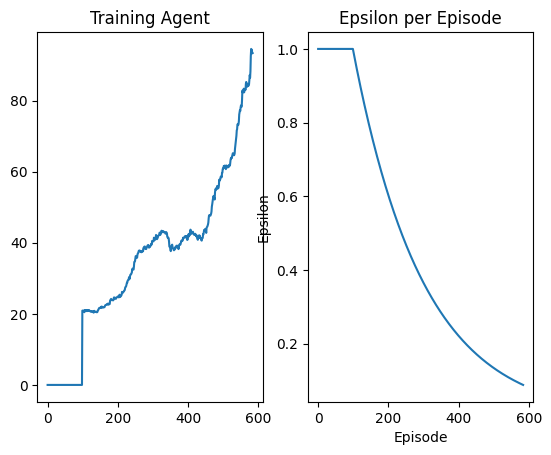

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 585 Duration 13 steps | epsilon 0.08780638059196309


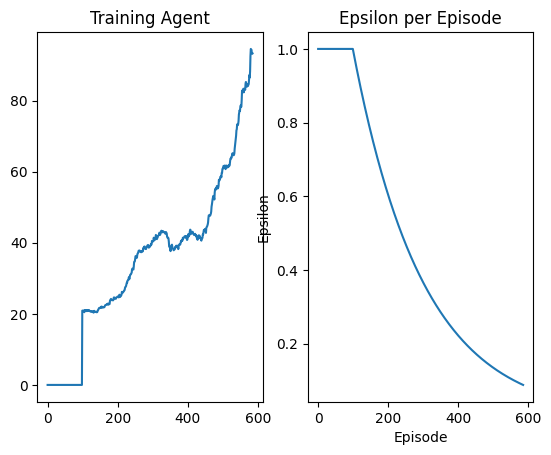

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 586 Duration 98 steps | epsilon 0.08736797324502425


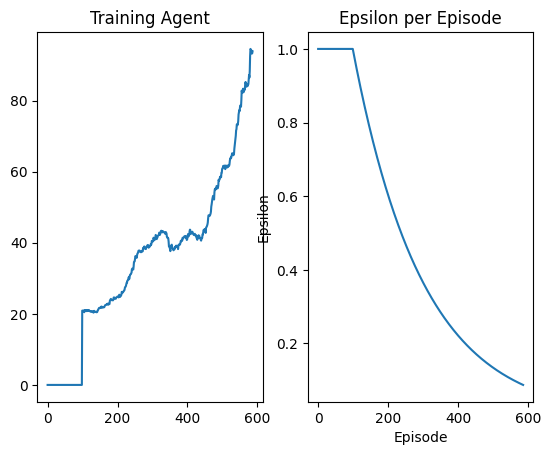

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 587 Duration 170 steps | epsilon 0.08693175481648238


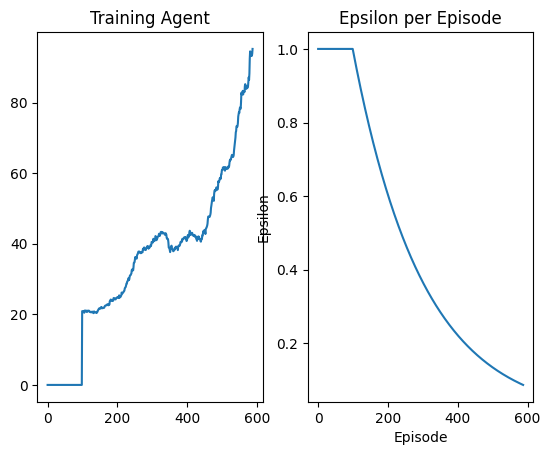

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 588 Duration 76 steps | epsilon 0.08649771437731502


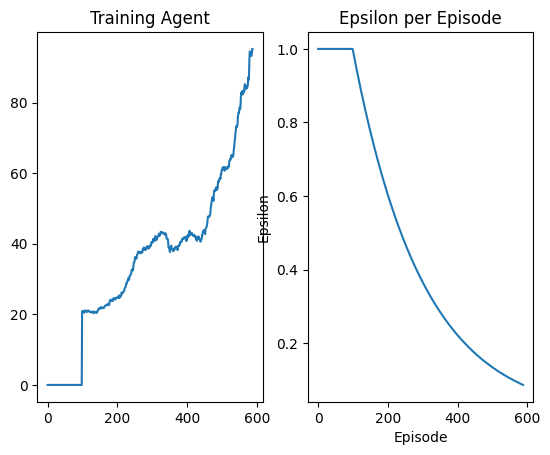

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 589 Duration 93 steps | epsilon 0.08606584105306705


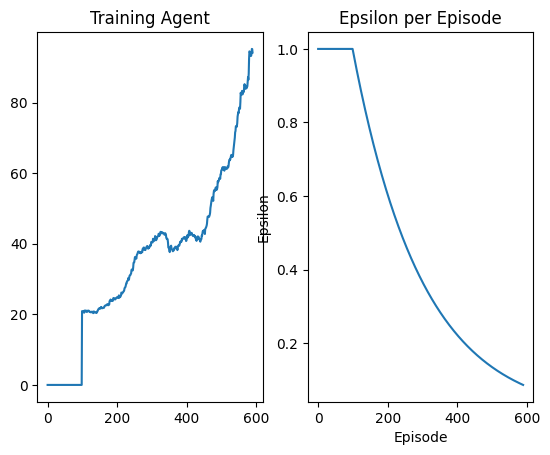

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 590 Duration 141 steps | epsilon 0.08563612402357833


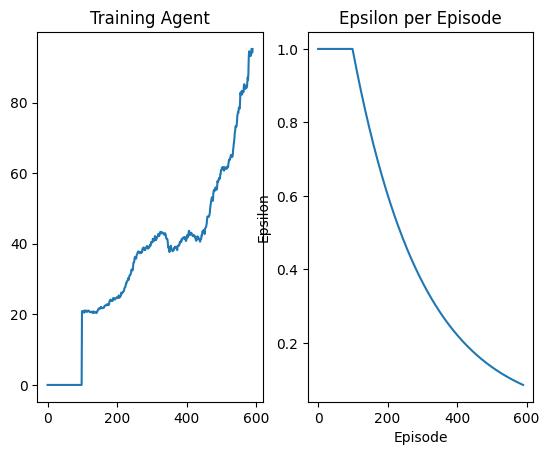

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 591 Duration 144 steps | epsilon 0.08520855252271249


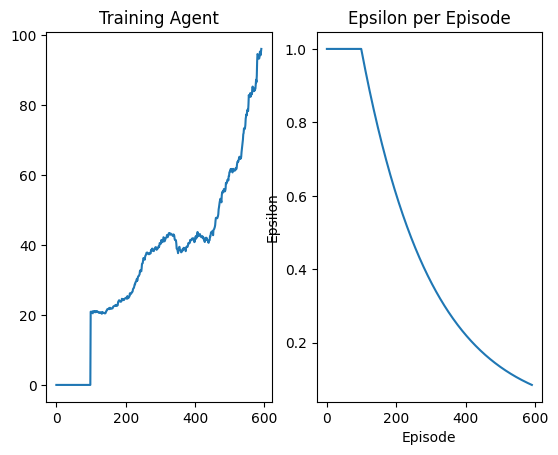

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 592 Duration 152 steps | epsilon 0.08478311583808731


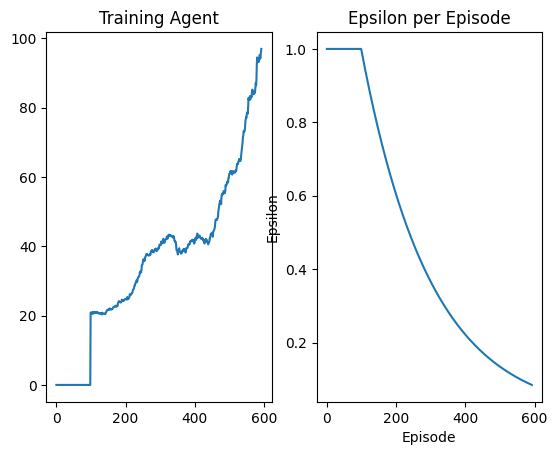

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 593 Duration 86 steps | epsilon 0.08435980331080628


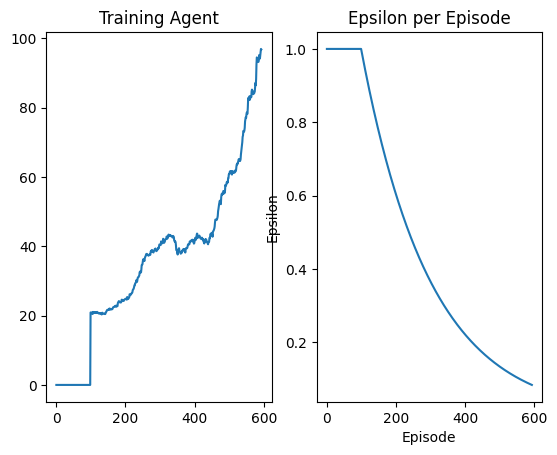

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 594 Duration 40 steps | epsilon 0.08393860433519154


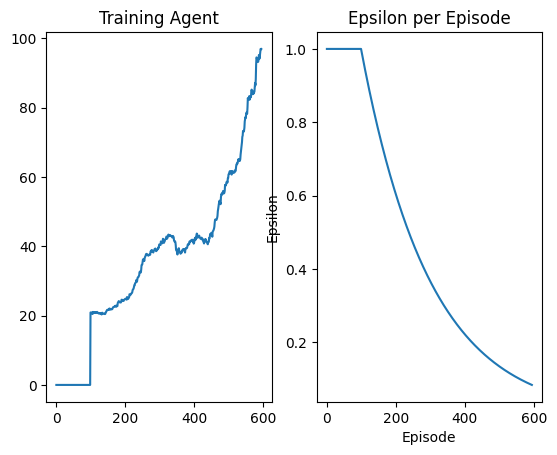

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 595 Duration 81 steps | epsilon 0.0835195083585182


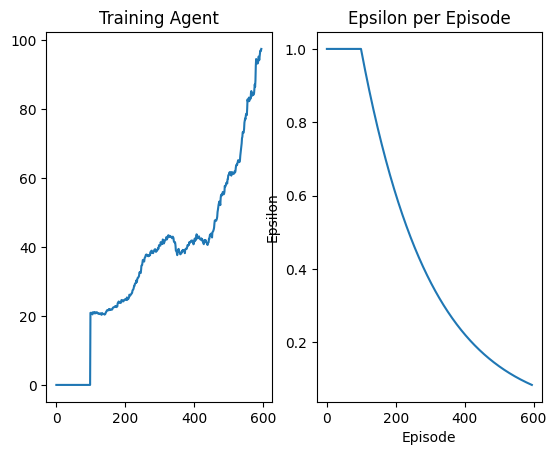

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 596 Duration 55 steps | epsilon 0.08310250488074991


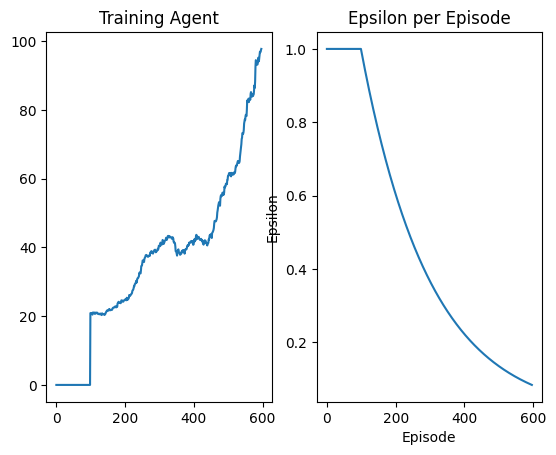

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 597 Duration 102 steps | epsilon 0.08268758345427585


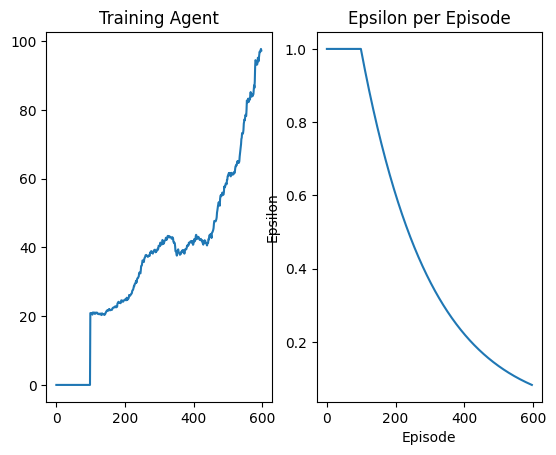

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 598 Duration 150 steps | epsilon 0.08227473368364892


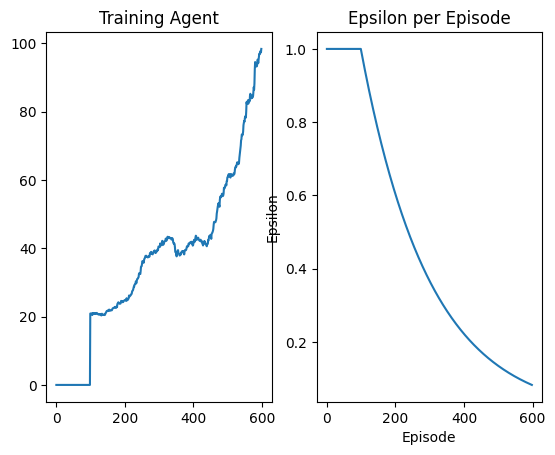

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 599 Duration 44 steps | epsilon 0.08186394522532531


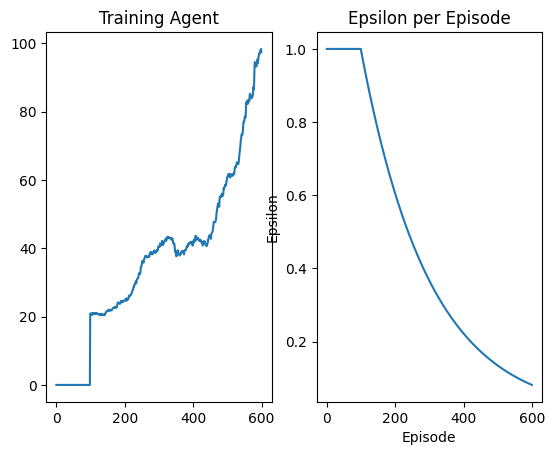

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 600 Duration 384 steps | epsilon 0.08145520778740538


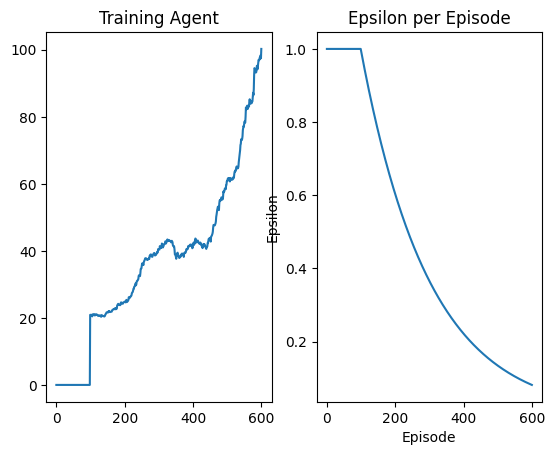

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 601 Duration 232 steps | epsilon 0.08104851112937575


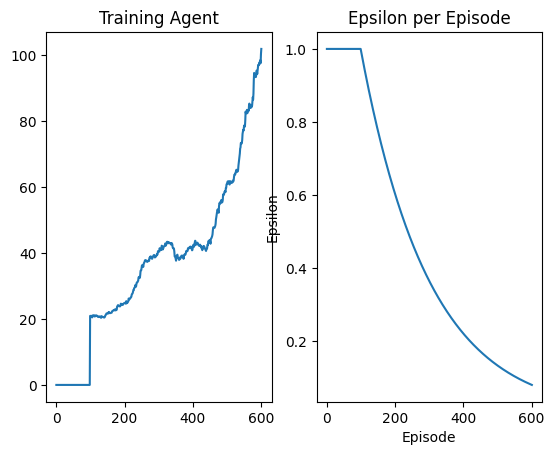

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 602 Duration 106 steps | epsilon 0.0806438450618528


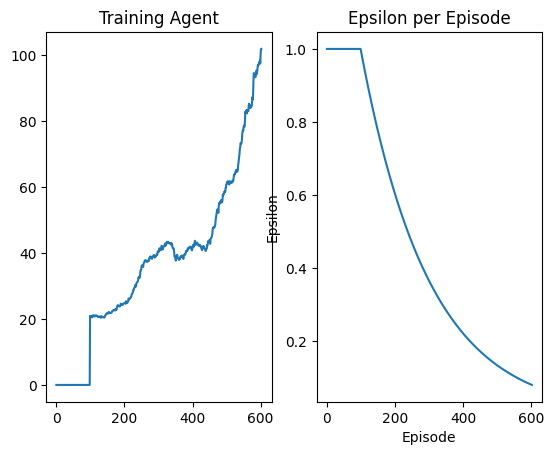

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 603 Duration 71 steps | epsilon 0.08024119944632735


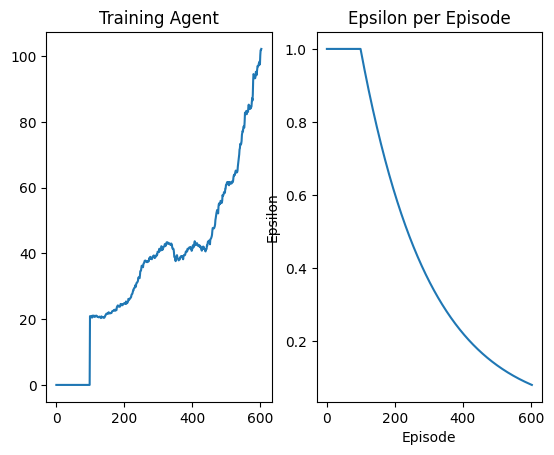

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 604 Duration 62 steps | epsilon 0.0798405641949106


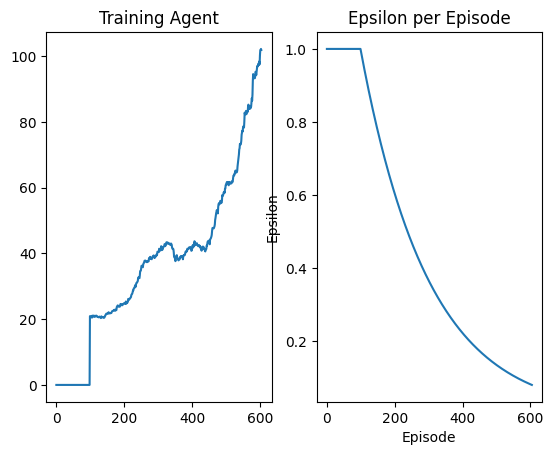

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 605 Duration 39 steps | epsilon 0.07944192927008152


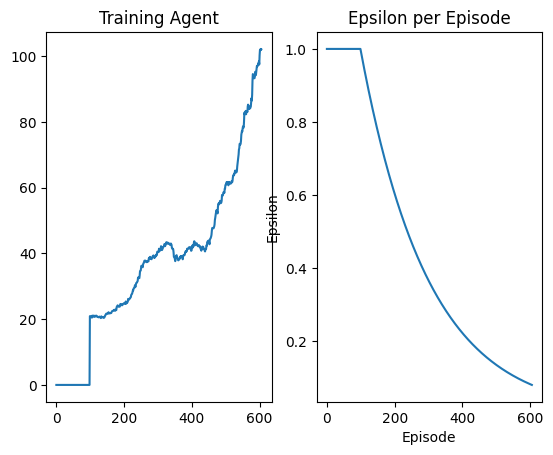

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 606 Duration 205 steps | epsilon 0.07904528468443522


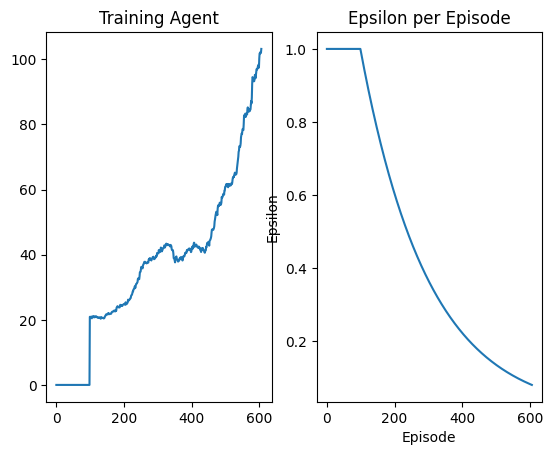

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 607 Duration 29 steps | epsilon 0.07865062050043285


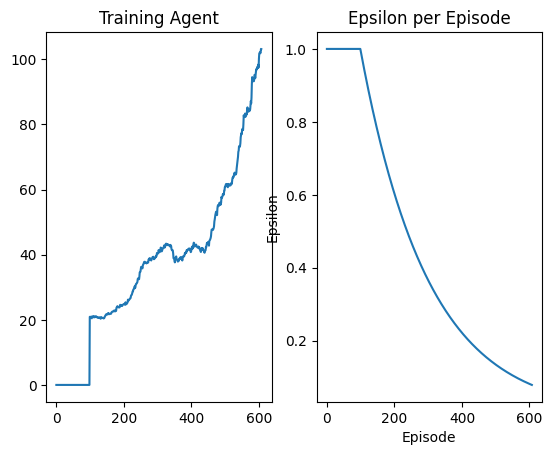

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 608 Duration 205 steps | epsilon 0.07825792683015254


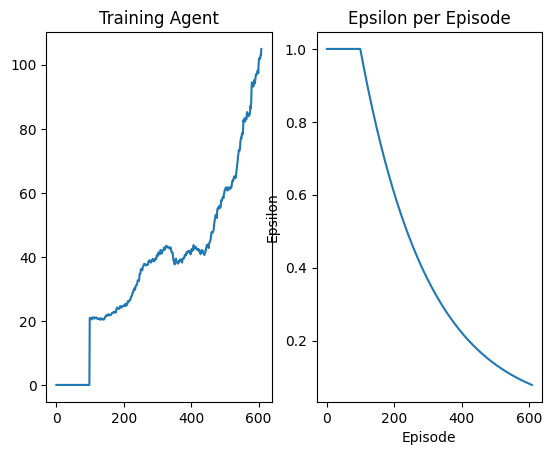

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 609 Duration 68 steps | epsilon 0.07786719383504168


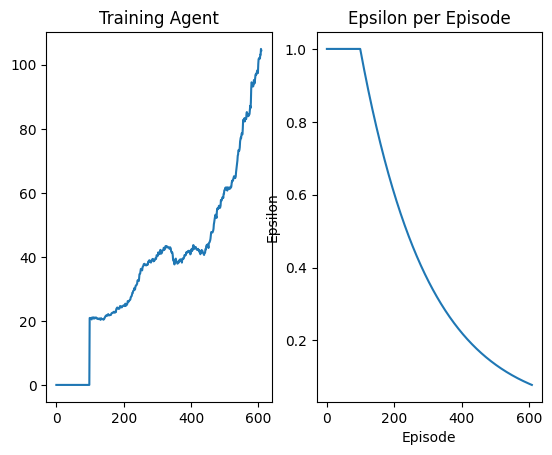

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 610 Duration 172 steps | epsilon 0.07747841172567048


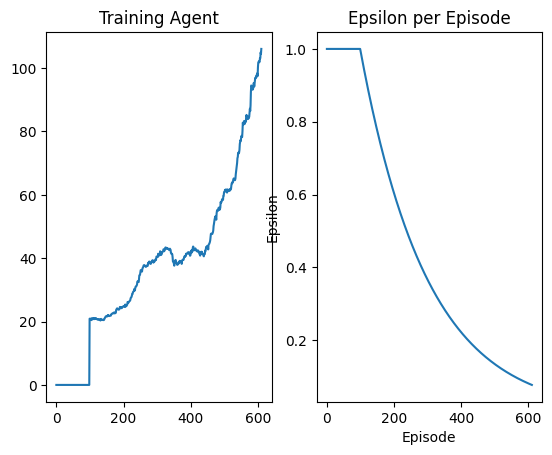

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 611 Duration 227 steps | epsilon 0.07709157076148666


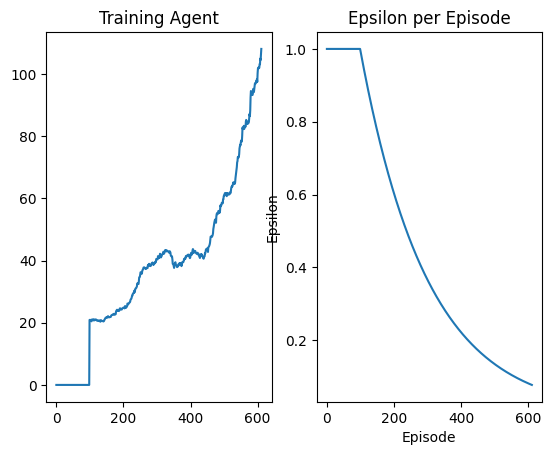

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 612 Duration 203 steps | epsilon 0.0767066612505714


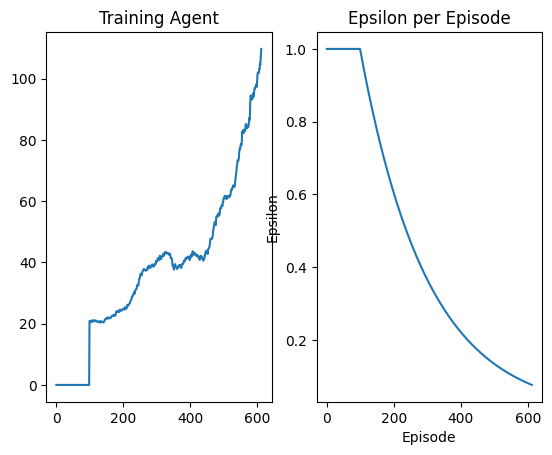

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 613 Duration 120 steps | epsilon 0.07632367354939656


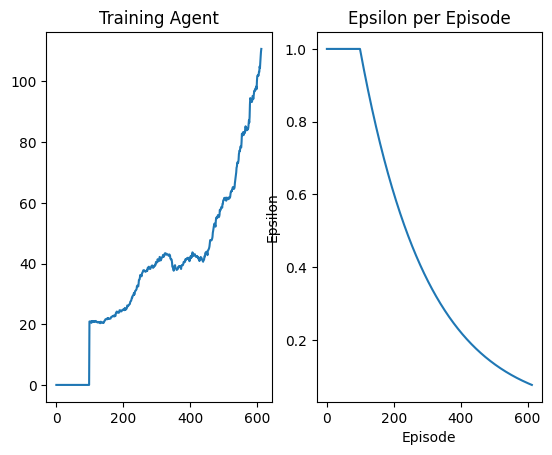

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 614 Duration 26 steps | epsilon 0.07594259806258302


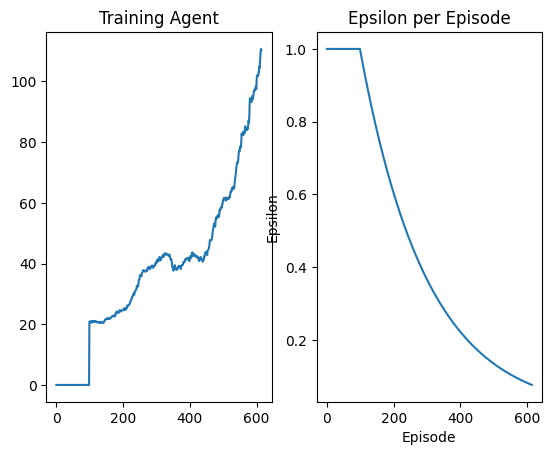

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 615 Duration 12 steps | epsilon 0.07556342524266033


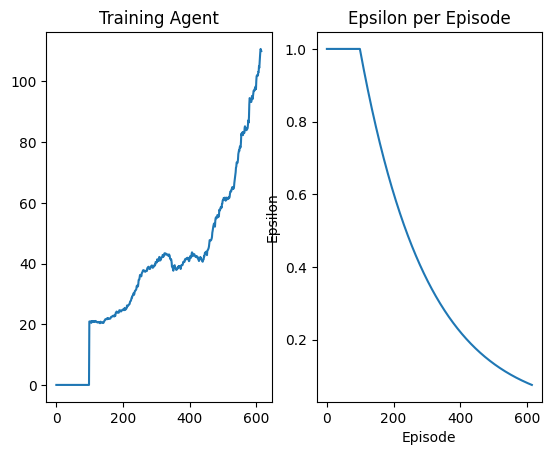

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 616 Duration 147 steps | epsilon 0.07518614558982746


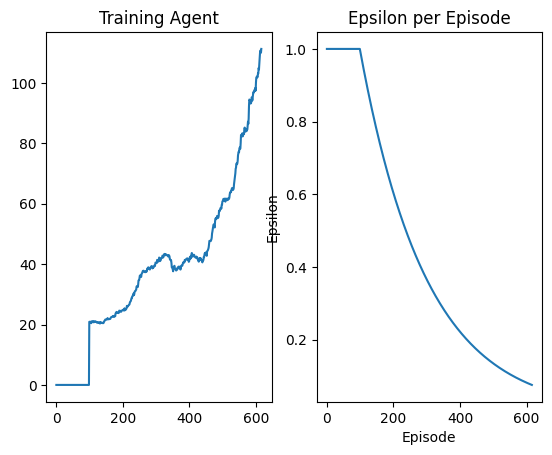

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 617 Duration 144 steps | epsilon 0.07481074965171484


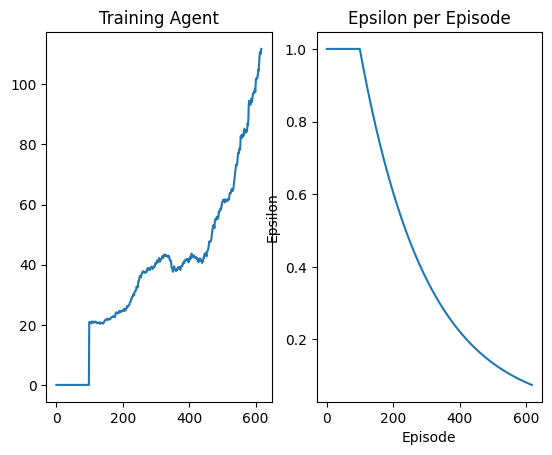

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 618 Duration 38 steps | epsilon 0.07443722802314749


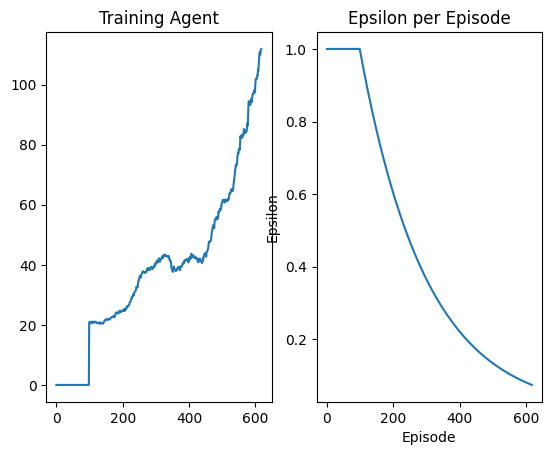

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 619 Duration 223 steps | epsilon 0.07406557134590942


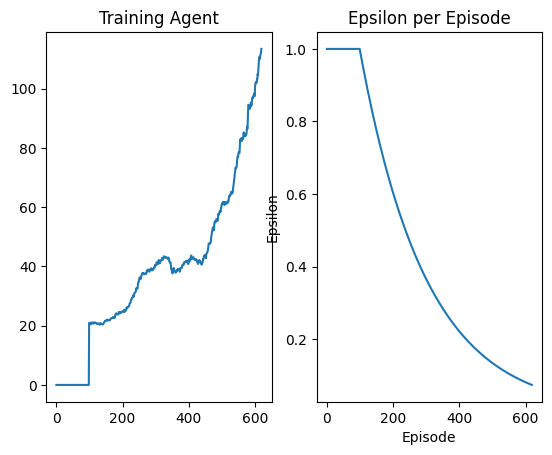

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 620 Duration 15 steps | epsilon 0.07369577030850917


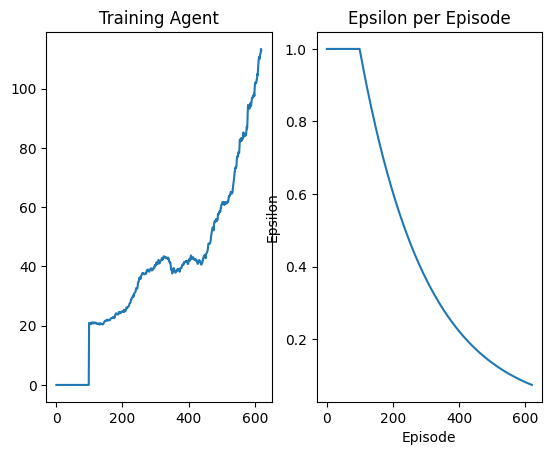

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 621 Duration 93 steps | epsilon 0.07332781564594647


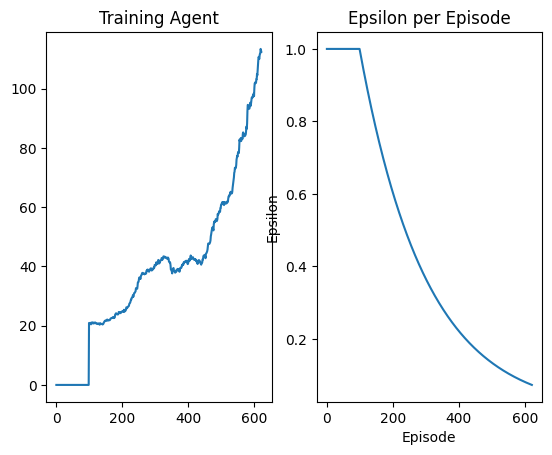

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 622 Duration 52 steps | epsilon 0.07296169813948017


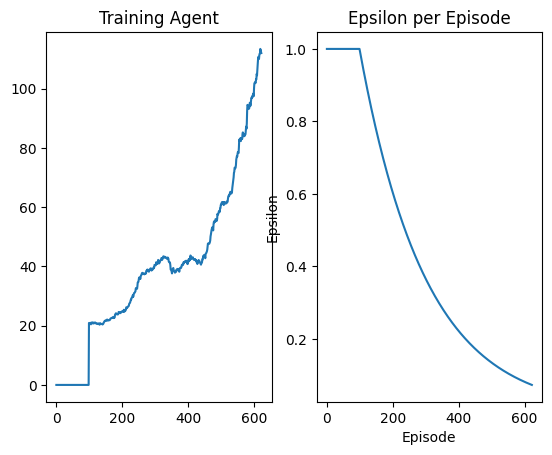

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 623 Duration 30 steps | epsilon 0.07259740861639727


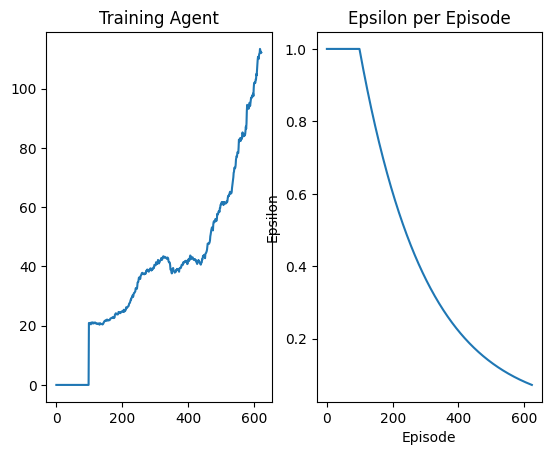

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 624 Duration 140 steps | epsilon 0.07223493794978306


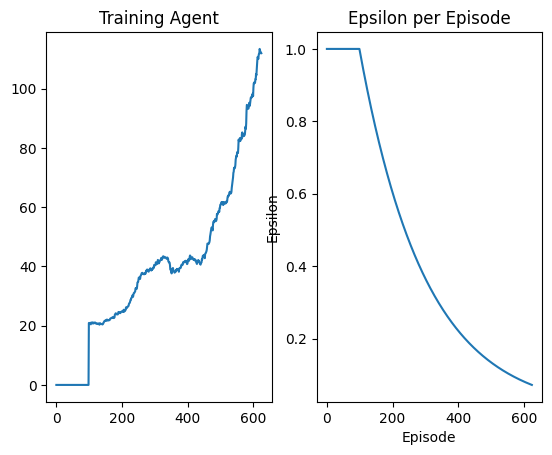

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 625 Duration 90 steps | epsilon 0.0718742770582925


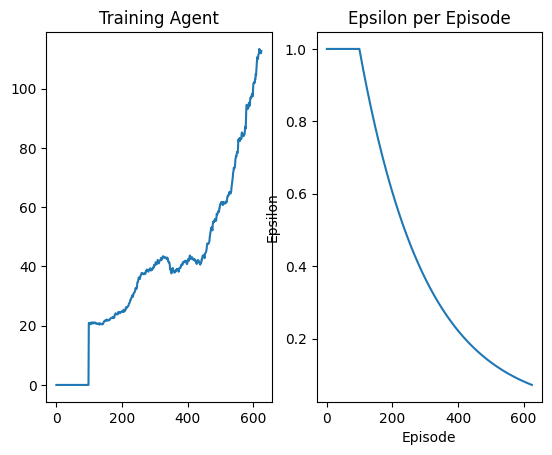

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 626 Duration 150 steps | epsilon 0.07151541690592268


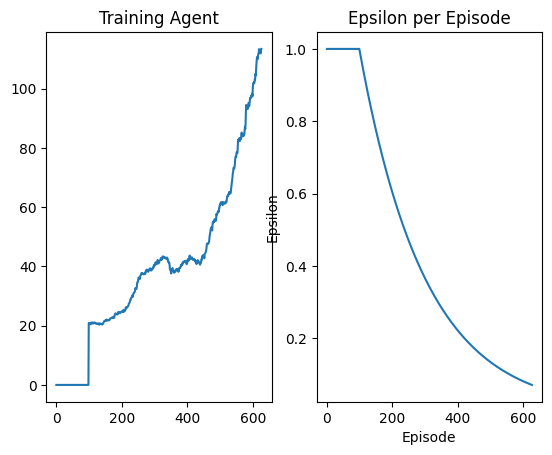

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 627 Duration 139 steps | epsilon 0.07115834850178646


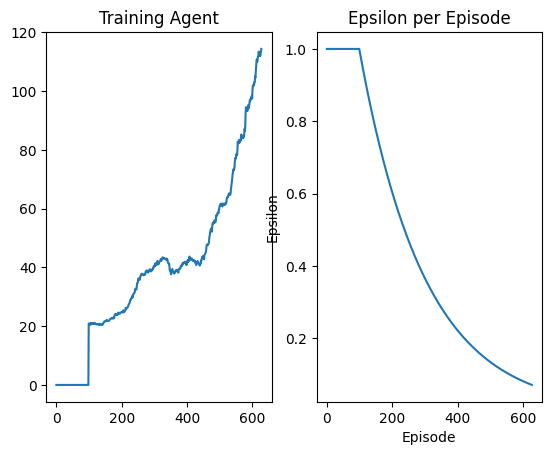

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 628 Duration 198 steps | epsilon 0.07080306289988712


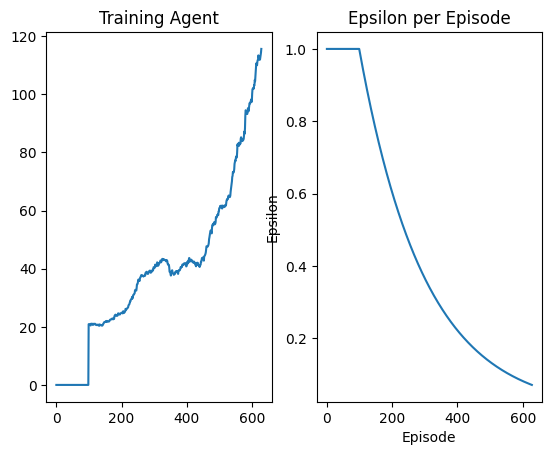

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 629 Duration 195 steps | epsilon 0.07044955119889434


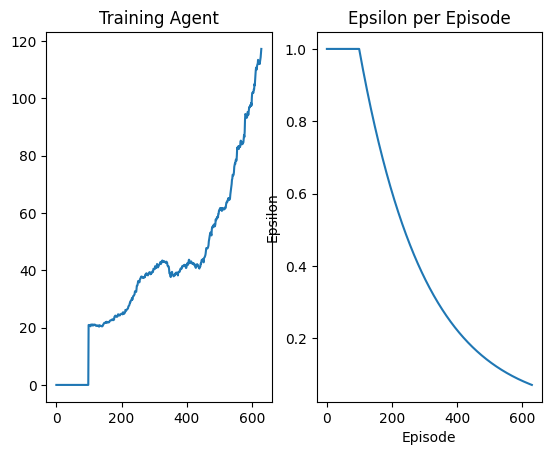

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 630 Duration 500 steps | epsilon 0.07009780454192115


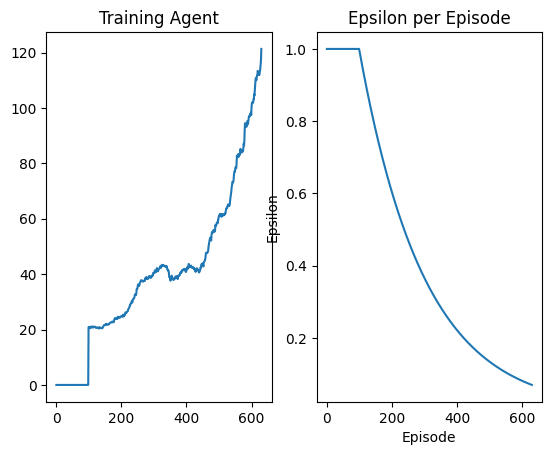

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 631 Duration 135 steps | epsilon 0.06974781411630196


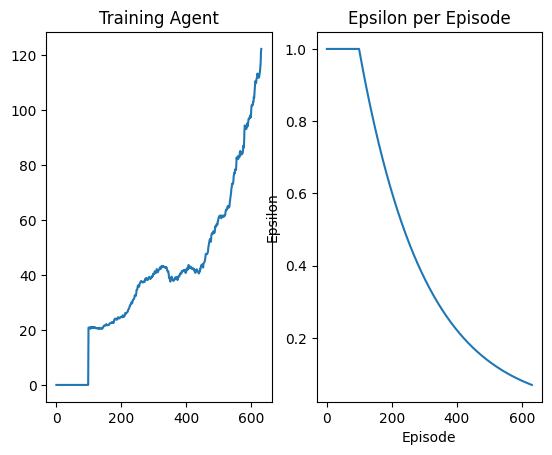

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 632 Duration 98 steps | epsilon 0.06939957115337188


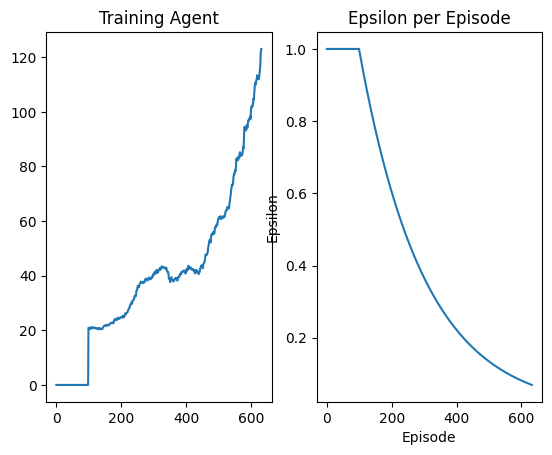

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 633 Duration 111 steps | epsilon 0.06905306692824695


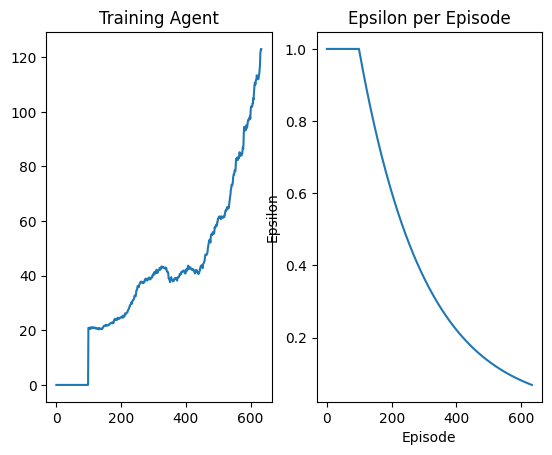

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 634 Duration 132 steps | epsilon 0.06870829275960556


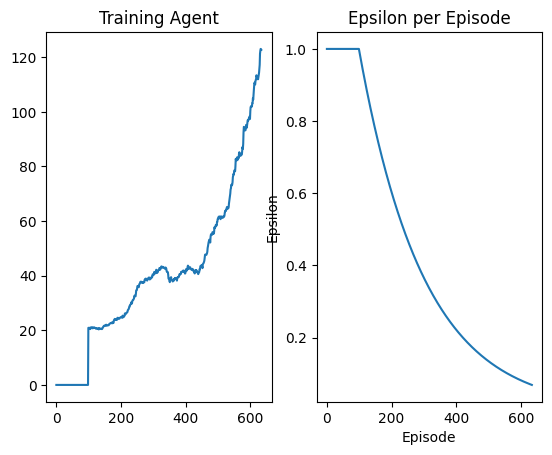

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 635 Duration 18 steps | epsilon 0.06836524000947099


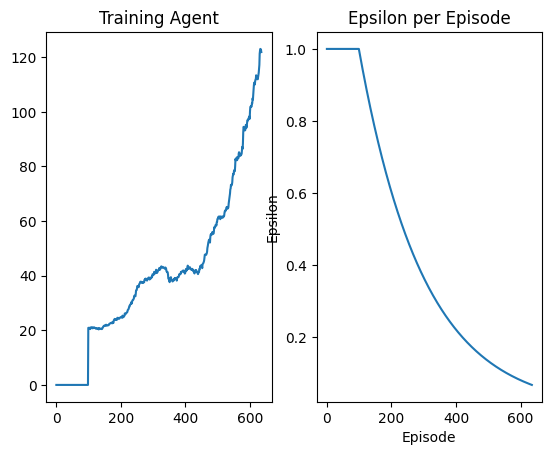

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 636 Duration 243 steps | epsilon 0.06802390008299493


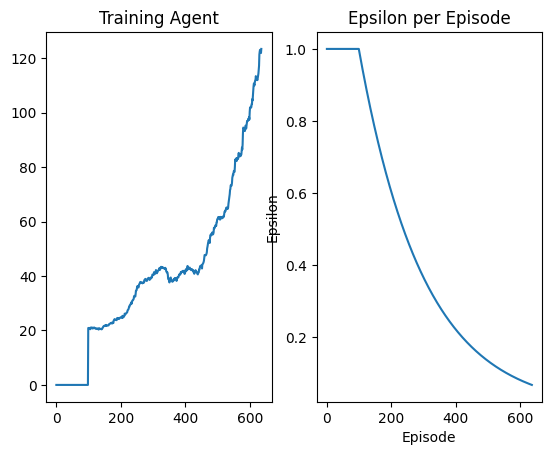

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 637 Duration 100 steps | epsilon 0.0676842644282422


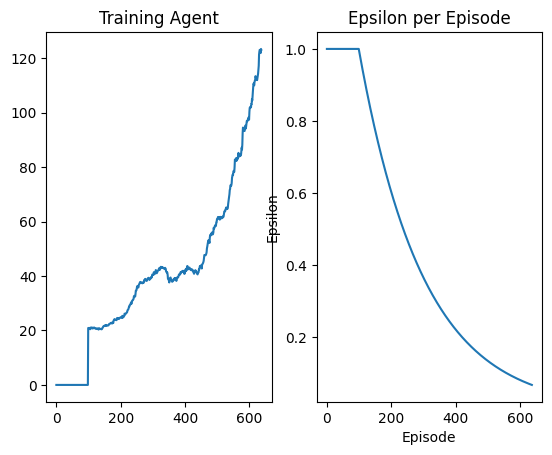

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 638 Duration 20 steps | epsilon 0.06734632453597646


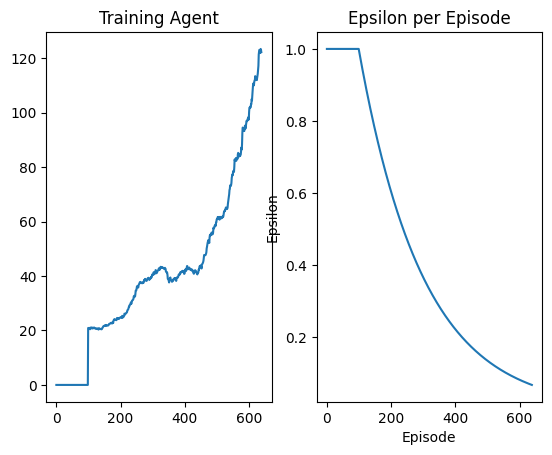

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 639 Duration 27 steps | epsilon 0.06701007193944701


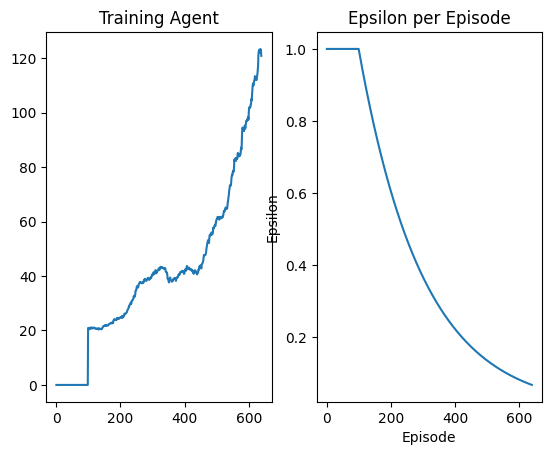

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 640 Duration 200 steps | epsilon 0.06667549821417672


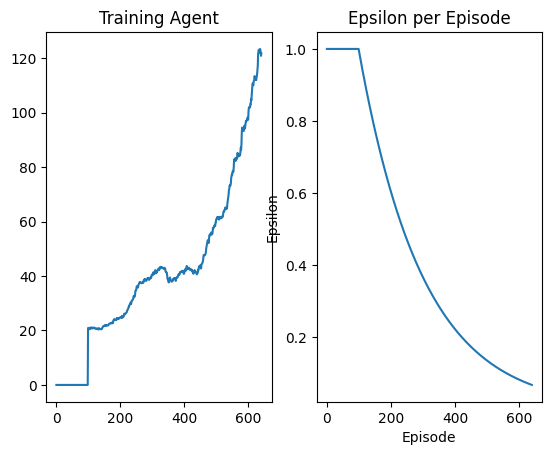

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 641 Duration 157 steps | epsilon 0.06634259497775088


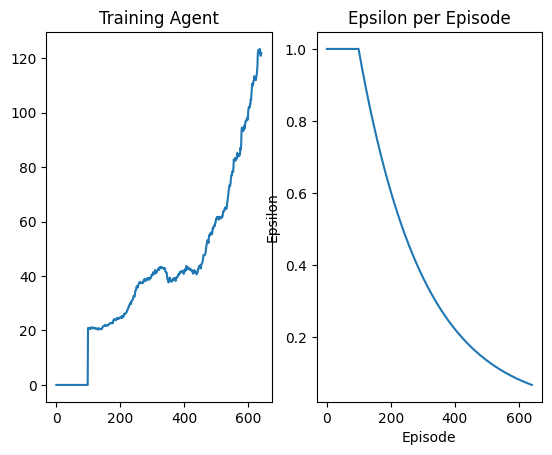

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 642 Duration 69 steps | epsilon 0.06601135388960727


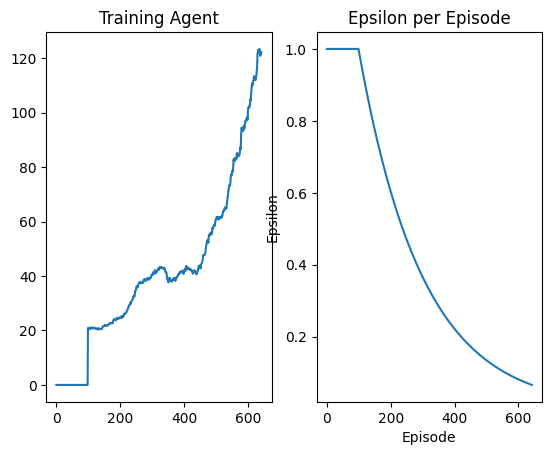

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 643 Duration 103 steps | epsilon 0.06568176665082713


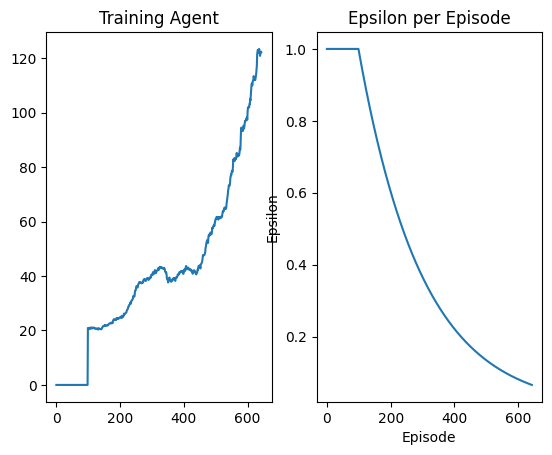

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 644 Duration 184 steps | epsilon 0.06535382500392727


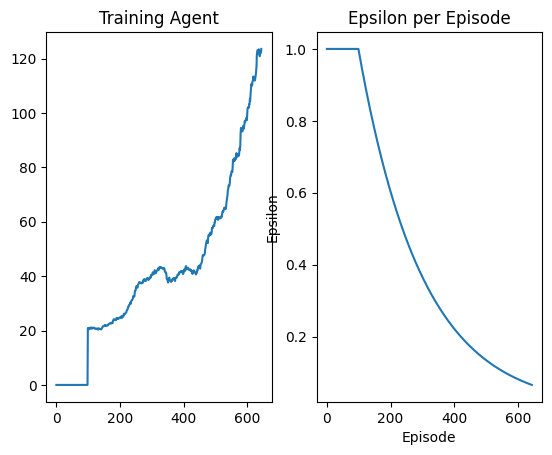

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 645 Duration 120 steps | epsilon 0.06502752073265317


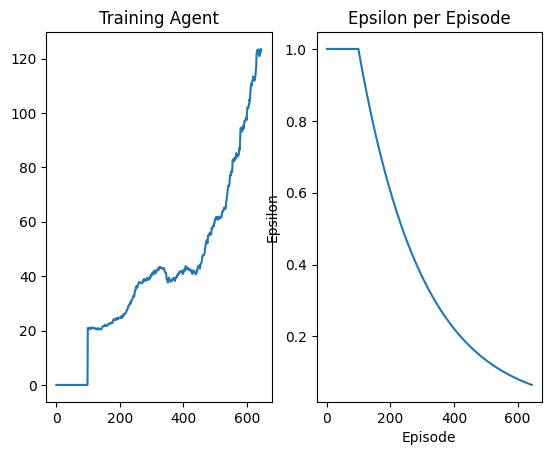

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 646 Duration 134 steps | epsilon 0.06470284566177315


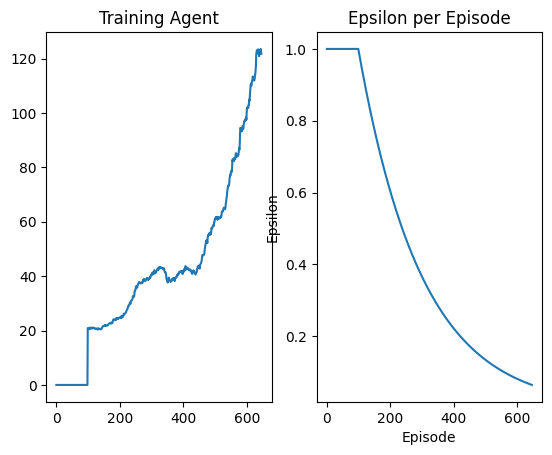

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 647 Duration 353 steps | epsilon 0.06437979165687355


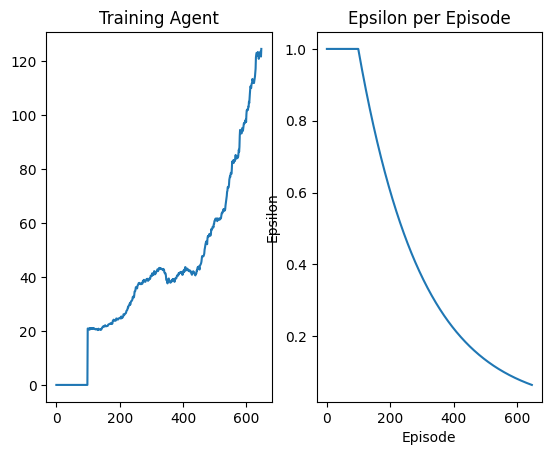

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 648 Duration 19 steps | epsilon 0.06405835062415492


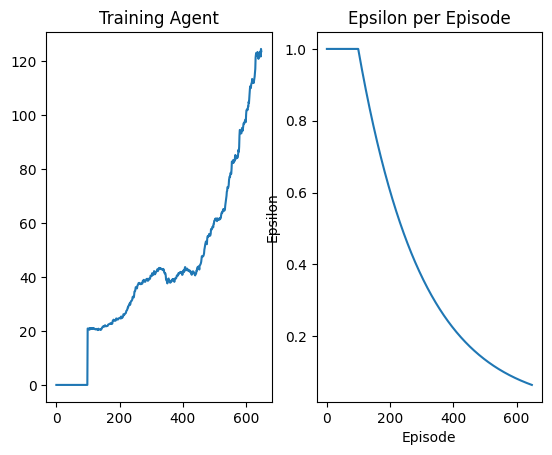

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 649 Duration 57 steps | epsilon 0.06373851451022923


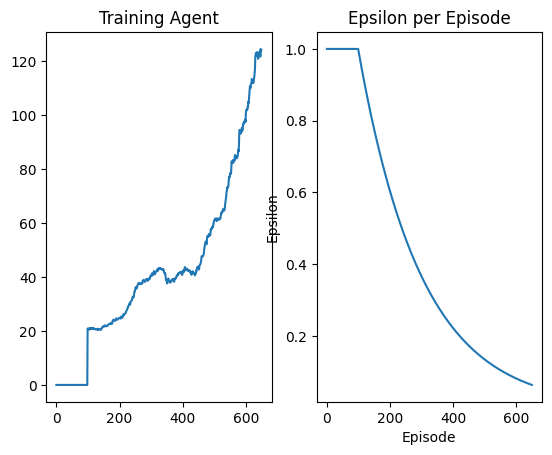

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 650 Duration 153 steps | epsilon 0.0634202753019181


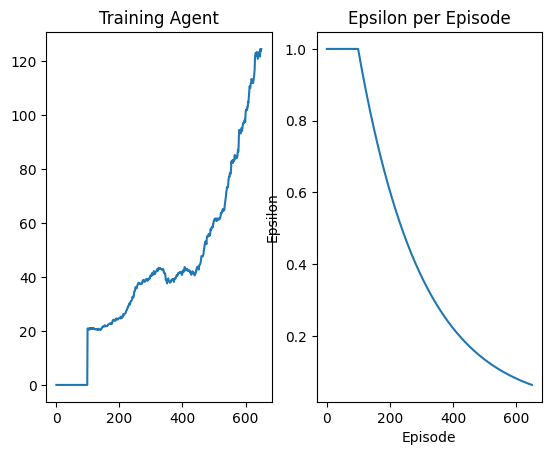

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 651 Duration 281 steps | epsilon 0.06310362502605205


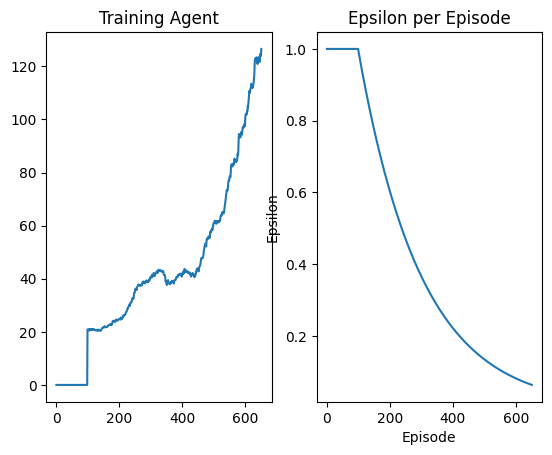

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 652 Duration 176 steps | epsilon 0.06278855574927072


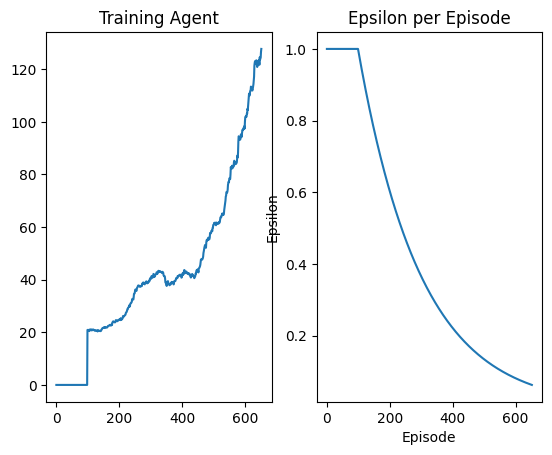

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 653 Duration 96 steps | epsilon 0.06247505957782417


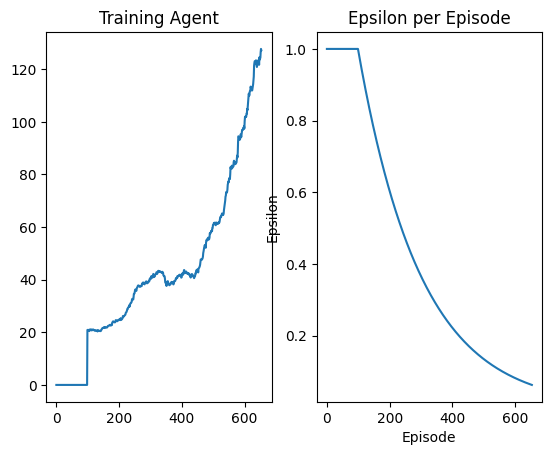

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 654 Duration 64 steps | epsilon 0.062163128657375014


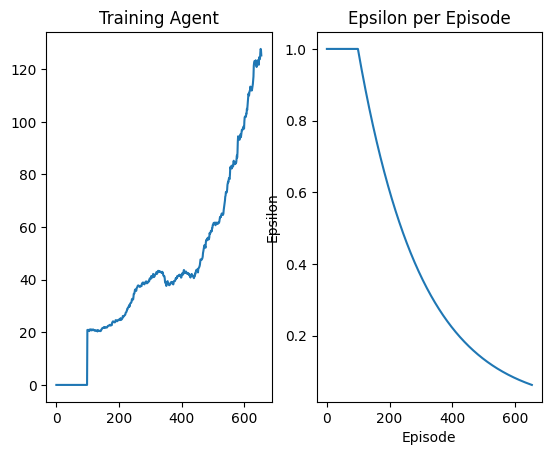

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 655 Duration 55 steps | epsilon 0.061852755172801706


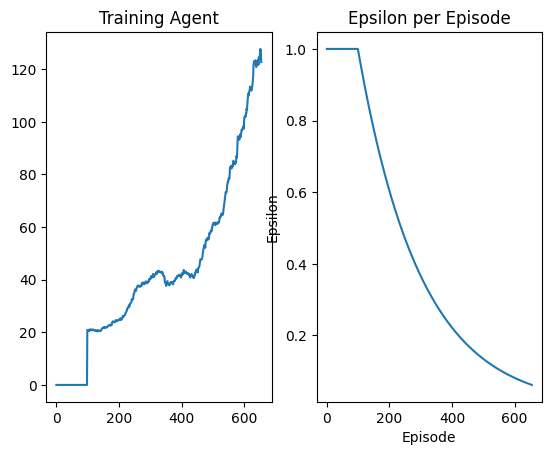

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 656 Duration 140 steps | epsilon 0.06154393134800271


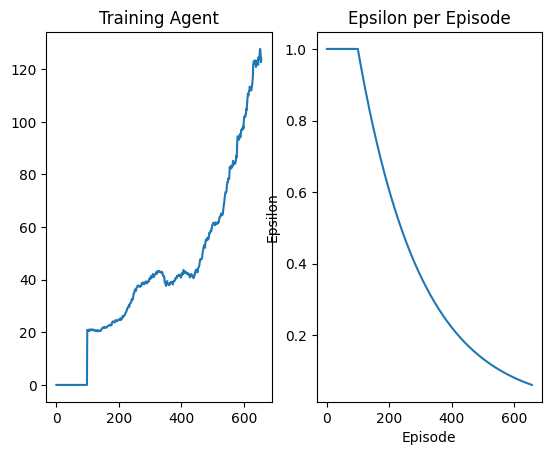

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 657 Duration 85 steps | epsilon 0.06123664944570171


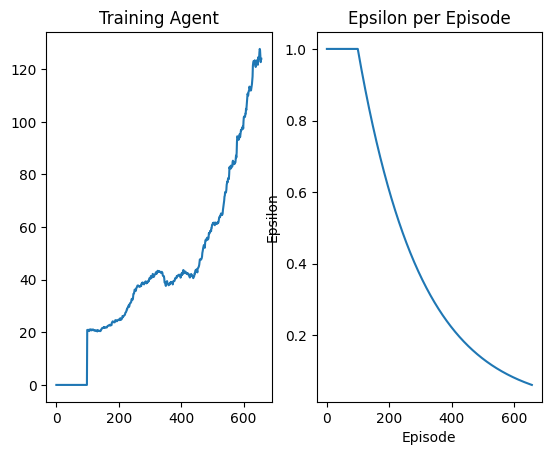

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 658 Duration 108 steps | epsilon 0.06093090176725371


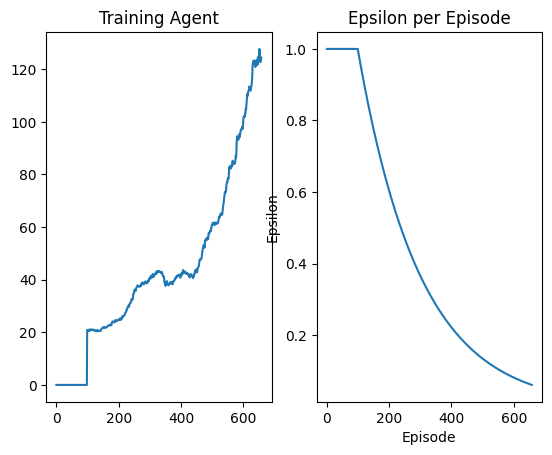

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 659 Duration 155 steps | epsilon 0.06062668065245219


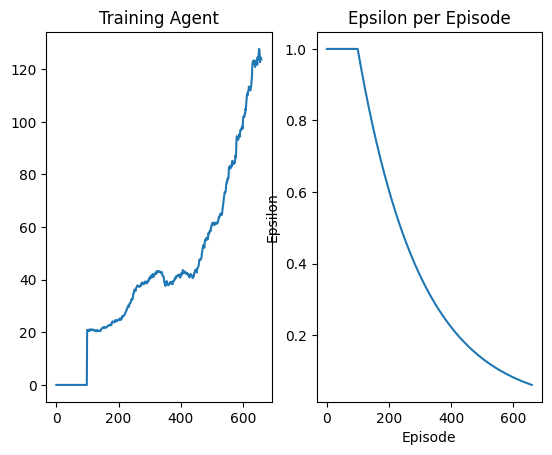

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 660 Duration 123 steps | epsilon 0.06032397847933719


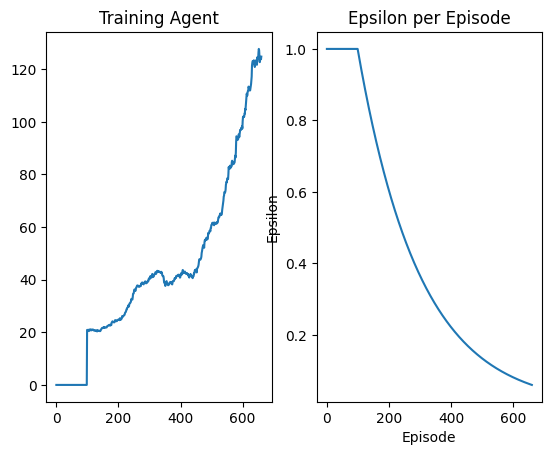

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 661 Duration 70 steps | epsilon 0.06002278766400431


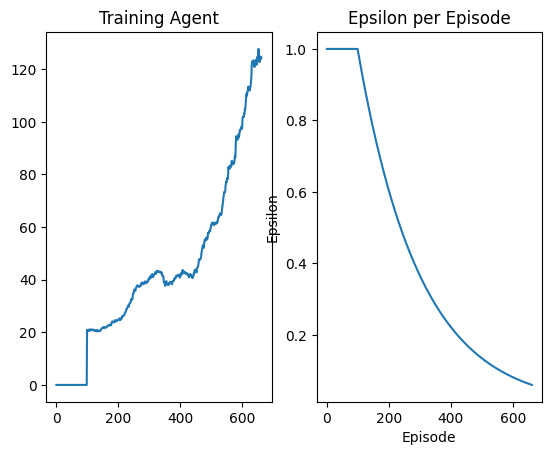

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 662 Duration 16 steps | epsilon 0.05972310066041475


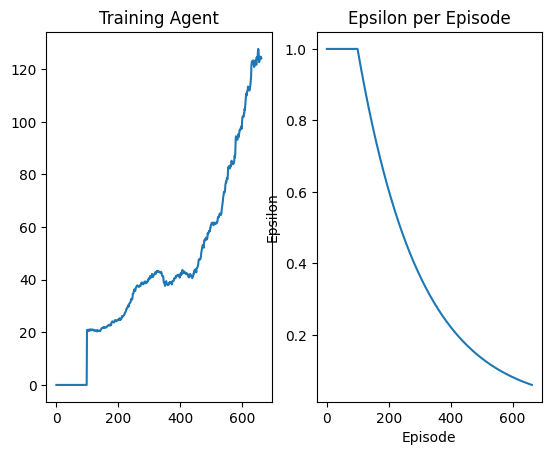

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 663 Duration 75 steps | epsilon 0.059424909960206225


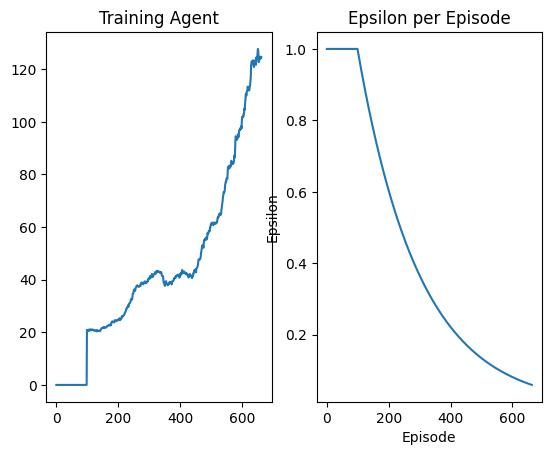

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 664 Duration 38 steps | epsilon 0.059128208092504846


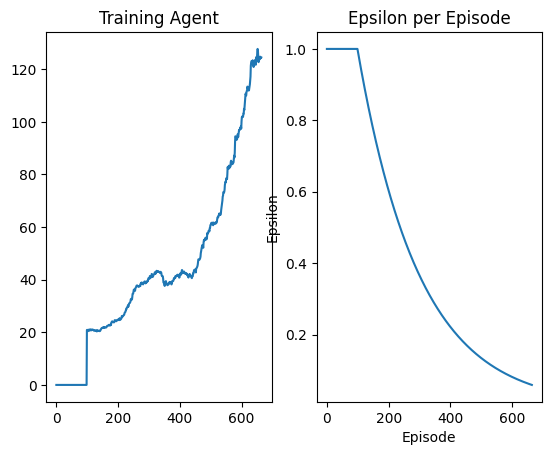

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 665 Duration 128 steps | epsilon 0.05883298762373796


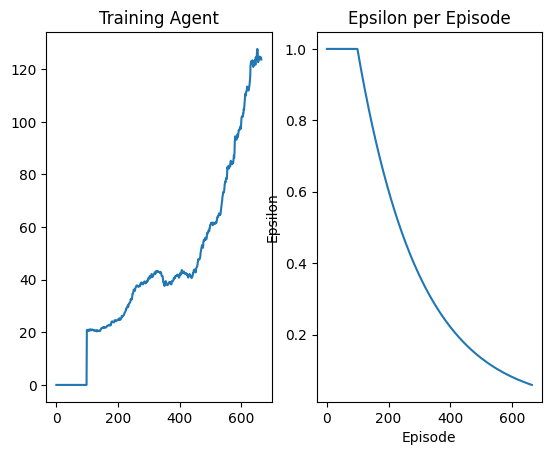

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 666 Duration 158 steps | epsilon 0.05853924115744791


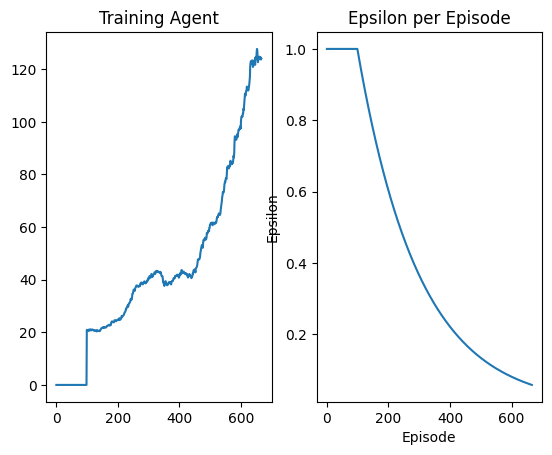

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 667 Duration 88 steps | epsilon 0.0582469613341067


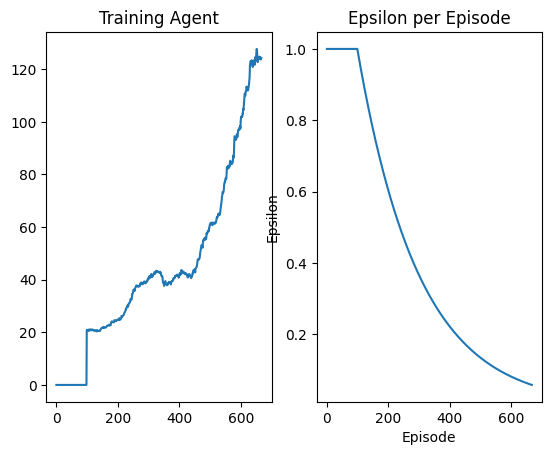

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 668 Duration 209 steps | epsilon 0.057956140830931646


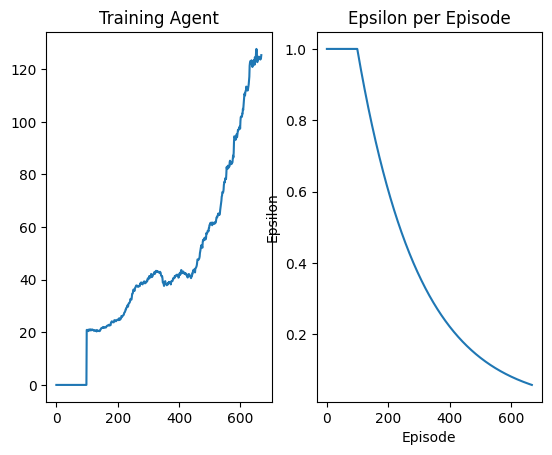

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 669 Duration 40 steps | epsilon 0.05766677236170188


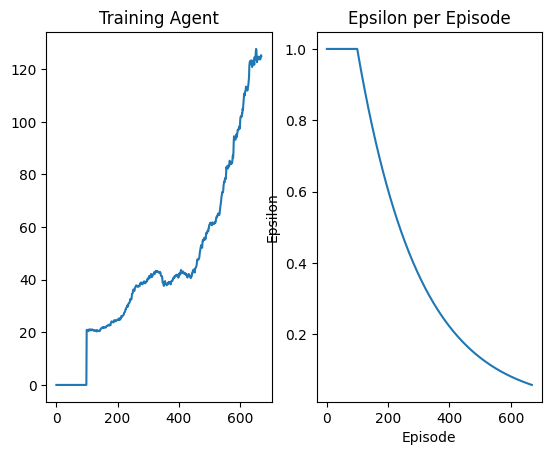

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 670 Duration 78 steps | epsilon 0.05737884867657581


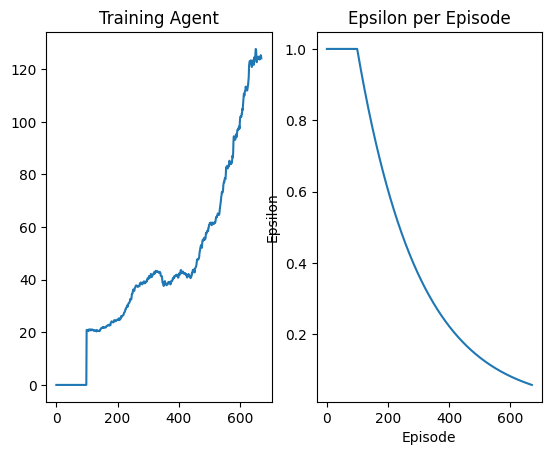

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 671 Duration 33 steps | epsilon 0.0570923625619095


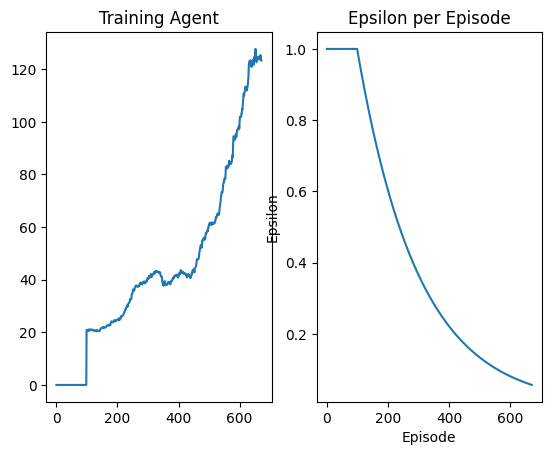

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 672 Duration 224 steps | epsilon 0.056807306840075907


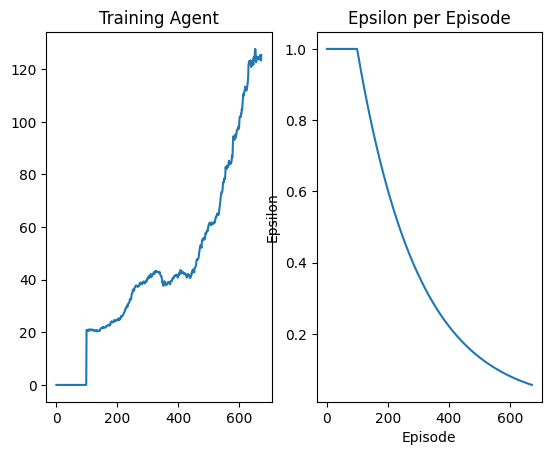

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 673 Duration 25 steps | epsilon 0.05652367436928508


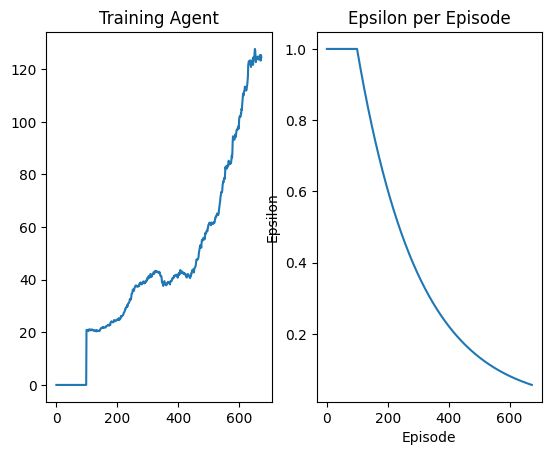

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 674 Duration 209 steps | epsilon 0.056241458043405204


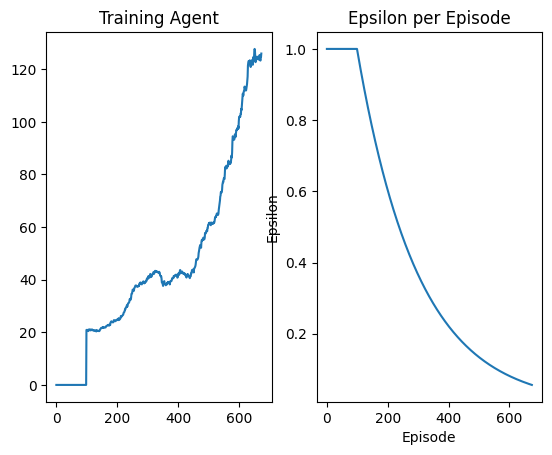

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 675 Duration 237 steps | epsilon 0.055960650791784604


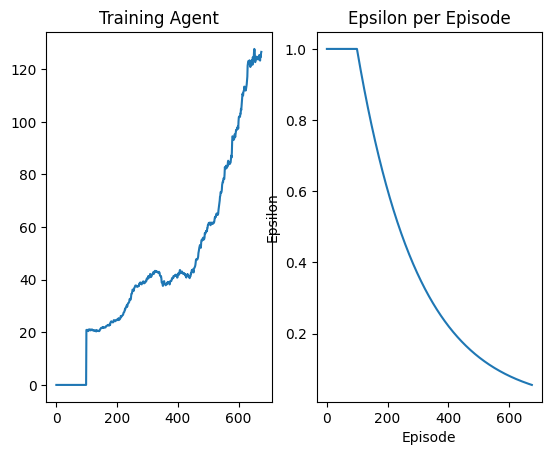

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 676 Duration 38 steps | epsilon 0.05568124557907455


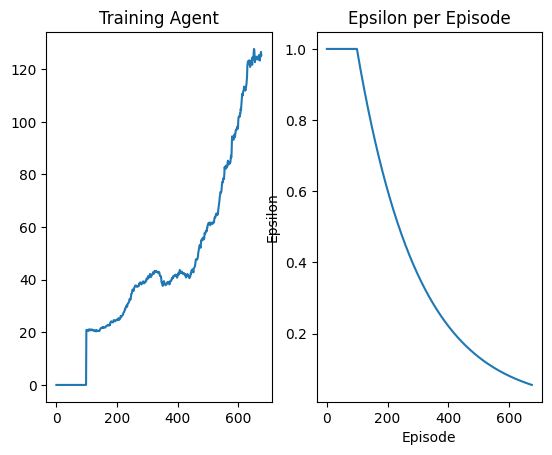

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 677 Duration 126 steps | epsilon 0.05540323540505302


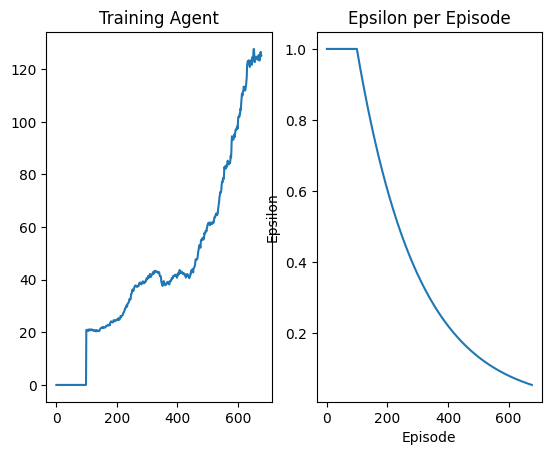

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 678 Duration 154 steps | epsilon 0.05512661330444931


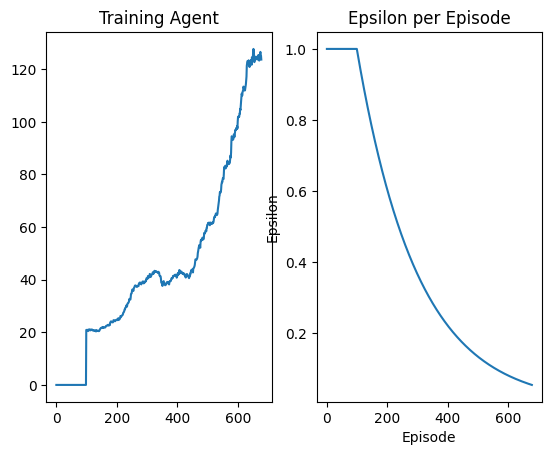

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 679 Duration 189 steps | epsilon 0.05485137234676953


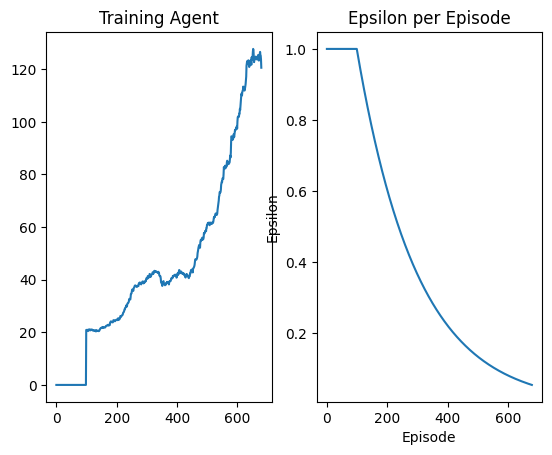

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 680 Duration 384 steps | epsilon 0.05457750563612296


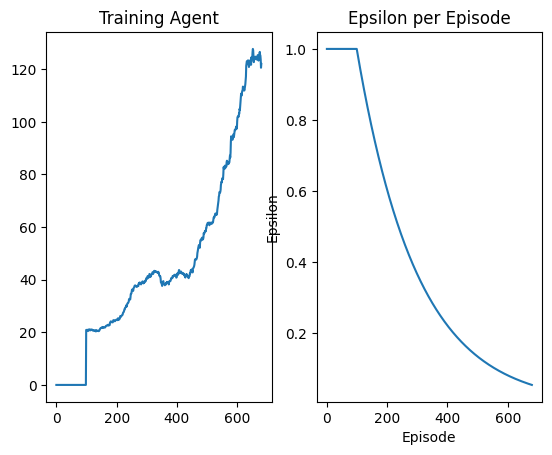

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 681 Duration 139 steps | epsilon 0.05430500631104928


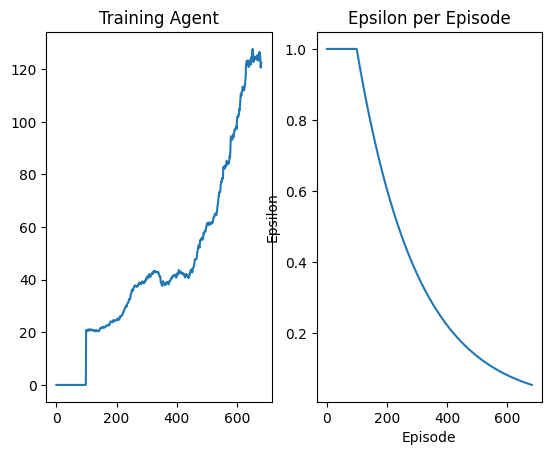

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 682 Duration 95 steps | epsilon 0.05403386754434668


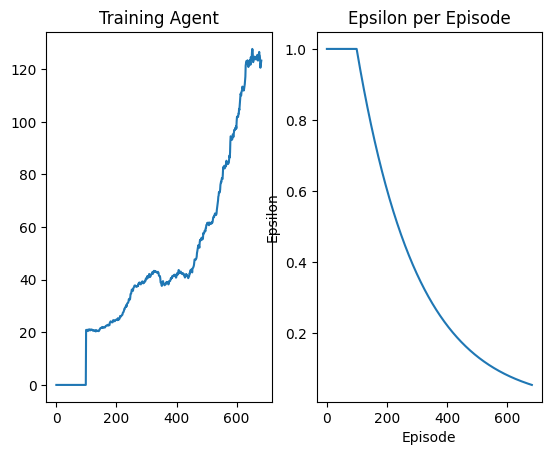

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 683 Duration 264 steps | epsilon 0.05376408254290078


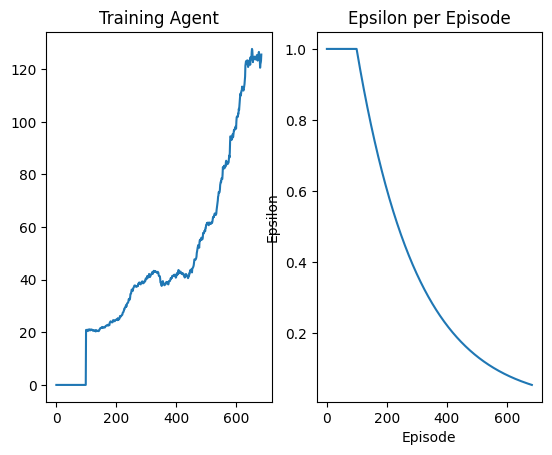

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 684 Duration 136 steps | epsilon 0.053495644547514466


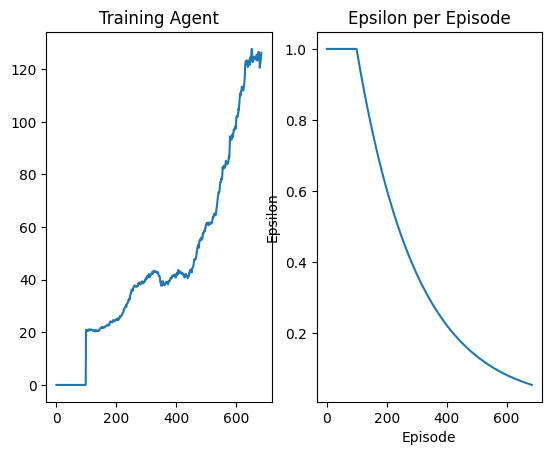

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 685 Duration 211 steps | epsilon 0.05322854683273853


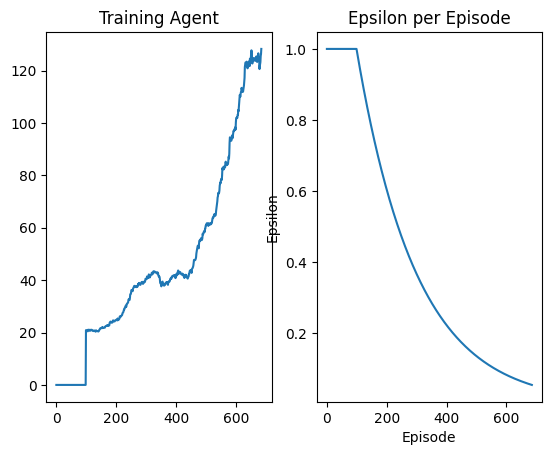

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 686 Duration 111 steps | epsilon 0.052962782706703175


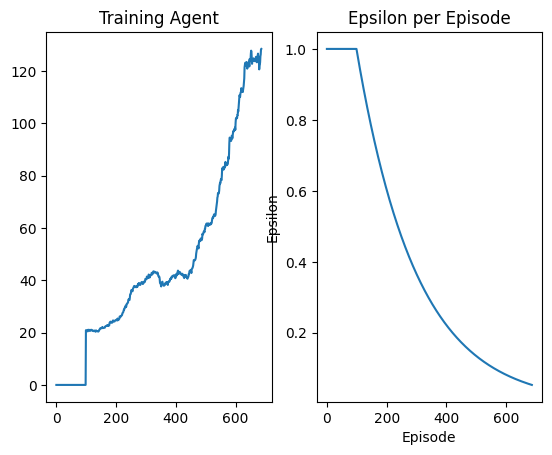

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 687 Duration 50 steps | epsilon 0.052698345510950345


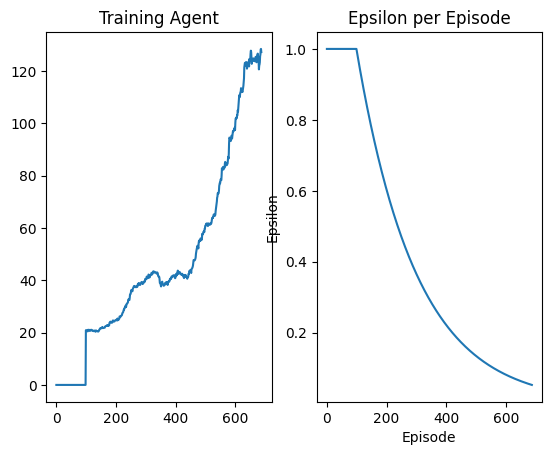

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 688 Duration 20 steps | epsilon 0.05243522862026693


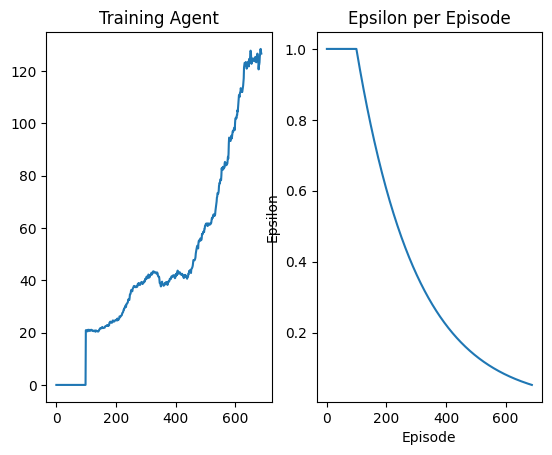

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 689 Duration 252 steps | epsilon 0.05217342544251874


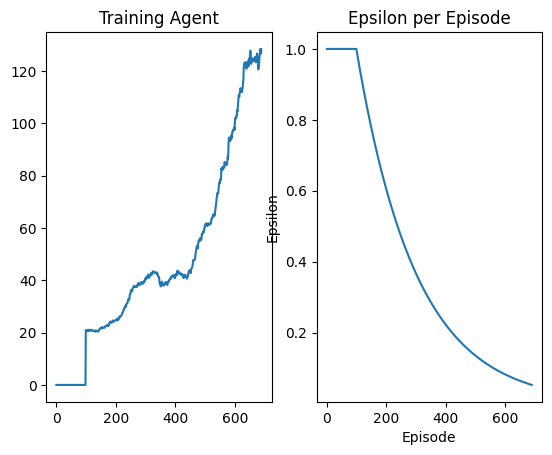

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 690 Duration 25 steps | epsilon 0.05191292941848538


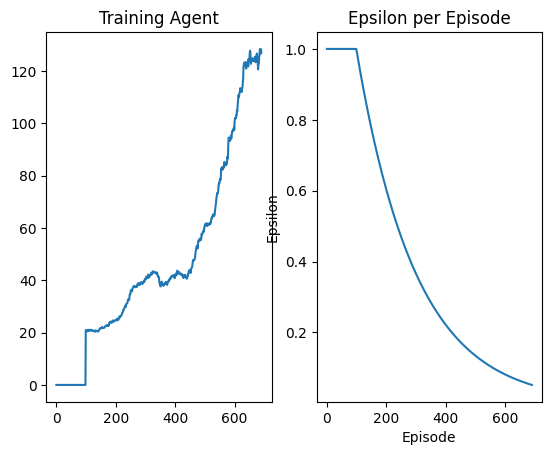

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 691 Duration 146 steps | epsilon 0.05165373402169591


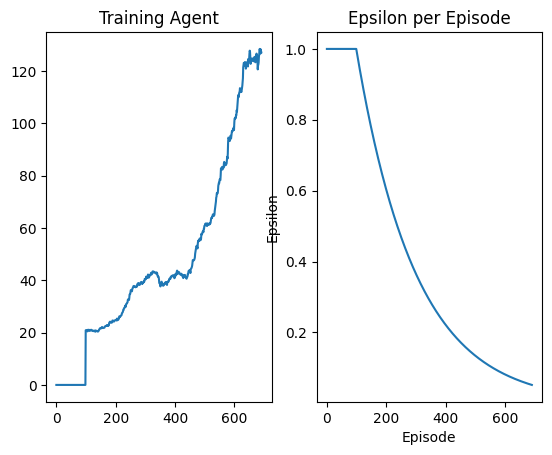

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 692 Duration 230 steps | epsilon 0.0513958327582653


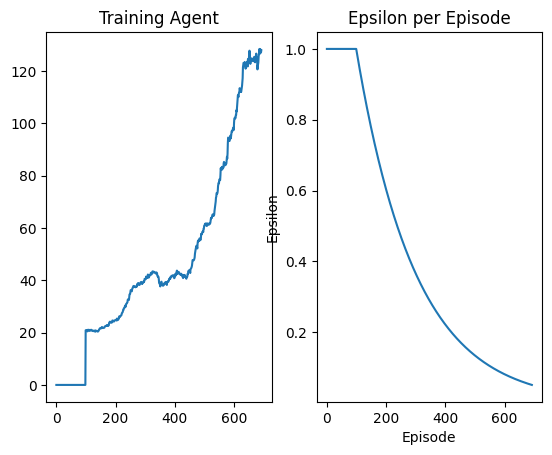

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 693 Duration 82 steps | epsilon 0.051139219166731774


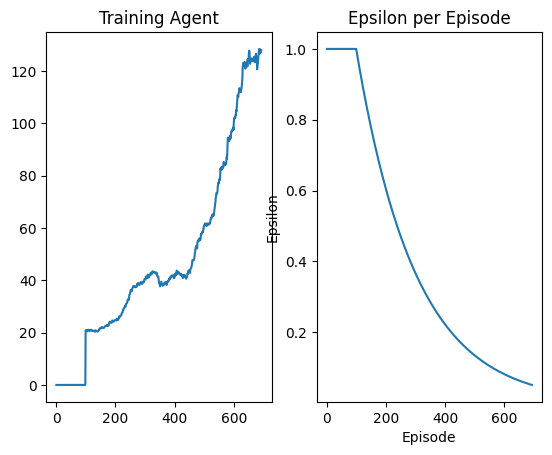

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 694 Duration 65 steps | epsilon 0.050883886817894894


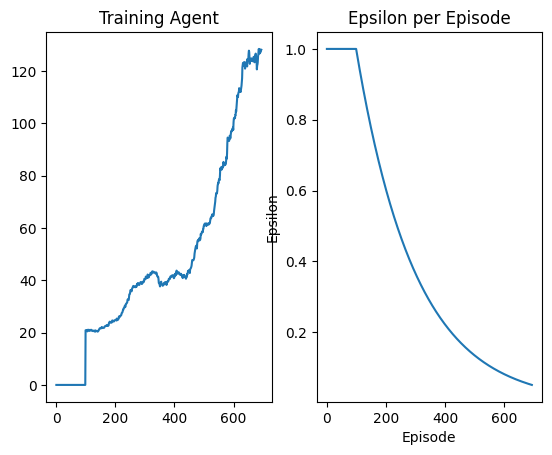

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 695 Duration 168 steps | epsilon 0.050629829314654505


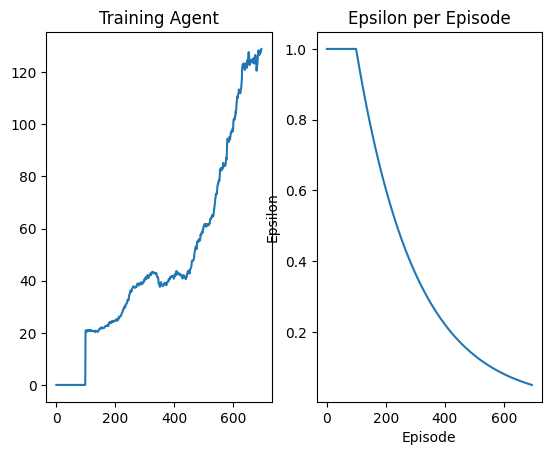

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 696 Duration 92 steps | epsilon 0.05037704029185044


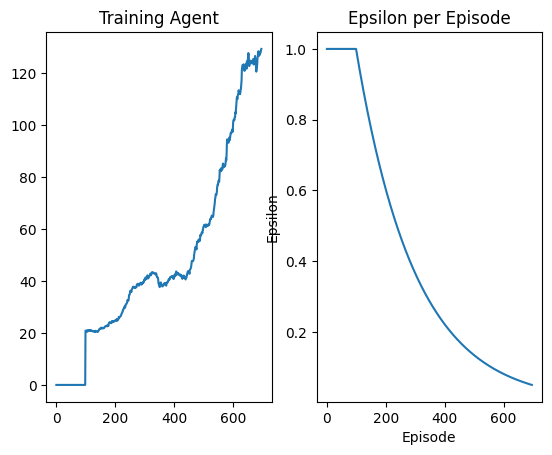

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 697 Duration 164 steps | epsilon 0.050125513416103065


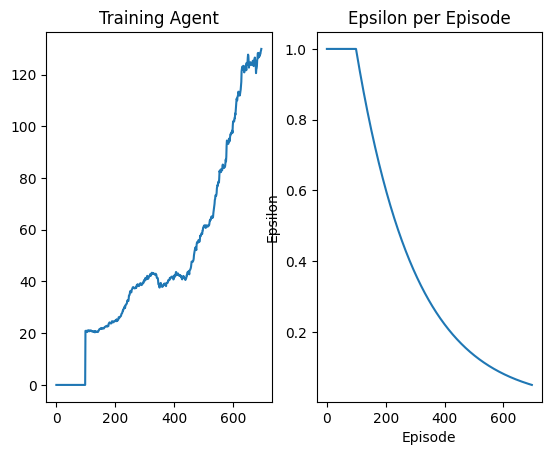

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 698 Duration 148 steps | epsilon 0.04987524238565459


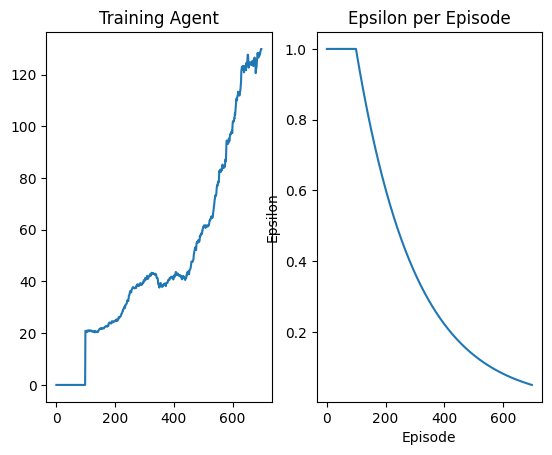

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 699 Duration 136 steps | epsilon 0.049626220930211205


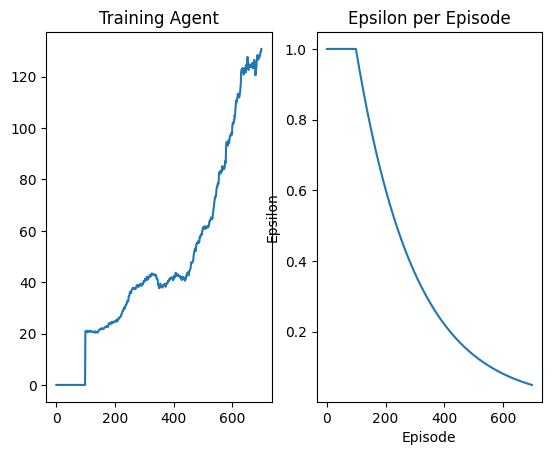

<Figure size 640x480 with 0 Axes>

 Mode: Training | Episode 700 Duration 178 steps | epsilon 0.049378442810785954


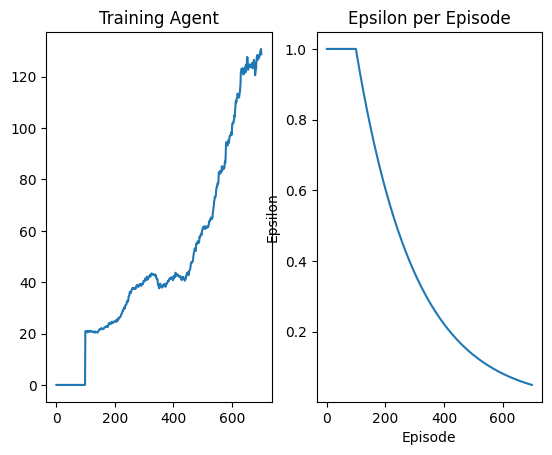

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 701 Duration 62 steps | epsilon 0.0


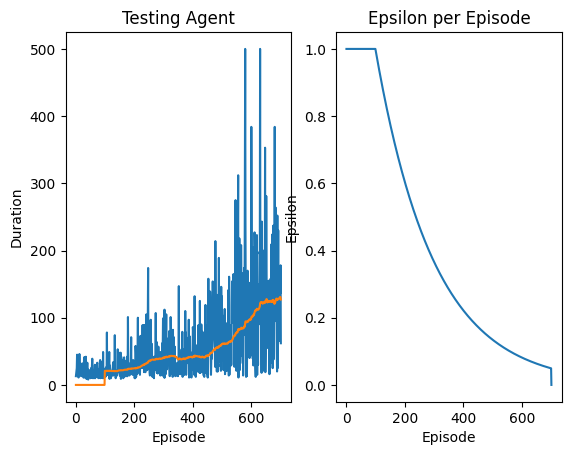

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 702 Duration 63 steps | epsilon 0.0


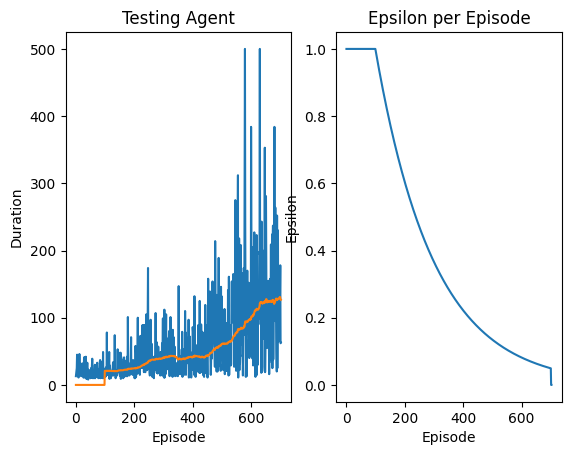

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 703 Duration 58 steps | epsilon 0.0


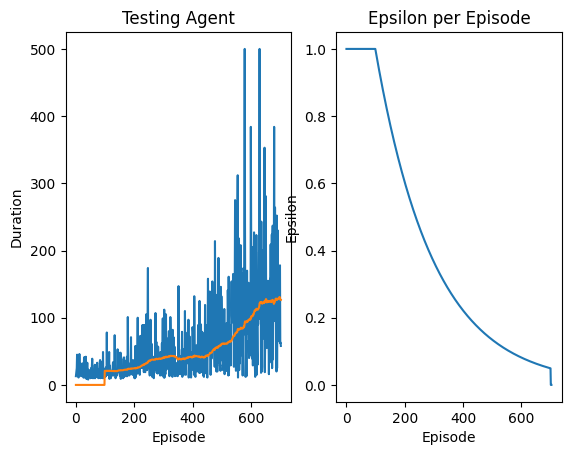

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 704 Duration 14 steps | epsilon 0.0


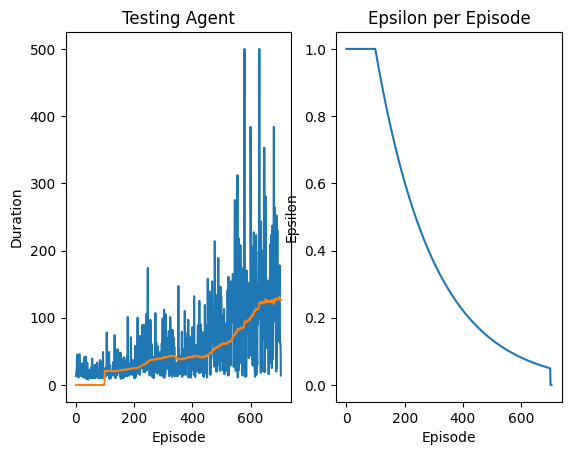

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 705 Duration 65 steps | epsilon 0.0


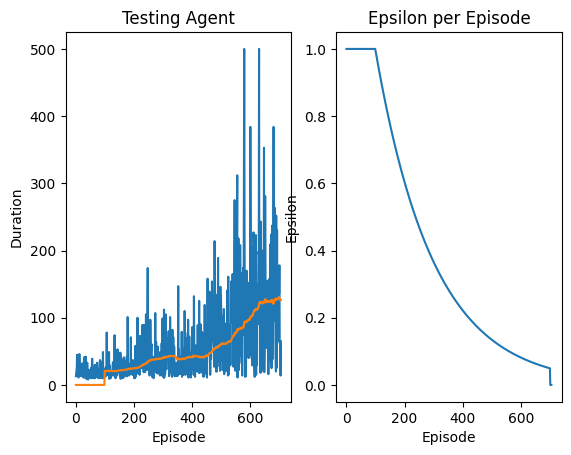

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 706 Duration 60 steps | epsilon 0.0


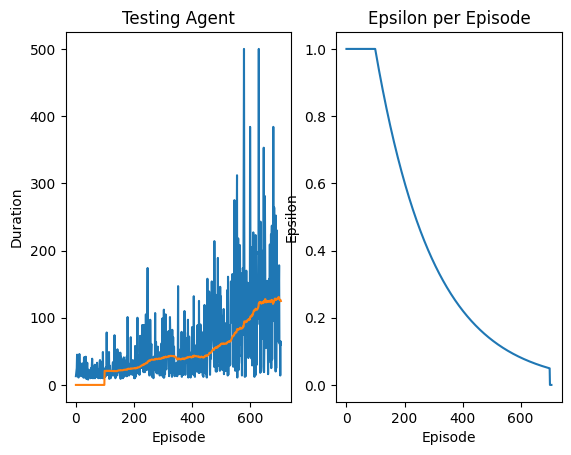

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 707 Duration 58 steps | epsilon 0.0


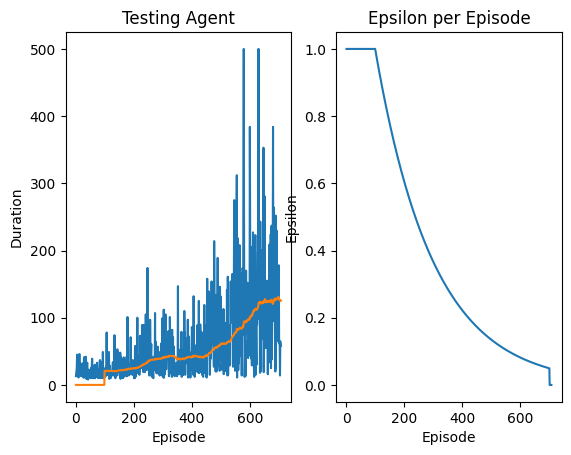

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 708 Duration 60 steps | epsilon 0.0


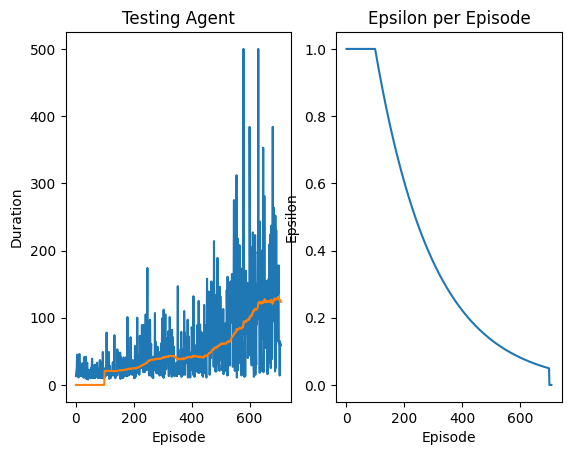

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 709 Duration 63 steps | epsilon 0.0


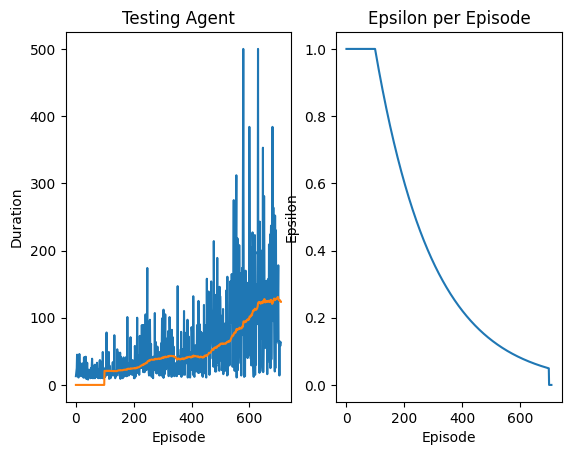

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 710 Duration 62 steps | epsilon 0.0


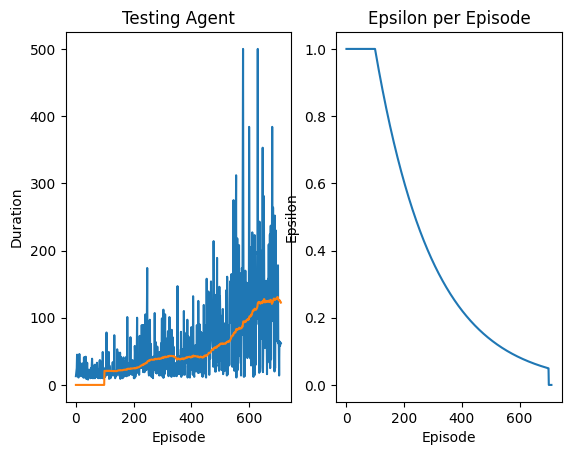

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 711 Duration 60 steps | epsilon 0.0


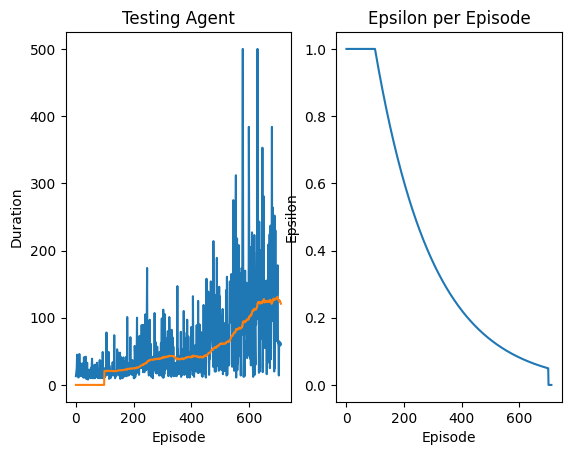

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 712 Duration 57 steps | epsilon 0.0


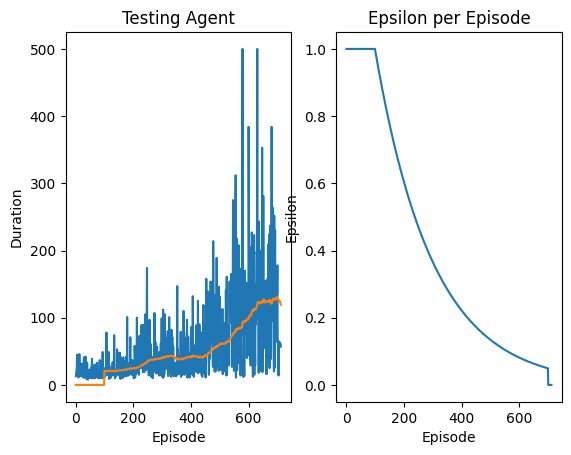

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 713 Duration 11 steps | epsilon 0.0


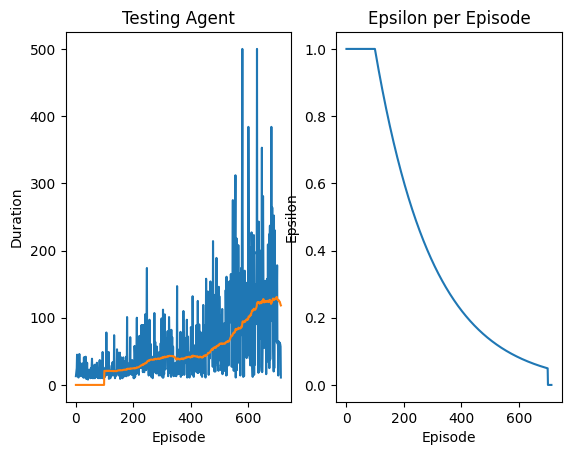

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 714 Duration 54 steps | epsilon 0.0


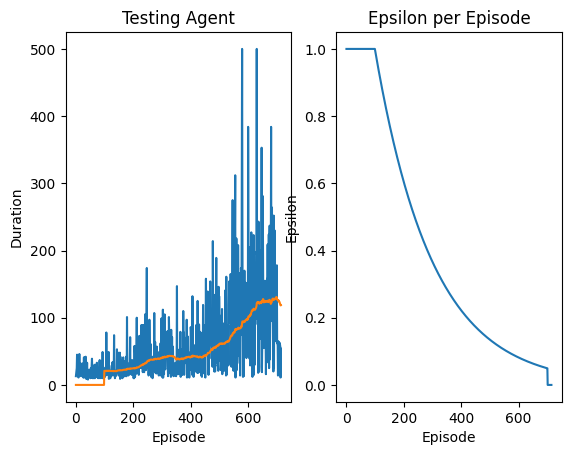

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 715 Duration 65 steps | epsilon 0.0


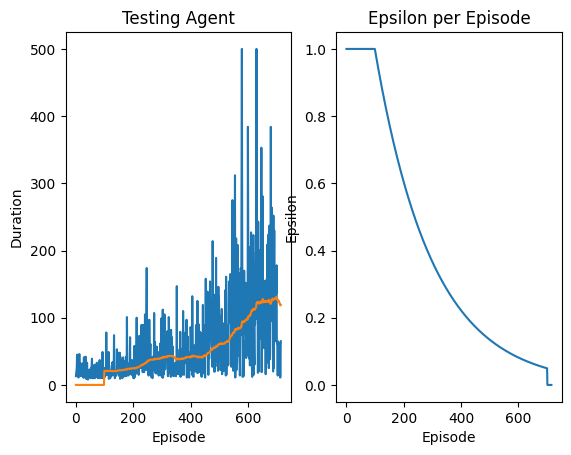

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 716 Duration 59 steps | epsilon 0.0


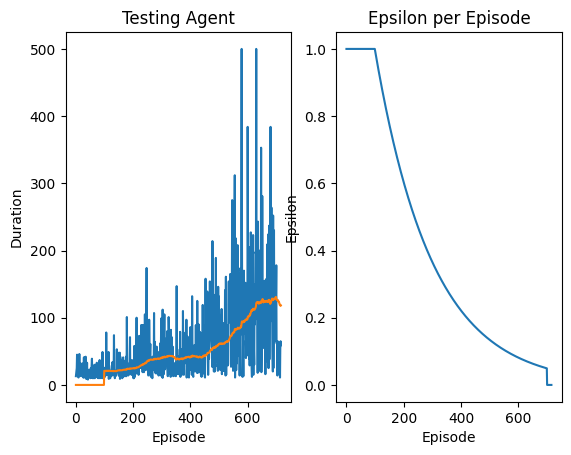

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 717 Duration 60 steps | epsilon 0.0


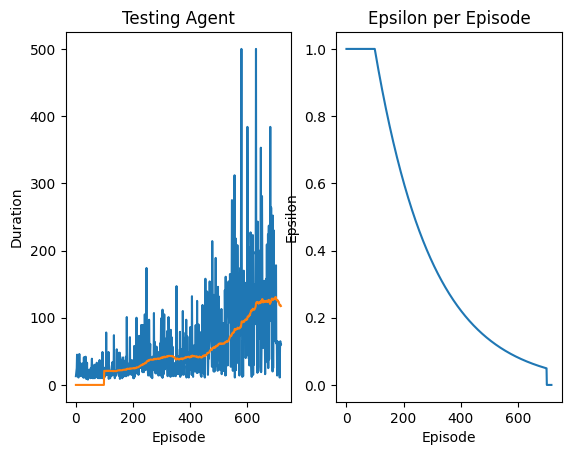

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 718 Duration 61 steps | epsilon 0.0


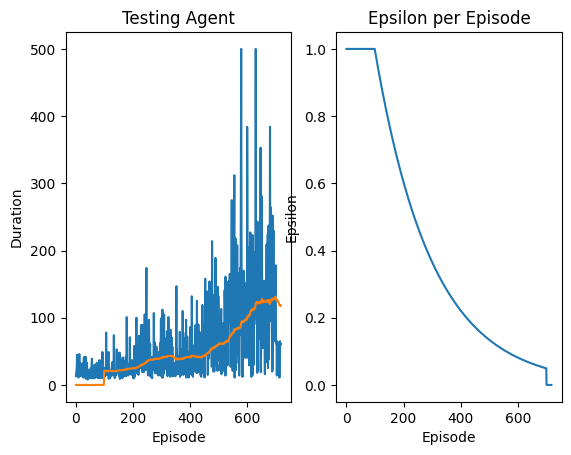

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 719 Duration 62 steps | epsilon 0.0


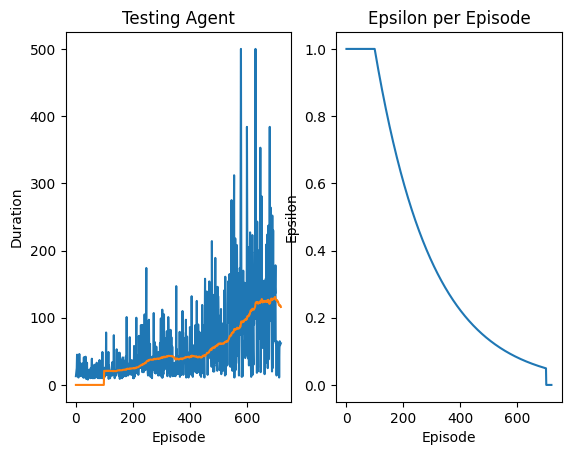

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 720 Duration 61 steps | epsilon 0.0


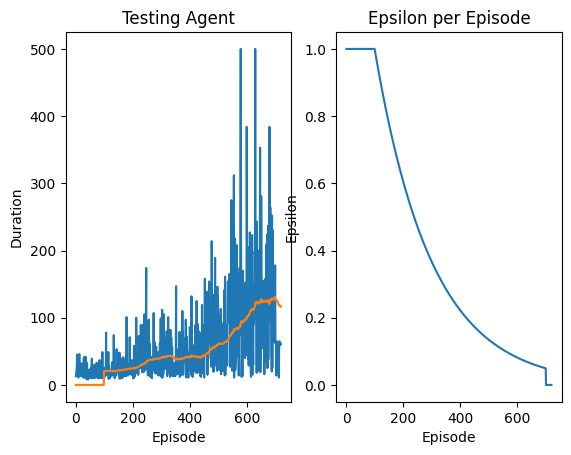

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 721 Duration 63 steps | epsilon 0.0


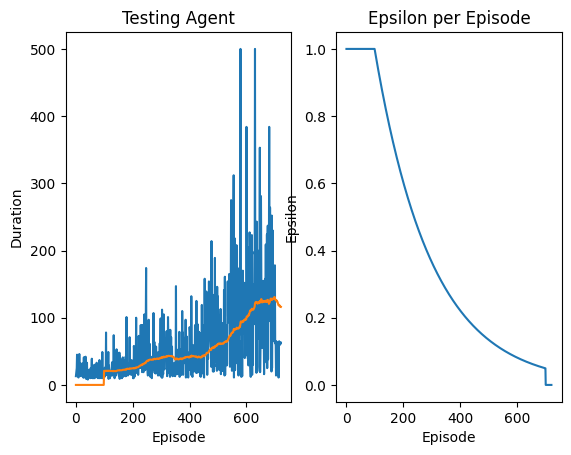

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 722 Duration 59 steps | epsilon 0.0


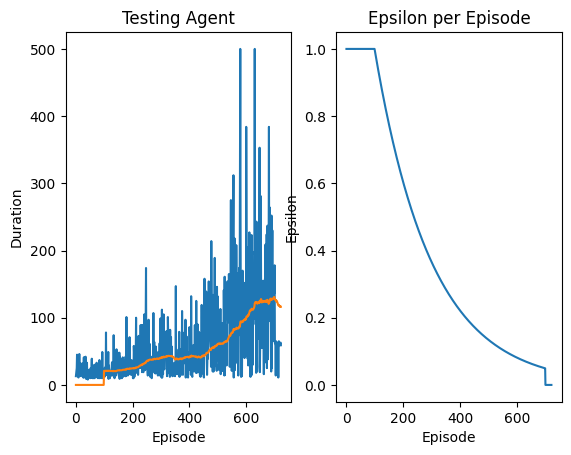

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 723 Duration 58 steps | epsilon 0.0


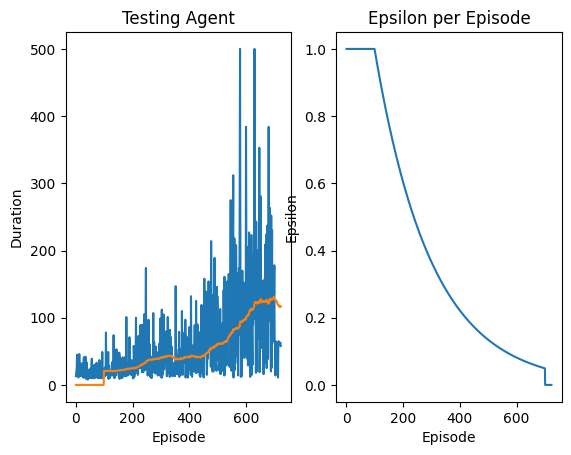

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 724 Duration 13 steps | epsilon 0.0


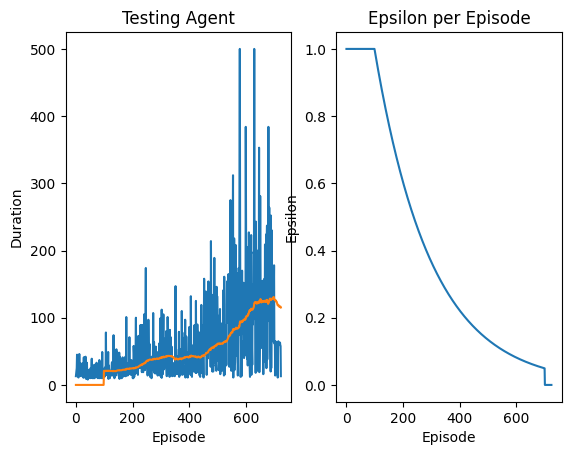

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 725 Duration 64 steps | epsilon 0.0


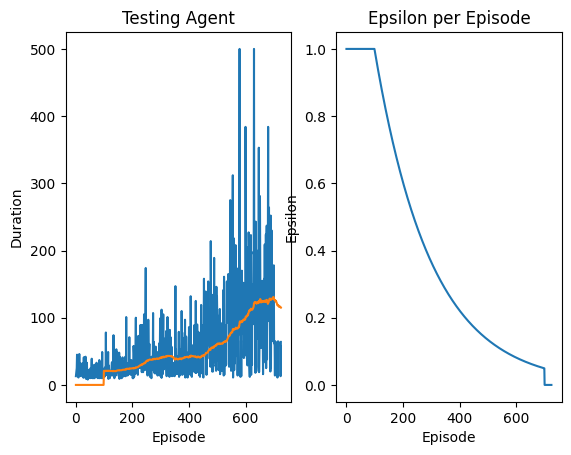

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 726 Duration 62 steps | epsilon 0.0


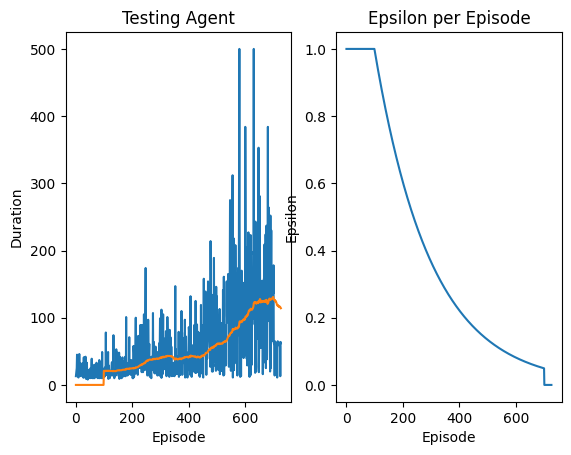

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 727 Duration 13 steps | epsilon 0.0


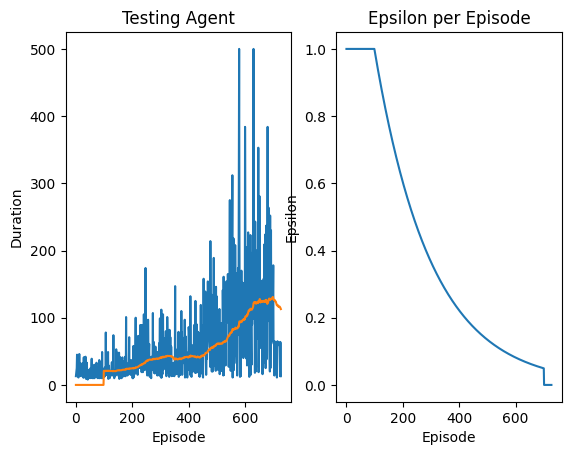

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 728 Duration 57 steps | epsilon 0.0


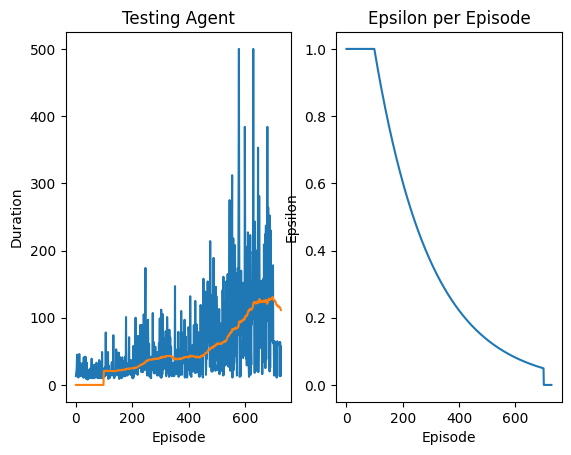

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 729 Duration 60 steps | epsilon 0.0


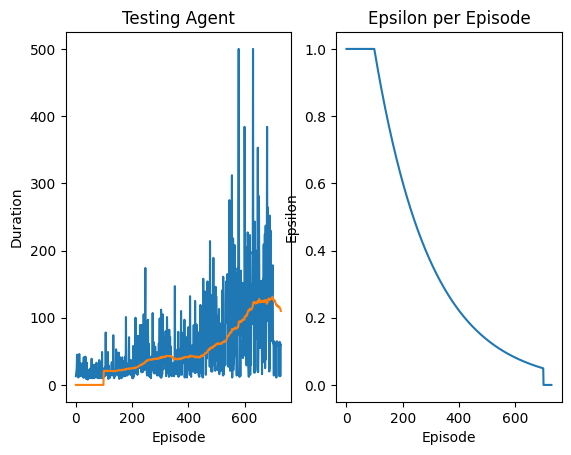

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 730 Duration 58 steps | epsilon 0.0


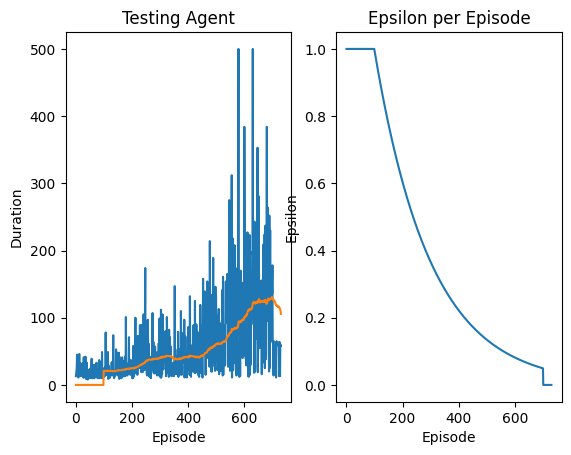

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 731 Duration 58 steps | epsilon 0.0


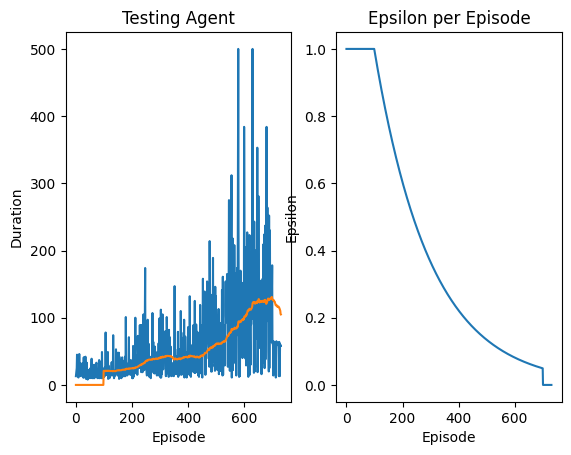

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 732 Duration 11 steps | epsilon 0.0


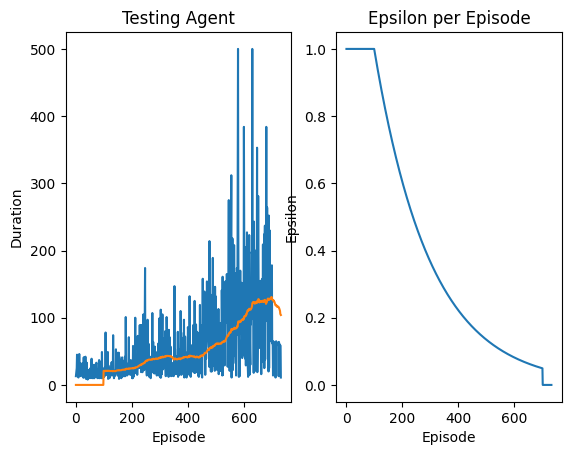

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 733 Duration 14 steps | epsilon 0.0


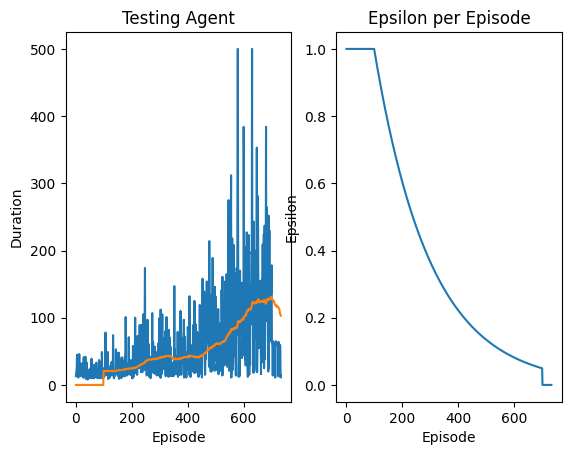

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 734 Duration 69 steps | epsilon 0.0


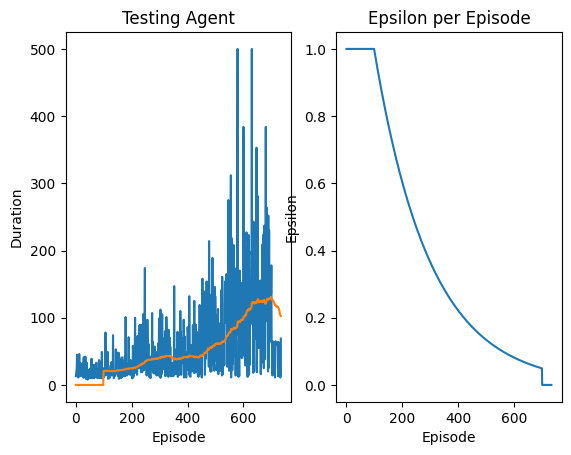

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 735 Duration 62 steps | epsilon 0.0


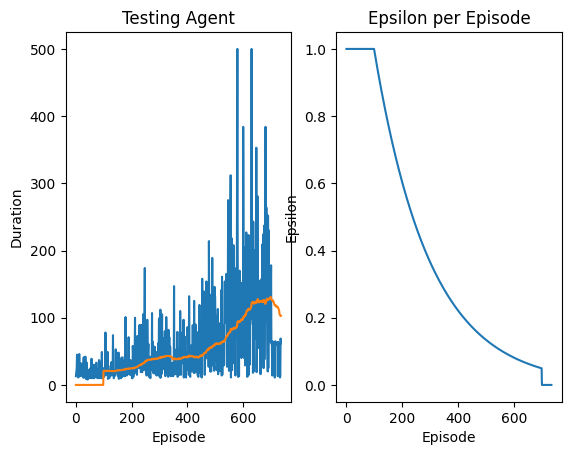

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 736 Duration 65 steps | epsilon 0.0


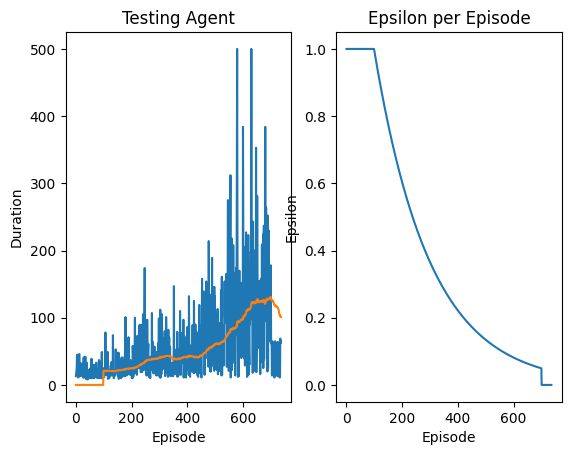

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 737 Duration 60 steps | epsilon 0.0


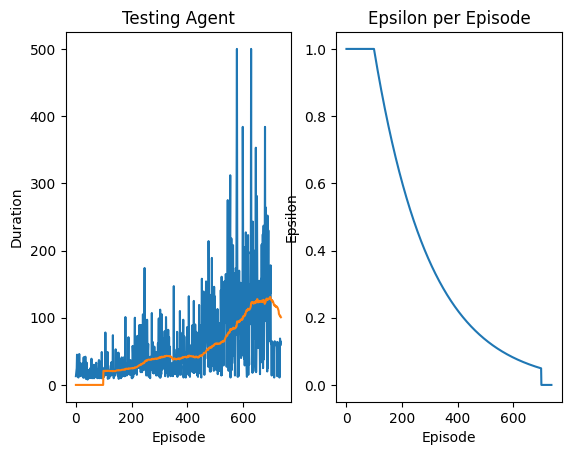

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 738 Duration 69 steps | epsilon 0.0


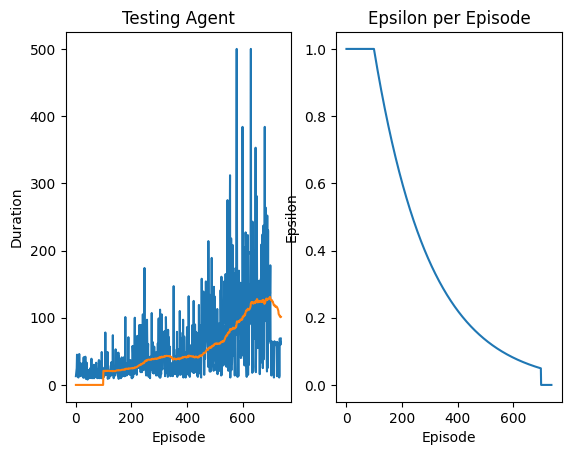

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 739 Duration 62 steps | epsilon 0.0


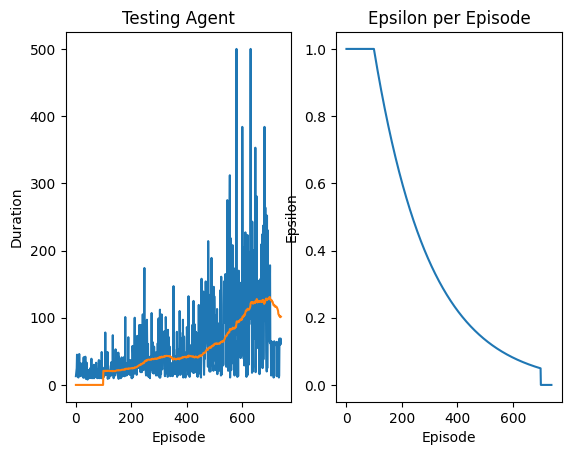

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 740 Duration 12 steps | epsilon 0.0


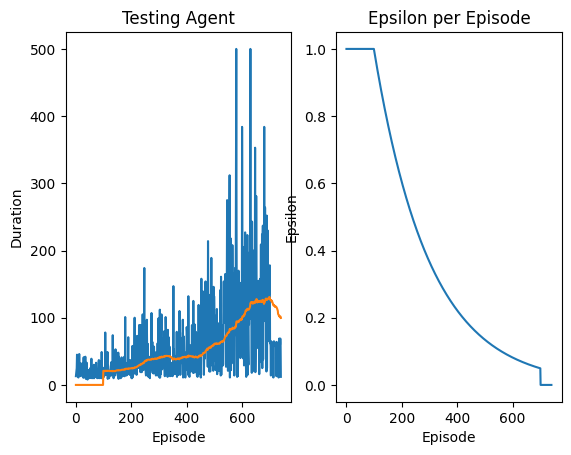

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 741 Duration 63 steps | epsilon 0.0


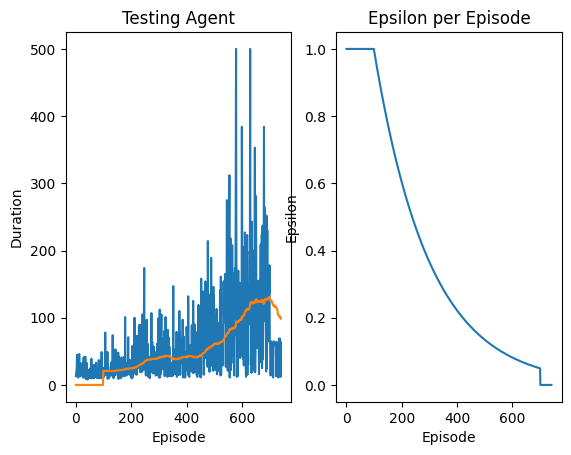

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 742 Duration 59 steps | epsilon 0.0


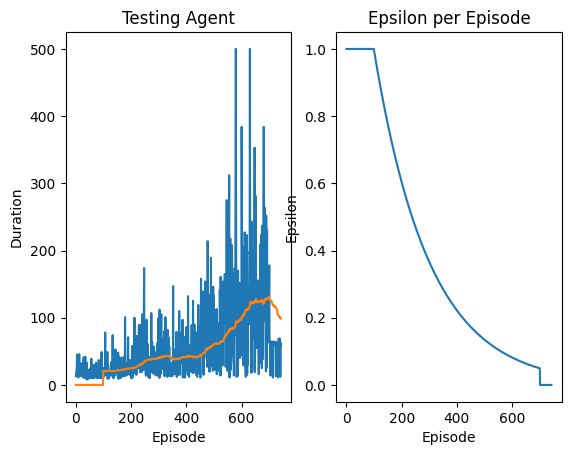

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 743 Duration 11 steps | epsilon 0.0


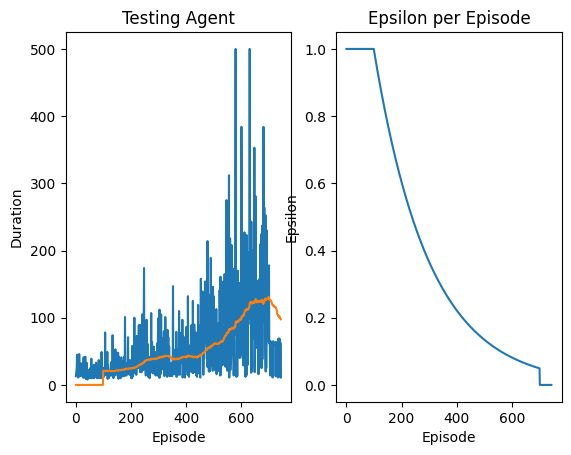

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 744 Duration 65 steps | epsilon 0.0


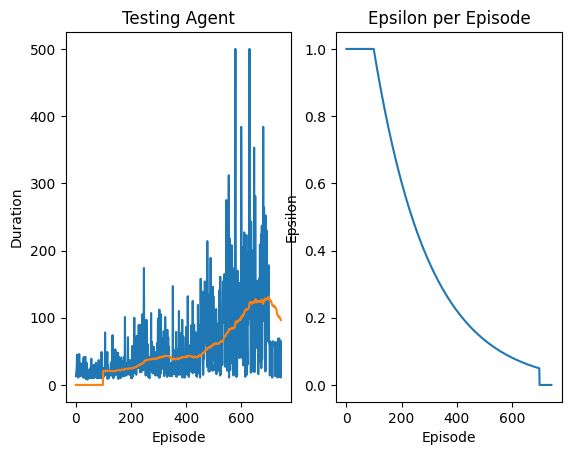

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 745 Duration 13 steps | epsilon 0.0


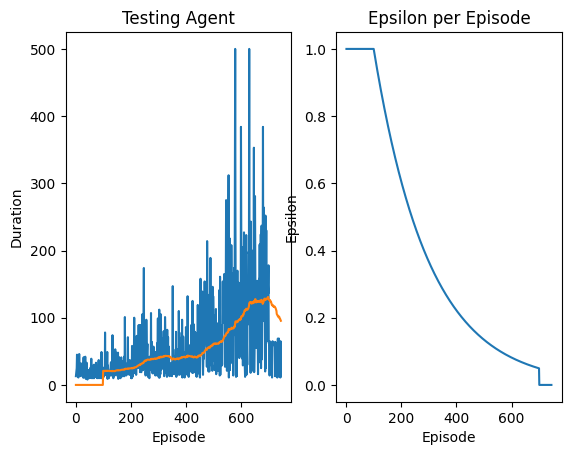

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 746 Duration 63 steps | epsilon 0.0


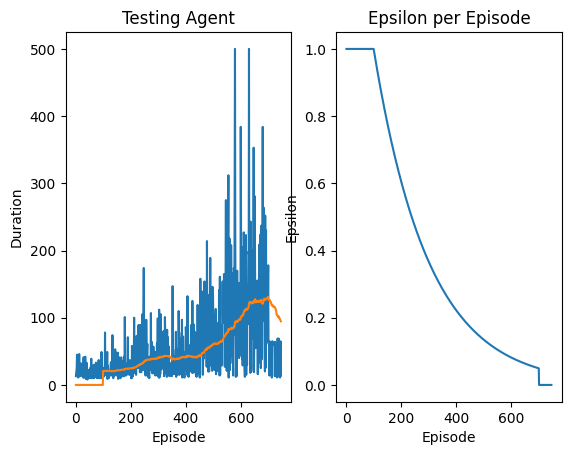

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 747 Duration 13 steps | epsilon 0.0


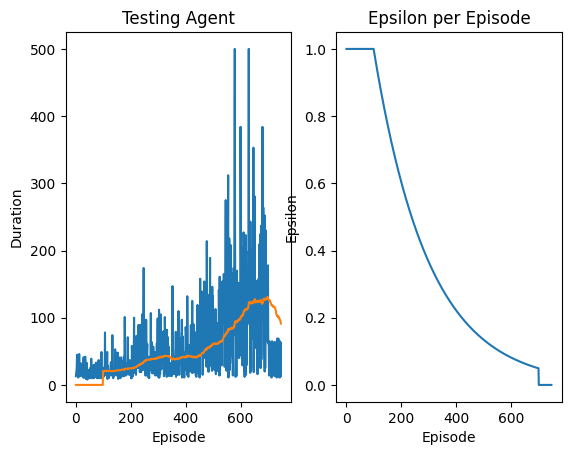

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 748 Duration 60 steps | epsilon 0.0


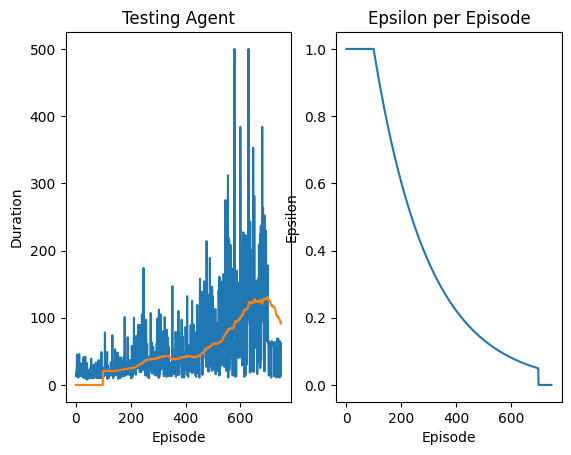

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 749 Duration 58 steps | epsilon 0.0


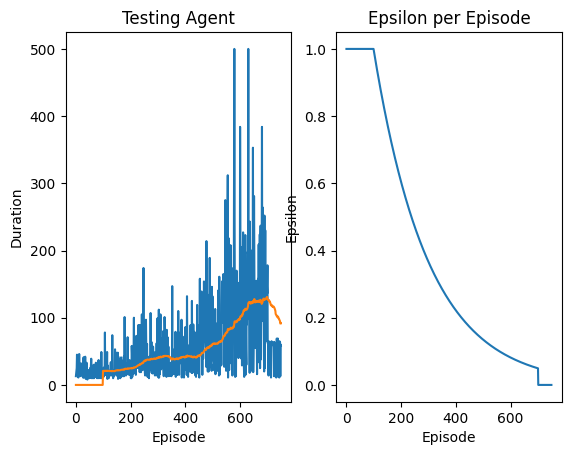

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 750 Duration 59 steps | epsilon 0.0


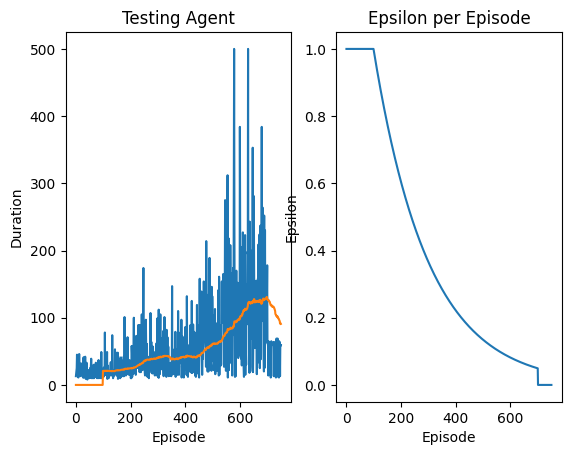

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 751 Duration 64 steps | epsilon 0.0


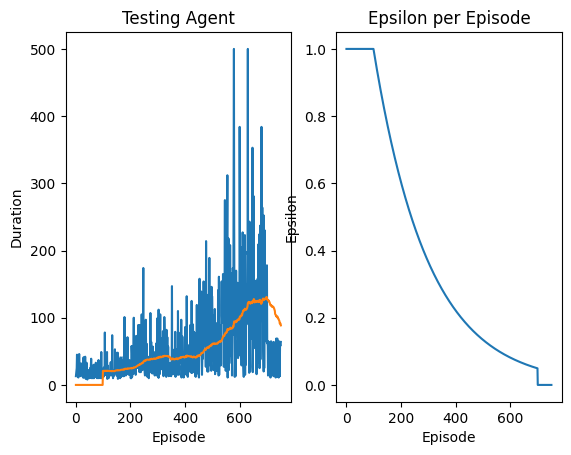

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 752 Duration 63 steps | epsilon 0.0


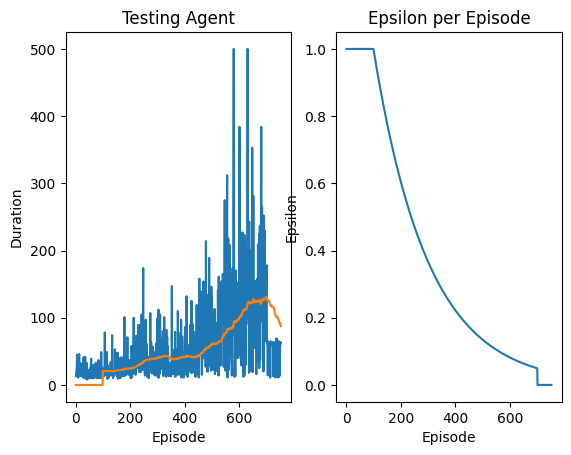

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 753 Duration 63 steps | epsilon 0.0


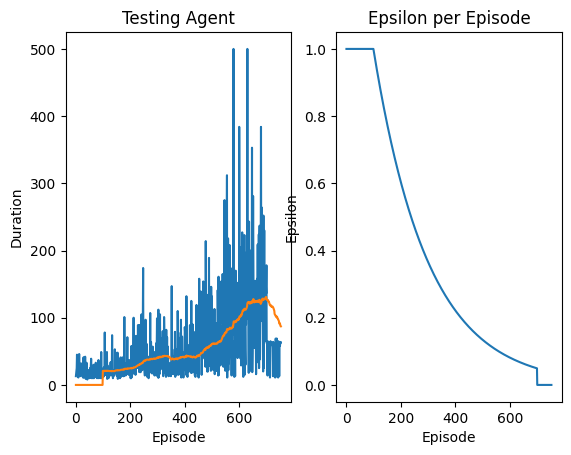

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 754 Duration 56 steps | epsilon 0.0


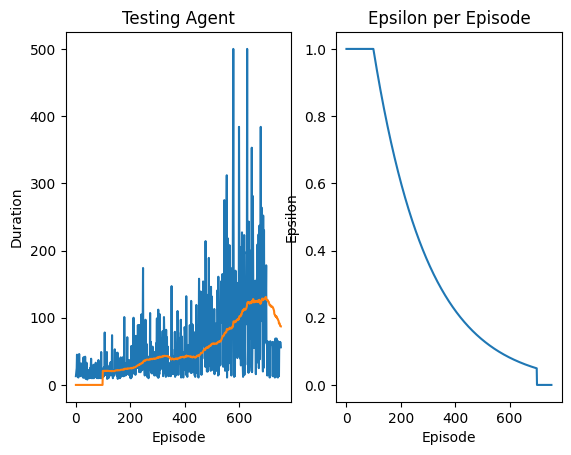

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 755 Duration 66 steps | epsilon 0.0


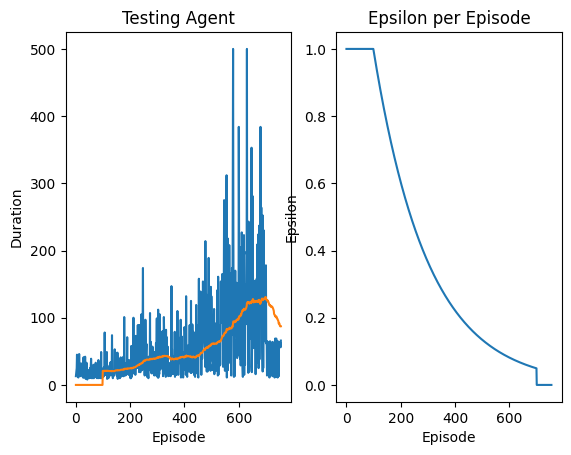

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 756 Duration 62 steps | epsilon 0.0


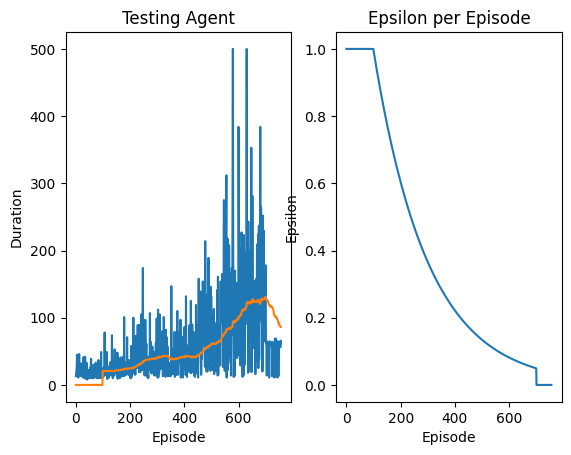

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 757 Duration 58 steps | epsilon 0.0


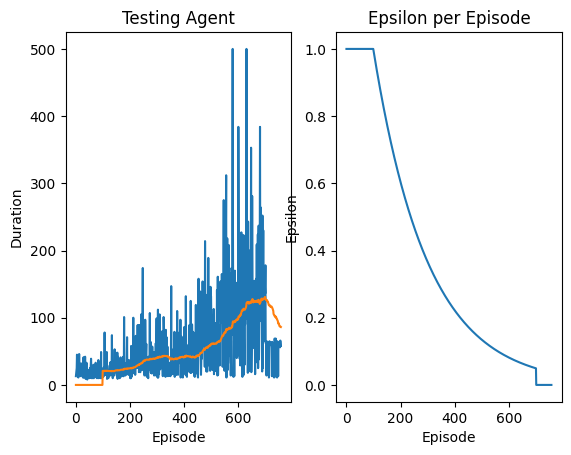

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 758 Duration 14 steps | epsilon 0.0


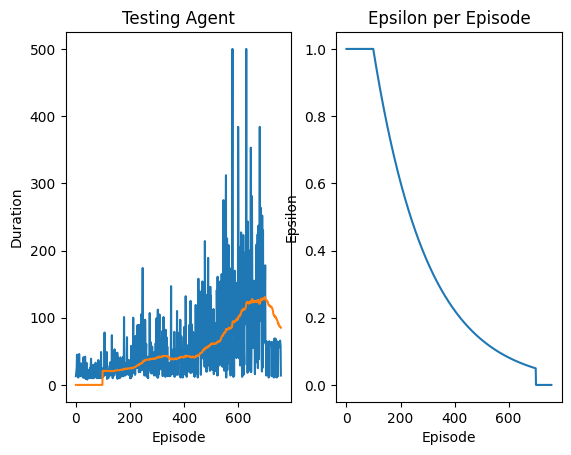

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 759 Duration 13 steps | epsilon 0.0


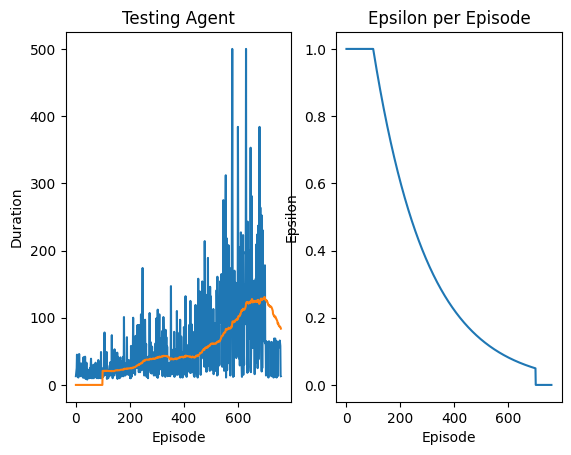

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 760 Duration 62 steps | epsilon 0.0


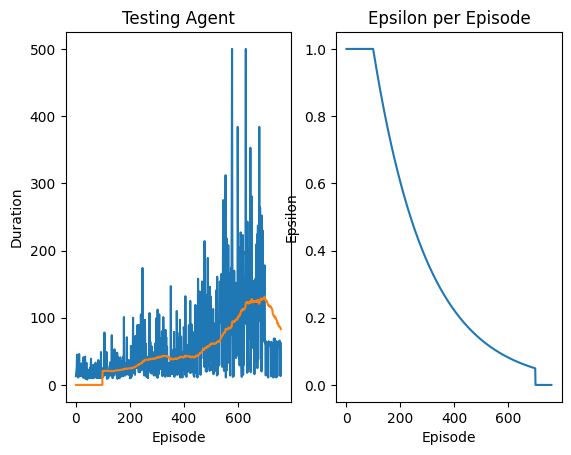

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 761 Duration 62 steps | epsilon 0.0


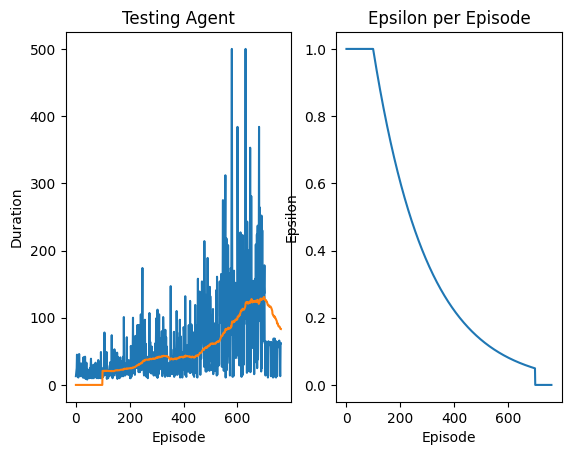

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 762 Duration 14 steps | epsilon 0.0


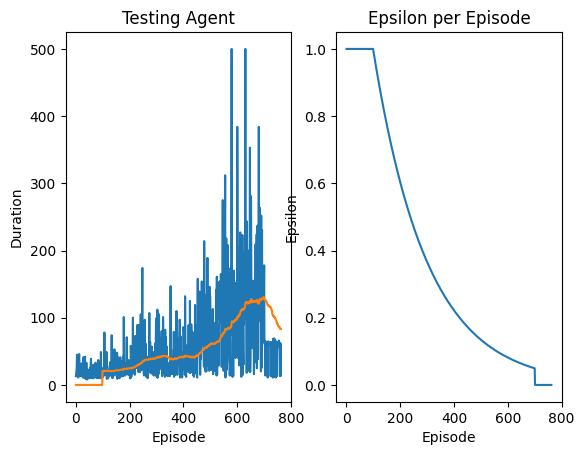

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 763 Duration 69 steps | epsilon 0.0


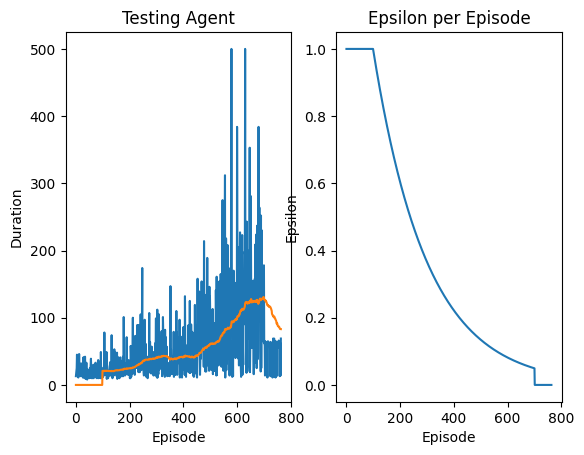

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 764 Duration 67 steps | epsilon 0.0


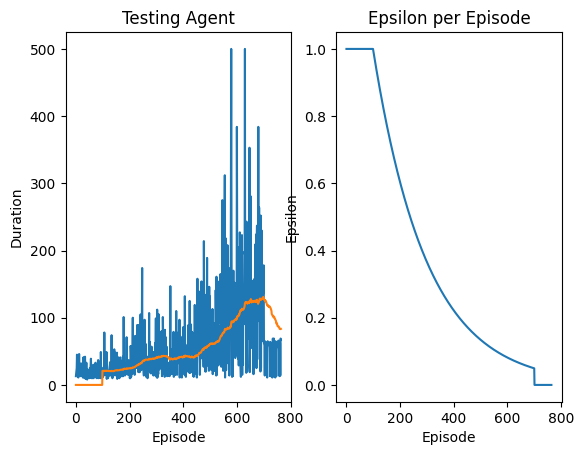

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 765 Duration 10 steps | epsilon 0.0


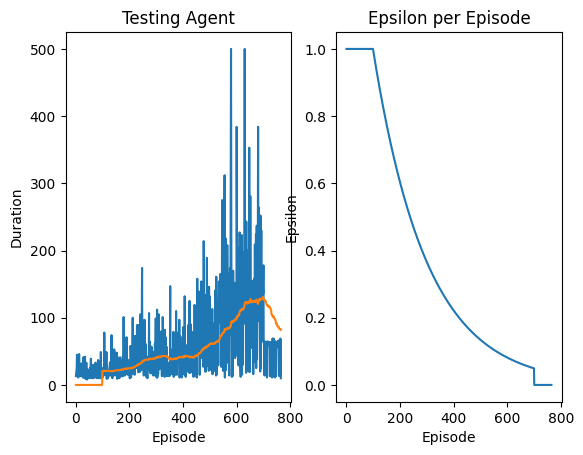

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 766 Duration 60 steps | epsilon 0.0


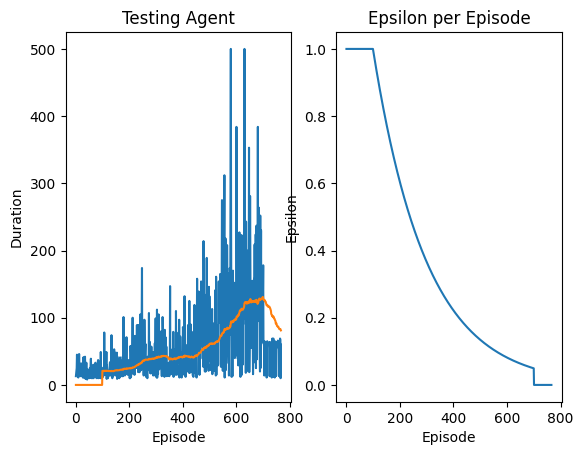

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 767 Duration 13 steps | epsilon 0.0


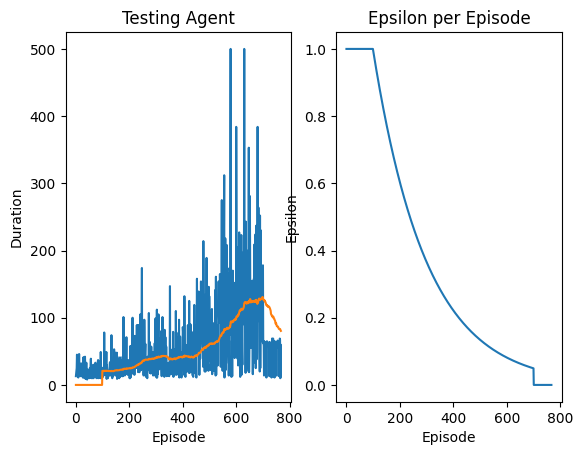

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 768 Duration 64 steps | epsilon 0.0


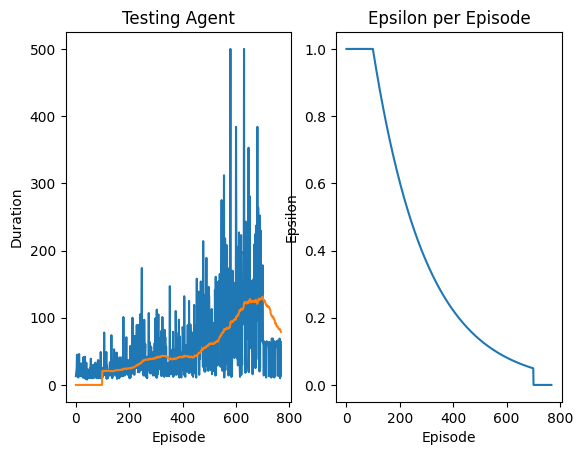

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 769 Duration 66 steps | epsilon 0.0


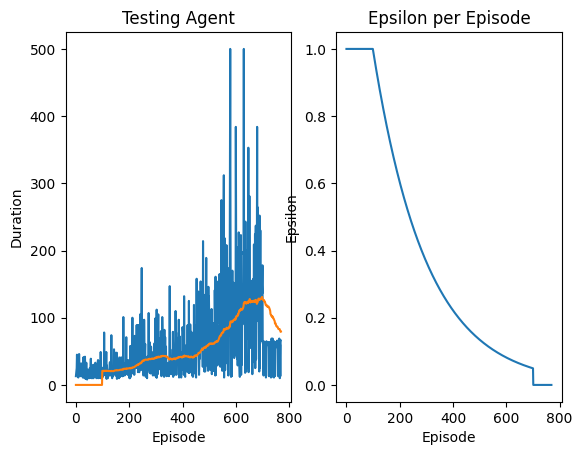

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 770 Duration 13 steps | epsilon 0.0


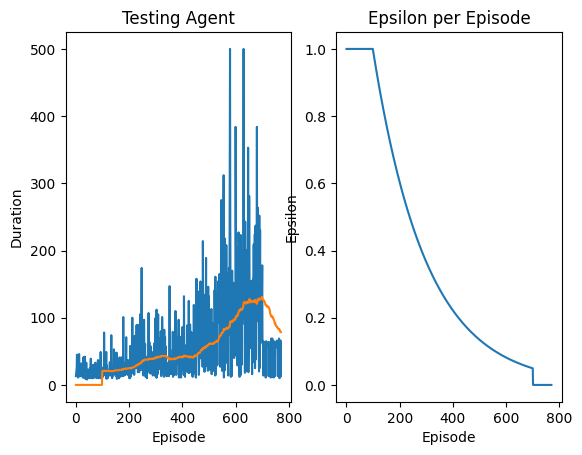

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 771 Duration 56 steps | epsilon 0.0


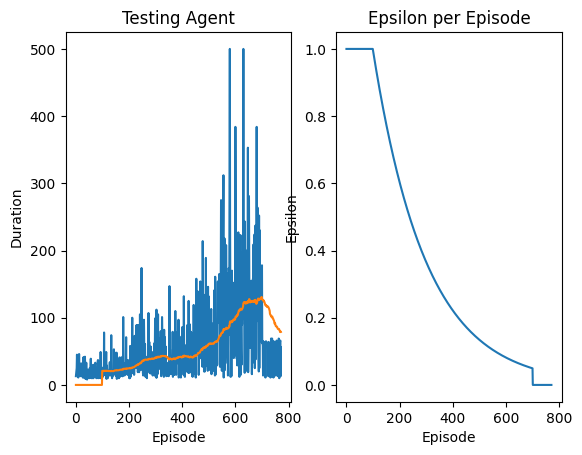

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 772 Duration 64 steps | epsilon 0.0


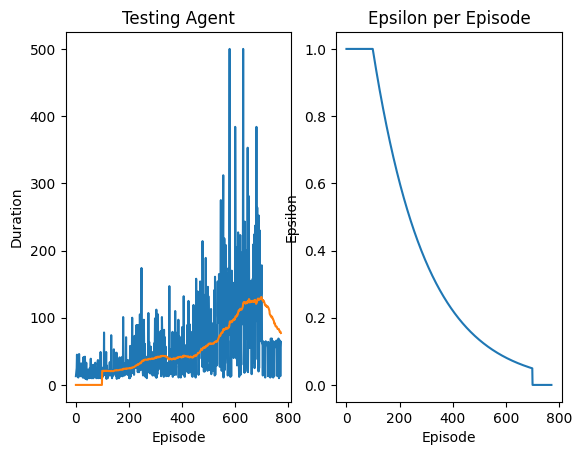

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 773 Duration 62 steps | epsilon 0.0


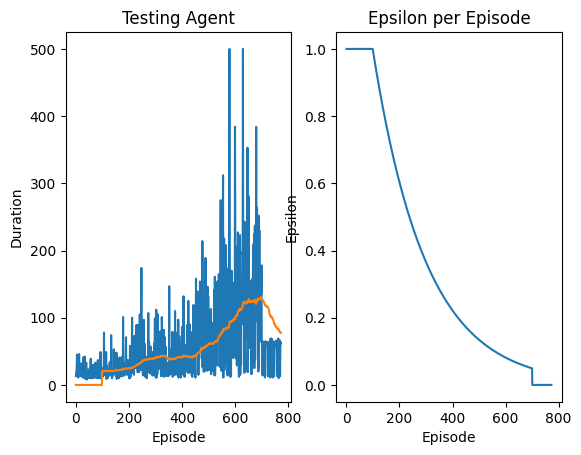

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 774 Duration 11 steps | epsilon 0.0


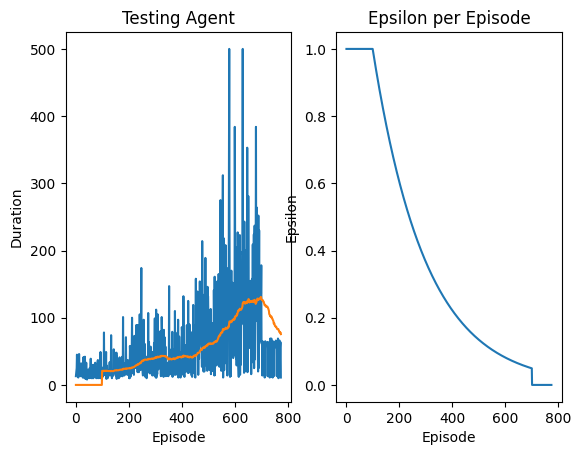

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 775 Duration 59 steps | epsilon 0.0


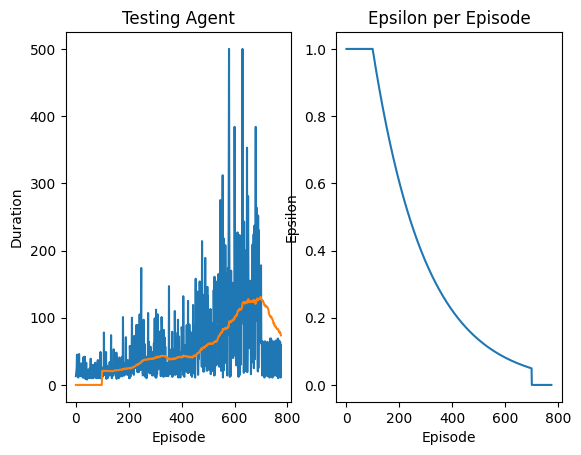

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 776 Duration 60 steps | epsilon 0.0


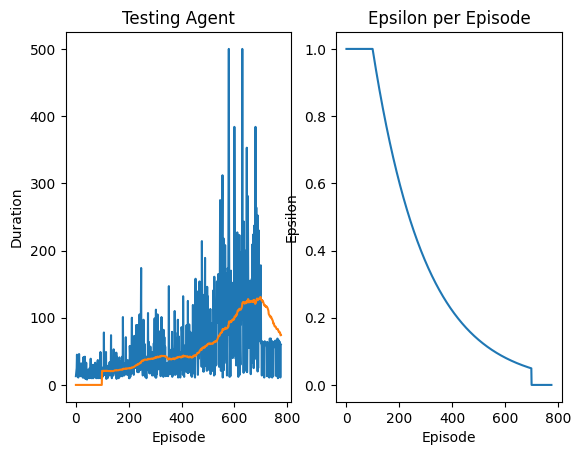

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 777 Duration 61 steps | epsilon 0.0


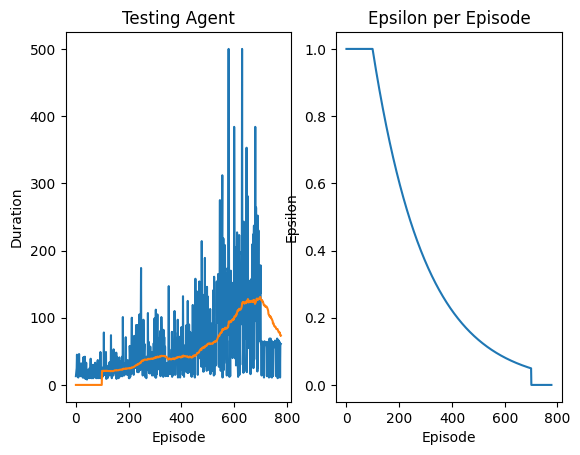

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 778 Duration 62 steps | epsilon 0.0


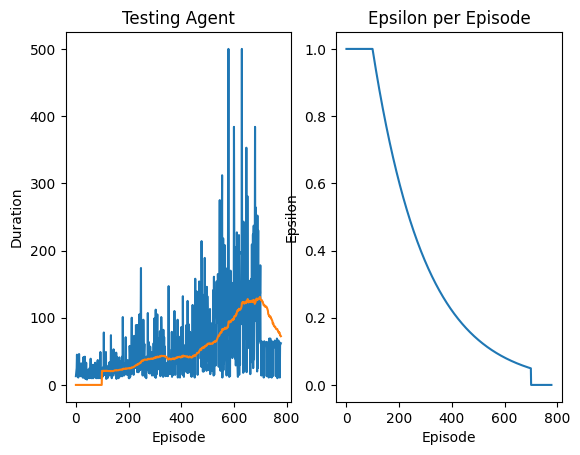

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 779 Duration 64 steps | epsilon 0.0


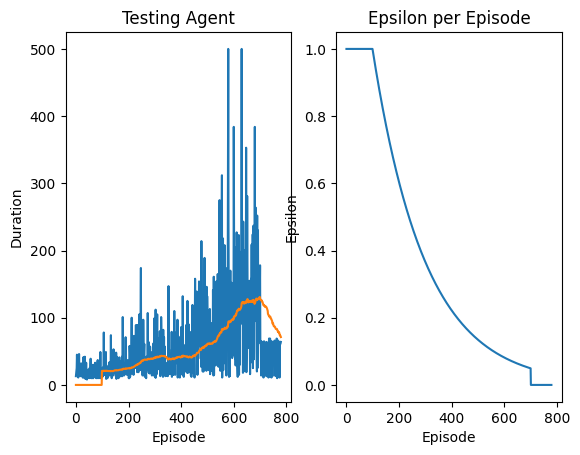

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 780 Duration 65 steps | epsilon 0.0


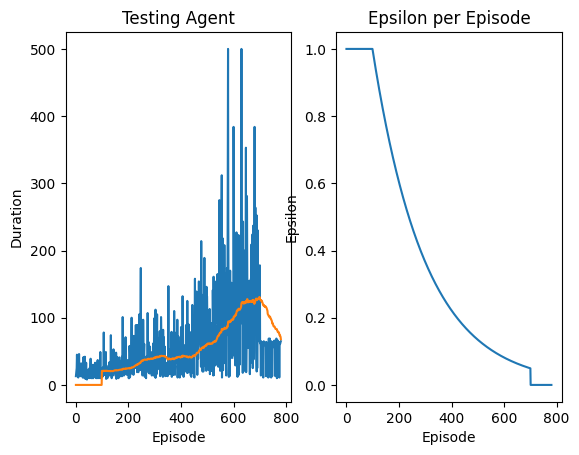

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 781 Duration 63 steps | epsilon 0.0


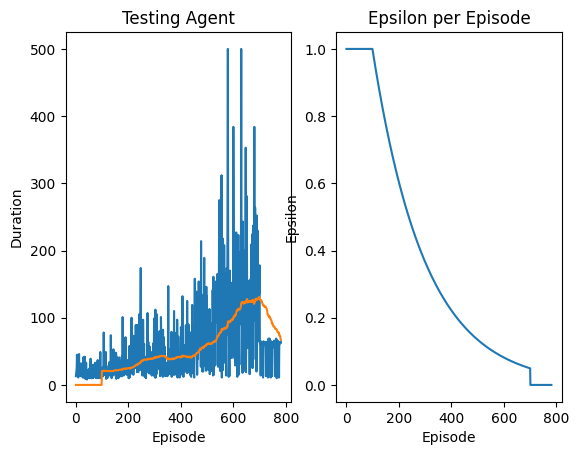

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 782 Duration 63 steps | epsilon 0.0


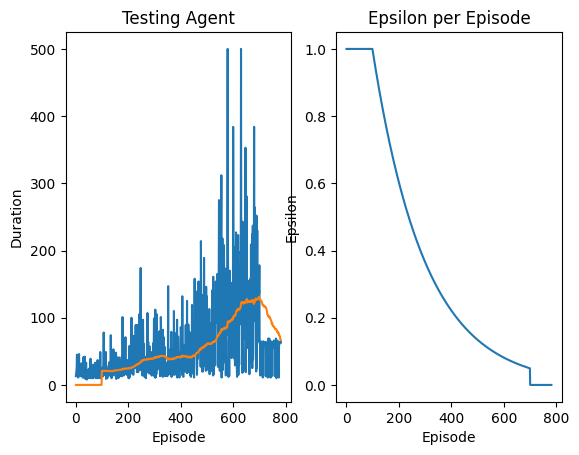

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 783 Duration 66 steps | epsilon 0.0


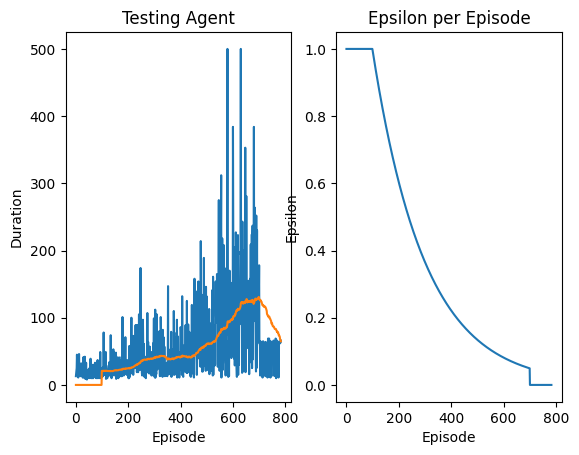

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 784 Duration 67 steps | epsilon 0.0


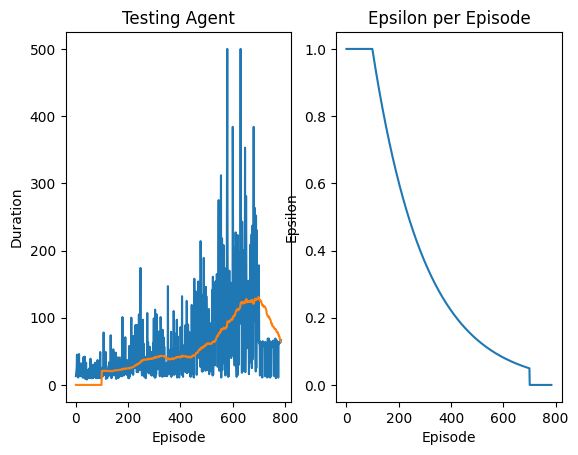

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 785 Duration 13 steps | epsilon 0.0


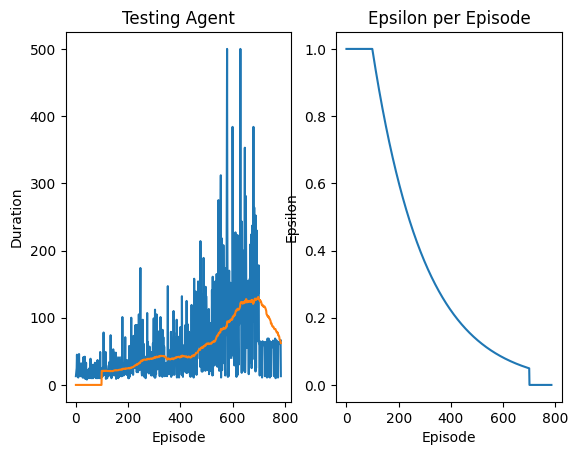

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 786 Duration 64 steps | epsilon 0.0


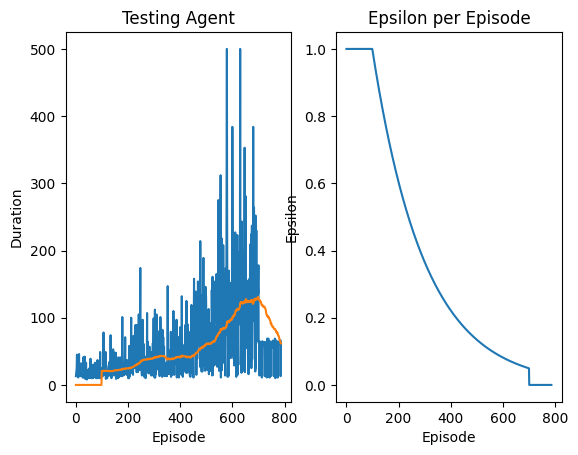

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 787 Duration 65 steps | epsilon 0.0


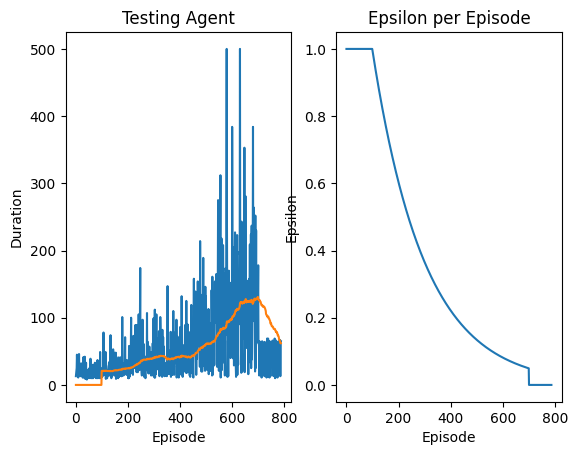

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 788 Duration 13 steps | epsilon 0.0


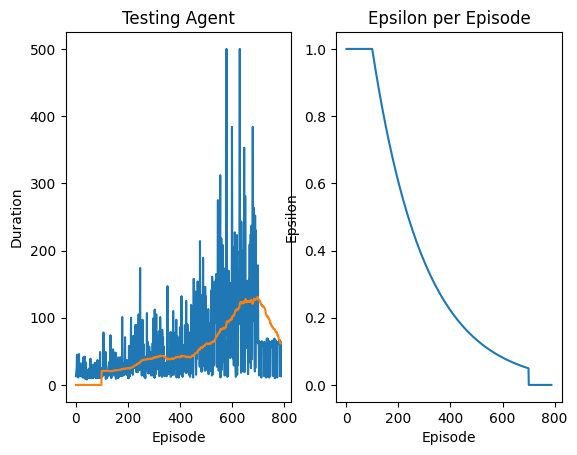

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 789 Duration 13 steps | epsilon 0.0


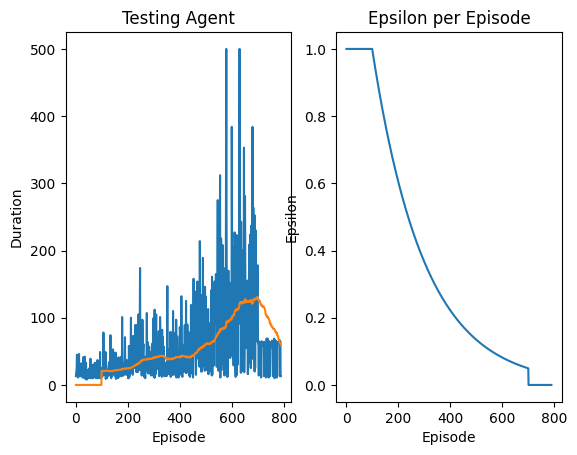

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 790 Duration 64 steps | epsilon 0.0


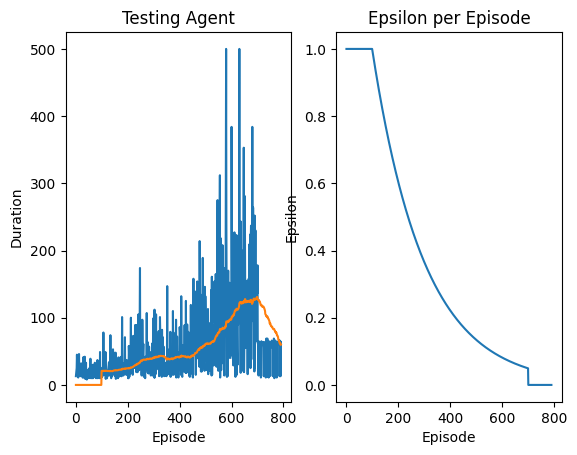

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 791 Duration 58 steps | epsilon 0.0


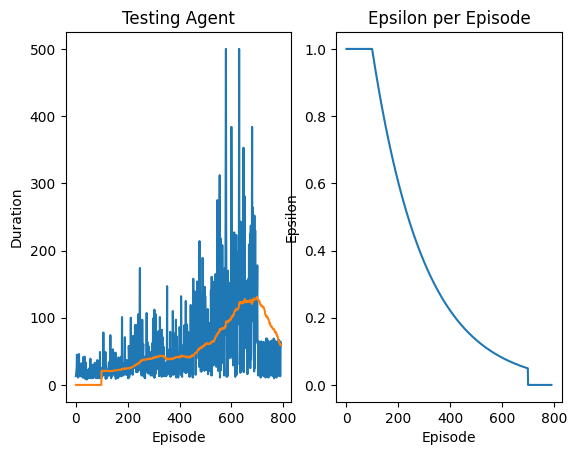

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 792 Duration 13 steps | epsilon 0.0


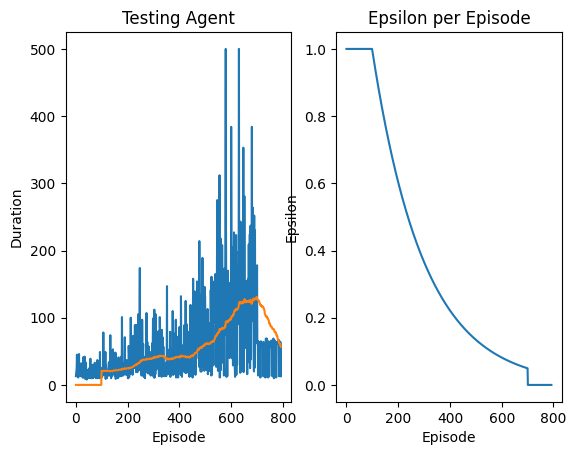

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 793 Duration 14 steps | epsilon 0.0


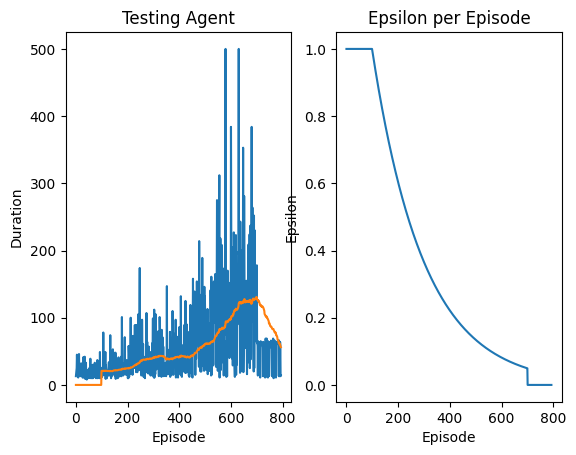

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 794 Duration 65 steps | epsilon 0.0


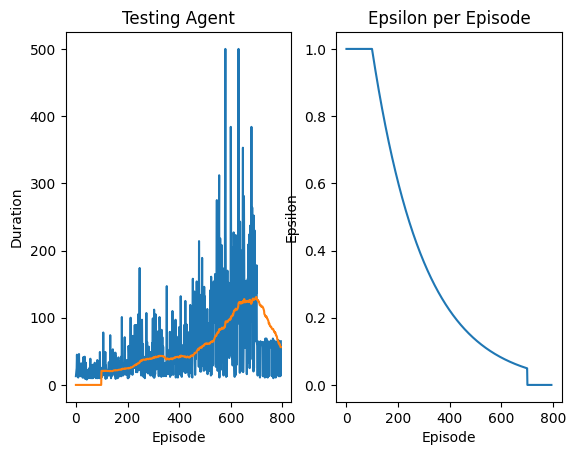

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 795 Duration 66 steps | epsilon 0.0


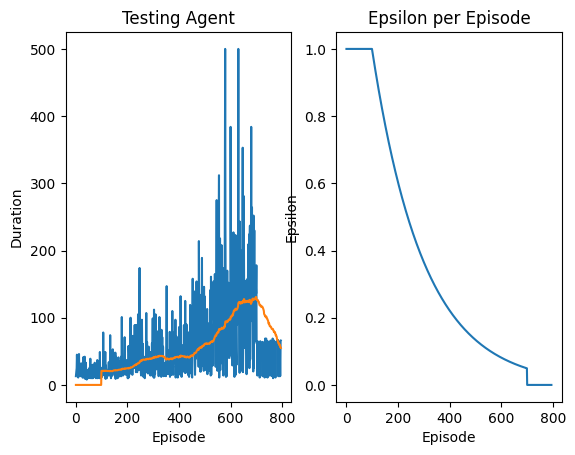

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 796 Duration 61 steps | epsilon 0.0


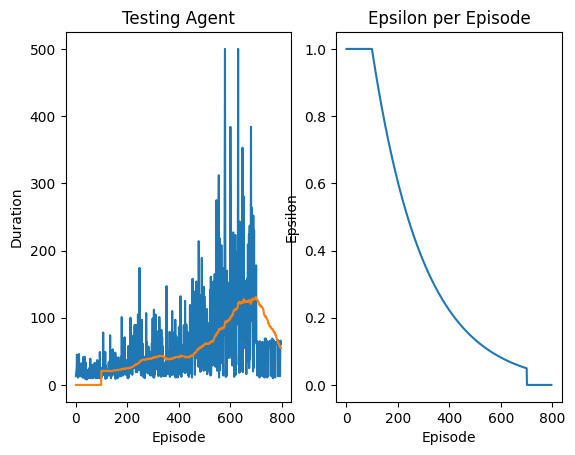

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 797 Duration 59 steps | epsilon 0.0


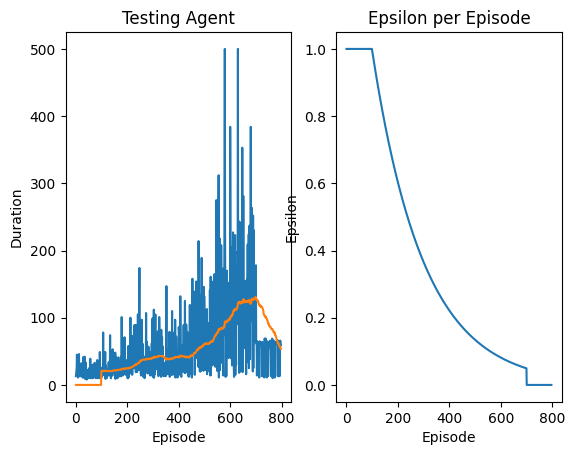

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 798 Duration 13 steps | epsilon 0.0


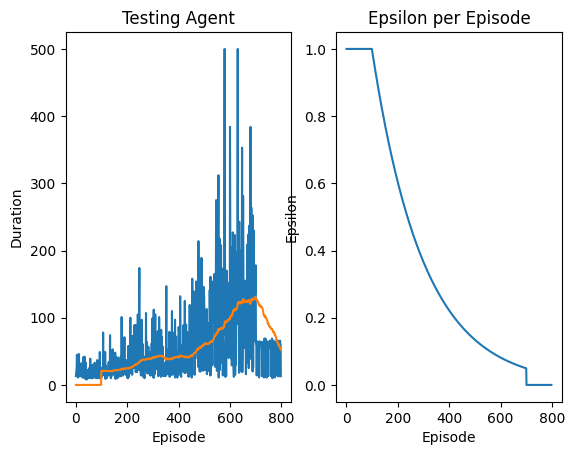

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 799 Duration 67 steps | epsilon 0.0


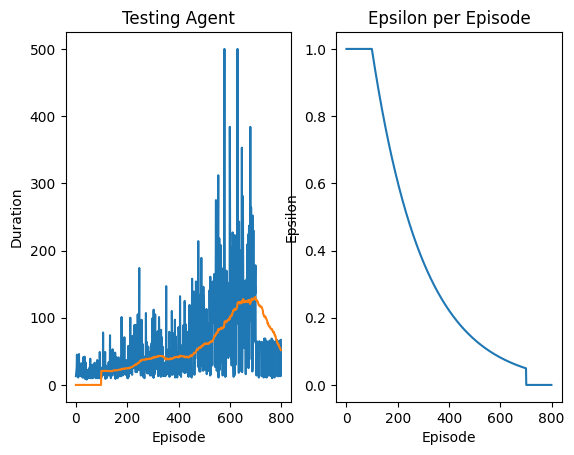

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 800 Duration 56 steps | epsilon 0.0


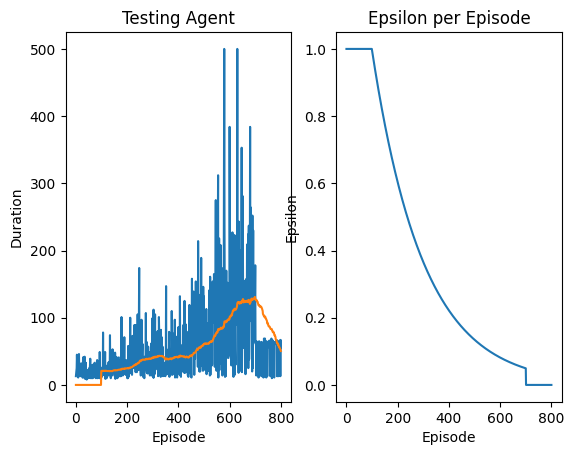

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 801 Duration 63 steps | epsilon 0.0


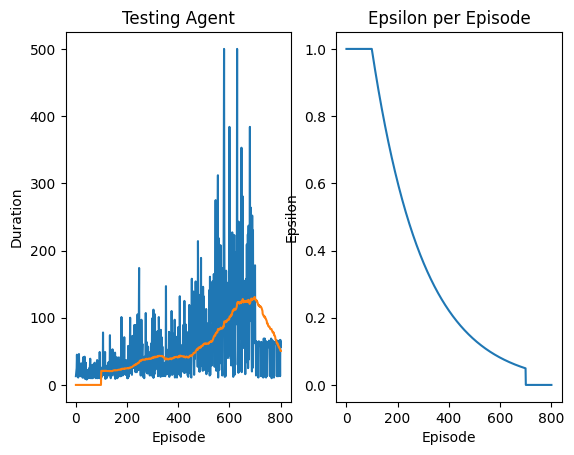

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 802 Duration 67 steps | epsilon 0.0


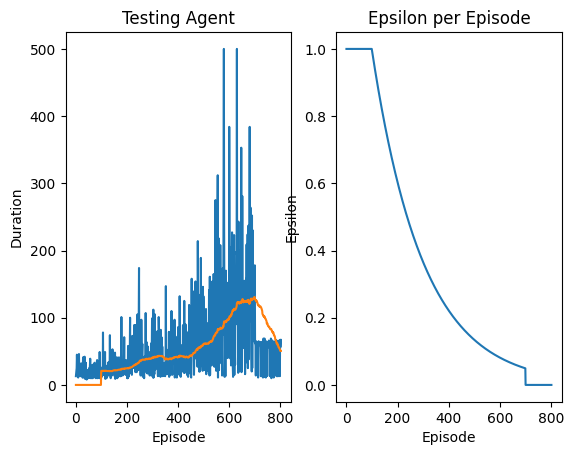

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 803 Duration 59 steps | epsilon 0.0


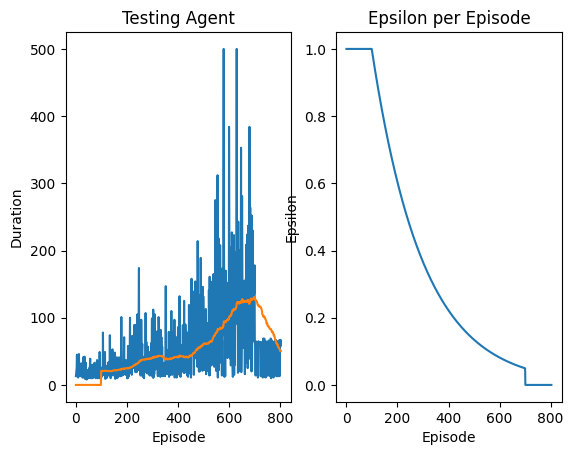

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 804 Duration 60 steps | epsilon 0.0


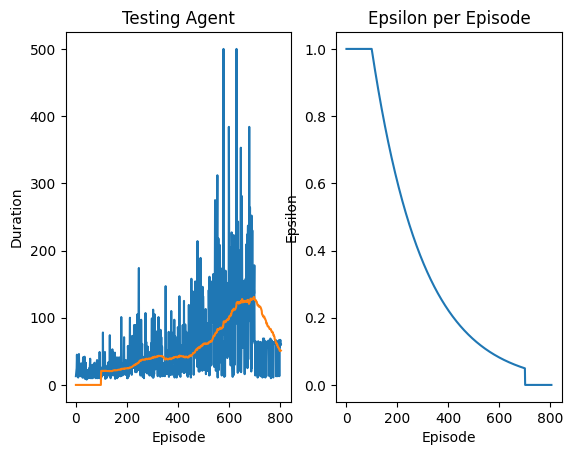

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 805 Duration 68 steps | epsilon 0.0


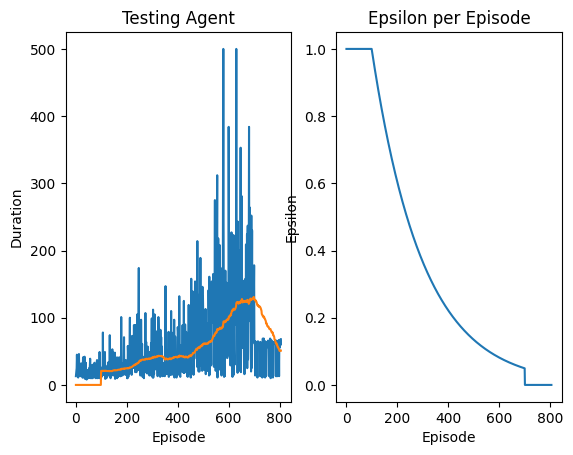

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 806 Duration 69 steps | epsilon 0.0


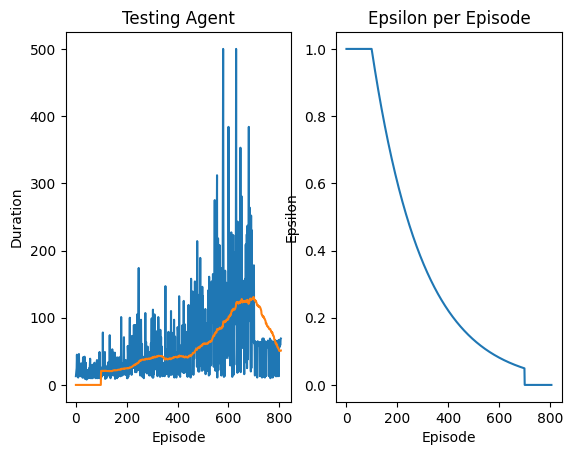

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 807 Duration 62 steps | epsilon 0.0


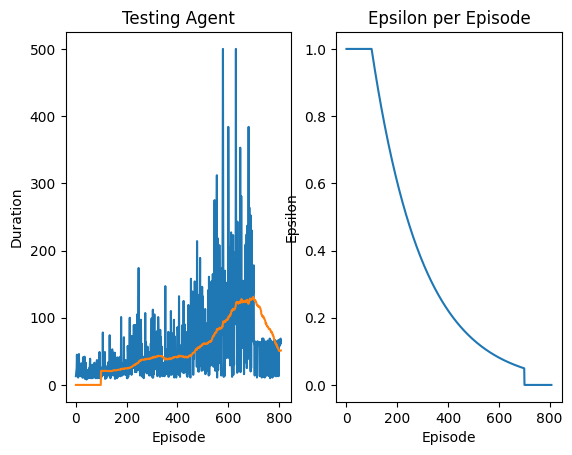

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 808 Duration 59 steps | epsilon 0.0


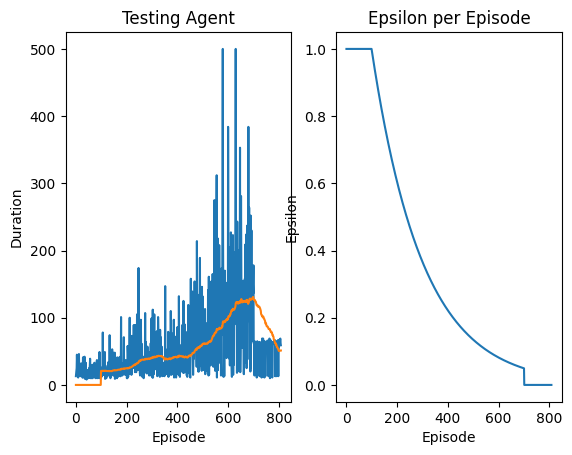

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 809 Duration 64 steps | epsilon 0.0


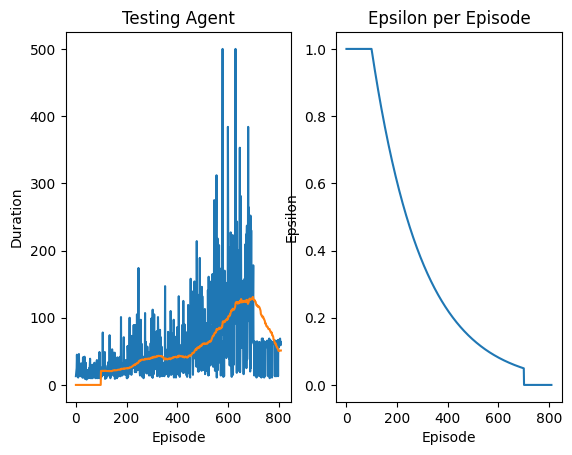

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 810 Duration 57 steps | epsilon 0.0


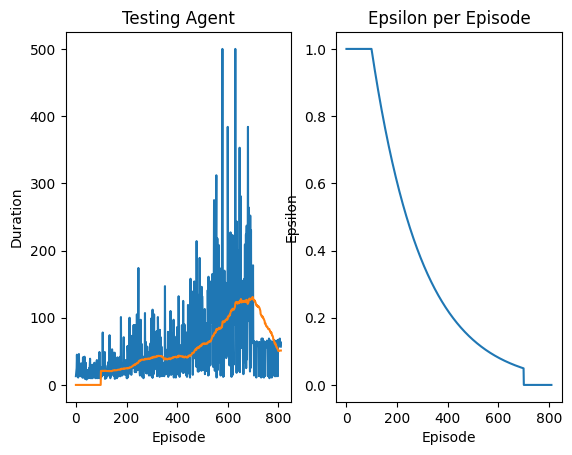

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 811 Duration 13 steps | epsilon 0.0


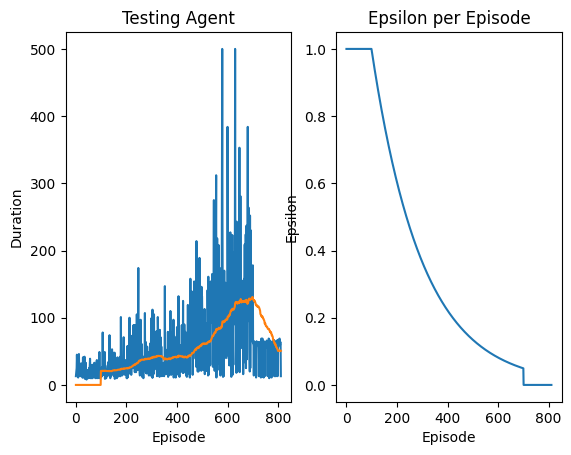

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 812 Duration 67 steps | epsilon 0.0


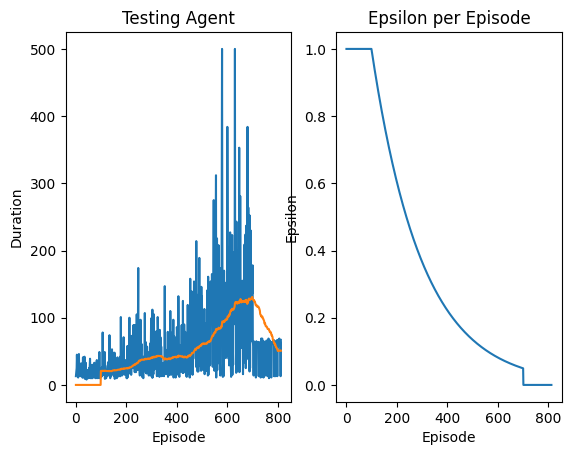

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 813 Duration 58 steps | epsilon 0.0


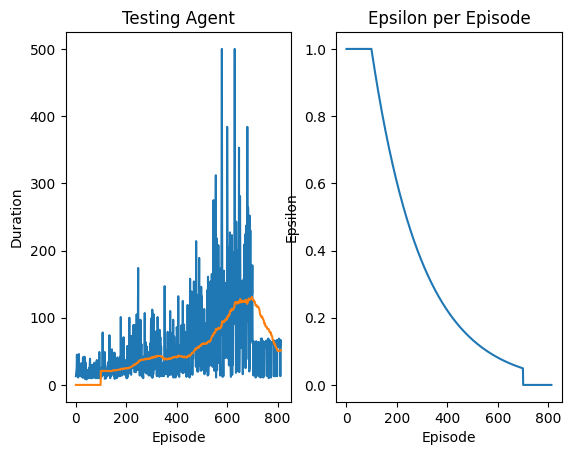

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 814 Duration 64 steps | epsilon 0.0


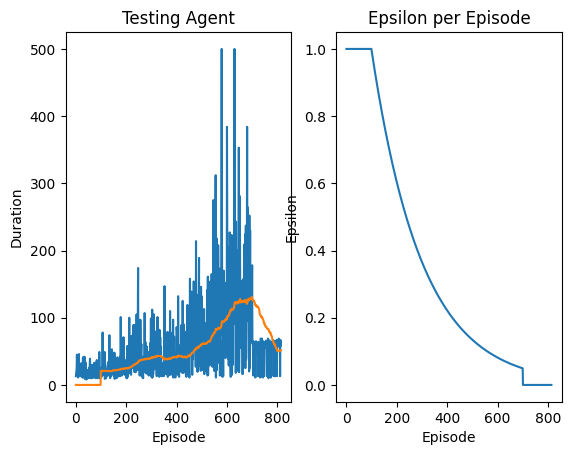

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 815 Duration 62 steps | epsilon 0.0


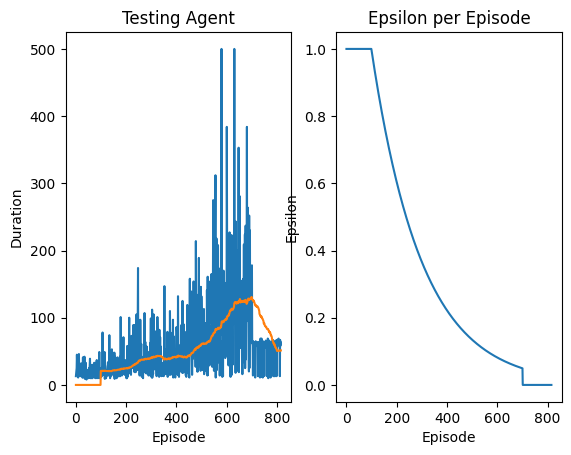

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 816 Duration 64 steps | epsilon 0.0


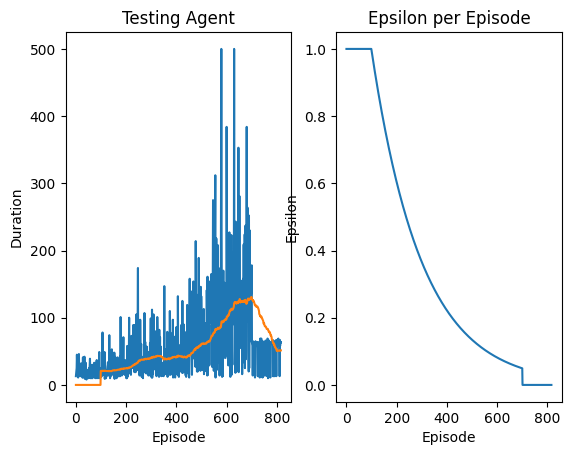

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 817 Duration 66 steps | epsilon 0.0


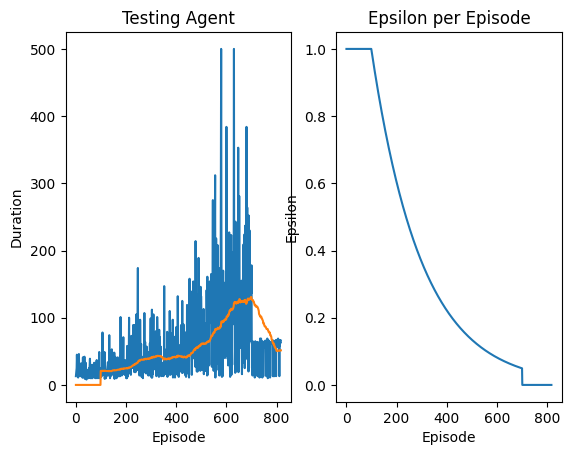

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 818 Duration 62 steps | epsilon 0.0


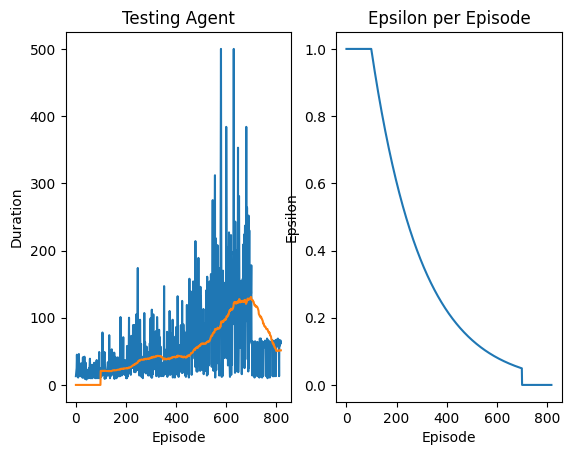

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 819 Duration 65 steps | epsilon 0.0


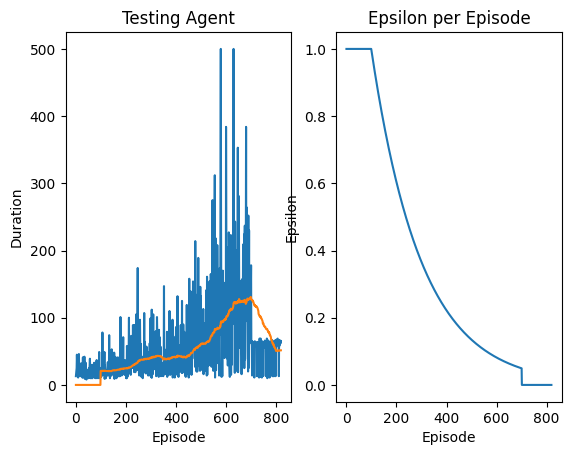

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 820 Duration 62 steps | epsilon 0.0


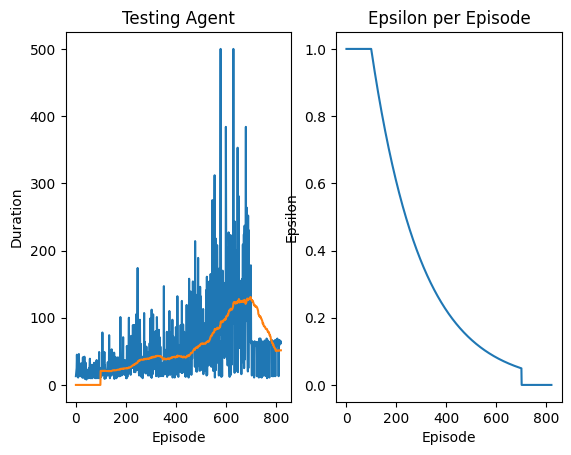

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 821 Duration 61 steps | epsilon 0.0


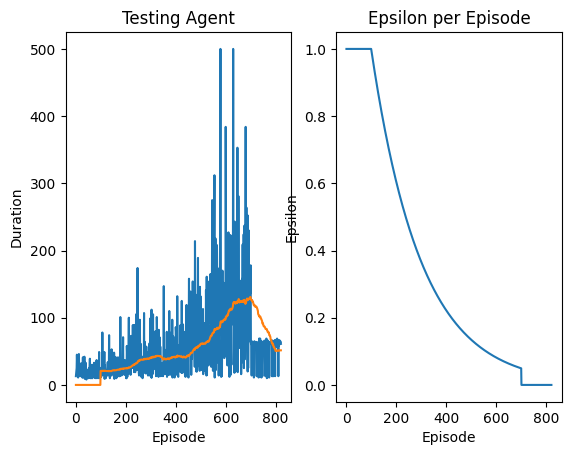

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 822 Duration 13 steps | epsilon 0.0


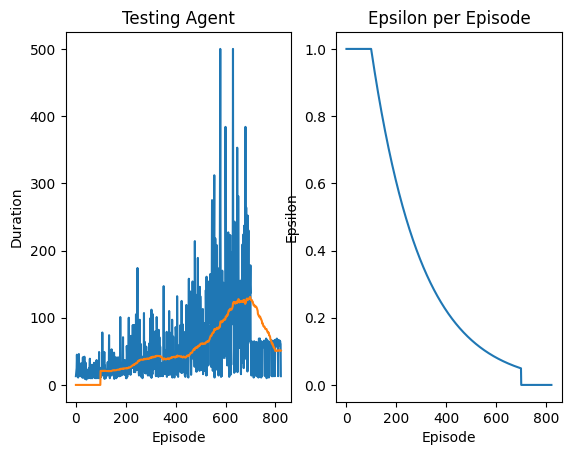

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 823 Duration 63 steps | epsilon 0.0


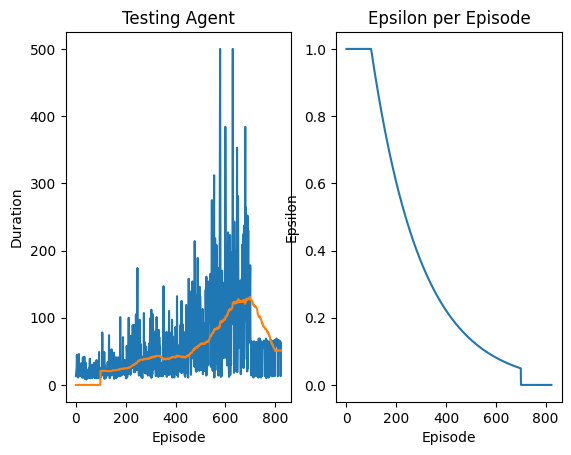

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 824 Duration 58 steps | epsilon 0.0


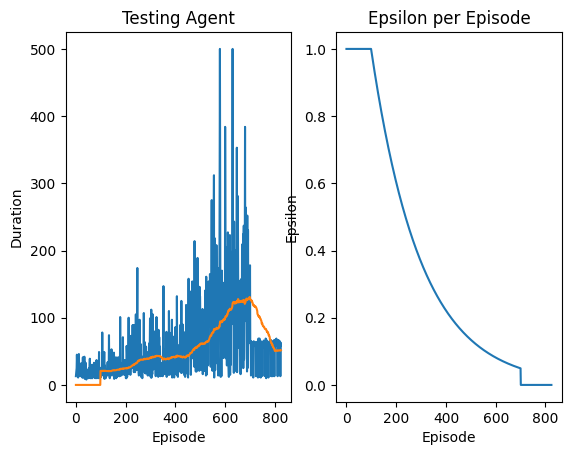

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 825 Duration 61 steps | epsilon 0.0


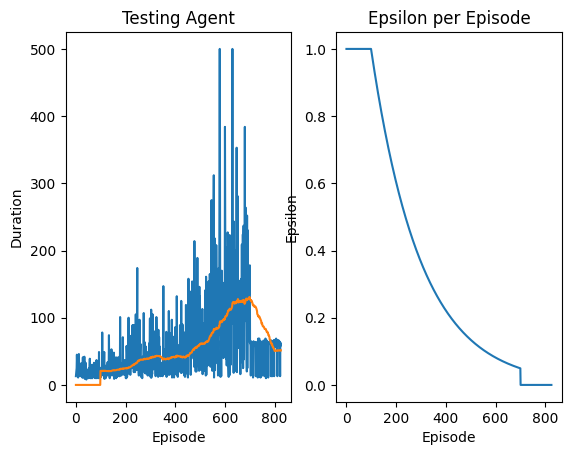

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 826 Duration 58 steps | epsilon 0.0


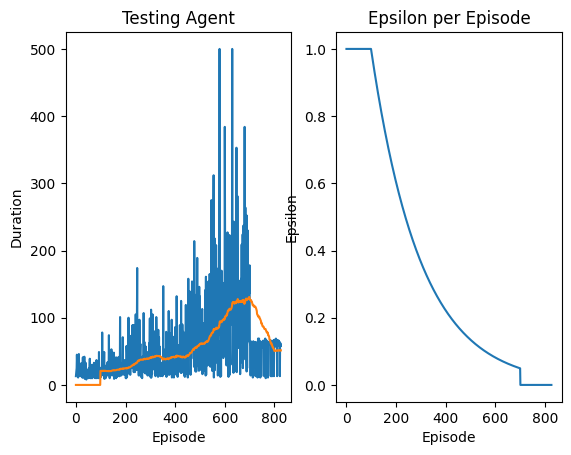

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 827 Duration 67 steps | epsilon 0.0


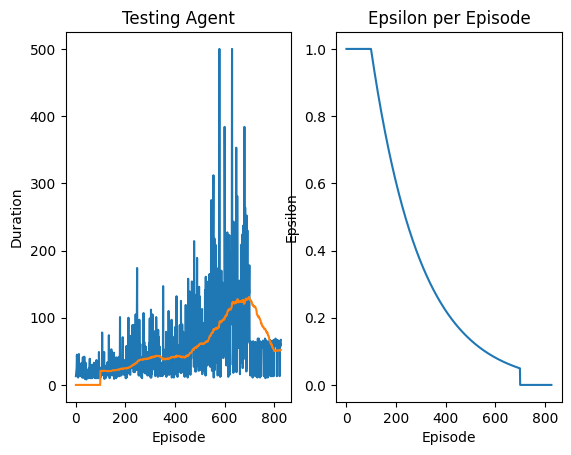

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 828 Duration 64 steps | epsilon 0.0


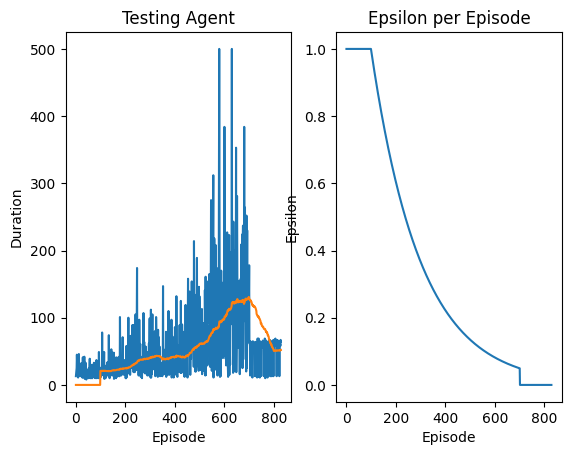

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 829 Duration 63 steps | epsilon 0.0


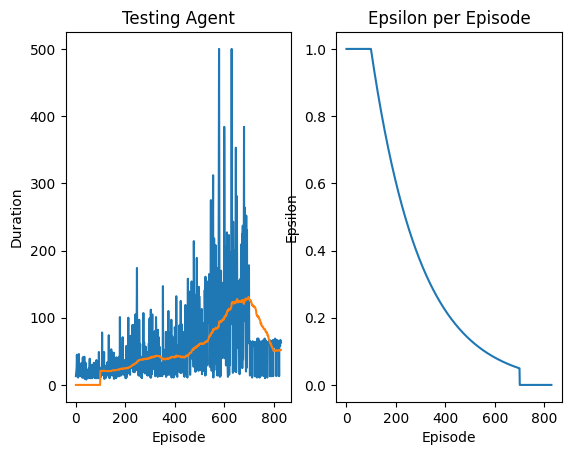

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 830 Duration 65 steps | epsilon 0.0


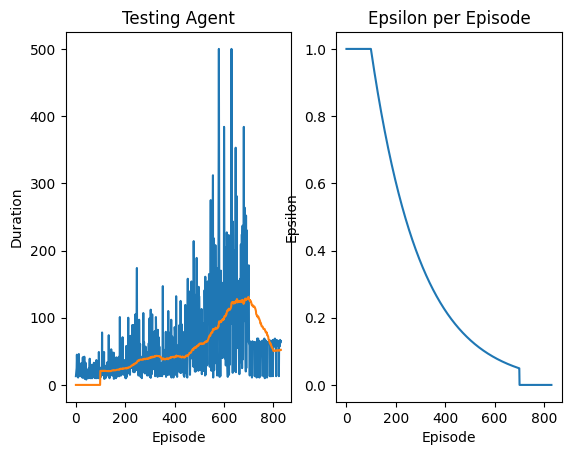

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 831 Duration 63 steps | epsilon 0.0


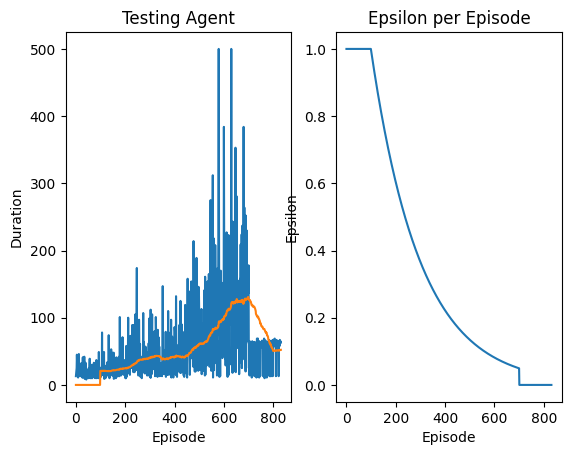

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 832 Duration 62 steps | epsilon 0.0


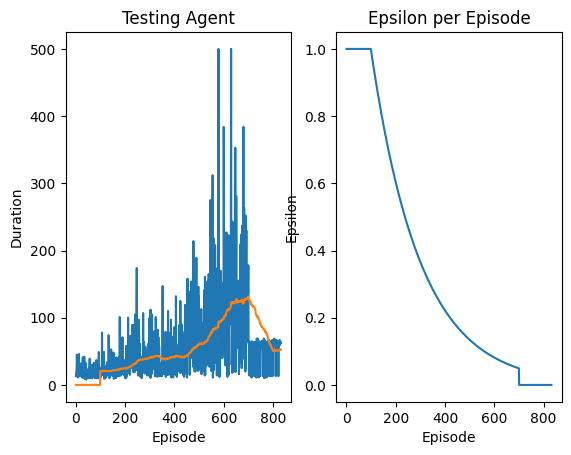

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 833 Duration 63 steps | epsilon 0.0


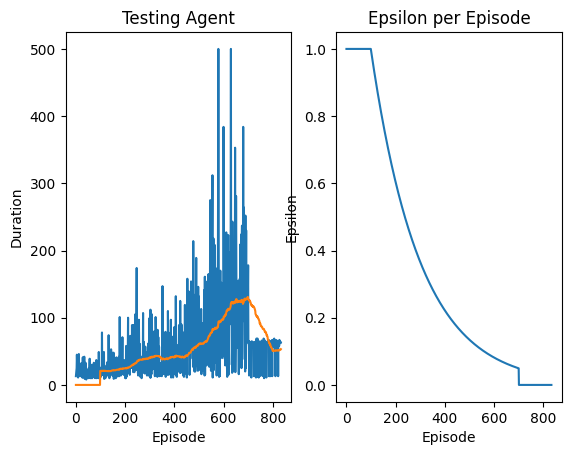

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 834 Duration 63 steps | epsilon 0.0


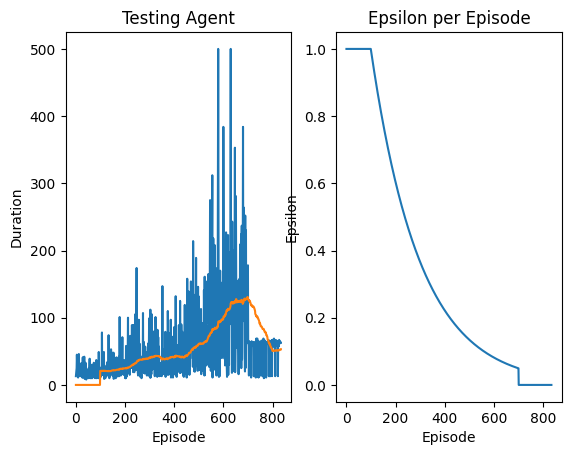

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 835 Duration 65 steps | epsilon 0.0


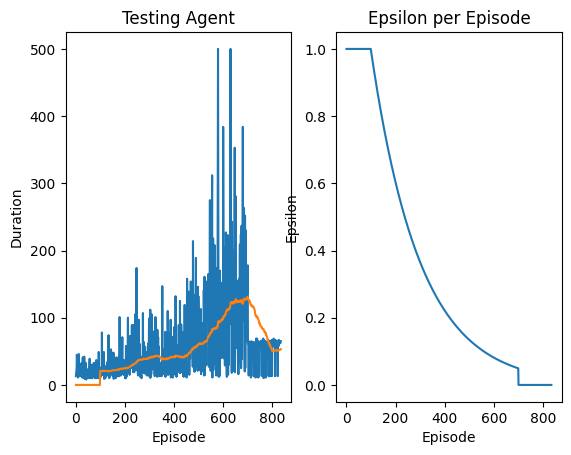

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 836 Duration 64 steps | epsilon 0.0


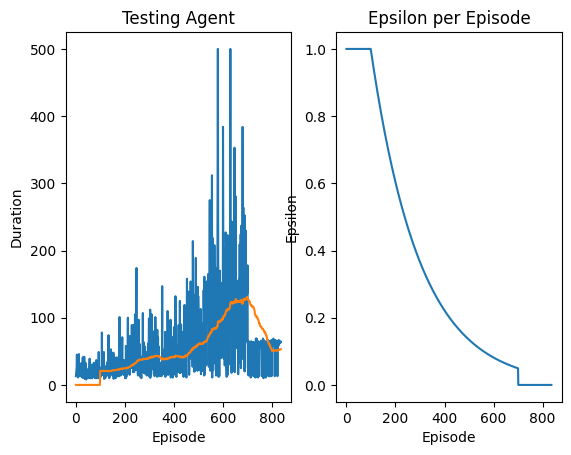

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 837 Duration 60 steps | epsilon 0.0


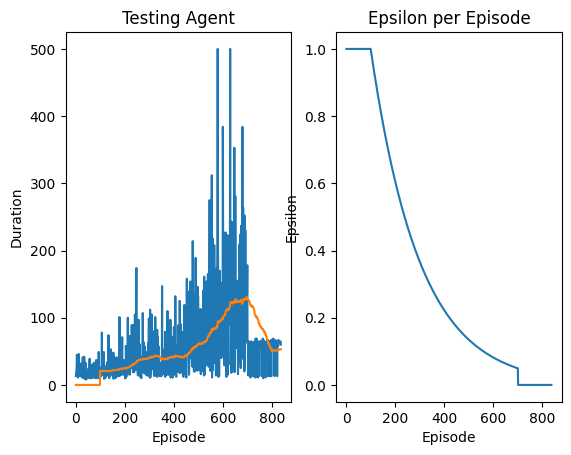

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 838 Duration 62 steps | epsilon 0.0


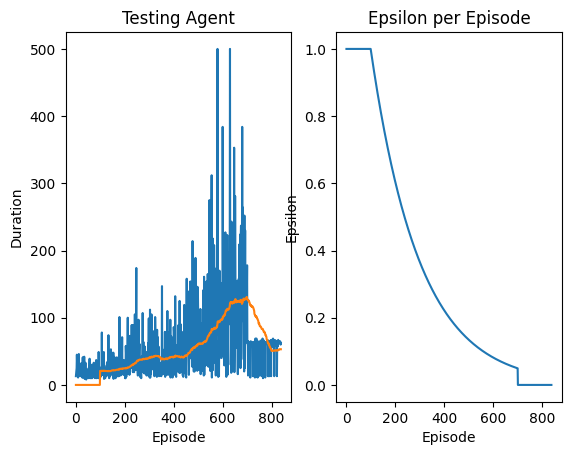

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 839 Duration 10 steps | epsilon 0.0


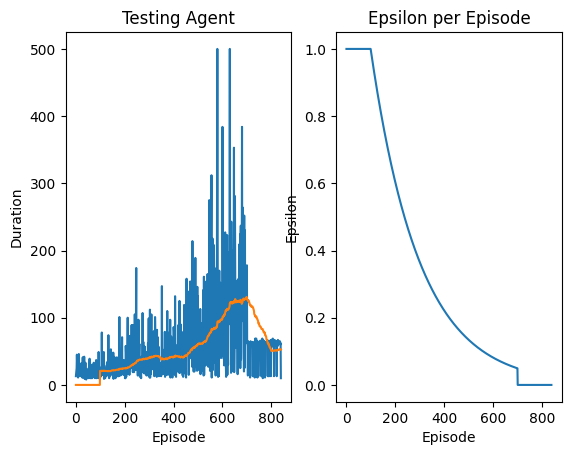

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 840 Duration 61 steps | epsilon 0.0


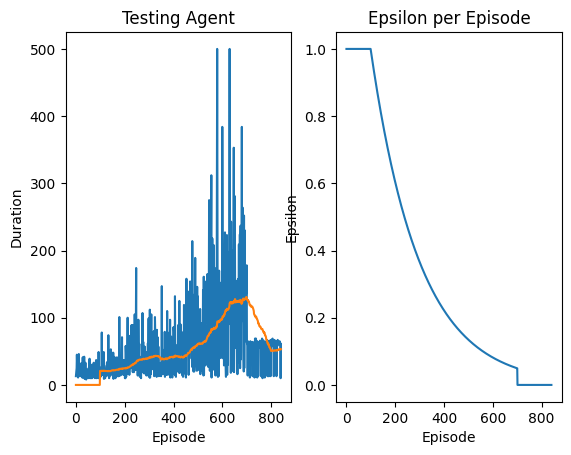

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 841 Duration 14 steps | epsilon 0.0


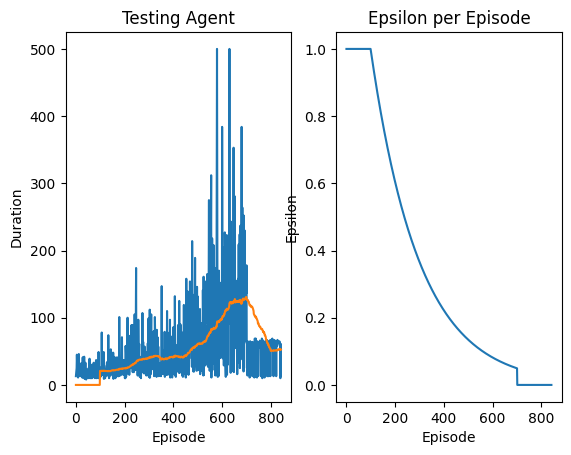

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 842 Duration 61 steps | epsilon 0.0


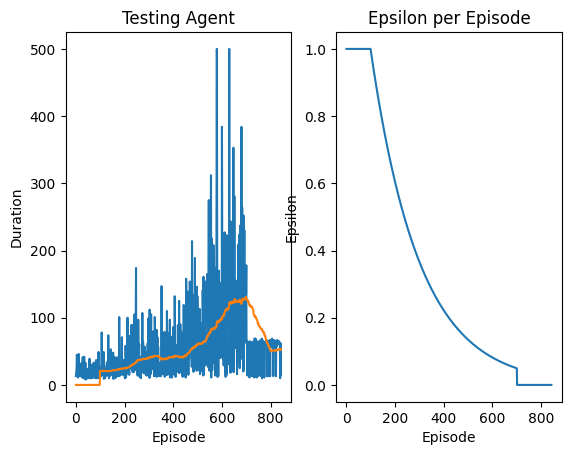

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 843 Duration 60 steps | epsilon 0.0


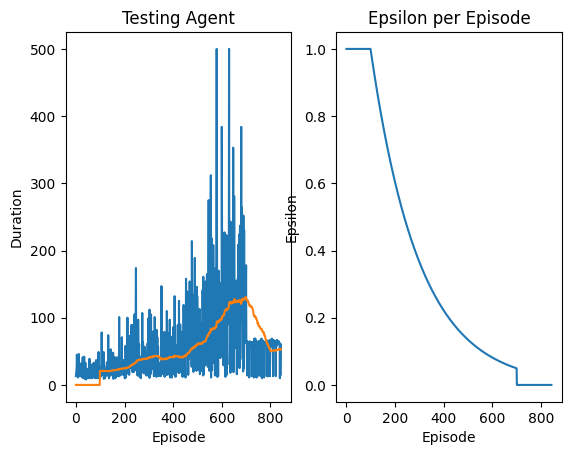

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 844 Duration 61 steps | epsilon 0.0


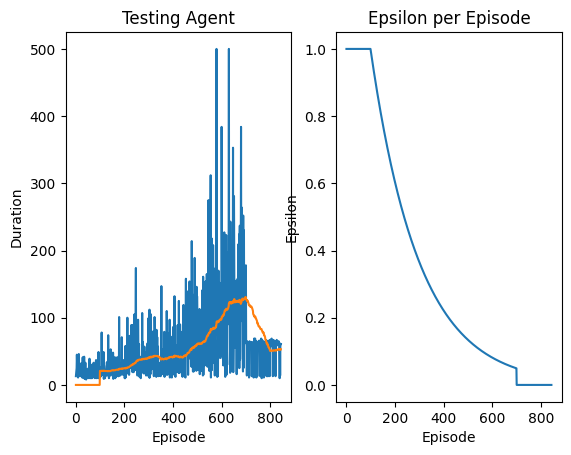

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 845 Duration 58 steps | epsilon 0.0


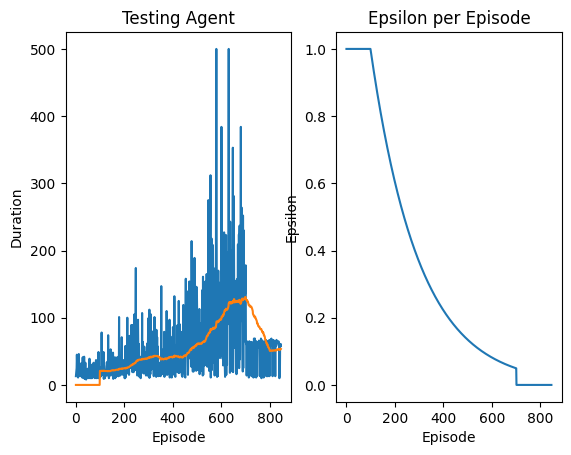

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 846 Duration 65 steps | epsilon 0.0


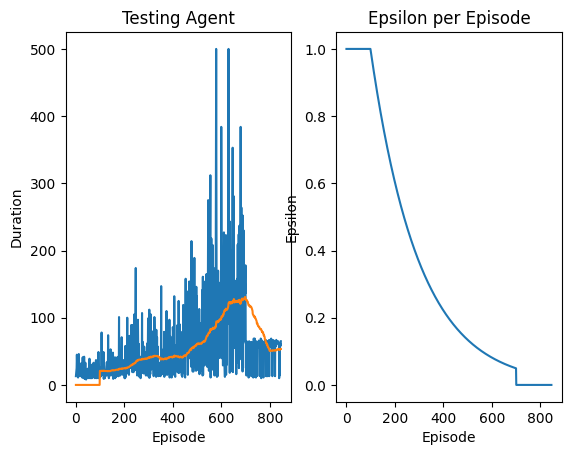

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 847 Duration 62 steps | epsilon 0.0


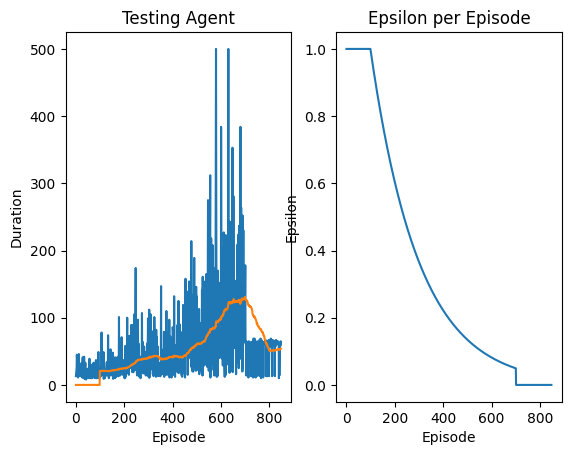

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 848 Duration 64 steps | epsilon 0.0


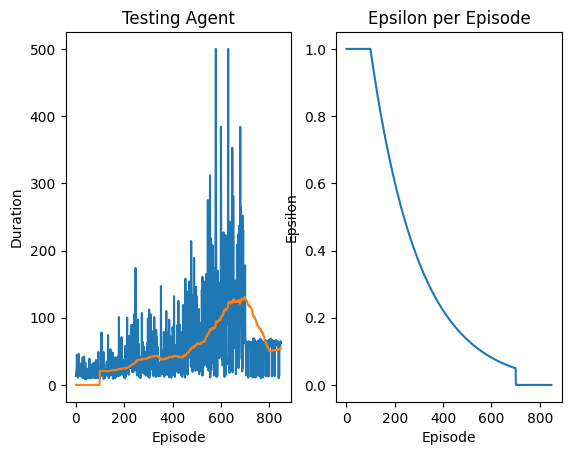

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 849 Duration 67 steps | epsilon 0.0


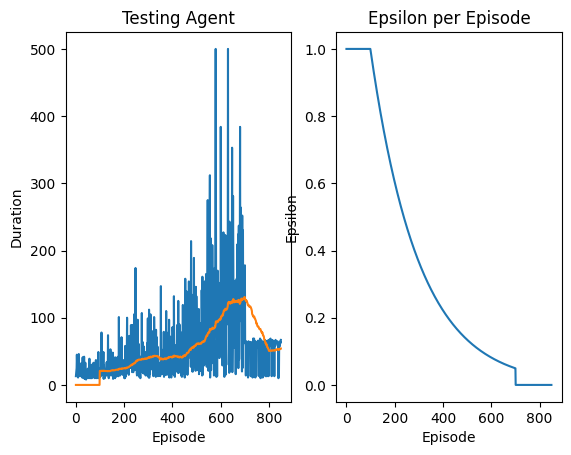

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 850 Duration 67 steps | epsilon 0.0


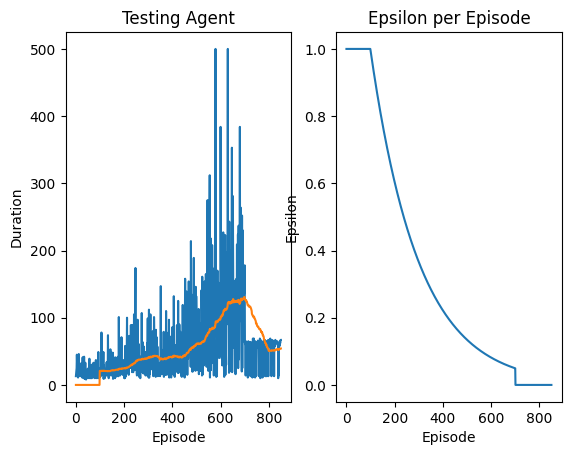

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 851 Duration 62 steps | epsilon 0.0


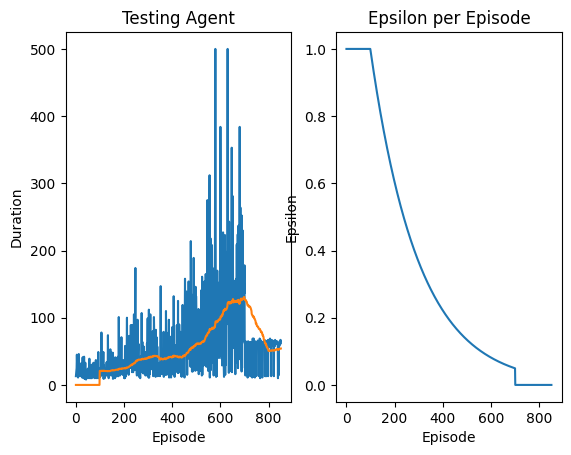

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 852 Duration 61 steps | epsilon 0.0


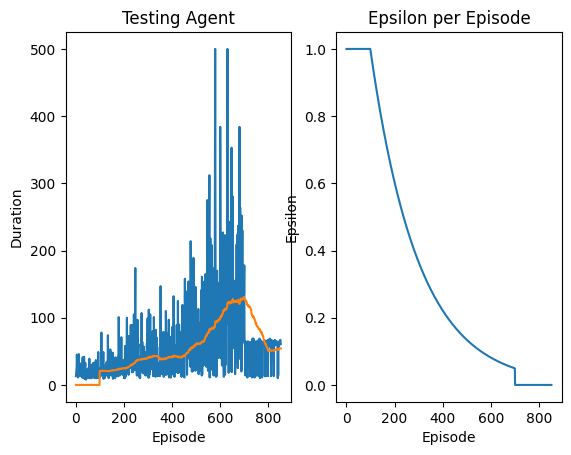

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 853 Duration 58 steps | epsilon 0.0


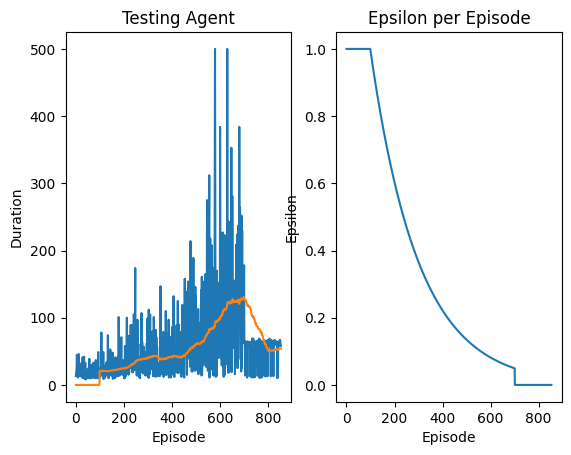

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 854 Duration 64 steps | epsilon 0.0


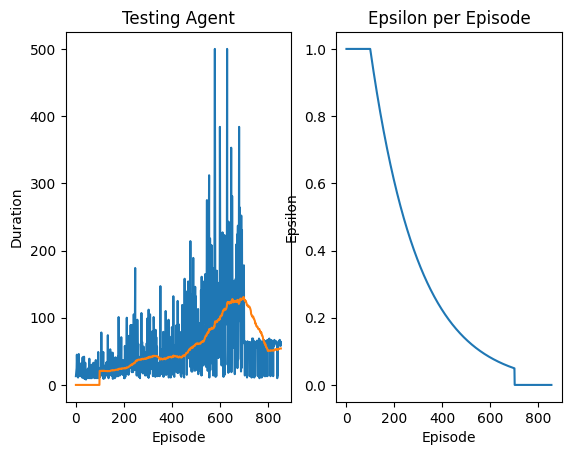

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 855 Duration 63 steps | epsilon 0.0


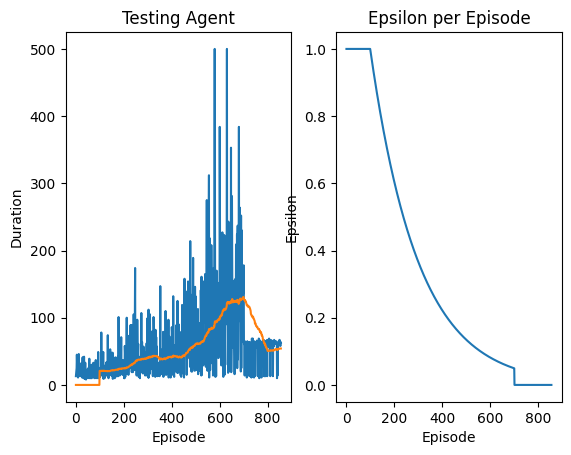

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 856 Duration 60 steps | epsilon 0.0


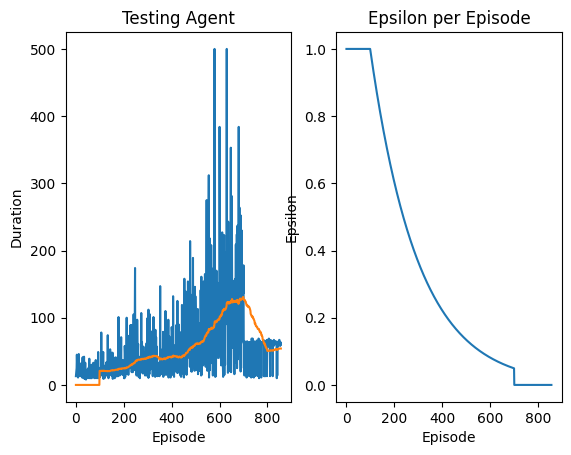

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 857 Duration 13 steps | epsilon 0.0


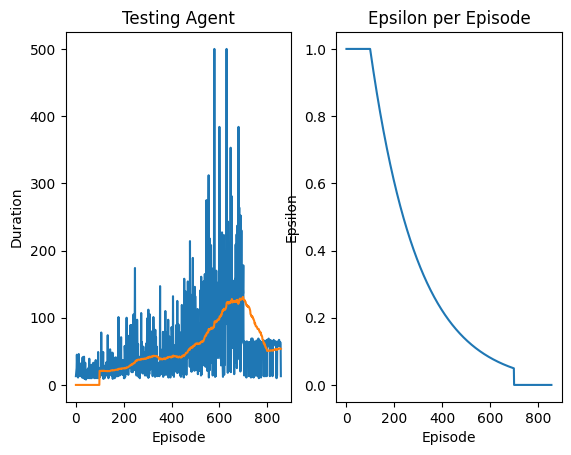

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 858 Duration 63 steps | epsilon 0.0


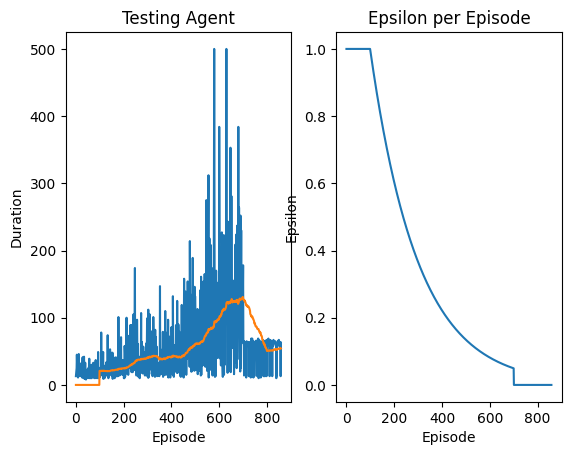

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 859 Duration 62 steps | epsilon 0.0


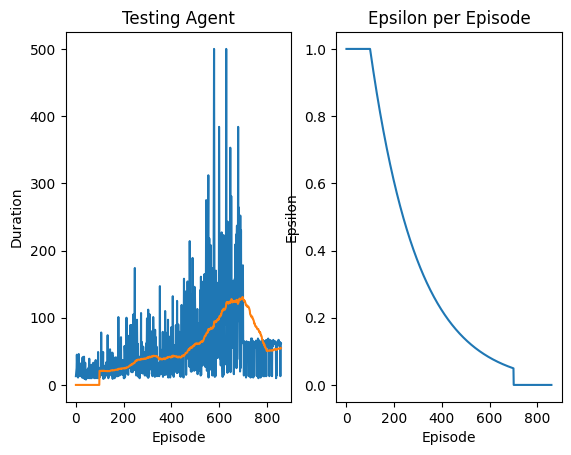

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 860 Duration 63 steps | epsilon 0.0


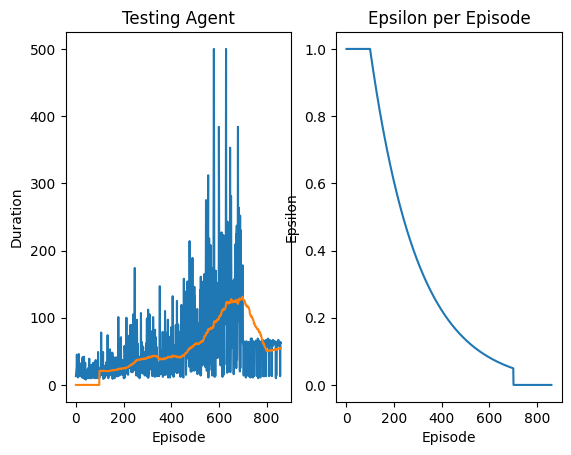

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 861 Duration 62 steps | epsilon 0.0


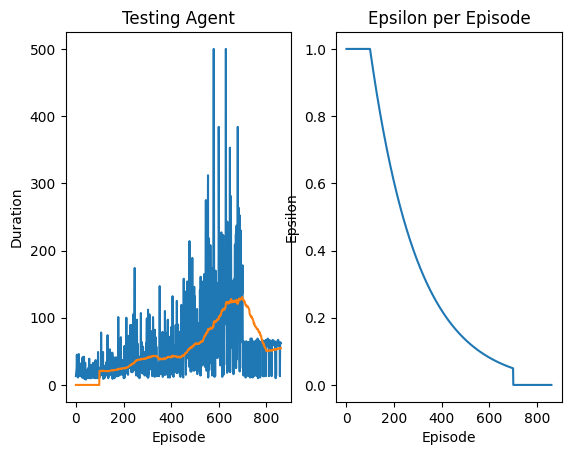

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 862 Duration 65 steps | epsilon 0.0


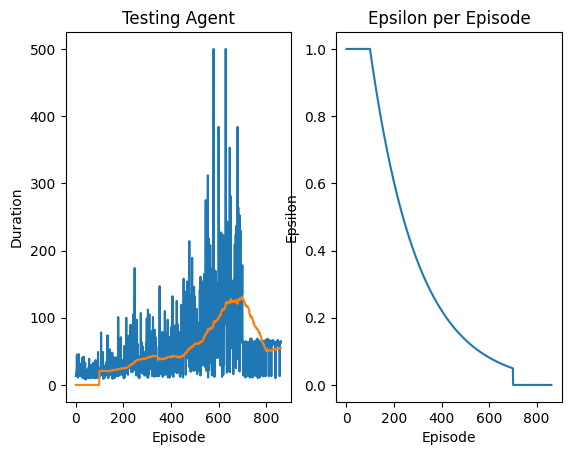

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 863 Duration 58 steps | epsilon 0.0


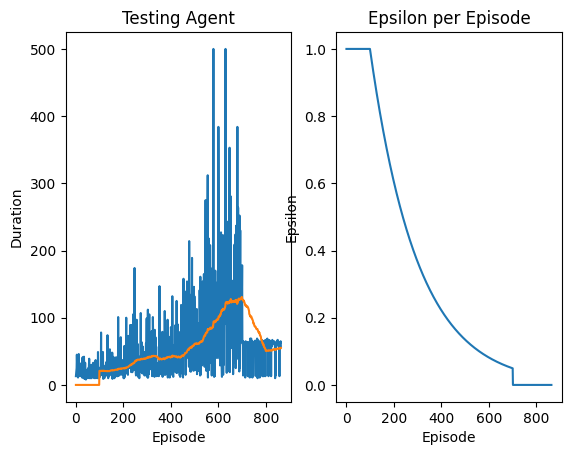

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 864 Duration 60 steps | epsilon 0.0


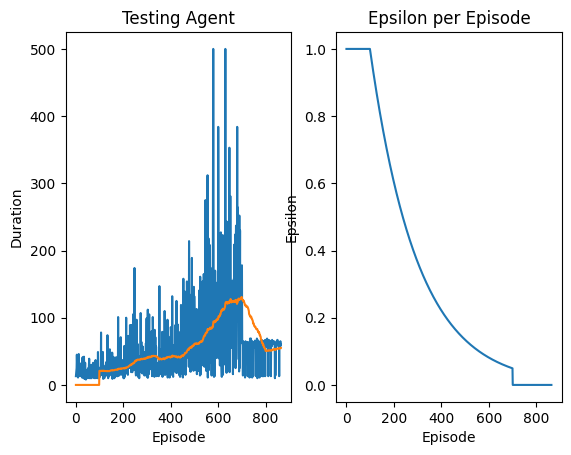

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 865 Duration 65 steps | epsilon 0.0


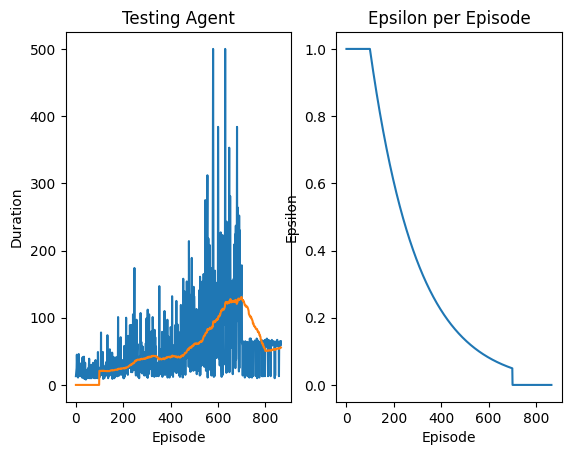

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 866 Duration 13 steps | epsilon 0.0


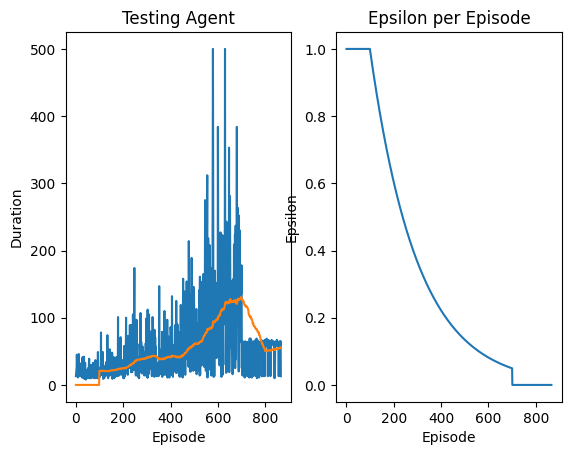

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 867 Duration 65 steps | epsilon 0.0


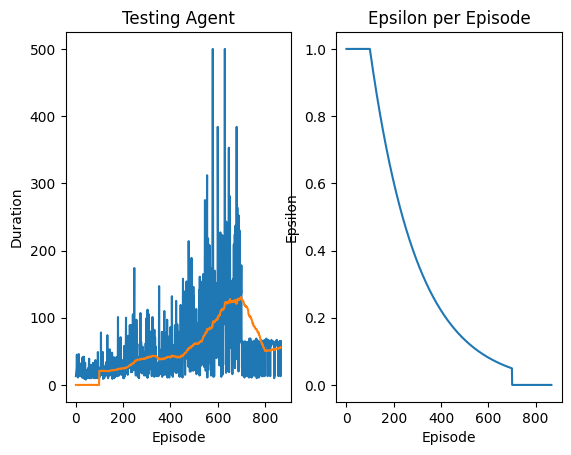

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 868 Duration 58 steps | epsilon 0.0


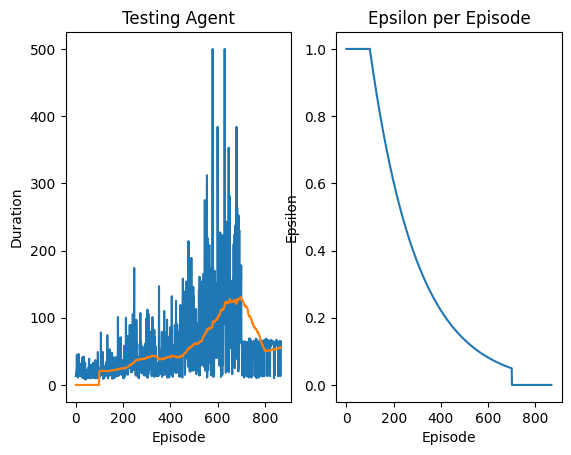

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 869 Duration 63 steps | epsilon 0.0


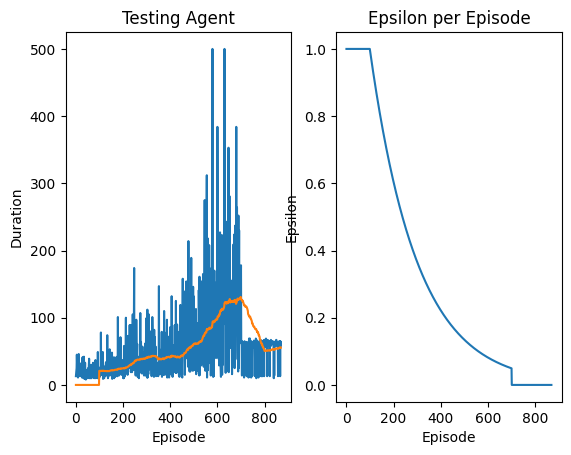

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 870 Duration 64 steps | epsilon 0.0


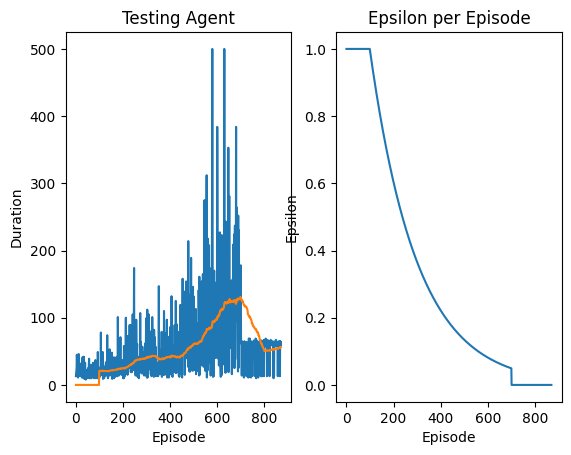

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 871 Duration 62 steps | epsilon 0.0


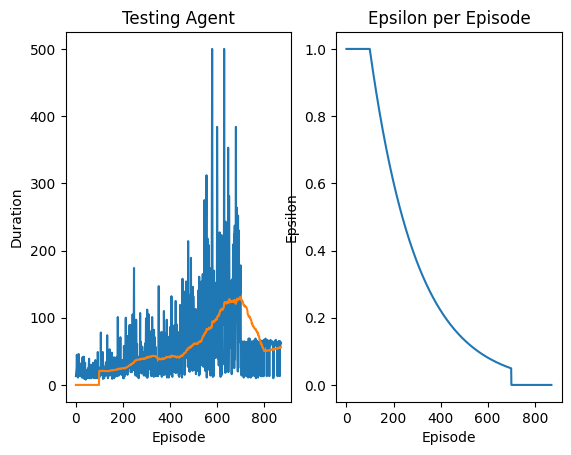

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 872 Duration 62 steps | epsilon 0.0


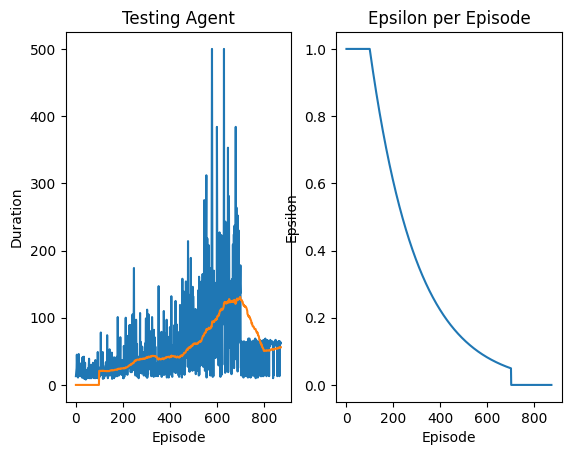

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 873 Duration 56 steps | epsilon 0.0


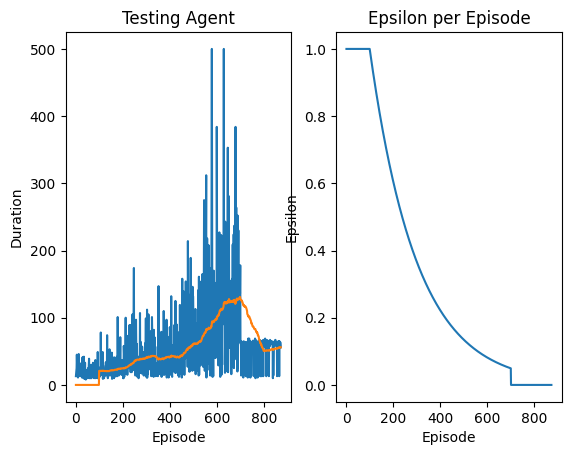

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 874 Duration 64 steps | epsilon 0.0


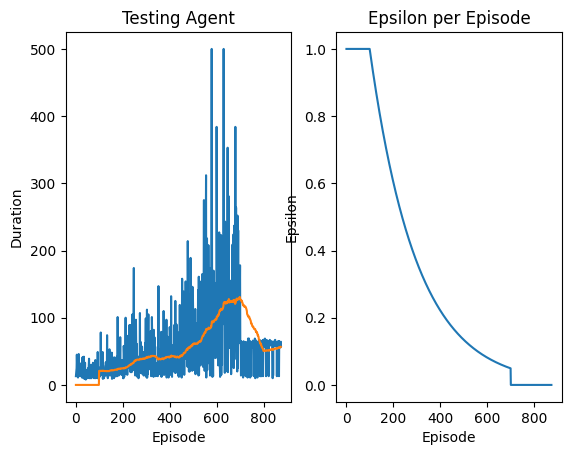

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 875 Duration 61 steps | epsilon 0.0


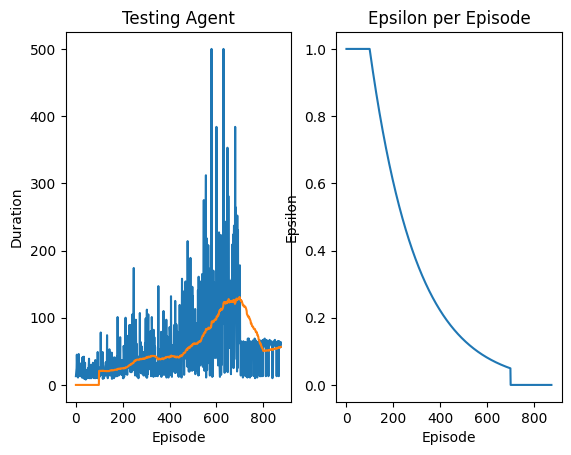

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 876 Duration 56 steps | epsilon 0.0


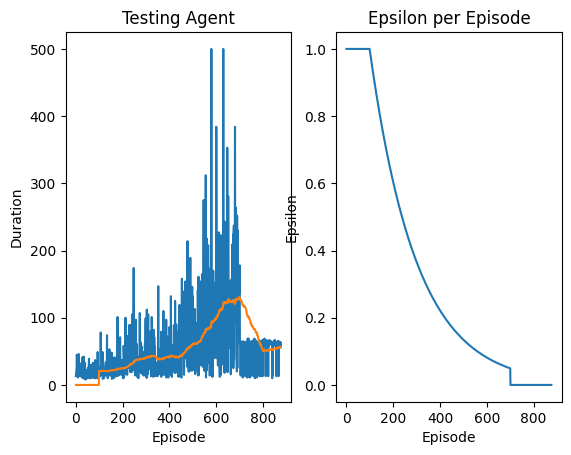

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 877 Duration 65 steps | epsilon 0.0


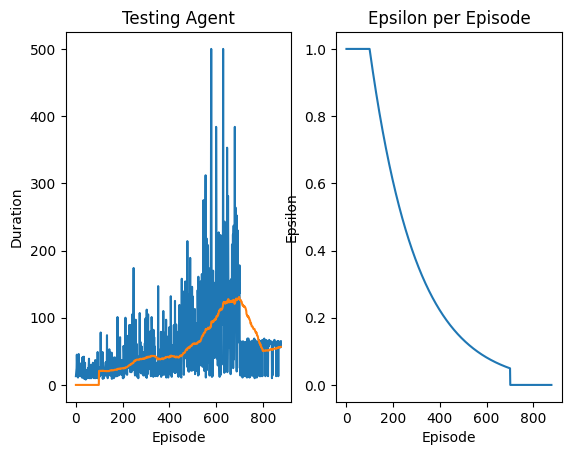

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 878 Duration 61 steps | epsilon 0.0


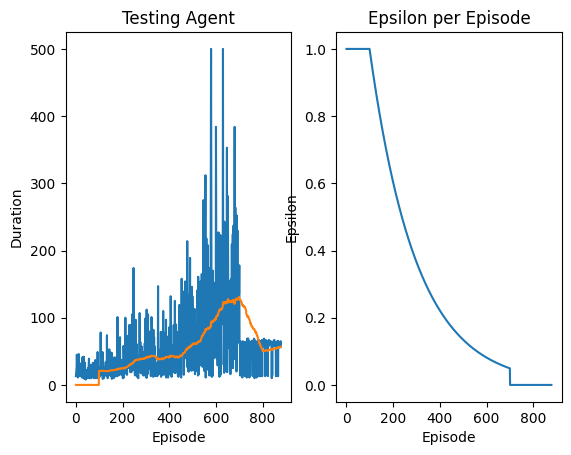

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 879 Duration 65 steps | epsilon 0.0


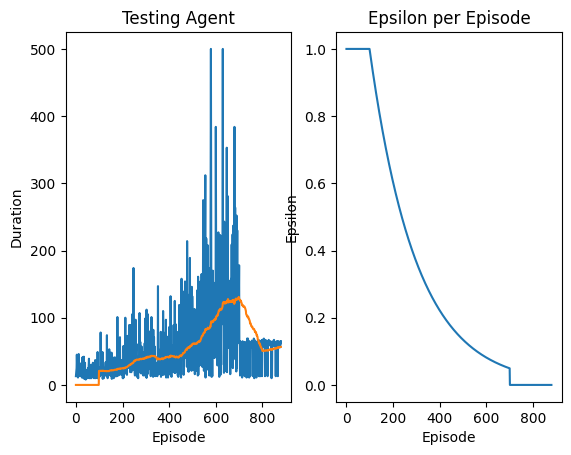

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 880 Duration 67 steps | epsilon 0.0


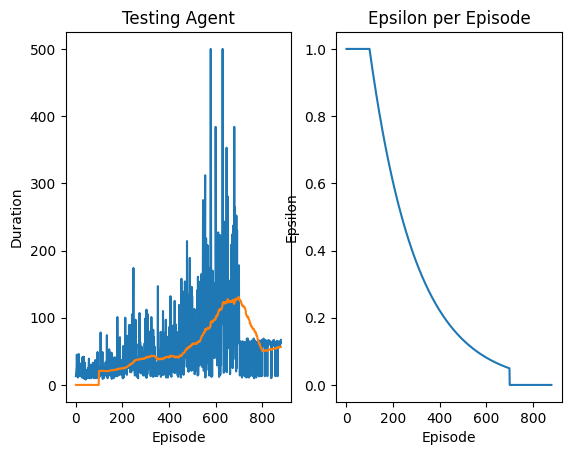

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 881 Duration 63 steps | epsilon 0.0


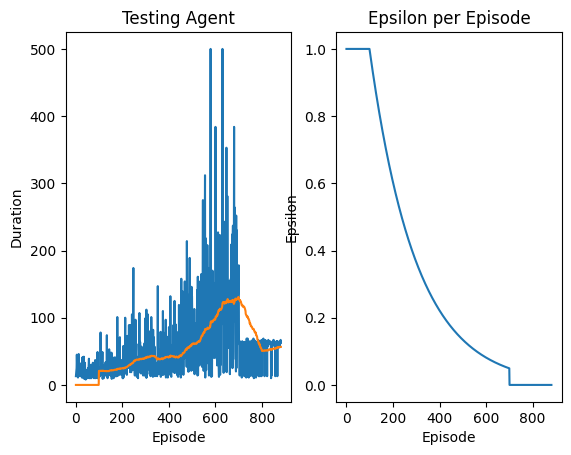

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 882 Duration 64 steps | epsilon 0.0


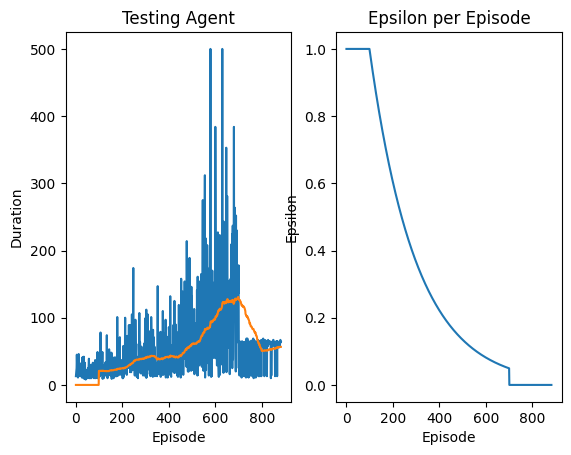

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 883 Duration 60 steps | epsilon 0.0


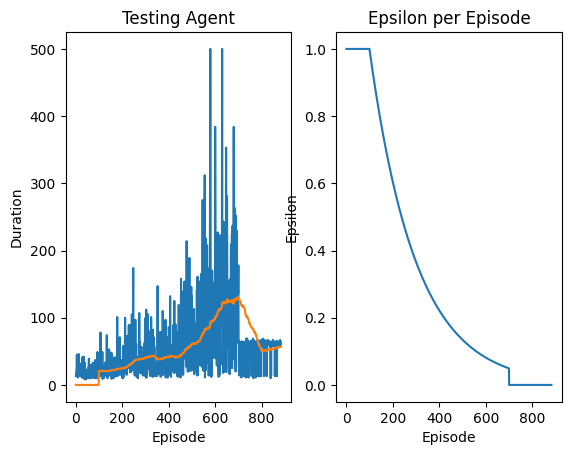

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 884 Duration 13 steps | epsilon 0.0


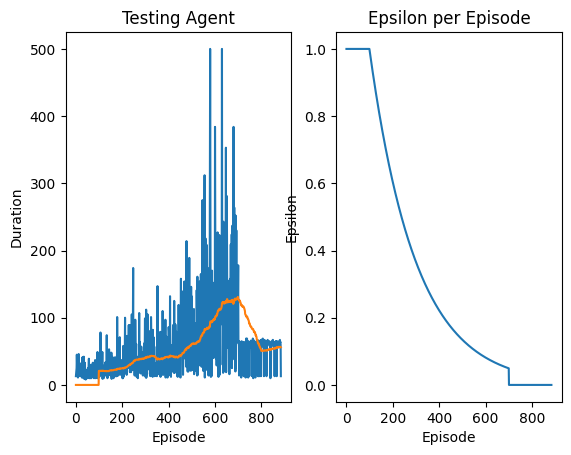

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 885 Duration 56 steps | epsilon 0.0


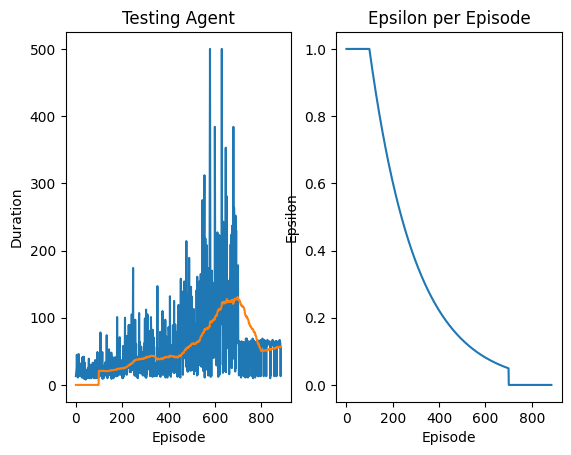

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 886 Duration 59 steps | epsilon 0.0


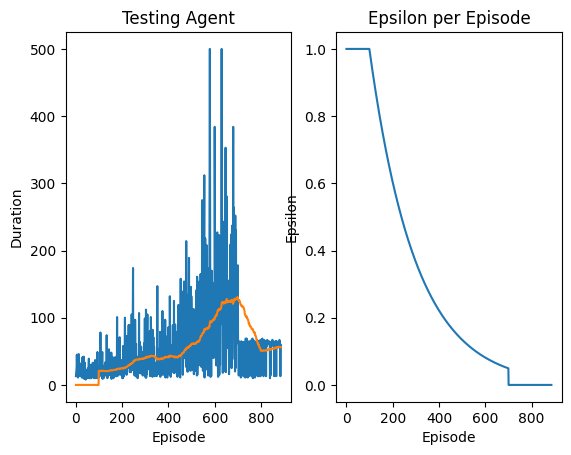

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 887 Duration 13 steps | epsilon 0.0


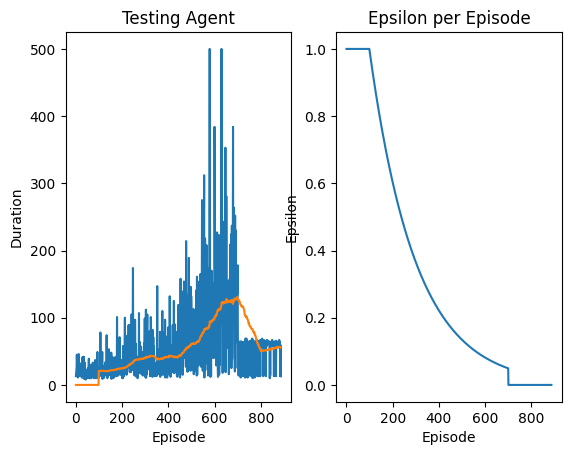

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 888 Duration 58 steps | epsilon 0.0


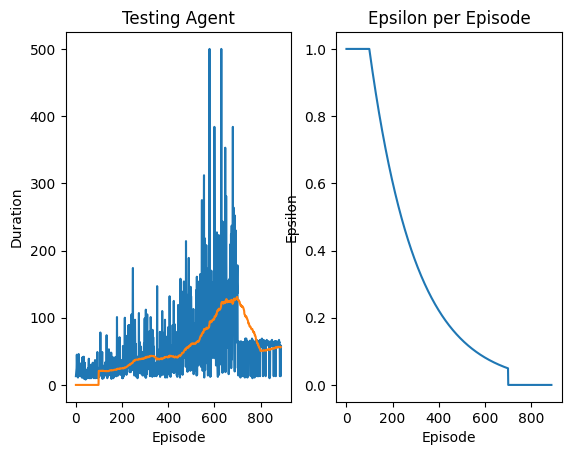

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 889 Duration 62 steps | epsilon 0.0


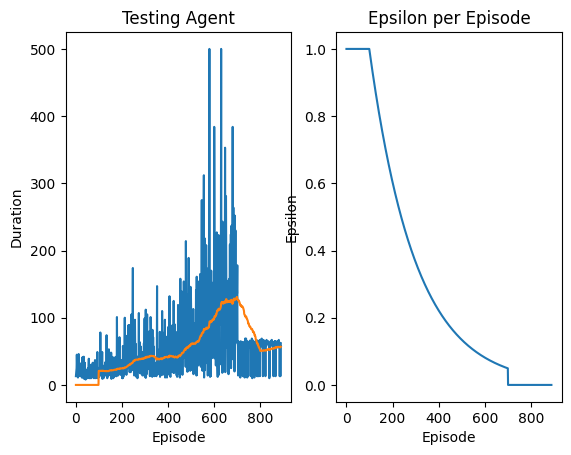

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 890 Duration 63 steps | epsilon 0.0


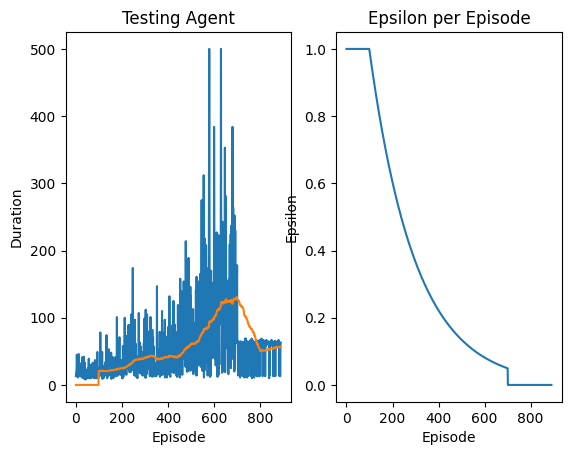

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 891 Duration 65 steps | epsilon 0.0


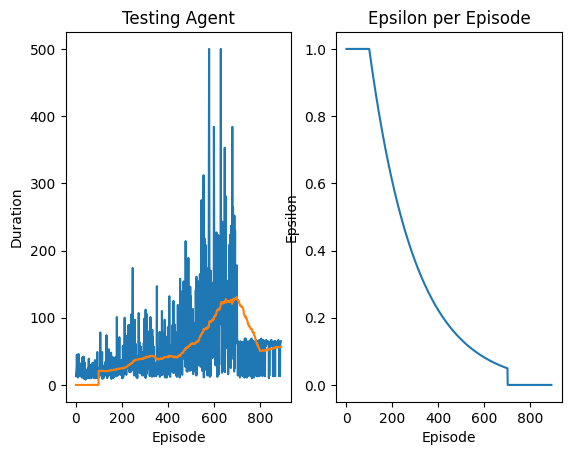

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 892 Duration 14 steps | epsilon 0.0


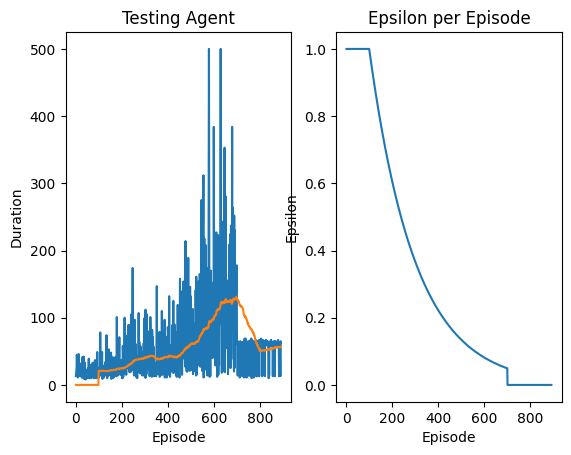

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 893 Duration 62 steps | epsilon 0.0


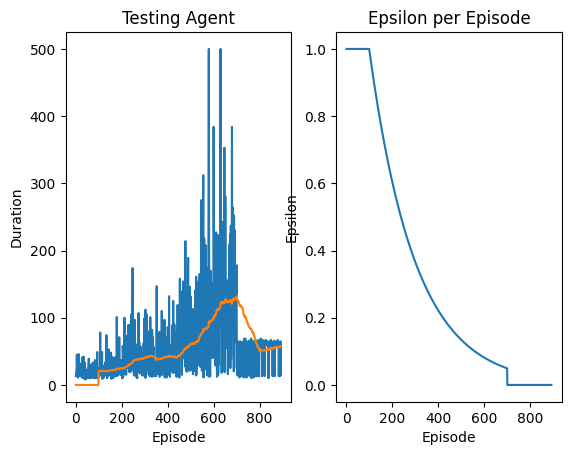

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 894 Duration 62 steps | epsilon 0.0


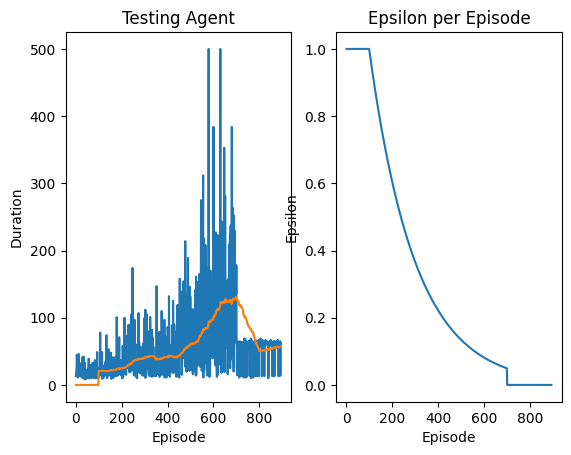

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 895 Duration 11 steps | epsilon 0.0


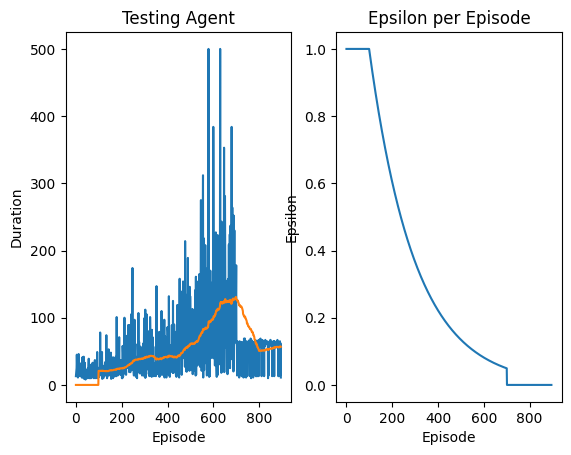

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 896 Duration 64 steps | epsilon 0.0


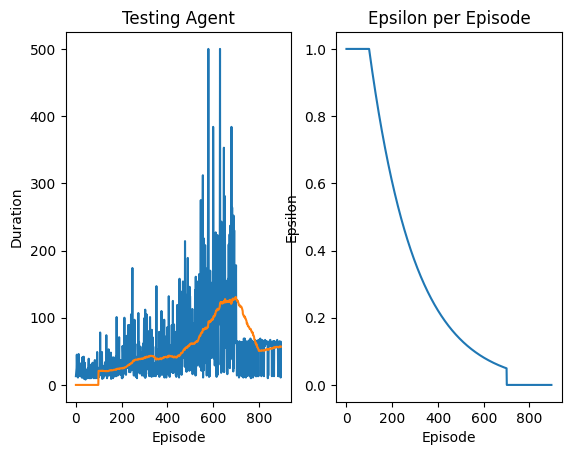

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 897 Duration 61 steps | epsilon 0.0


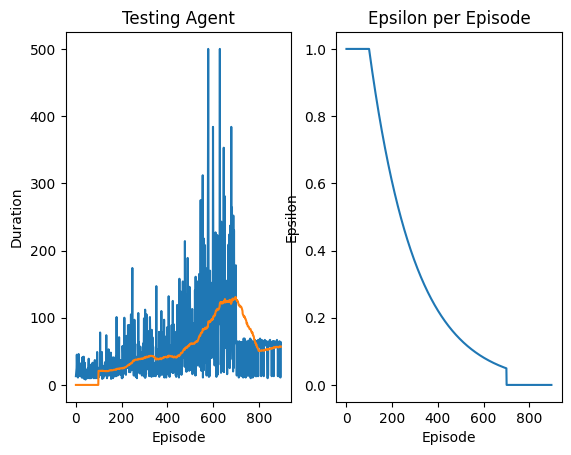

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 898 Duration 55 steps | epsilon 0.0


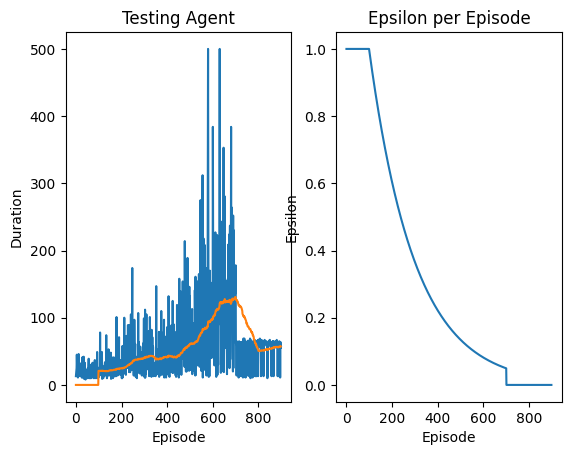

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 899 Duration 71 steps | epsilon 0.0


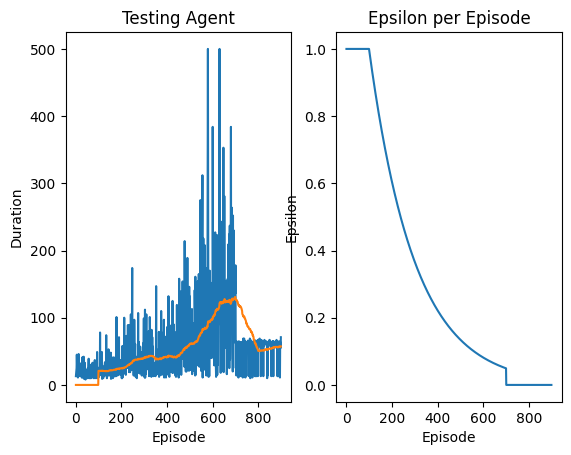

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 900 Duration 55 steps | epsilon 0.0


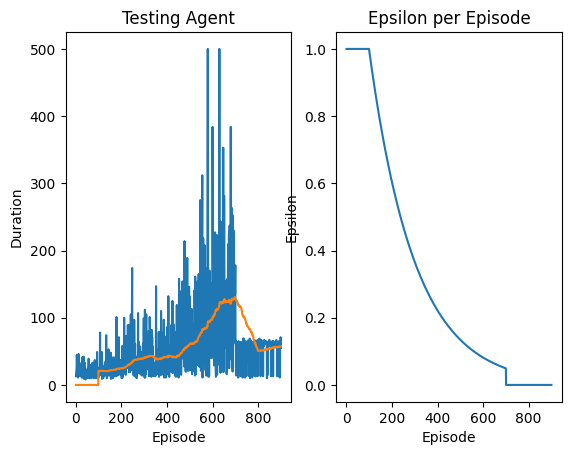

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 901 Duration 60 steps | epsilon 0.0


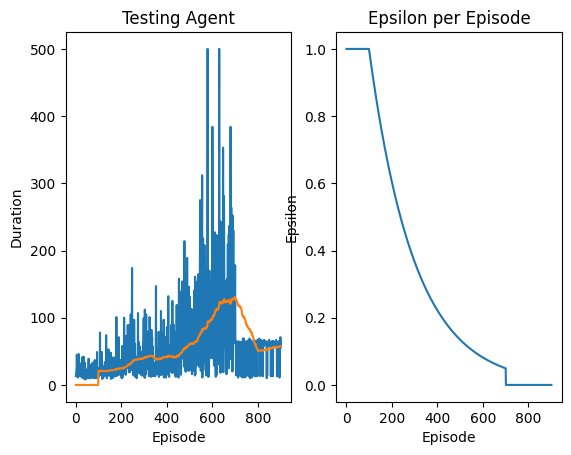

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 902 Duration 65 steps | epsilon 0.0


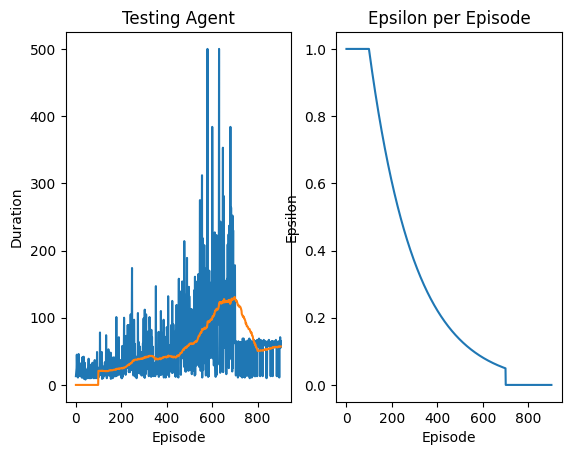

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 903 Duration 69 steps | epsilon 0.0


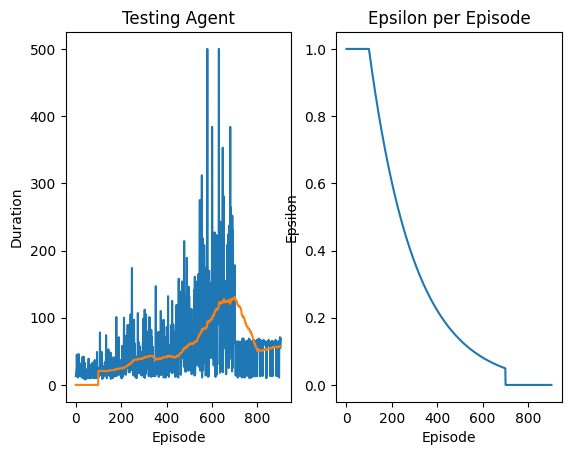

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 904 Duration 58 steps | epsilon 0.0


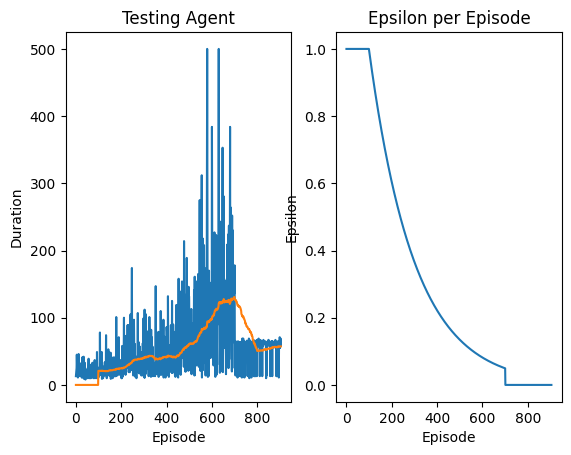

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 905 Duration 58 steps | epsilon 0.0


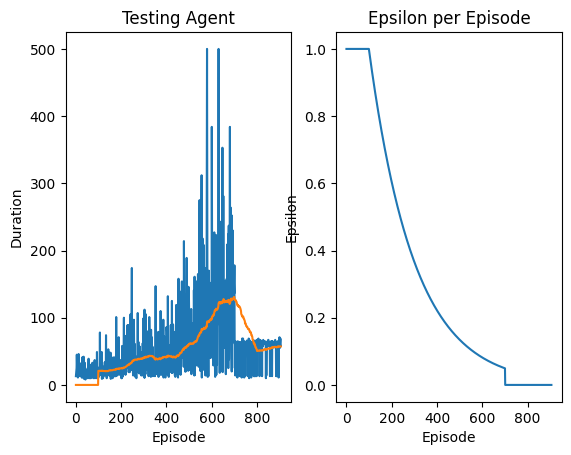

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 906 Duration 58 steps | epsilon 0.0


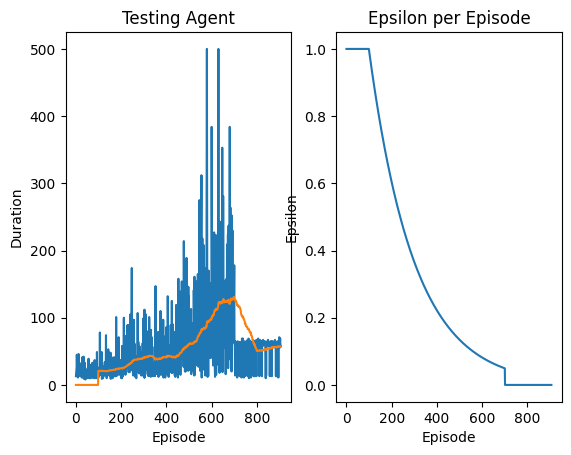

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 907 Duration 60 steps | epsilon 0.0


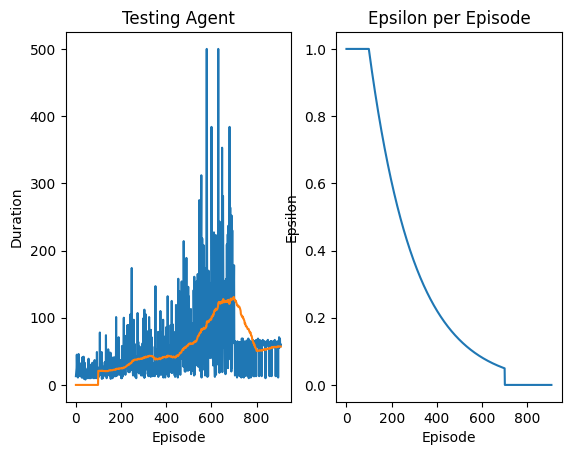

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 908 Duration 62 steps | epsilon 0.0


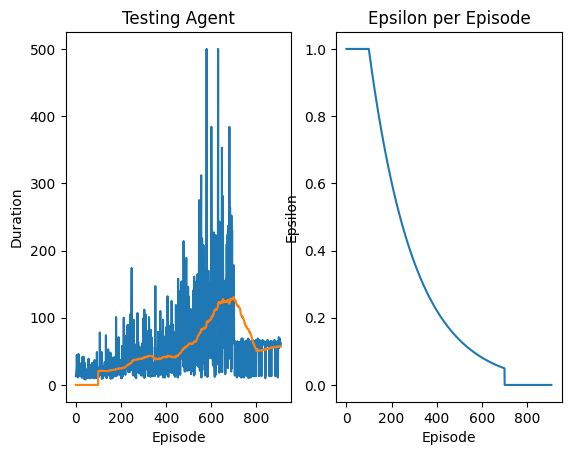

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 909 Duration 63 steps | epsilon 0.0


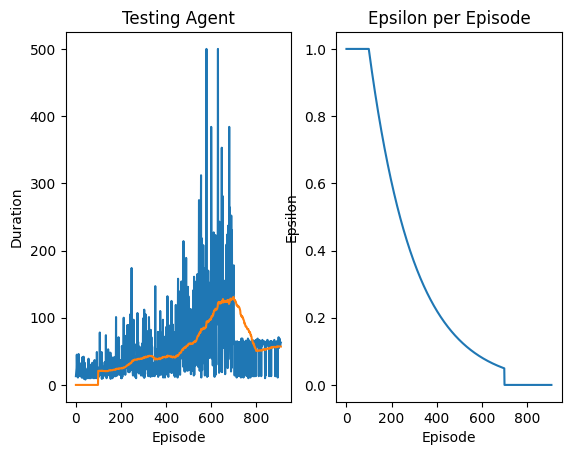

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 910 Duration 69 steps | epsilon 0.0


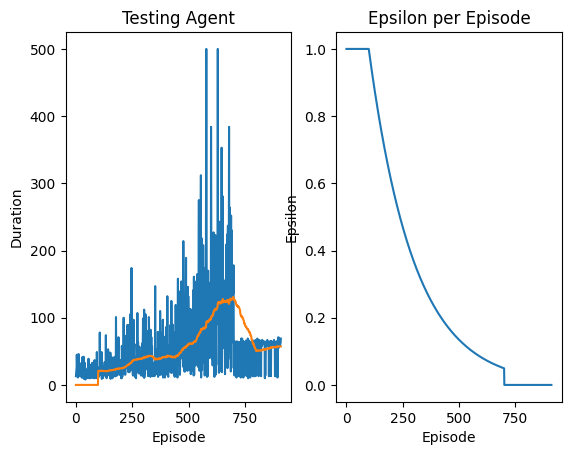

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 911 Duration 69 steps | epsilon 0.0


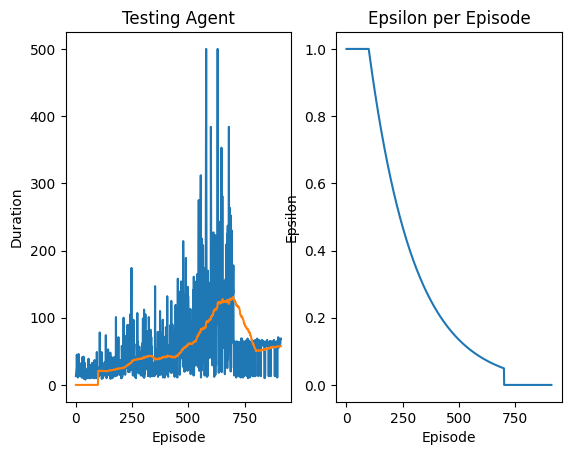

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 912 Duration 11 steps | epsilon 0.0


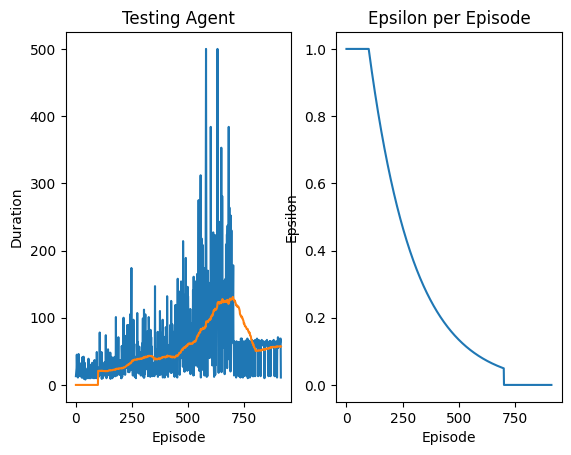

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 913 Duration 62 steps | epsilon 0.0


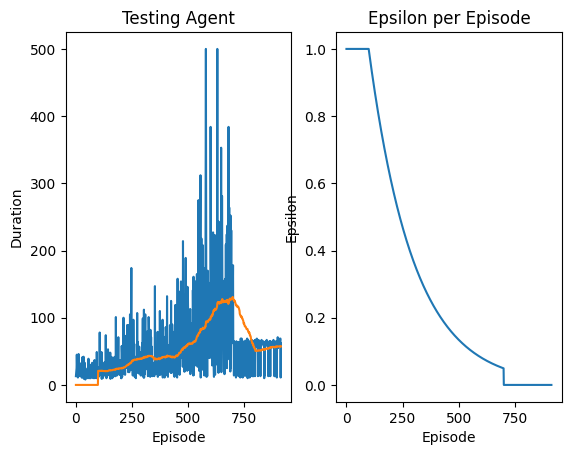

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 914 Duration 58 steps | epsilon 0.0


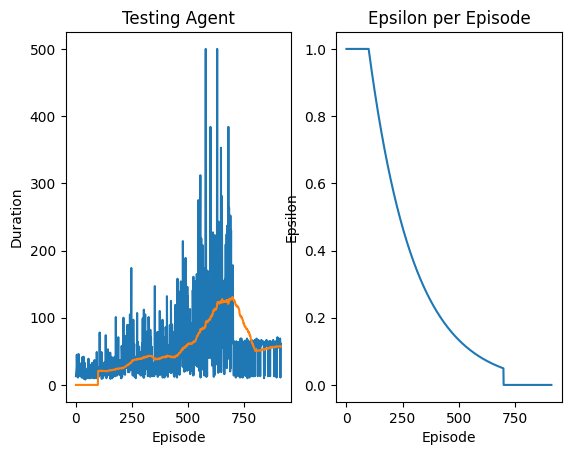

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 915 Duration 62 steps | epsilon 0.0


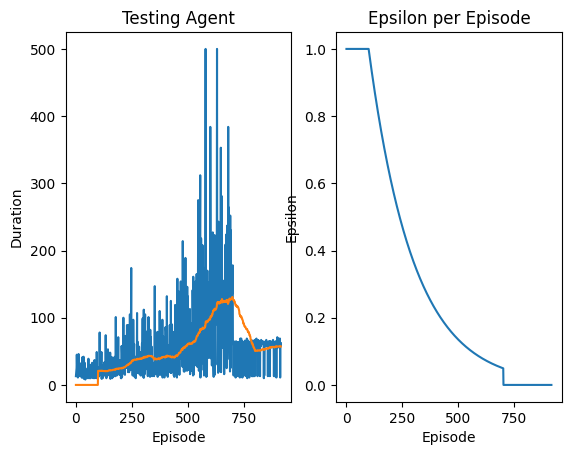

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 916 Duration 60 steps | epsilon 0.0


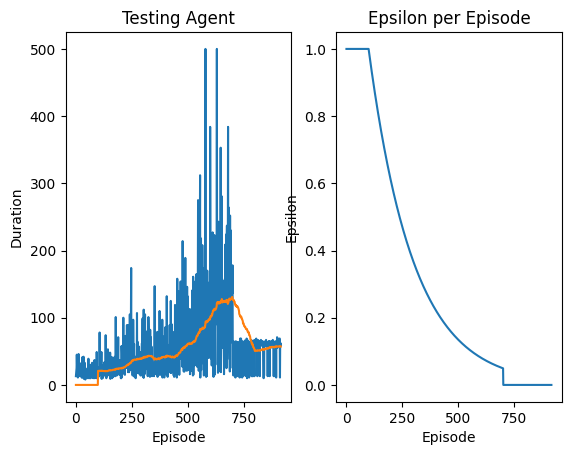

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 917 Duration 63 steps | epsilon 0.0


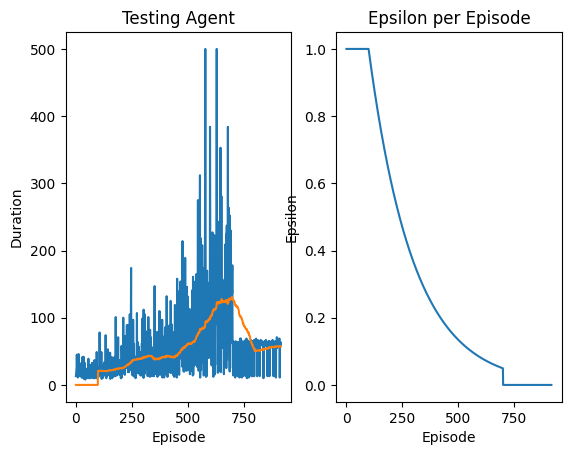

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 918 Duration 60 steps | epsilon 0.0


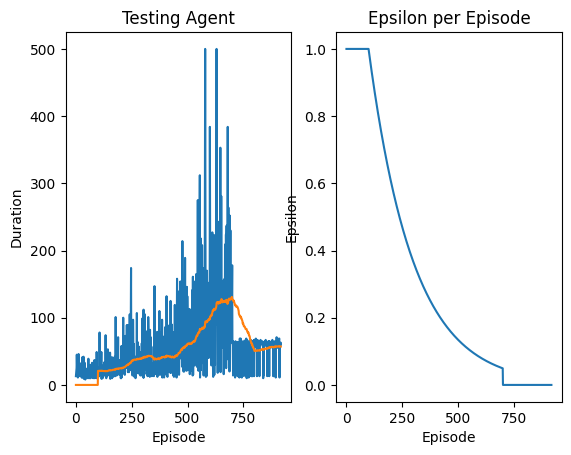

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 919 Duration 60 steps | epsilon 0.0


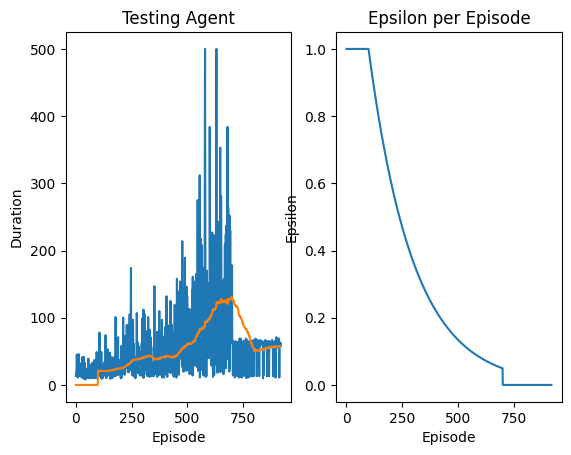

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 920 Duration 62 steps | epsilon 0.0


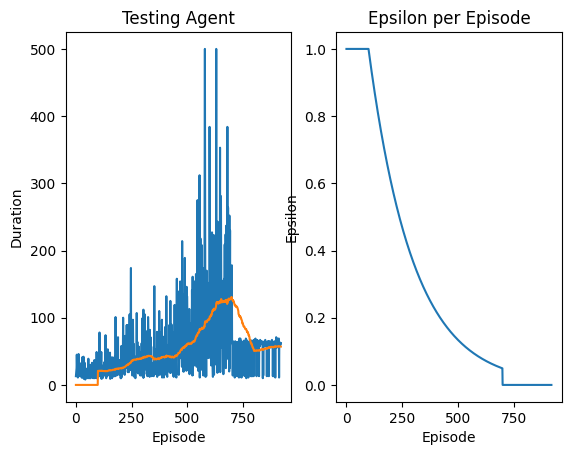

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 921 Duration 65 steps | epsilon 0.0


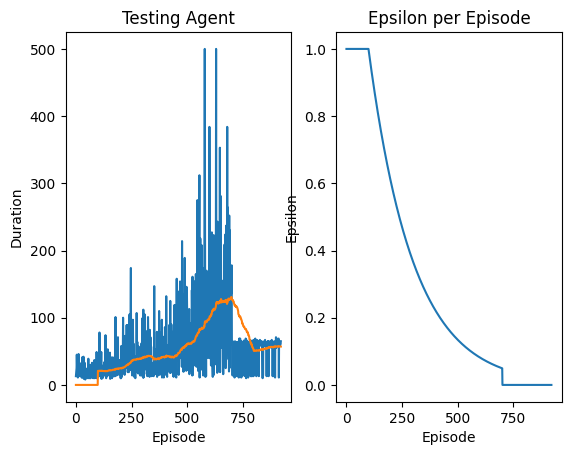

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 922 Duration 69 steps | epsilon 0.0


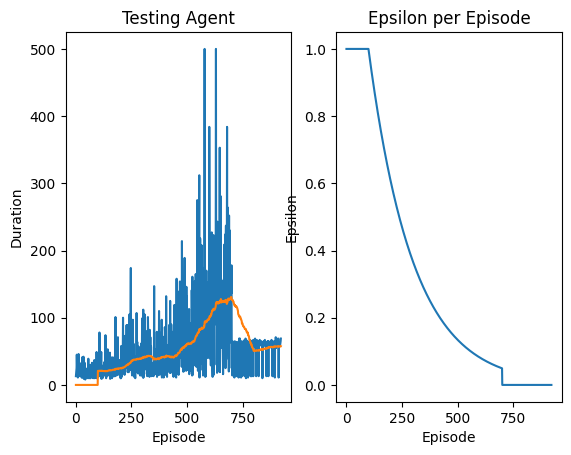

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 923 Duration 58 steps | epsilon 0.0


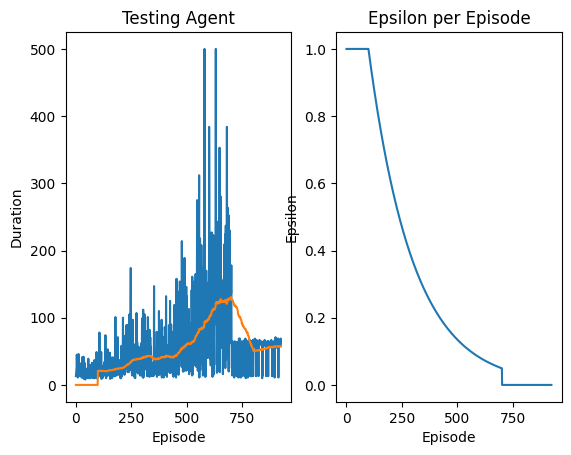

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 924 Duration 60 steps | epsilon 0.0


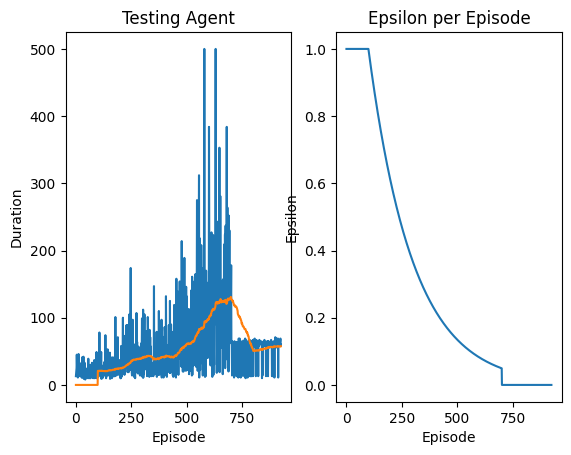

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 925 Duration 61 steps | epsilon 0.0


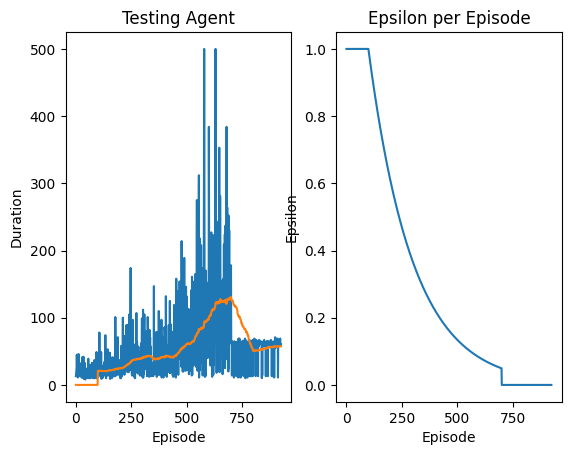

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 926 Duration 60 steps | epsilon 0.0


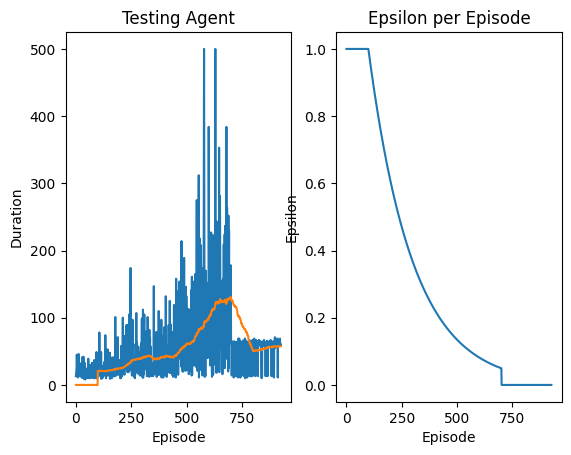

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 927 Duration 62 steps | epsilon 0.0


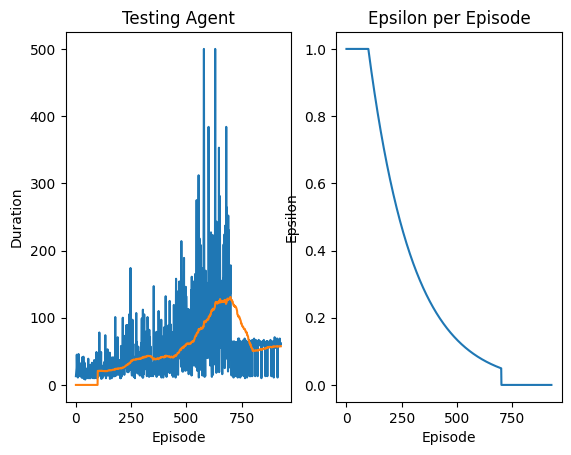

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 928 Duration 60 steps | epsilon 0.0


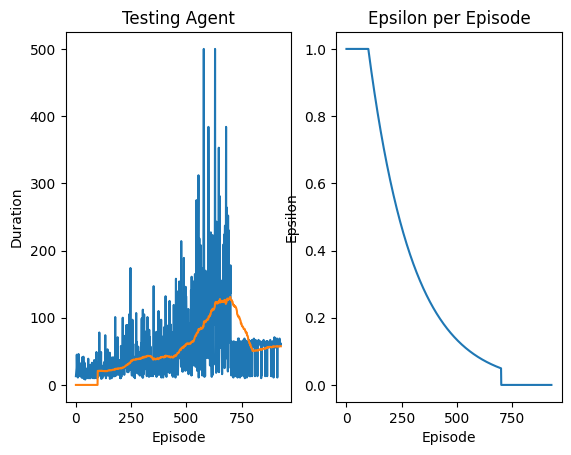

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 929 Duration 60 steps | epsilon 0.0


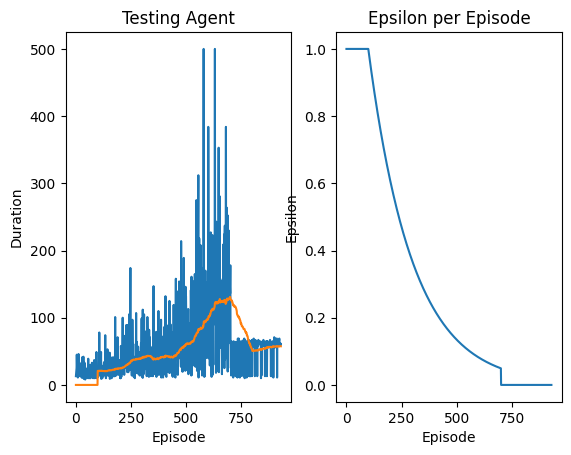

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 930 Duration 58 steps | epsilon 0.0


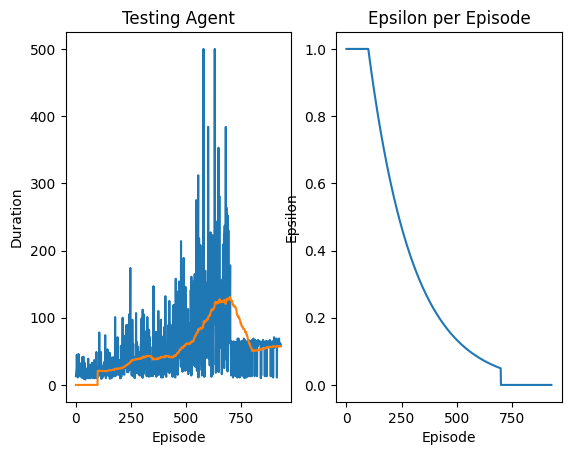

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 931 Duration 11 steps | epsilon 0.0


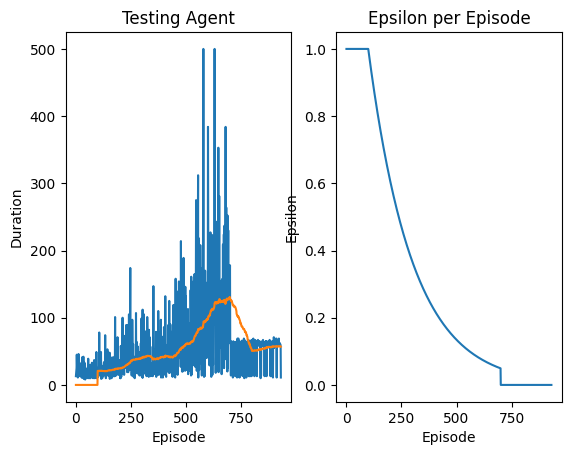

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 932 Duration 69 steps | epsilon 0.0


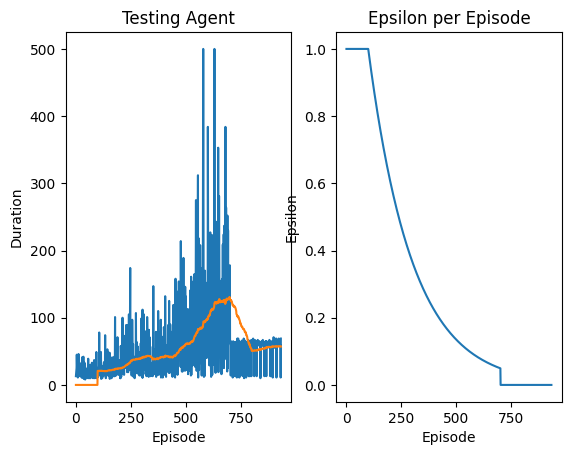

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 933 Duration 61 steps | epsilon 0.0


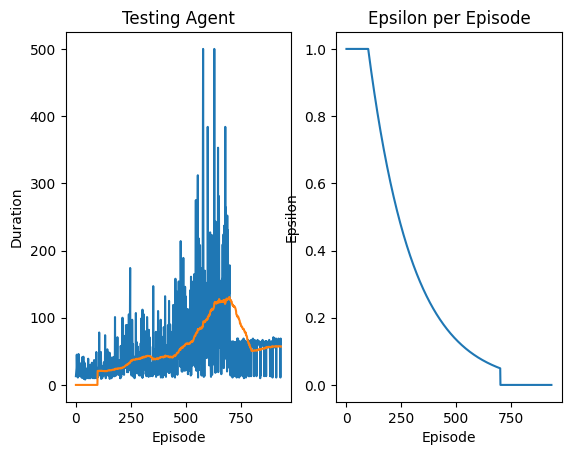

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 934 Duration 59 steps | epsilon 0.0


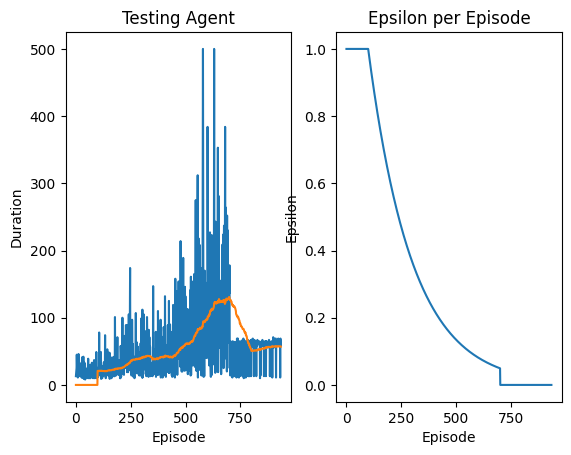

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 935 Duration 11 steps | epsilon 0.0


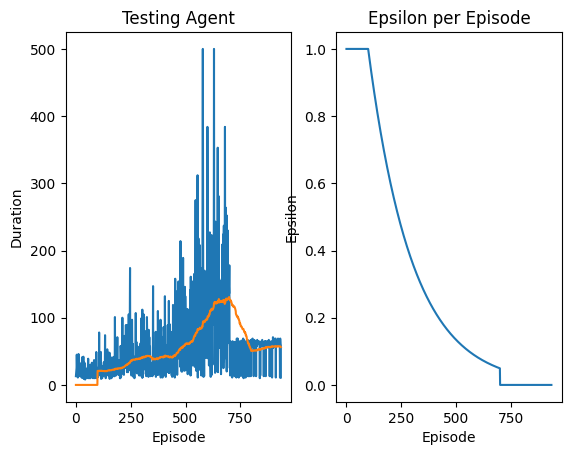

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 936 Duration 62 steps | epsilon 0.0


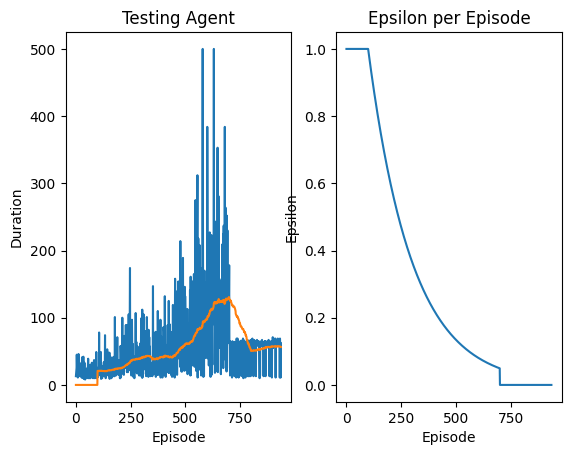

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 937 Duration 60 steps | epsilon 0.0


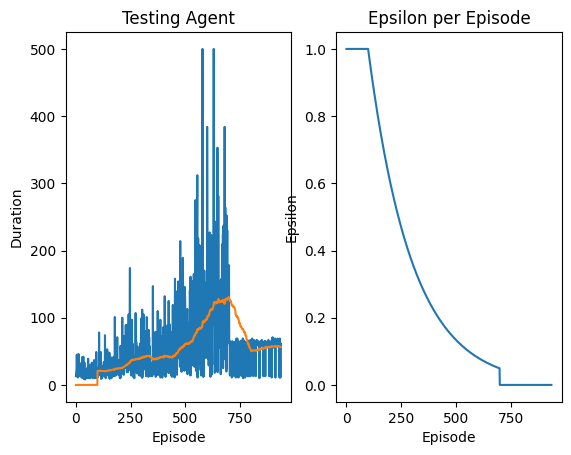

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 938 Duration 58 steps | epsilon 0.0


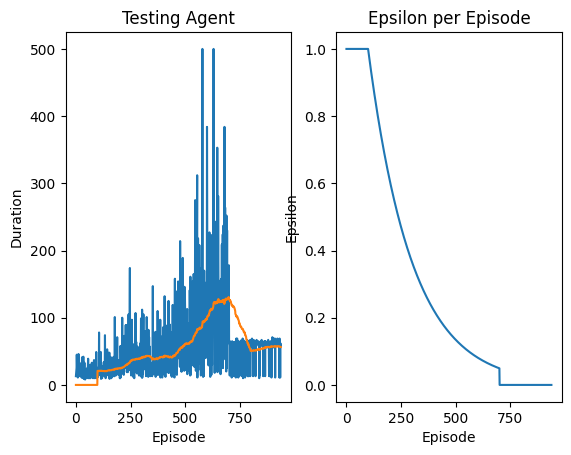

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 939 Duration 62 steps | epsilon 0.0


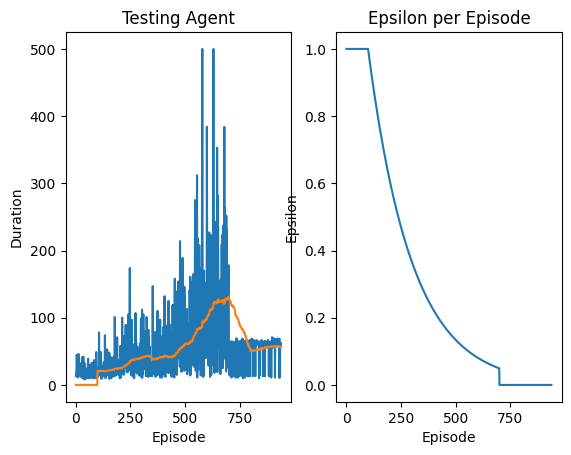

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 940 Duration 58 steps | epsilon 0.0


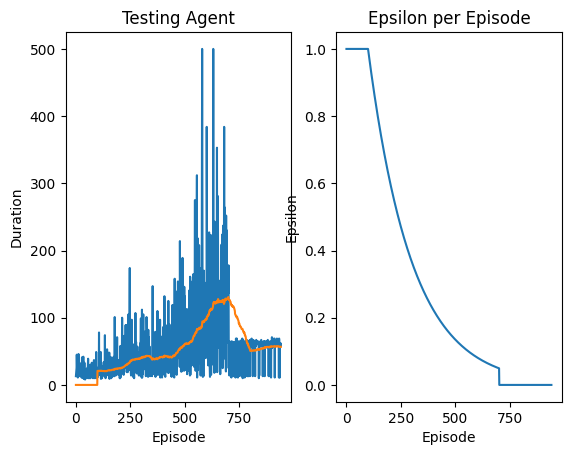

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 941 Duration 63 steps | epsilon 0.0


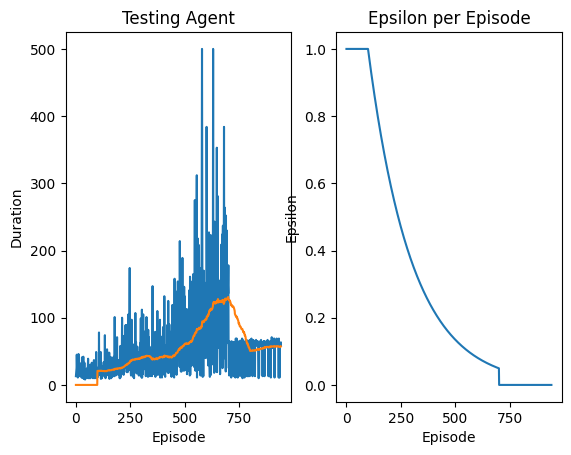

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 942 Duration 62 steps | epsilon 0.0


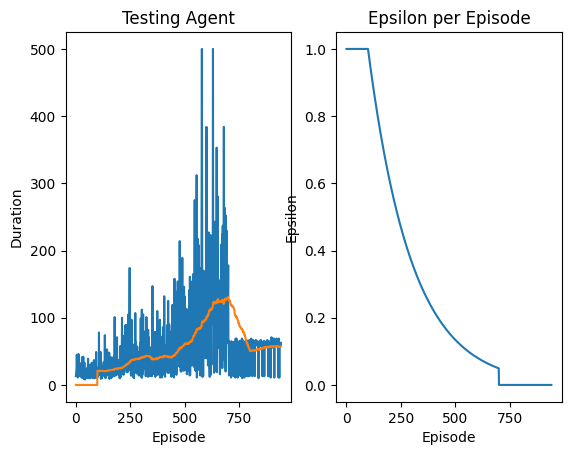

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 943 Duration 67 steps | epsilon 0.0


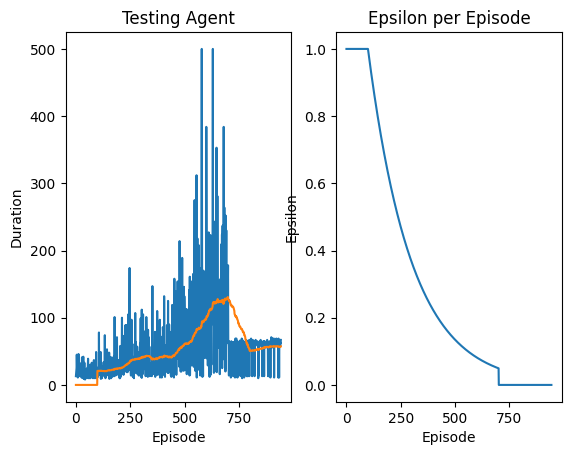

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 944 Duration 58 steps | epsilon 0.0


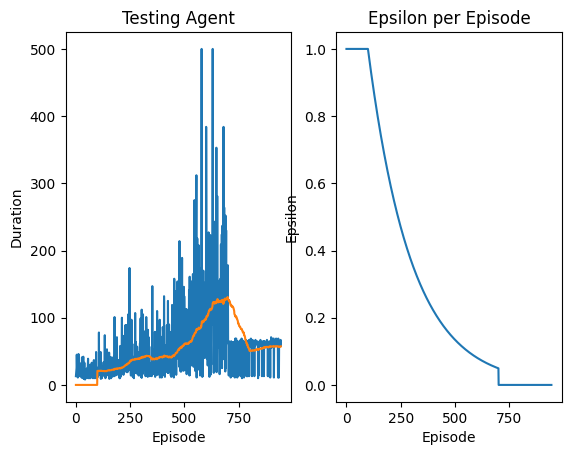

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 945 Duration 67 steps | epsilon 0.0


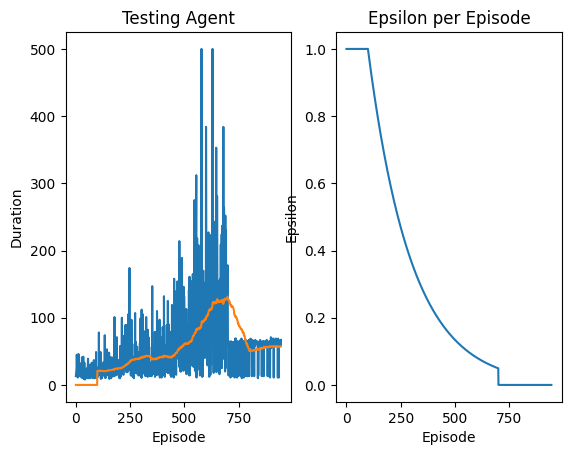

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 946 Duration 64 steps | epsilon 0.0


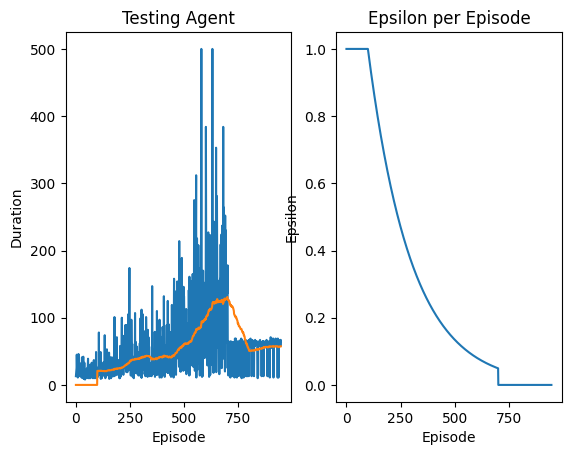

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 947 Duration 63 steps | epsilon 0.0


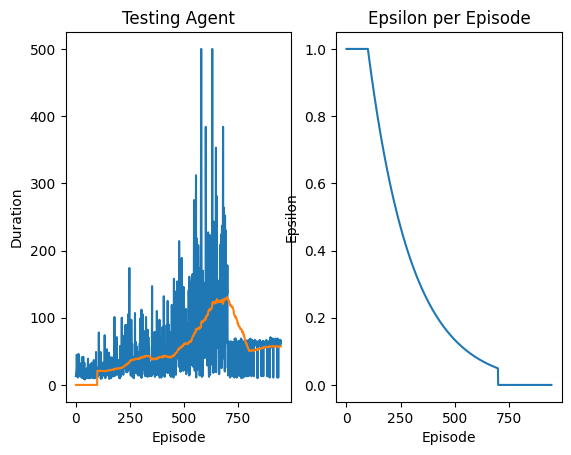

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 948 Duration 64 steps | epsilon 0.0


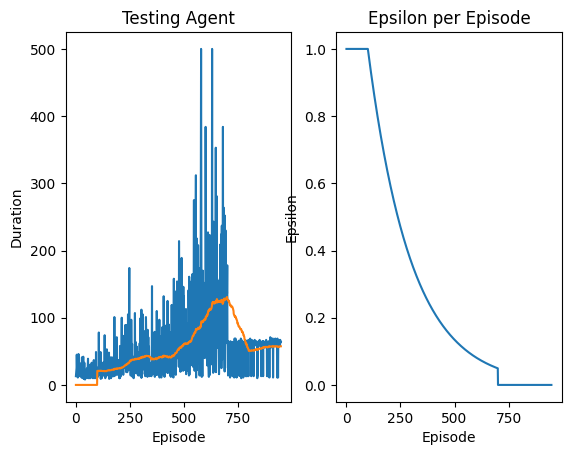

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 949 Duration 65 steps | epsilon 0.0


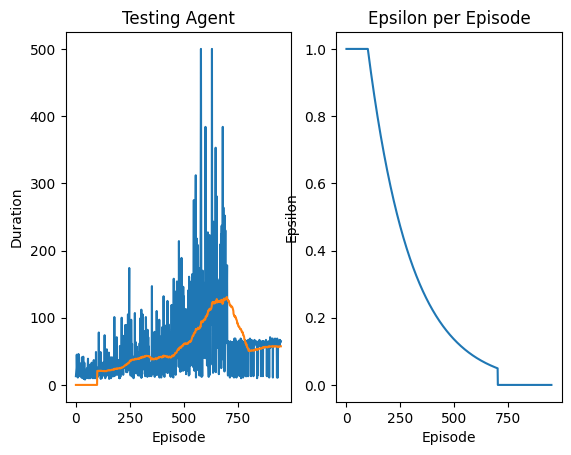

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 950 Duration 12 steps | epsilon 0.0


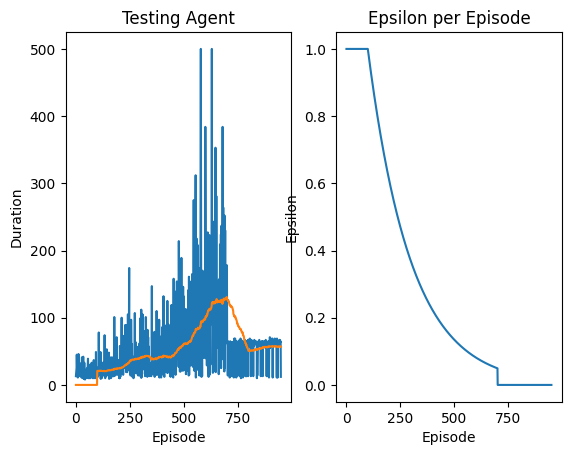

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 951 Duration 67 steps | epsilon 0.0


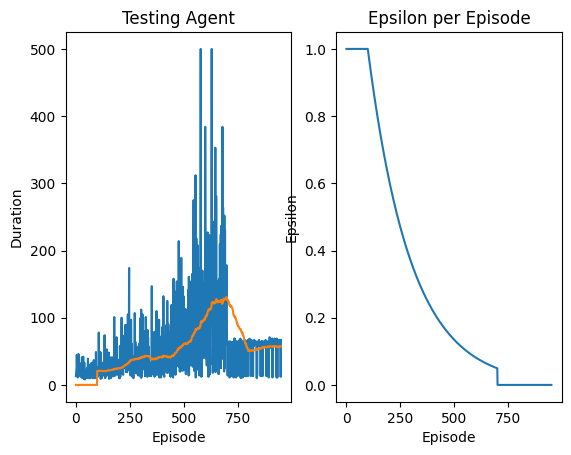

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 952 Duration 63 steps | epsilon 0.0


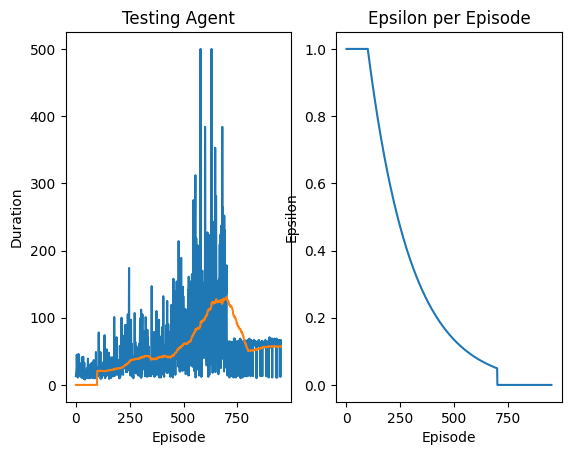

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 953 Duration 65 steps | epsilon 0.0


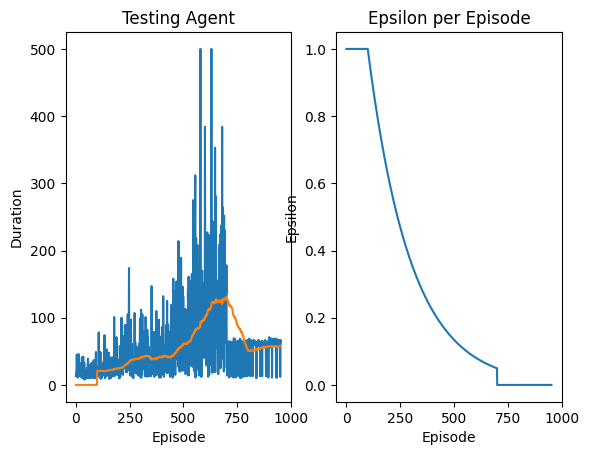

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 954 Duration 59 steps | epsilon 0.0


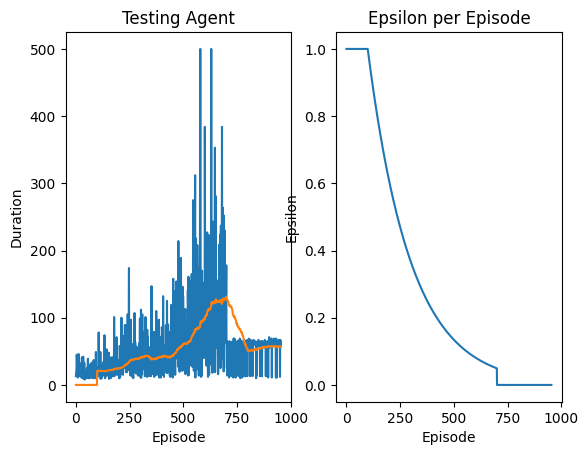

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 955 Duration 60 steps | epsilon 0.0


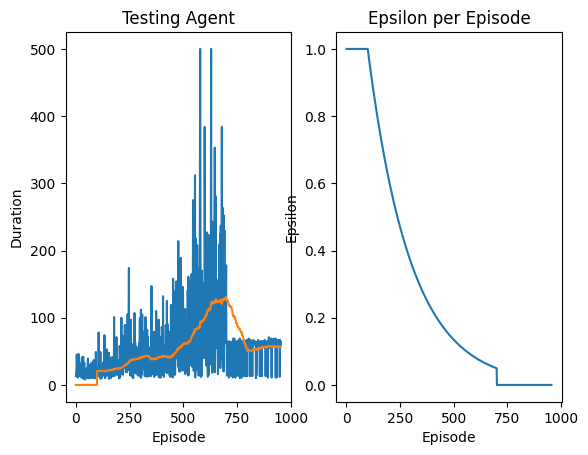

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 956 Duration 57 steps | epsilon 0.0


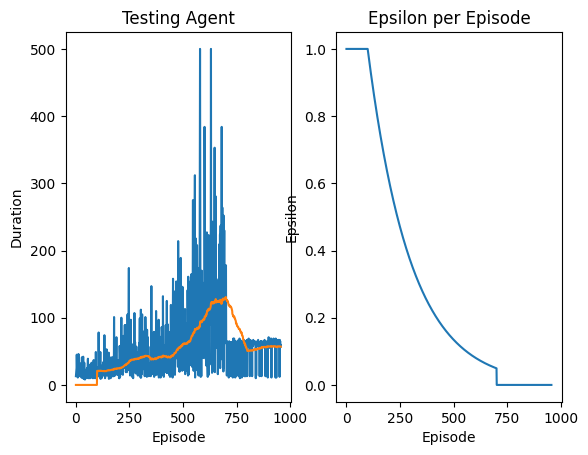

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 957 Duration 58 steps | epsilon 0.0


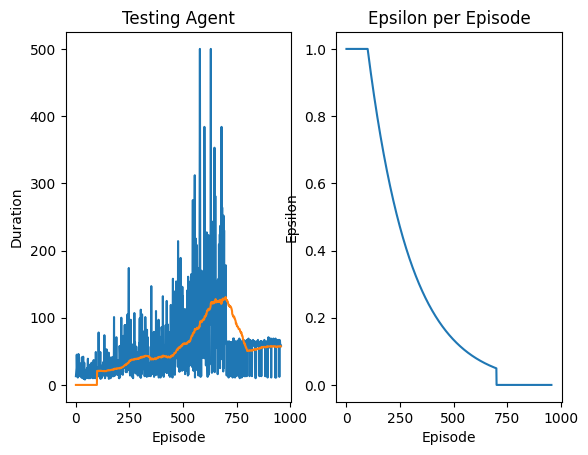

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 958 Duration 59 steps | epsilon 0.0


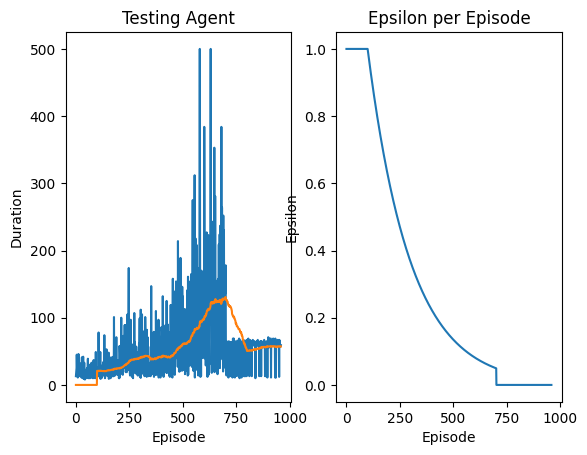

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 959 Duration 61 steps | epsilon 0.0


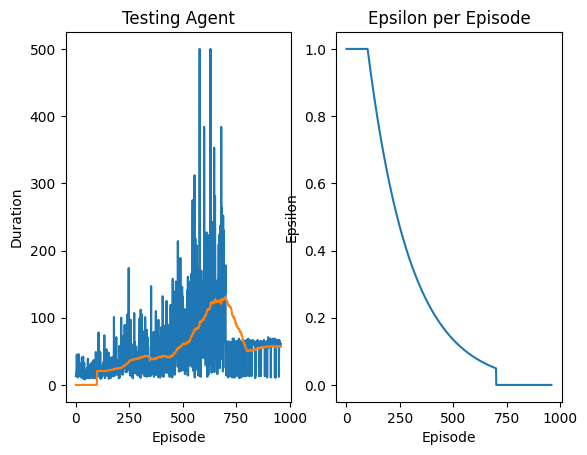

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 960 Duration 60 steps | epsilon 0.0


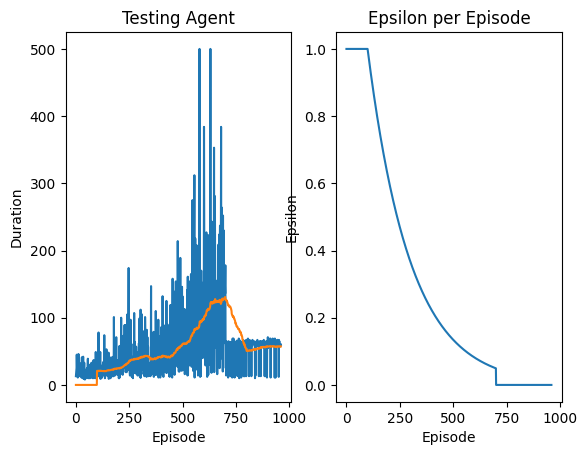

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 961 Duration 55 steps | epsilon 0.0


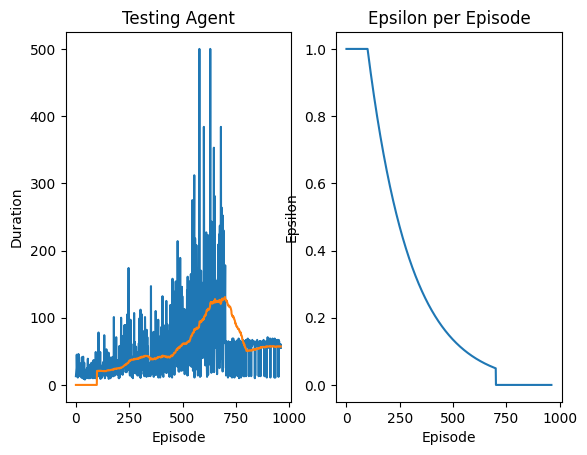

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 962 Duration 60 steps | epsilon 0.0


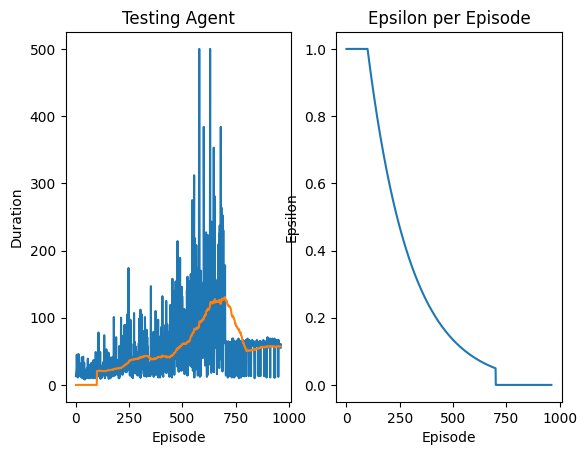

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 963 Duration 65 steps | epsilon 0.0


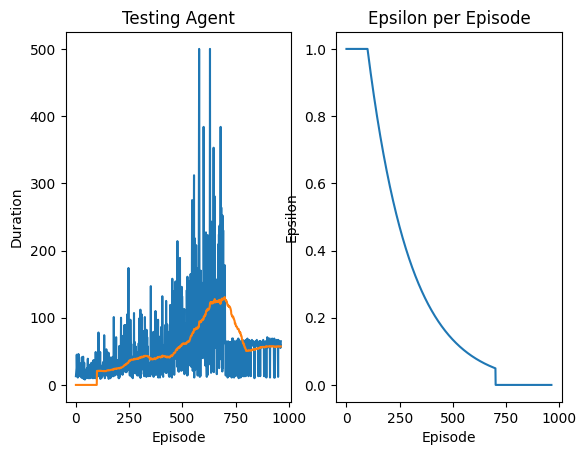

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 964 Duration 67 steps | epsilon 0.0


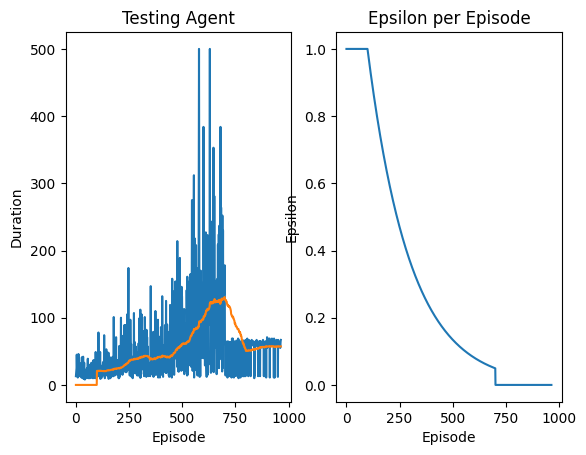

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 965 Duration 65 steps | epsilon 0.0


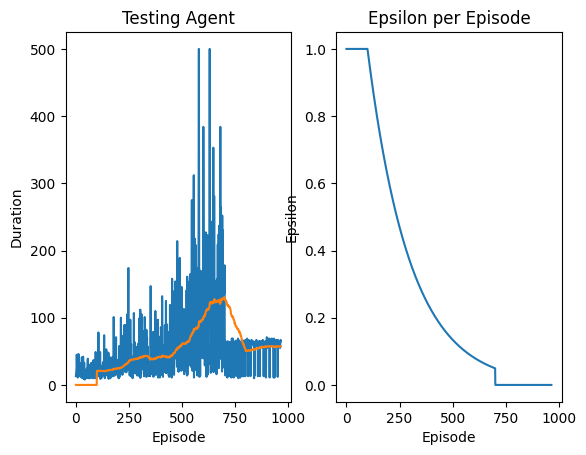

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 966 Duration 59 steps | epsilon 0.0


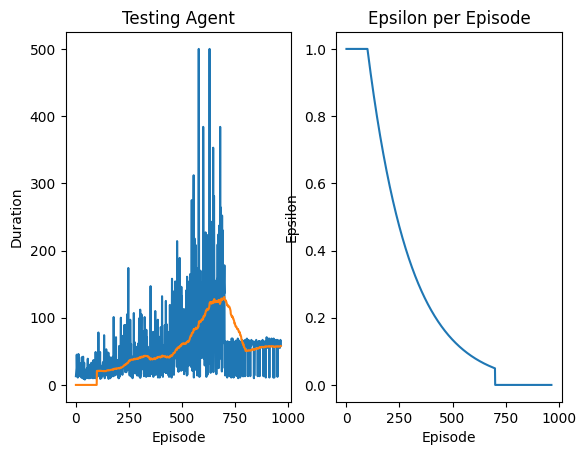

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 967 Duration 11 steps | epsilon 0.0


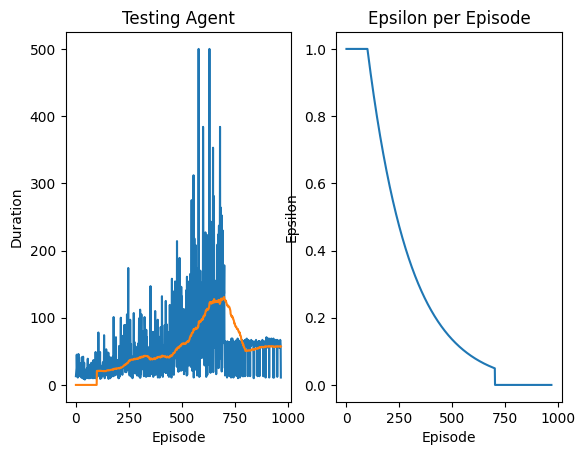

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 968 Duration 62 steps | epsilon 0.0


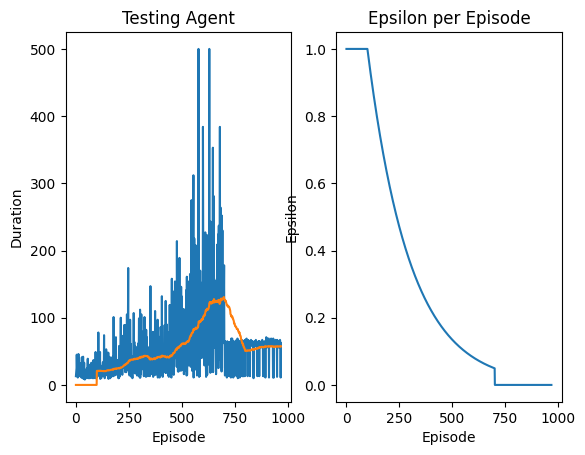

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 969 Duration 61 steps | epsilon 0.0


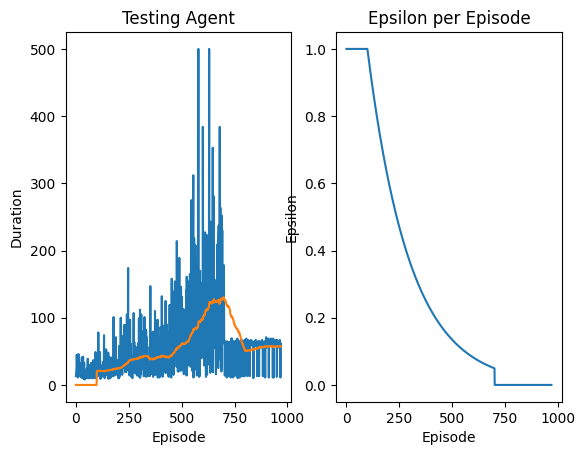

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 970 Duration 59 steps | epsilon 0.0


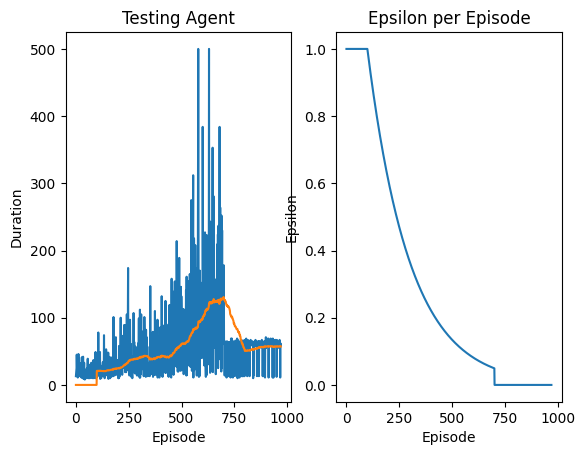

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 971 Duration 12 steps | epsilon 0.0


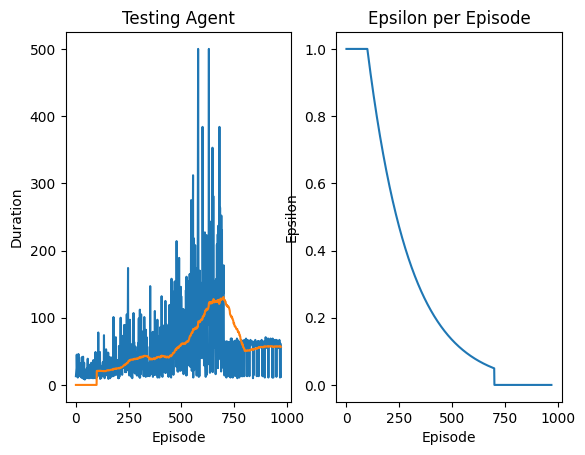

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 972 Duration 13 steps | epsilon 0.0


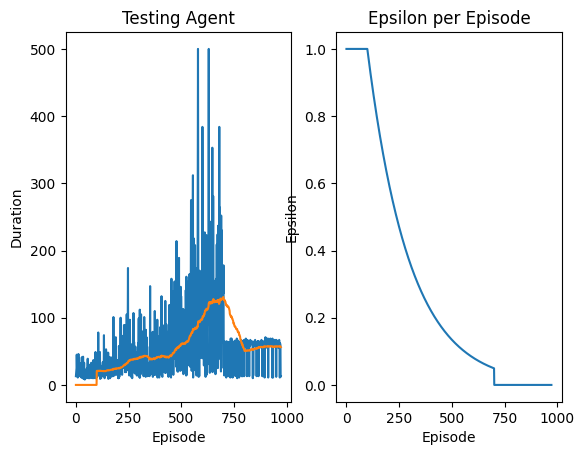

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 973 Duration 62 steps | epsilon 0.0


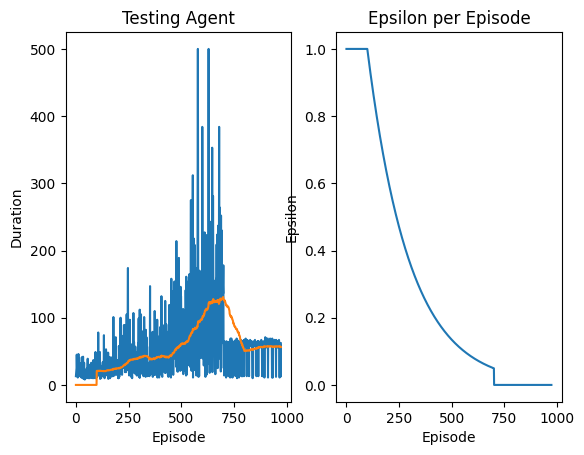

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 974 Duration 63 steps | epsilon 0.0


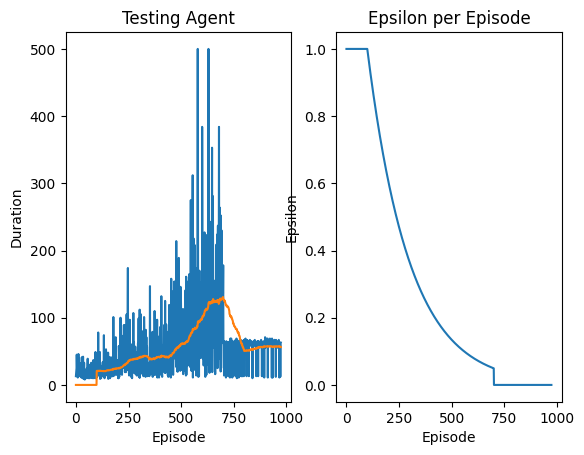

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 975 Duration 11 steps | epsilon 0.0


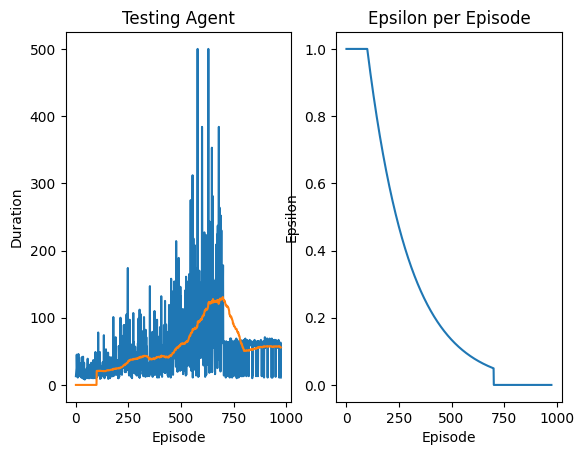

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 976 Duration 61 steps | epsilon 0.0


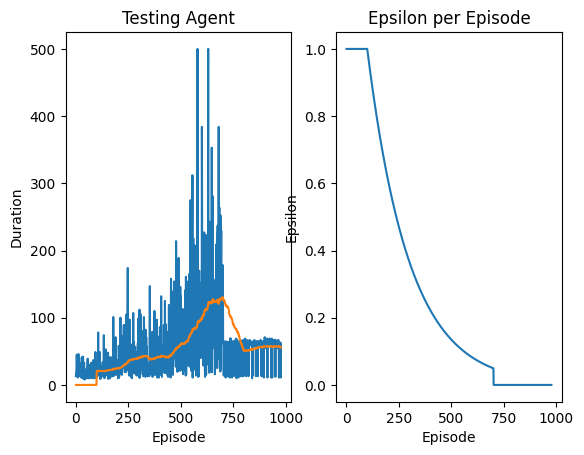

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 977 Duration 56 steps | epsilon 0.0


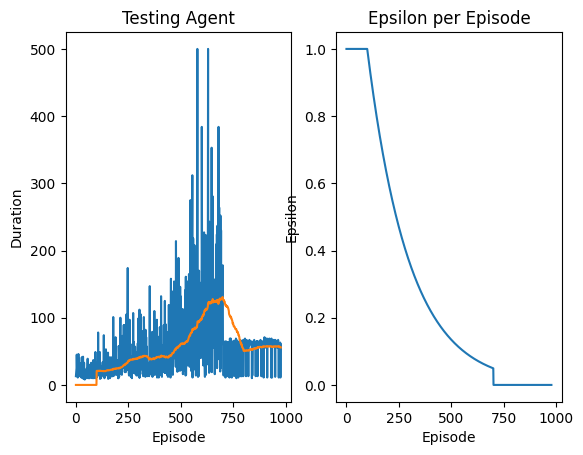

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 978 Duration 64 steps | epsilon 0.0


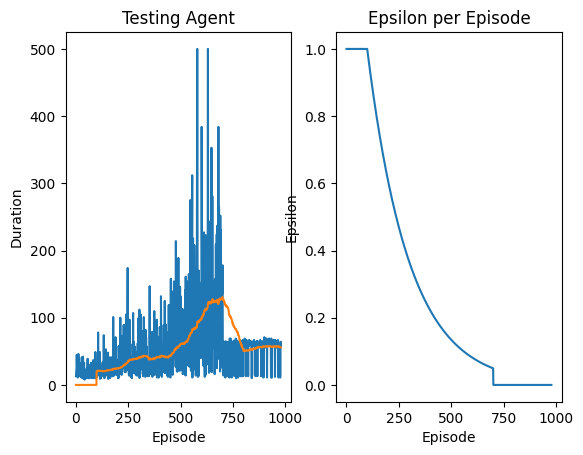

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 979 Duration 62 steps | epsilon 0.0


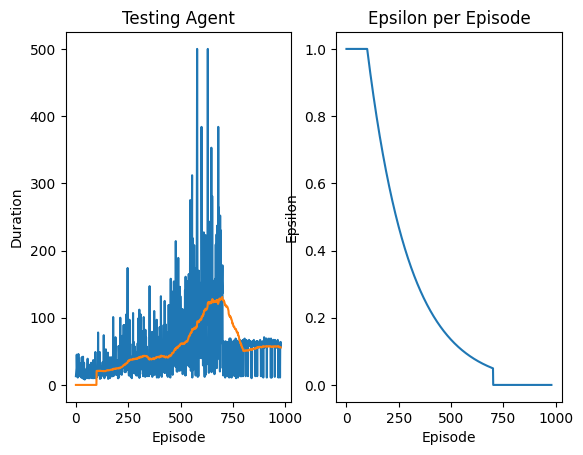

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 980 Duration 66 steps | epsilon 0.0


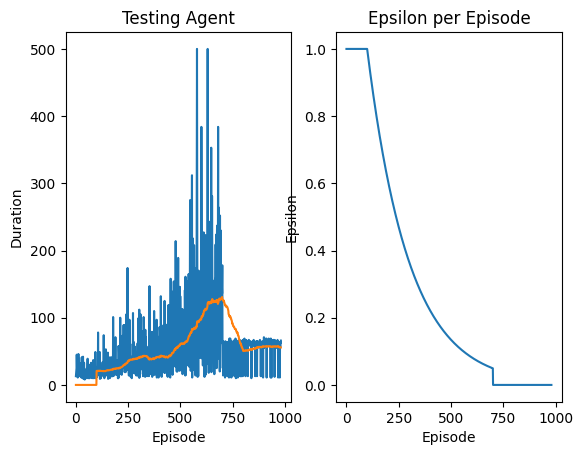

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 981 Duration 61 steps | epsilon 0.0


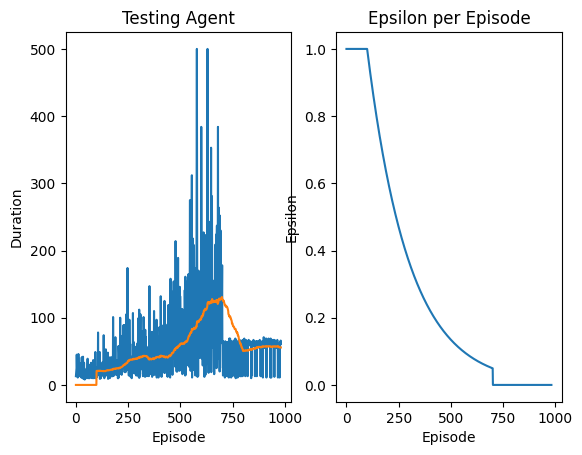

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 982 Duration 11 steps | epsilon 0.0


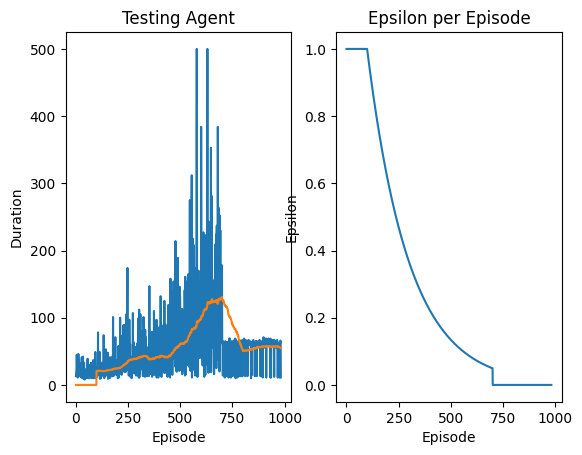

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 983 Duration 63 steps | epsilon 0.0


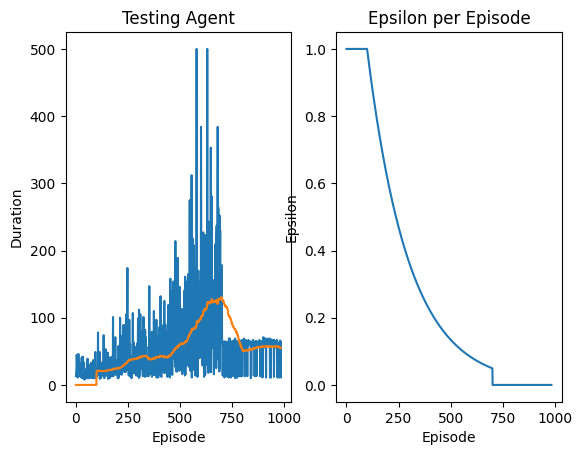

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 984 Duration 65 steps | epsilon 0.0


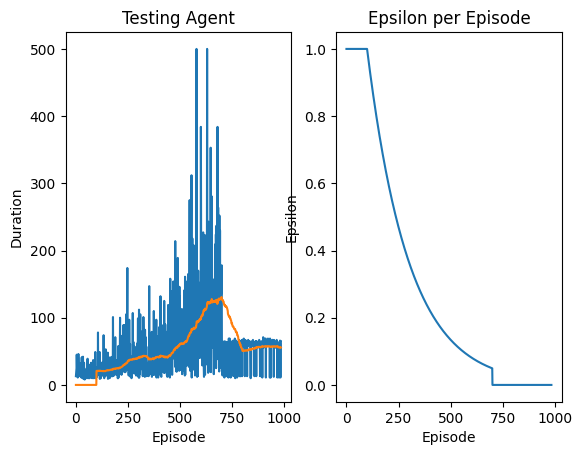

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 985 Duration 65 steps | epsilon 0.0


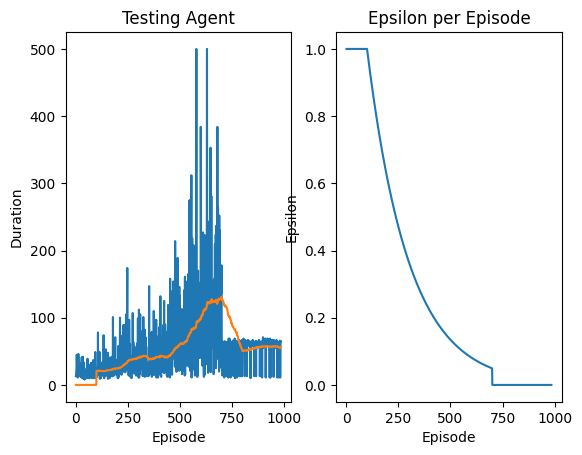

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 986 Duration 60 steps | epsilon 0.0


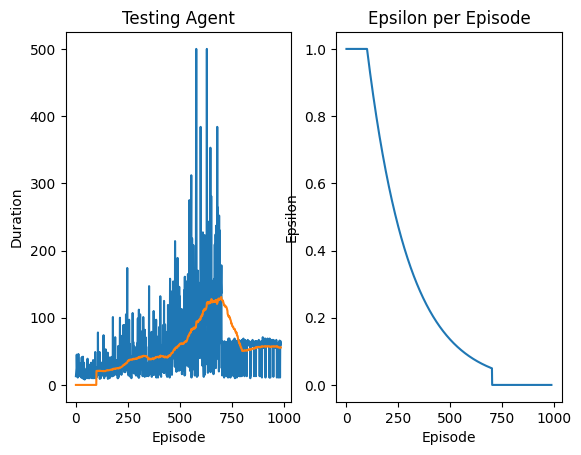

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 987 Duration 12 steps | epsilon 0.0


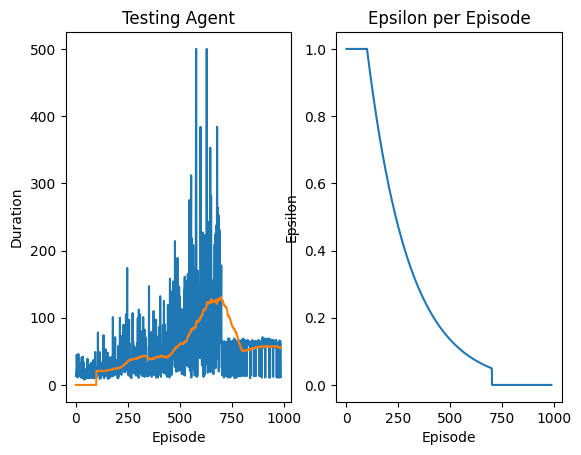

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 988 Duration 60 steps | epsilon 0.0


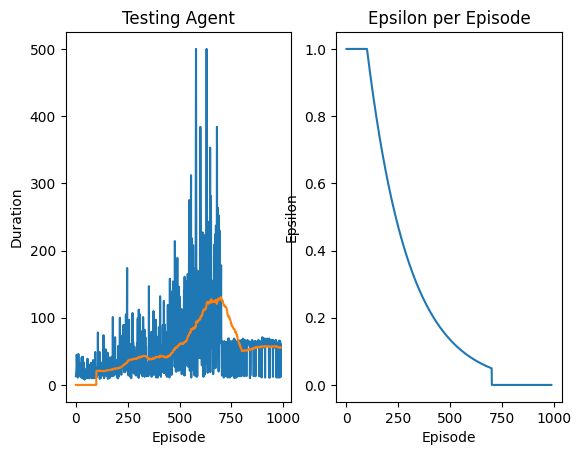

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 989 Duration 13 steps | epsilon 0.0


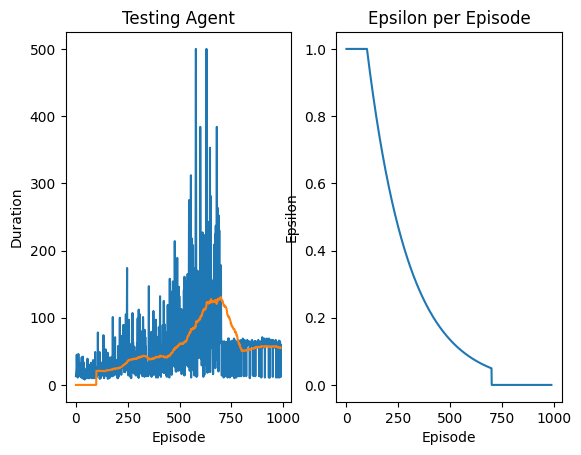

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 990 Duration 59 steps | epsilon 0.0


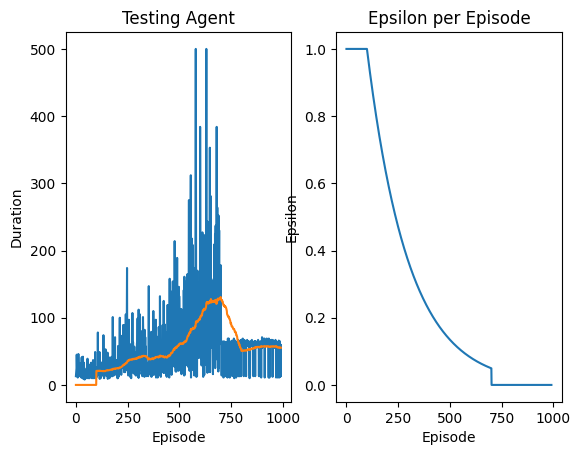

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 991 Duration 65 steps | epsilon 0.0


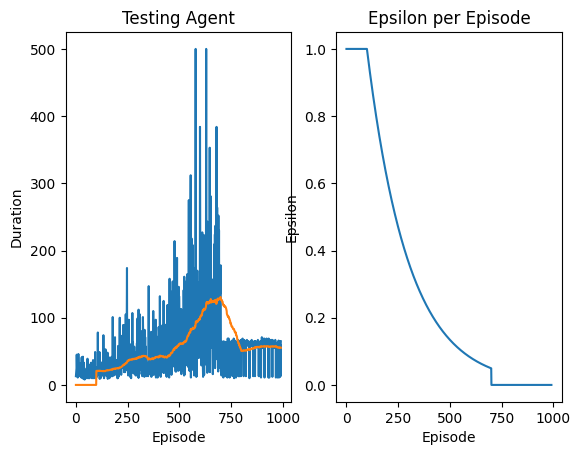

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 992 Duration 60 steps | epsilon 0.0


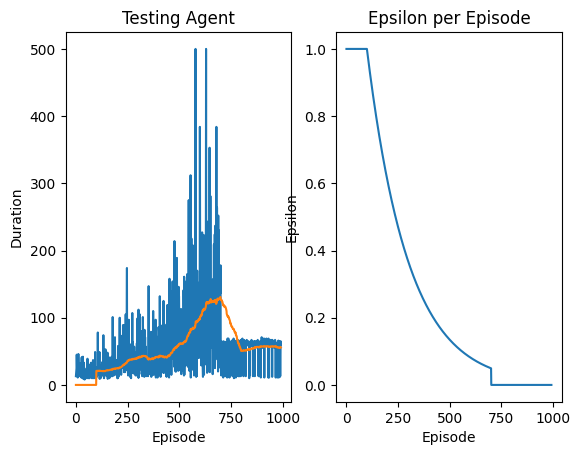

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 993 Duration 64 steps | epsilon 0.0


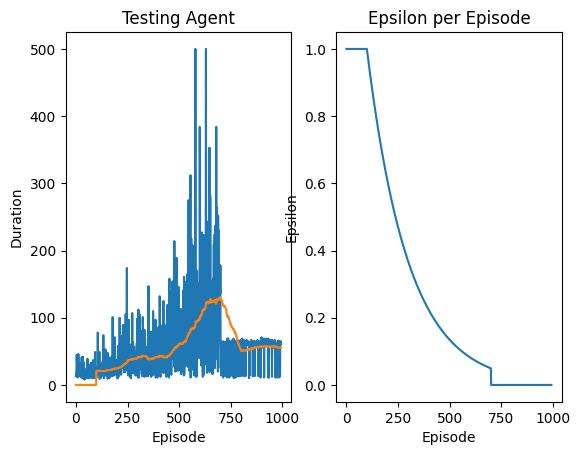

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 994 Duration 66 steps | epsilon 0.0


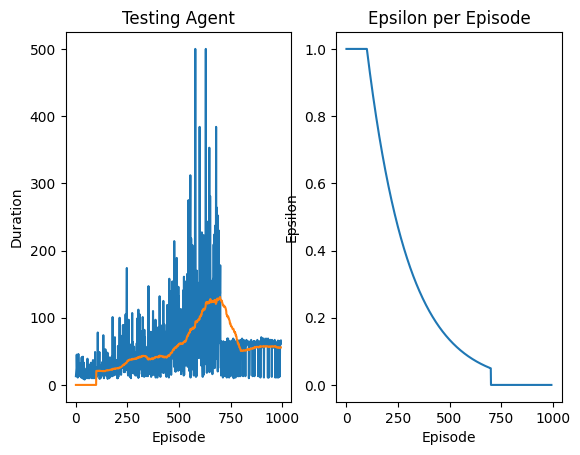

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 995 Duration 69 steps | epsilon 0.0


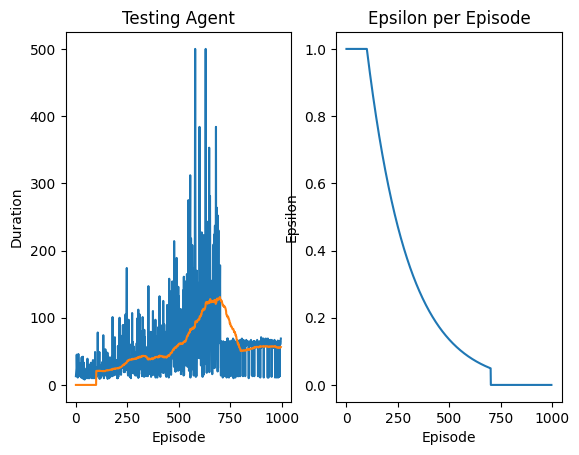

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 996 Duration 69 steps | epsilon 0.0


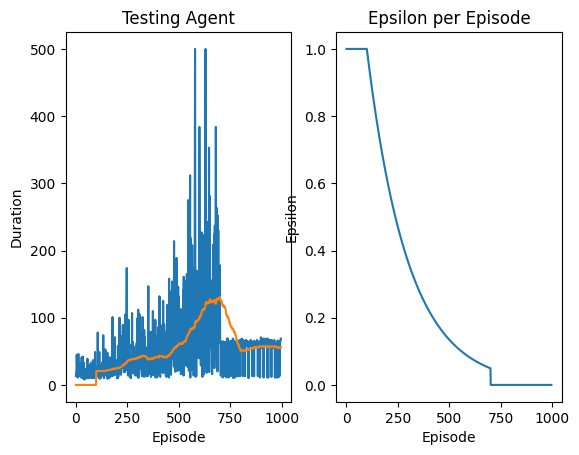

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 997 Duration 64 steps | epsilon 0.0


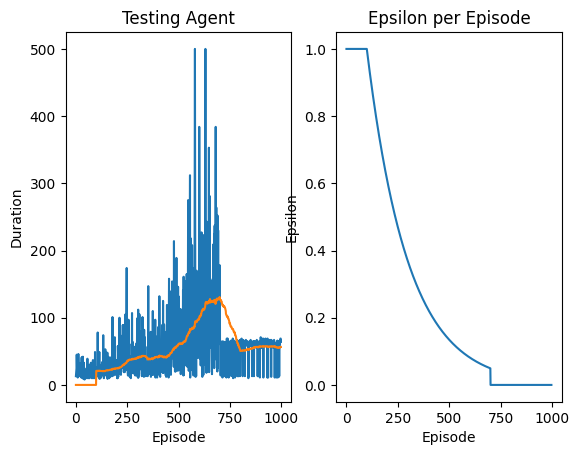

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 998 Duration 11 steps | epsilon 0.0


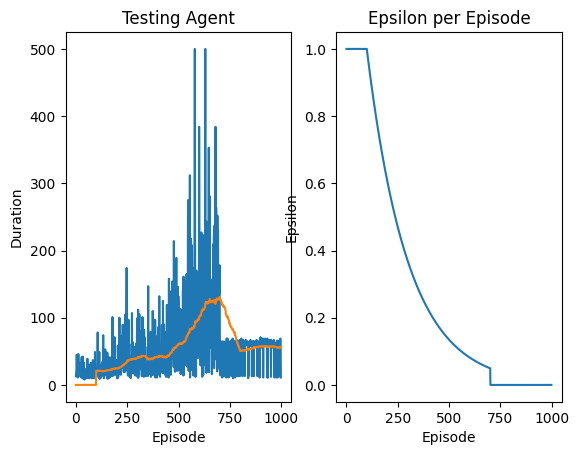

<Figure size 640x480 with 0 Axes>

 Mode: Testing | Episode 999 Duration 64 steps | epsilon 0.0


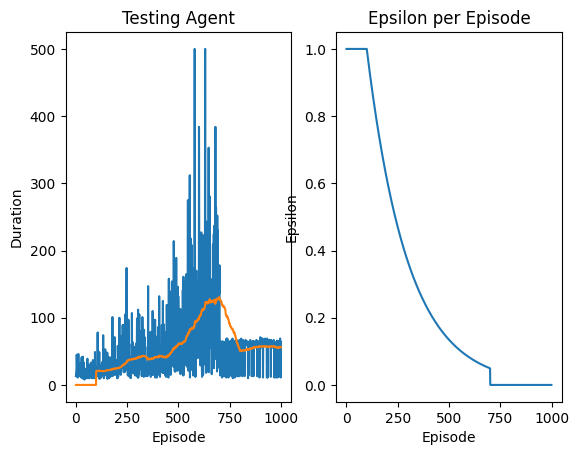

<Figure size 640x480 with 0 Axes>

Complete
Average Test Episode Duration 54.59531772575251


In [17]:
if __name__ == "__main__": ## (J)
  environment = gym.make('CartPole-v1') # creating the OpenAI Gym Cartpole environment
  state_size = environment.observation_space.shape[0]
  action_size = environment.action_space.n
  # Instantiate the RL Agent
  agent = QNetAgent(state_size, action_size)
  for e in range(EPISODES): # Train the agent
    agent.run_episode(e, environment)
  print('Complete')
  test_epi_duration = agent.episode_durations[TEST_EPI_START-EPISODES+1:]
  print("Average Test Episode Duration",np.mean(test_epi_duration))
  environment.close()
  plt.ioff()
  plt.show()